In [1]:
from lensid.train_test import train_crossvalidate_test_XGB_qts , train_crossvalidate_test_XGB_sky, test_combined_ML_results
from sklearn.metrics import accuracy_score,f1_score,roc_auc_score,confusion_matrix,roc_curve
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import xgboost as xgb
import os
import joblib
from lensid.utils import ml_utils
#df_dir='../../data/dataframes/train/' ##alice
df_dir = '/home/srashti.goyal/strong-lensing-ml/data/dataframes/train/' ##CIT

2021-12-08 07:43:09.652559: W tensorflow/stream_executor/platform/default/dso_loader.cc:59] Could not load dynamic library 'libcudart.so.10.1'; dlerror: libcudart.so.10.1: cannot open shared object file: No such file or directory
2021-12-08 07:43:09.652632: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
def train_xgboost_dense_qts(
    df_train,
    from_df=1,
    model_id_dense=0,
    n_estimators=135,
    max_depth=6,
    scale_pos_weight=0.01,
    include_phenom=0,
):
    """
    Train XGBoost Algorithm for the Qtransforms, which takes input as the
    three detector predictions of the trained DenseNet models, and optionally
    the hand derieved features from Qtransforms, for given set of event pairs.

    Parameters:
        df_train(pandas Dataframe): Dataframe containing the img_0, img_1,
            Lensing(labels), and the three Densenet predictions for the
            three detectors, eg: 'dense_H1_0' etc.. Optionally should have
            hand derieved features as columns.

        model_id_dense(int): Identifier for the DenseNet prediction columns
            in the Dataframe. Default: 0.

        n_estimators(int): hyperparameter of XGBoost, setting the maximum
            no. of trees. Default: 135.

        max_depth(int): hyperparameter of XGBoost, setting the maximum size
            of trees. Default: 6.

        scale_pos_weight(float): hyperparameter of XGBoost, setting the weight
            of the unbalanced dataset, eg. ratio of lensed to unlensed event
                rates. Default: 0.01.

        include_phenom(bool): include hand dereived features also while
            training. Default: 0.

    Returns:
        the trained XGBoost model
    """
    cols = [
        "dense_H1_" + str(model_id_dense),
        "dense_L1_" + str(model_id_dense),
        "dense_V1_" + str(model_id_dense),
    ]
    if include_phenom == 1:
        phenom_features = [
            "mean_overlap_qts_H1",
            "std_overlap_qts_H1",
            "lsq_overlap_qts_L1",
            "mean_overlap_qts_L1",
            "std_overlap_qts_L1",
            "lsq_overlap_qts_V1",
            "mean_overlap_qts_V1",
            "std_overlap_qts_V1",
            "lsq_overlap_qts_V1",
        ]
        cols = cols + phenom_features
    if from_df == 1:
        xgb_qts_train, labels = np.c_[df_train[cols]], df_train.Lensing.values
    else:
        print("Dense predictions not in df")

    model = xgb.XGBClassifier(
        objective="binary:logistic",
        n_estimators=n_estimators,
        max_depth=max_depth,
        scale_pos_weight=scale_pos_weight,
    )
    model.fit(X=xgb_qts_train, y=labels)
    return model


def predict_xgboost_dense_qts(
    df,
    model,
    model_id_dense=0,
    model_id_xgb=0,
    from_df=1,
    fill_missing=1,
    include_phenom=0,
):
    """
    Adds XGBoost Algorithm predictions for the Qtransforms, which takes input
    as the three detector predictions of the trained DenseNet models, and
    optionally the hand derieved features from Qtransforms, for given set of
    event pairs.

    Parameters:
        df(pandas Dataframe): Dataframe containing the img_0, img_1,
            Lensing(labels), and the three Densenet Predictions for the three
            detectors, eg: 'dense_H1_0' etc.. Optionally should have hand
            derieved features as columns.

        model_id_dense(int): Identifier for the DenseNet prediction columns
            in the Dataframe. Default: 0.

        model_id_xgb(int): Identifier for adding the XGBoost prediction column
            in the Dataframe. Default: 0.

        fill_missing(bool): In case of missing Qtransform images, or DenseNet
            predictions, return the product of the predictions for the
            available detector DenseNet predicitons, other return None.
            Default: 1

        include_phenom(bool): include hand dereived features also while
            training. Default: 0.

    Returns:
        pandas Dataframe: the input dataframe with additional column eg.
        'xgb_dense_QTS_0' , as the given XGBoost with Qtransforms predictions
        for the event pairs.
    """
    cols = [
        "dense_H1_" + str(model_id_dense),
        "dense_L1_" + str(model_id_dense),
        "dense_V1_" + str(model_id_dense),
    ]
    if include_phenom == 1:
        phenom_features = [
            "mean_overlap_qts_H1",
            "std_overlap_qts_H1",
            "lsq_overlap_qts_L1",
            "mean_overlap_qts_L1",
            "std_overlap_qts_L1",
            "lsq_overlap_qts_V1",
            "mean_overlap_qts_V1",
            "std_overlap_qts_V1",
            "lsq_overlap_qts_V1",
        ]
        cols = cols + phenom_features

    if from_df == 1:
        x1, x2, x3 = df[cols[0]], df[cols[1]], df[cols[2]]
        missing_out = (x1.isna() | x2.isna() | x3.isna()).values
        missing_all = (x1.isna() & x2.isna() & x3.isna()).values

    else:
        print("Dense predictions not in df")
    input_matrix = np.c_[df[cols]]

    y_predict = model.predict_proba(input_matrix)[:, 1]
    if fill_missing == 1:
        y_predict[missing_out] = (
            x1[missing_out].fillna(1).values
            * x2[missing_out].fillna(1).values
            * x3[missing_out].fillna(1).values
        )
        y_predict[missing_all] = None

    else:
        y_predict[missing_out] = None
    df["xgb_dense_QTS_" + str(model_id_xgb)] = y_predict

    return df

In [6]:
def train_test_xgbqts(base_out_dir,df_dir_train_features_in, df_dir_test_features_in, tag_qts,train_size_lensed_xgbqts, cv_size_lensed_xgbqts, scale_pos_weight_xgbqts, max_depth_xgbqts, n_estimators_xgbqts, cv_splits, compare_to_blu, path_to_blu,include_phenom):
    df_lensed_qts = pd.read_csv(df_dir_train_features_in+'lensed_qts'+tag_qts+'.csv',index_col=[0] )[:train_size_lensed_xgbqts]

    df_unlensed_qts_half = pd.read_csv(df_dir_train_features_in+'unlensed_half_qts'+tag_qts+'.csv' ,index_col=[0])
    df_unlensed_qts_half = df_unlensed_qts_half.sample(frac = 1,random_state = 42).reset_index(drop = True)
    df_train_qts = pd.concat([df_lensed_qts,df_unlensed_qts_half],ignore_index = True)
    df_train_qts=df_train_qts.sample(frac = 1).reset_index(drop = True)
    xgboost_dense_qts_model=train_xgboost_dense_qts(df_train_qts,from_df=True,scale_pos_weight=scale_pos_weight_xgbqts, n_estimators=n_estimators_xgbqts, max_depth=max_depth_xgbqts, include_phenom=include_phenom)
    if not os.path.exists(base_out_dir):
        os.makedirs(base_out_dir)
    joblib_file = base_out_dir+'/XGBQT_0'+tag_qts+'.pkl'  
    joblib.dump(xgboost_dense_qts_model, joblib_file)
    df_lensed_qts = pd.read_csv(df_dir_train_features_in+'lensed_qts'+tag_qts+'.csv',index_col=[0] )[2400:]
    df_unlensed_qts_half = pd.read_csv(df_dir_train_features_in+'unlensed_second_half_qts'+tag_qts+'.csv' ,index_col=[0])
    df_unlensed_qts_half = df_unlensed_qts_half.sample(frac = 1,random_state = 42).reset_index(drop = True)
    df_val_qts = pd.concat([df_lensed_qts,df_unlensed_qts_half],ignore_index = True)
    df_val_qts=df_val_qts.sample(frac = 1).reset_index(drop = True)
    df_val_qts=predict_xgboost_dense_qts(df_val_qts,xgboost_dense_qts_model,include_phenom=include_phenom)
    plt.figure(1)
    fig=ml_utils.plot_ROCs(df_val_qts,logy=False,cols=['dense_H1_0', 'dense_L1_0', 'dense_V1_0','xgb_dense_QTS_0'])
    plt.show()
    df_lensed_qts = pd.read_csv(df_dir_test_features_in+'lensed_qts'+tag_qts+'.csv',index_col=[0] )
    df_unlensed_qts = pd.read_csv(df_dir_test_features_in+'unlensed_qts'+tag_qts+'.csv' ,index_col=[0])


    df_test_blu_lensed = pd.read_csv(blu_lensed,index_col=[0] )
    df_test_blu_unlensed = pd.read_csv(blu_unlensed,index_col=[0] )
    cols=['m1, m2, ra, sin_dec, a1, a2, costilt1, costilt2, costheta_jn',
           'm1, m2, ra, sin_dec, costheta_jn', 'ra, sin_dec',
           '# m1, m2, ra, sin_dec, a1, a2, costilt1, costilt2',
           'm1, m2, ra, sin_dec', 'm1, m2']
    df_lensed_qts=df_lensed_qts.join(df_test_blu_lensed[cols])
    df_unlensed_qts=df_unlensed_qts.join(df_test_blu_unlensed[cols])
    df_test_qts = pd.concat([df_lensed_qts,df_unlensed_qts],ignore_index = True)
    df_test_qts=df_test_qts.sample(frac = 1).reset_index(drop = True)
    xgboost_dense_qts_model = joblib.load(base_out_dir+'/XGBQT_0'+tag_qts+'.pkl')
    df_test_qts=predict_xgboost_dense_qts(df_test_qts,xgboost_dense_qts_model,include_phenom=include_phenom)


    df_test_qts=df_test_qts.dropna()
    plt.figure(2)
    fig2=ml_utils.plot_ROCs(df_test_qts,cols=['dense_H1_0' ,'dense_L1_0','dense_V1_0','xgb_dense_QTS_0','m1, m2']\
                     ,labels=['ML H1 QTs', 'ML L1 QTs', 'ML V1 QTs','ML combined H1 L1 V1 QTS', '$B^L_U:$ $m_1 m_2$'],logy=False)
    plt.show()
    df_test=df_test_qts
    ml_stat='xgb_dense_QTS_0'
    blu_stat= 'm1, m2'
    plt.figure(figsize=(20,5))
    plt.subplot(131)
    plt.xlabel('ML statistic')
    bins=np.linspace(-6,0,30)
    #plt.ylim(-100,1e3)
    df=df_test[df_test['Lensing'] == 0]
    plt.hist(np.log10(df[ml_stat]),bins=bins,label='Unlensed', histtype='step',density=True)
    df=df_test[df_test['Lensing'] == 1]
    plt.hist(np.log10(df[ml_stat]),bins=bins,label='Lensed', histtype='step',density=True)
    plt.legend()
    #plt.ylim(0,300)
    plt.subplot(132)
    plt.xlabel('BLU statistic')
    bins=np.linspace(-6,6,30)
    #plt.ylim(-100,1e3)
    df=df_test[df_test['Lensing'] == 0]
    plt.hist(np.log10(df[blu_stat]),bins=bins,label='Unlensed', histtype='step',density=True)
    df=df_test[df_test['Lensing'] == 1]
    plt.hist(np.log10(df[blu_stat]),bins=bins,label='Lensed', histtype='step',density=True)
    plt.legend()
    #plt.ylim(0,300)
    plt.subplot(133)

    plt.xlabel('ML statistic')
    plt.ylabel('BLU statistic')
    #plt.ylim(-100,1e3)
    df=df_test[df_test['Lensing'] == 0]
    plt.loglog(df[ml_stat],df[blu_stat],'x',label='Unlensed')
    df=df_test[df_test['Lensing'] == 1]
    plt.loglog(df[ml_stat],df[blu_stat],'+',label='Lensed')
    plt.legend()
    plt.show()

    
    plt.figure()
    plt.xlabel('ML statistic')
    plt.ylabel('BLU statistic')
    df=df_test[df_test['Lensing'] == 1]
    plt.plot(df[ml_stat],np.log(df[blu_stat]),'+',label='Lensed')
    #plt.ylim(0,500)
    #plt.xlim(1e-2, 1)
    plt.legend()
    plt.grid()
    plt.show()
    
    ml_stat='xgb_dense_QTS_0'
    blu_stat= 'm1, m2'
    df_test[ml_stat+'_fpp']=ml_utils.get_fars(df_test,ml_stat,df_test,ml_stat)
    df_test[blu_stat+'_fpp']=ml_utils.get_fars(df_test,blu_stat,df_test,blu_stat)

    plt.figure(figsize=(15,7))
    plt.subplot(121)
    bins=np.linspace(-5,0,30)
    #plt.ylim(-100,1e3)
    df=df_test[df_test['Lensing'] == 0]
    plt.hist(np.log10(df[ml_stat+'_fpp']),bins=bins,label='ML Unlensed', histtype='step',density=True,color='C0',lw=4)
    plt.hist(np.log10(df[blu_stat+'_fpp']),bins=bins,label='BLU Unlensed', histtype='step',density=True,color='C0',lw=2)

    df=df_test[df_test['Lensing'] == 1]
    plt.hist(np.log10(df[ml_stat+'_fpp']),bins=bins,label='ML Lensed', histtype='step',density=True,color='C1',lw=4)
    plt.hist(np.log10(df[blu_stat+'_fpp']),bins=bins,label='BLU Lensed', histtype='step',density=True,color='C1',lw=2)

    plt.legend()
    plt.xlabel('FPP(log10)')
    plt.ylabel('PDF')
    plt.grid()

    plt.subplot(122)
    df=df_test[df_test['Lensing'] == 0]
    plt.loglog(df[ml_stat+'_fpp'],df[blu_stat+'_fpp'],'+',label='Unlensed',color='C0')
    df=df_test[df_test['Lensing'] == 1]
    plt.loglog(df[ml_stat+'_fpp'],df[blu_stat+'_fpp'],'x',label='Lensed',color='C1')
    plt.loglog(10**bins,10**bins,'k--')
    plt.legend()
    plt.xlabel('ML')
    plt.ylabel('BLU')
    plt.grid()
    plt.xlim(1e-5,1)
    plt.ylim(1e-5,1)
    plt.suptitle('ML QTs and BLU masses')
    plt.show()
    
    cols=['dense_H1_0' ,'dense_L1_0','dense_V1_0','xgb_dense_QTS_0']
    df_test_scores={}
    df_val_scores={}
    for col in cols:
        df_test_scores[col+'_roc']=roc_auc_score( df_test.Lensing.values,df_test[col].values)
        df_test_scores[col+'_acc'] = accuracy_score(df_test.Lensing.values,np.round(df_test[col].values))
        df_test_scores[col+'_f1'] = f1_score(df_test.Lensing.values,np.round(df_test[col].values))
        df_val_scores[col+'_roc']=roc_auc_score( df_val_qts.Lensing.values,df_val_qts[col].values)
        df_val_scores[col+'_acc'] = accuracy_score(df_val_qts.Lensing.values,np.round(df_val_qts[col].values))
        df_val_scores[col+'_f1'] = f1_score(df_val_qts.Lensing.values,np.round(df_val_qts[col].values))
        
        
    return df_test_scores,df_val_scores

In [7]:
#df_dir_train_features_in = '/home/srashti.goyal/lensid_runs/ML_1p0_AnalyticalPsd/dataframes/train/'
#df_dir_test_features_in = '/home/srashti.goyal/lensid_runs/ML_1p0_AnalyticalPsd/dataframes/test/'
df_dir_train_features_in = '/home/srashti.goyal/lensid_runs/ML_1p0_AnalyticalPsd_whitened/dataframes/train/'
df_dir_test_features_in = '/home/srashti.goyal/lensid_runs/ML_1p0_AnalyticalPsd_whitened/dataframes/test/'

path_to_blu = '/home/srashti.goyal/strong-lensing-ml/data/dataframes/haris_et_al/'
train_size_lensed_xgbqts = 2400
cv_size_lensed_xgbqts = 2400
cv_splits = 10
scale_pos_weight_xgbqts = 0.01
max_depth_xgbqts = 5
n_estimators_xgbqts = 120
tag_qts = ''#_kaggle
base_out_dir = 'optimise_xgb_qts'
compare_to_blu = 1
include_phenom = 0

#blu_lensed = '../../data/dataframes/haris_et_al/Lensed_PE_blus.csv'
#blu_unlensed = '../../data/dataframes/haris_et_al/Unlensed_PE_blus.csv'

blu_lensed = '/home/srashti.goyal/strong-lensing-ml/data/dataframes/haris_et_al/Lensed_PE_blus.csv'
blu_unlensed = '/home/srashti.goyal/strong-lensing-ml/data/dataframes/haris_et_al/Unlensed_PE_blus.csv'





dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9597


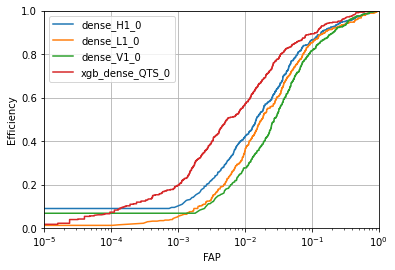

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

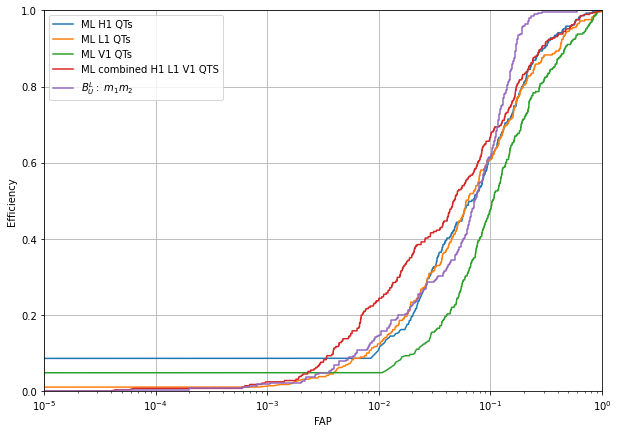

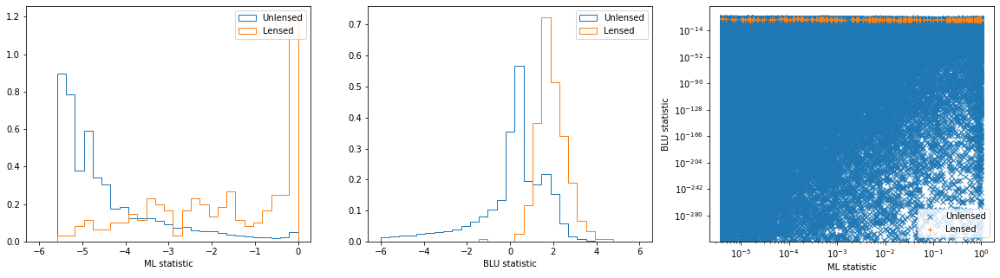

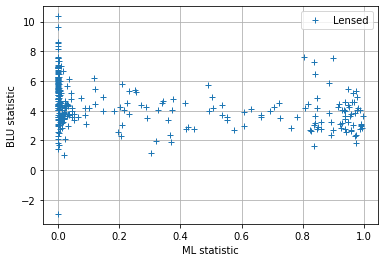

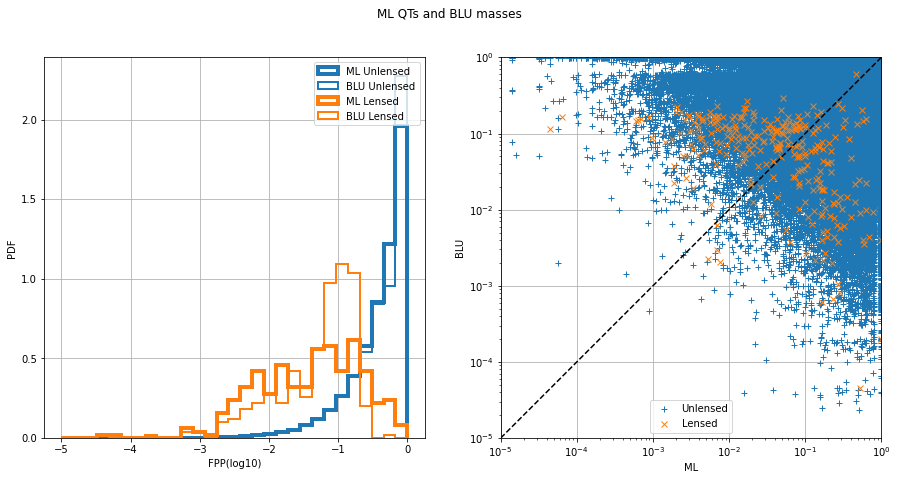

In [8]:
df_test_scores,df_val_scores=train_test_xgbqts(base_out_dir,df_dir_train_features_in, df_dir_test_features_in, tag_qts,train_size_lensed_xgbqts, cv_size_lensed_xgbqts, scale_pos_weight_xgbqts, max_depth_xgbqts, n_estimators_xgbqts, cv_splits, compare_to_blu, path_to_blu,include_phenom)

In [9]:
df_test_scores

{'dense_H1_0_roc': 0.8781991583057633,
 'dense_H1_0_acc': 0.7326917305268212,
 'dense_H1_0_f1': 0.0038623281338542757,
 'dense_L1_0_roc': 0.8650130317175748,
 'dense_L1_0_acc': 0.6992596890694092,
 'dense_L1_0_f1': 0.0033947977376855704,
 'dense_V1_0_roc': 0.8175952304208817,
 'dense_V1_0_acc': 0.6836951519638248,
 'dense_V1_0_f1': 0.003027130658527049,
 'xgb_dense_QTS_0_roc': 0.8895289127816037,
 'xgb_dense_QTS_0_acc': 0.9864463074491286,
 'xgb_dense_QTS_0_f1': 0.023356401384083045}

In [10]:
df_val_scores

{'dense_H1_0_roc': 0.9397644353356684,
 'dense_H1_0_acc': 0.8595489010154921,
 'dense_H1_0_f1': 0.040604704469792065,
 'dense_L1_0_roc': 0.9299625103518545,
 'dense_L1_0_acc': 0.8408449916507539,
 'dense_L1_0_f1': 0.03591133481753944,
 'dense_V1_0_roc': 0.9244137373477009,
 'dense_V1_0_acc': 0.8370339003363667,
 'dense_V1_0_f1': 0.03400426237272082,
 'xgb_dense_QTS_0_roc': 0.9596511542750658,
 'xgb_dense_QTS_0_acc': 0.9960610733375412,
 'xgb_dense_QTS_0_f1': 0.2906474820143885}

In [11]:
train_size_lensed_xgbqts = 2400
cv_size_lensed_xgbqts = 2400
cv_splits = 10
scale_pos_weight_xgbqts = 0.01
max_depth_xgbqts = 6
n_estimators_xgbqts = 105
tag_qts = ''#_kaggle
base_out_dir = 'optimise_xgb_qts'
compare_to_blu = 1
include_phenom = 1

dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9676


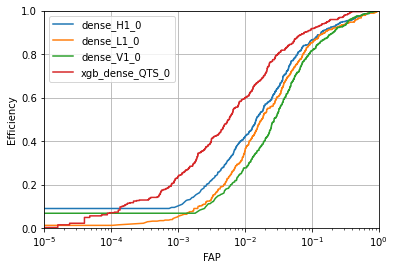

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.9027
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

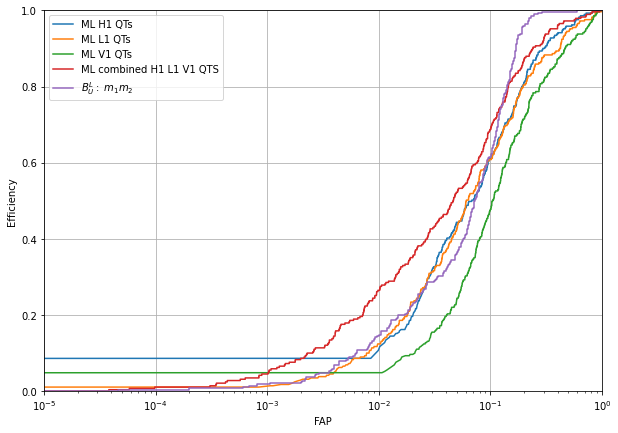

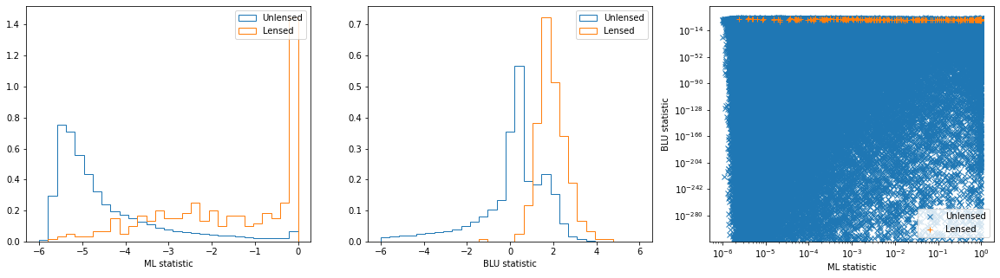

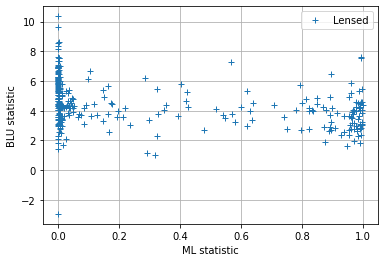

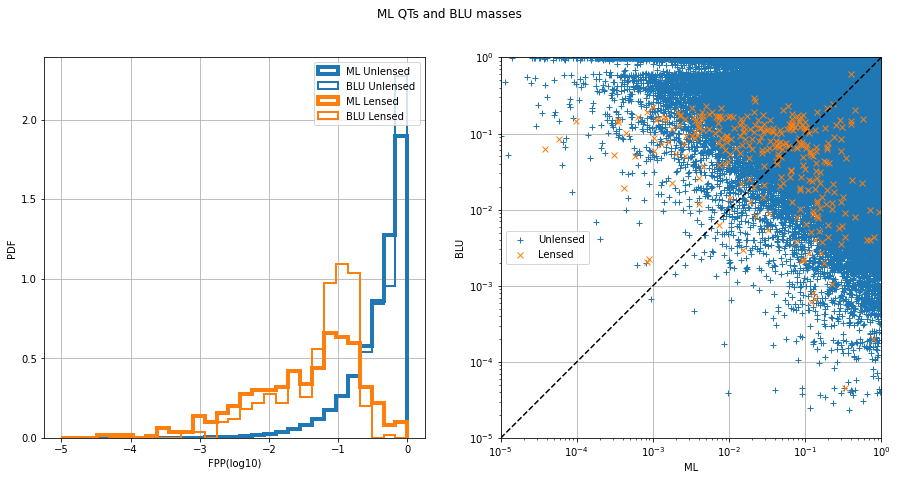

In [12]:
df_test_scores,df_val_scores=train_test_xgbqts(base_out_dir,df_dir_train_features_in, df_dir_test_features_in, tag_qts,train_size_lensed_xgbqts, cv_size_lensed_xgbqts, scale_pos_weight_xgbqts, max_depth_xgbqts, n_estimators_xgbqts, cv_splits, compare_to_blu, path_to_blu,include_phenom)

In [13]:
df_test_scores

{'dense_H1_0_roc': 0.8781991583057633,
 'dense_H1_0_acc': 0.7326917305268212,
 'dense_H1_0_f1': 0.0038623281338542757,
 'dense_L1_0_roc': 0.8650130317175748,
 'dense_L1_0_acc': 0.6992596890694092,
 'dense_L1_0_f1': 0.0033947977376855704,
 'dense_V1_0_roc': 0.8175952304208817,
 'dense_V1_0_acc': 0.6836951519638248,
 'dense_V1_0_f1': 0.003027130658527049,
 'xgb_dense_QTS_0_roc': 0.9027479589531527,
 'xgb_dense_QTS_0_acc': 0.9828928149822925,
 'xgb_dense_QTS_0_f1': 0.02196293754289636}

dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


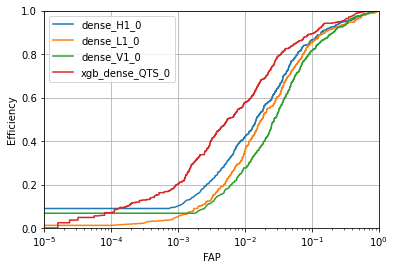

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8891
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

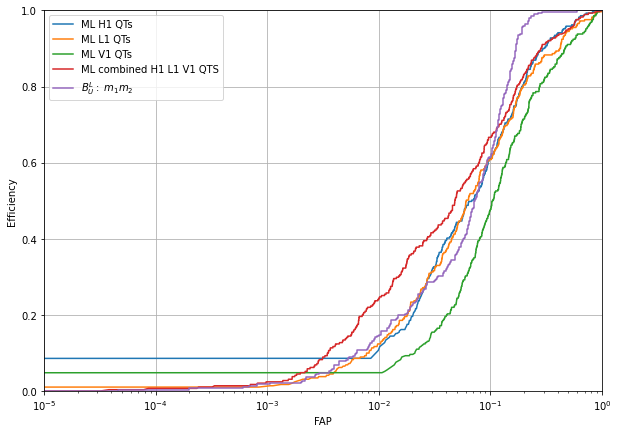

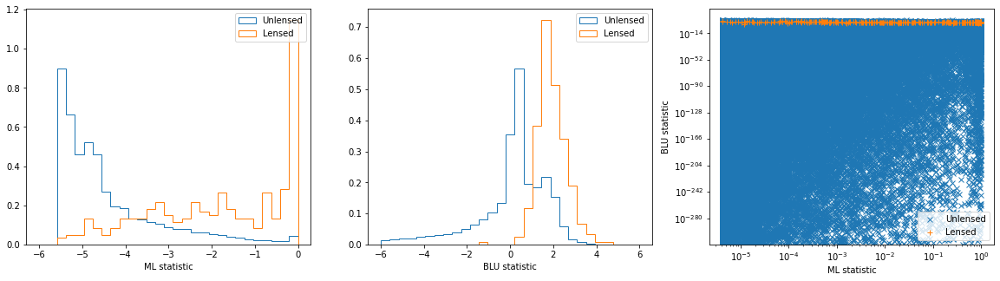

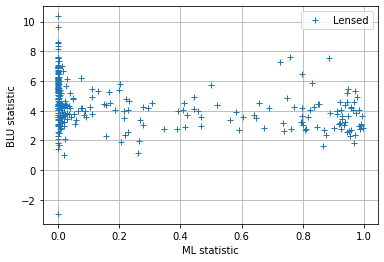

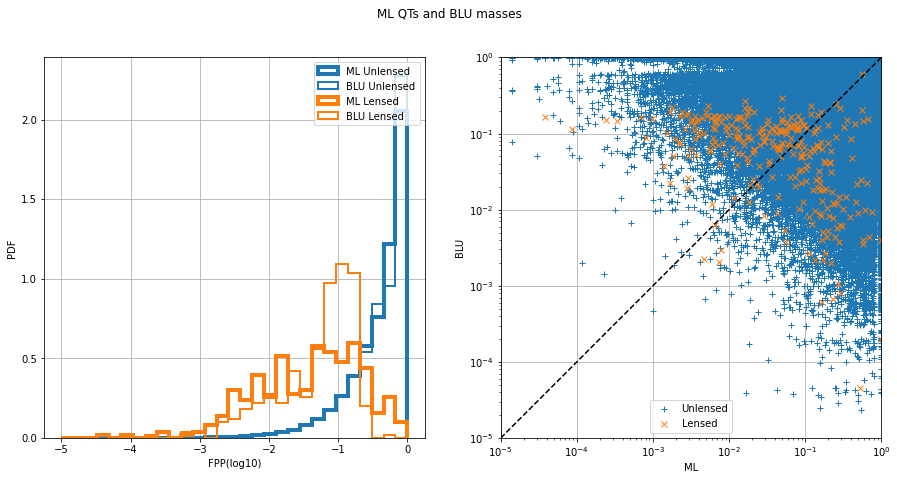

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8891006245302466, 'val_xgb_dense_QTS_0_roc': 0.9589896609479213, 'test_xgb_dense_QTS_0_acc': 0.9879969587226635, 'val_xgb_dense_QTS_0_acc': 0.9962128778133764, 'test_xgb_dense_QTS_0_f1': 0.024076785423783956, 'val_xgb_dense_QTS_0_f1': 0.27300613496932513}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9589


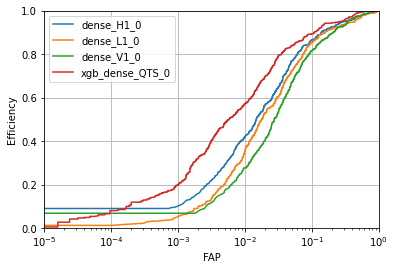

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8890
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

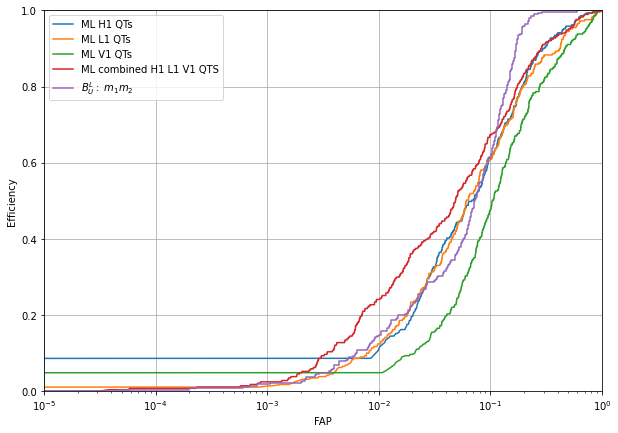

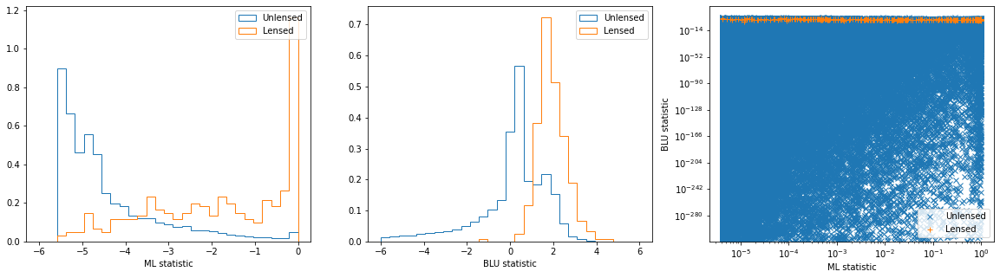

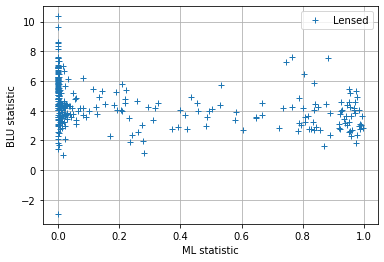

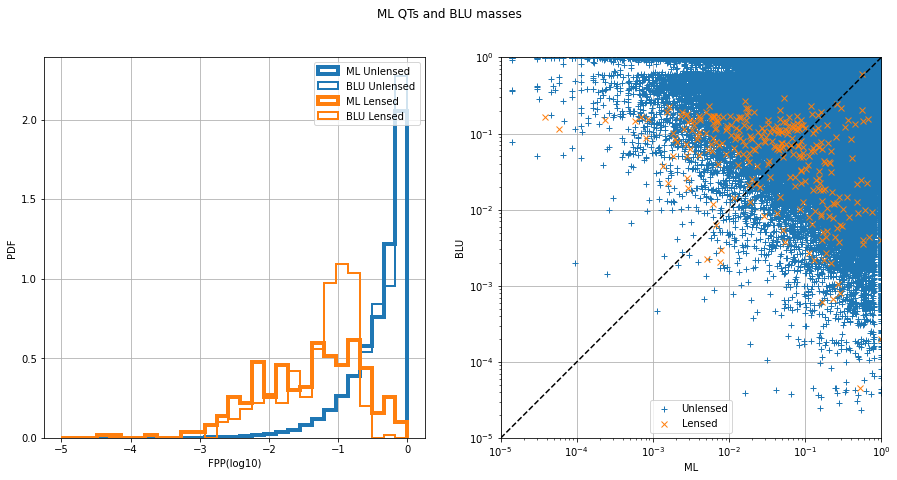

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8889995094672489, 'val_xgb_dense_QTS_0_roc': 0.9588875821873625, 'test_xgb_dense_QTS_0_acc': 0.9874627343484264, 'val_xgb_dense_QTS_0_acc': 0.9961649395578495, 'test_xgb_dense_QTS_0_f1': 0.023683390464319103, 'val_xgb_dense_QTS_0_f1': 0.2792792792792793}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


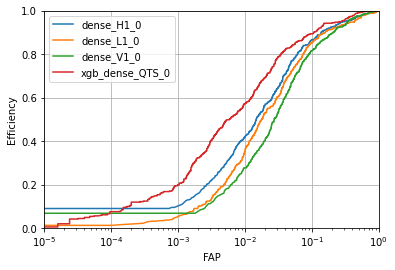

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8888
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

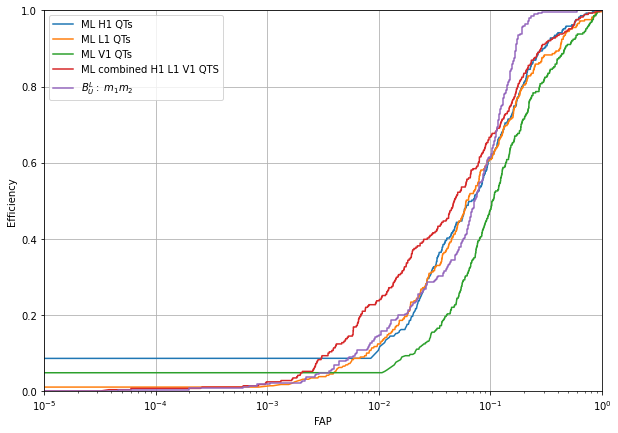

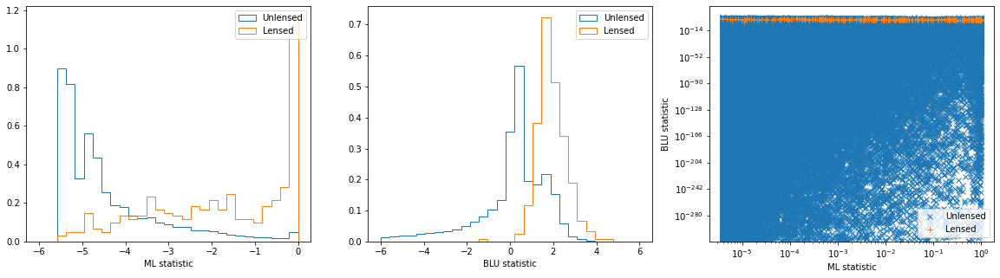

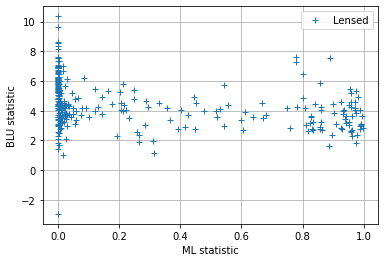

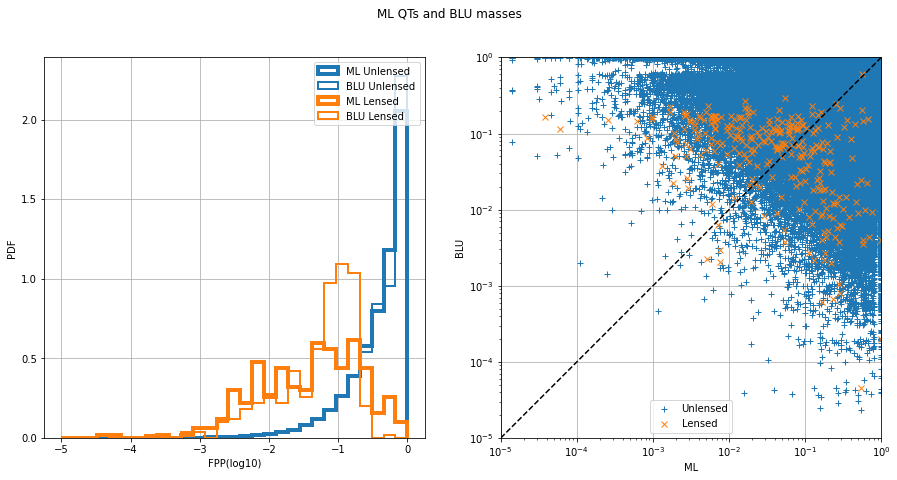

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8888178429012678, 'val_xgb_dense_QTS_0_roc': 0.9590223382143577, 'test_xgb_dense_QTS_0_acc': 0.9869905360251305, 'val_xgb_dense_QTS_0_acc': 0.9961489601393405, 'test_xgb_dense_QTS_0_f1': 0.023723723723723725, 'val_xgb_dense_QTS_0_f1': 0.2869822485207101}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


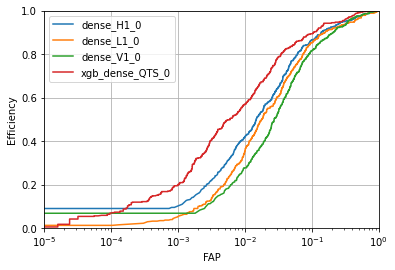

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8887
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

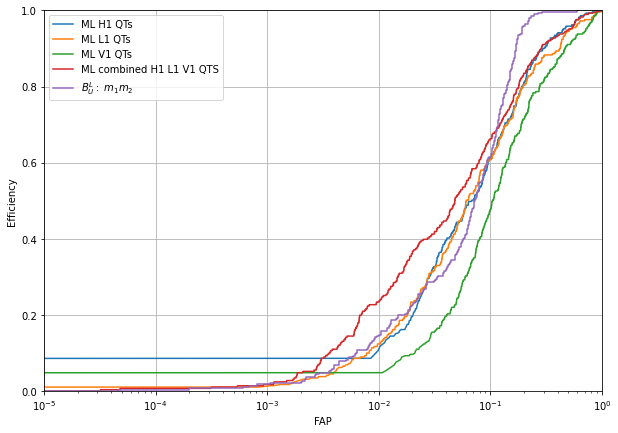

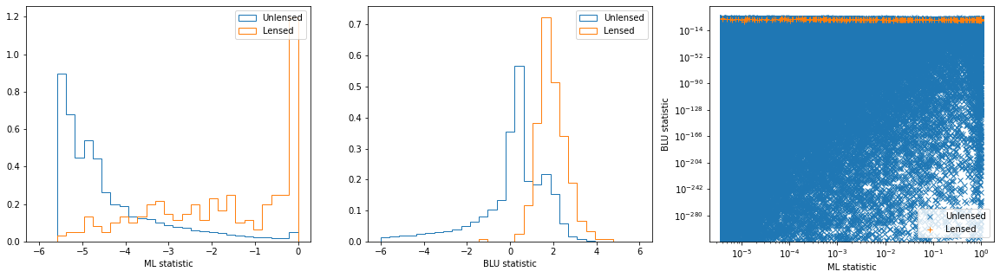

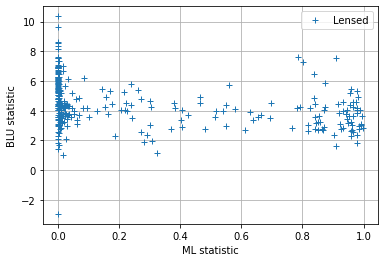

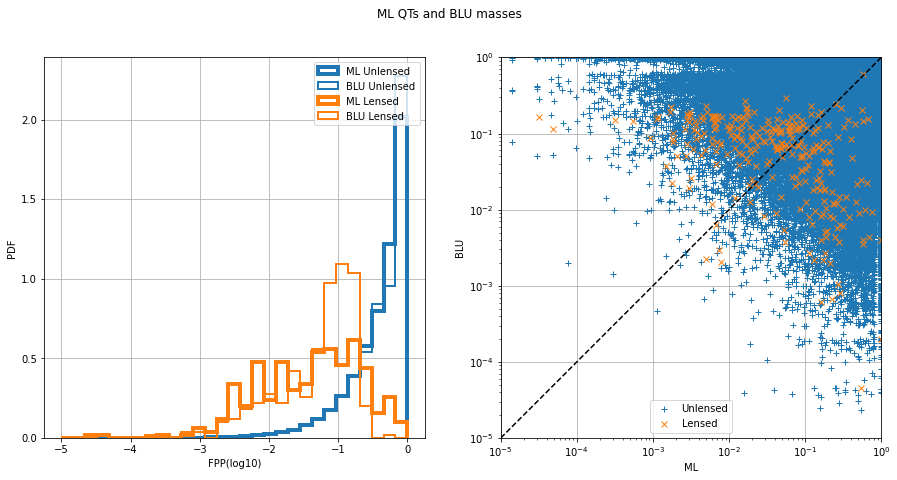

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8886667533652224, 'val_xgb_dense_QTS_0_roc': 0.9589910326343065, 'test_xgb_dense_QTS_0_acc': 0.986626383080894, 'val_xgb_dense_QTS_0_acc': 0.9961329807208316, 'test_xgb_dense_QTS_0_f1': 0.023378141437755698, 'val_xgb_dense_QTS_0_f1': 0.29032258064516125}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


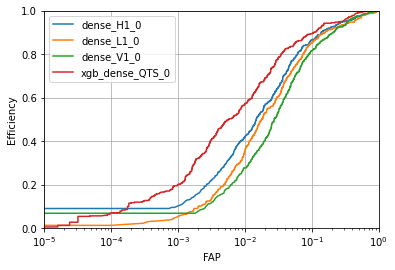

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8887
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

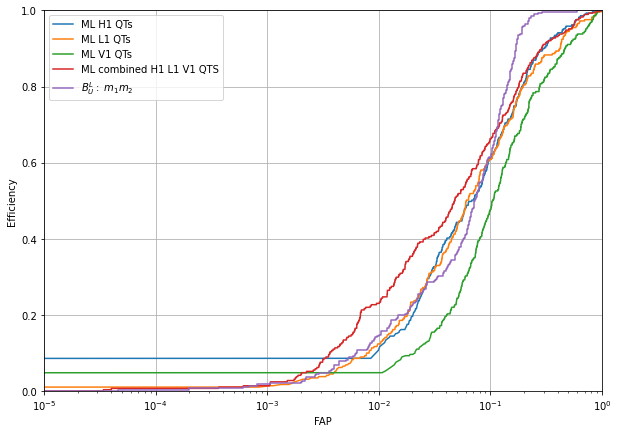

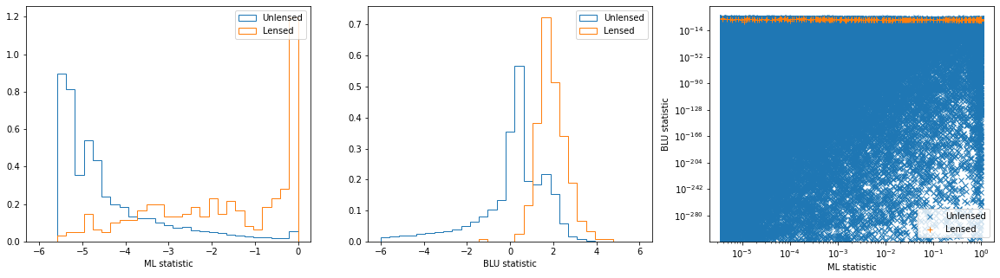

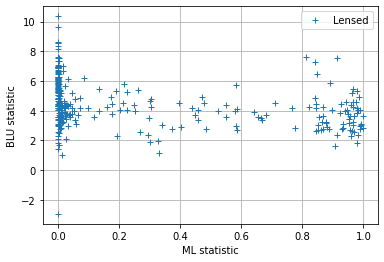

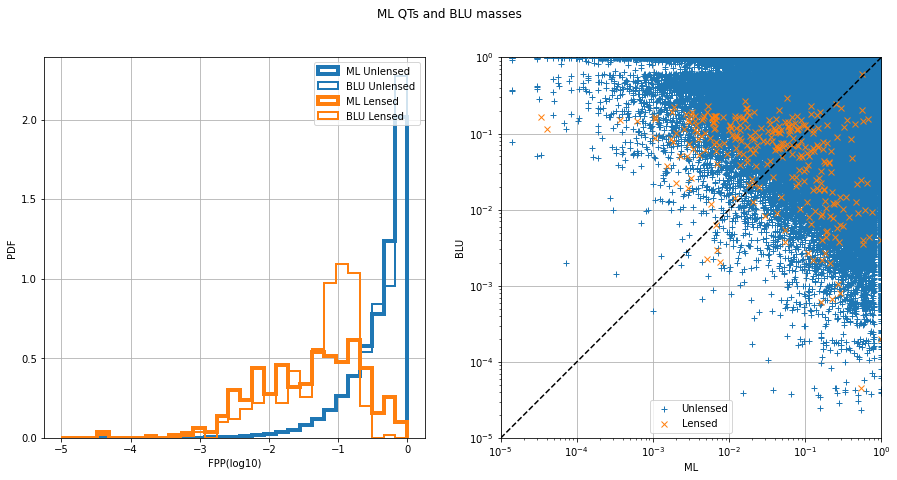

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8887375115501471, 'val_xgb_dense_QTS_0_roc': 0.9589503392715486, 'test_xgb_dense_QTS_0_acc': 0.9862842393805398, 'val_xgb_dense_QTS_0_acc': 0.9961090115930681, 'test_xgb_dense_QTS_0_f1': 0.022808267997148968, 'val_xgb_dense_QTS_0_f1': 0.29317851959361396}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9596


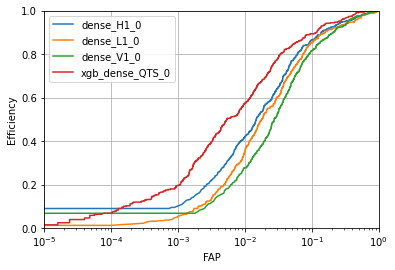

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

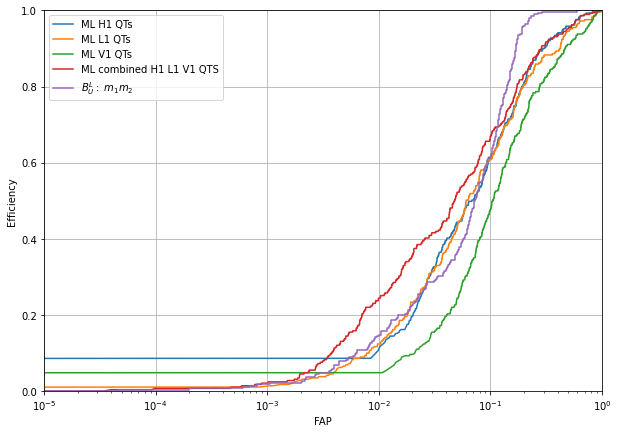

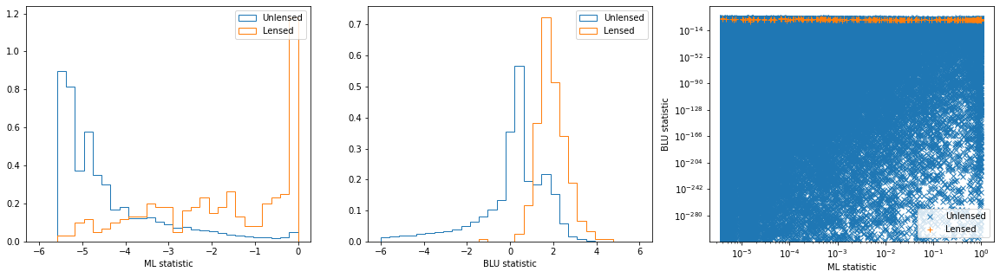

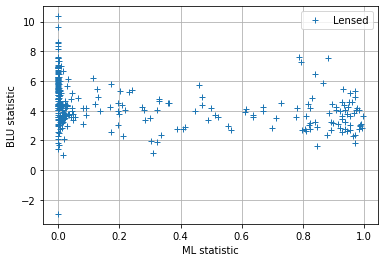

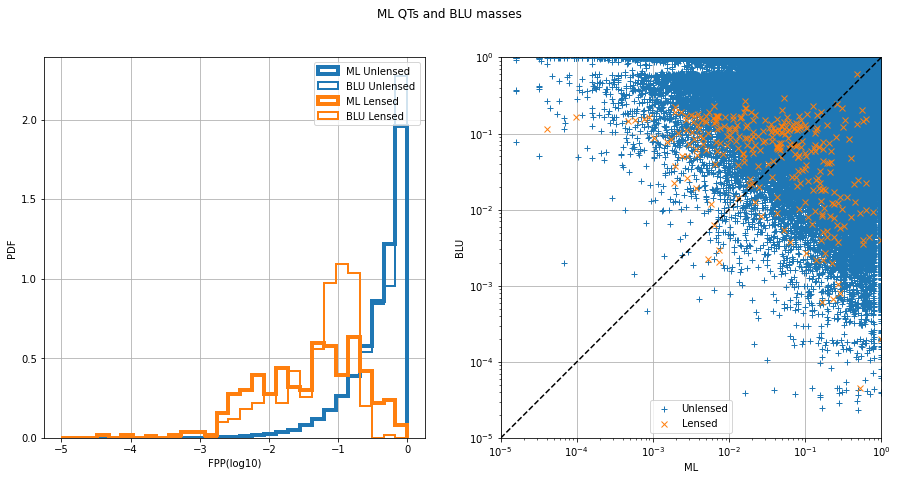

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8895420943744394, 'val_xgb_dense_QTS_0_roc': 0.9596470392159105, 'test_xgb_dense_QTS_0_acc': 0.9871966225814842, 'val_xgb_dense_QTS_0_acc': 0.996156949848595, 'test_xgb_dense_QTS_0_f1': 0.02379862700228833, 'val_xgb_dense_QTS_0_f1': 0.28528974739970286}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9597


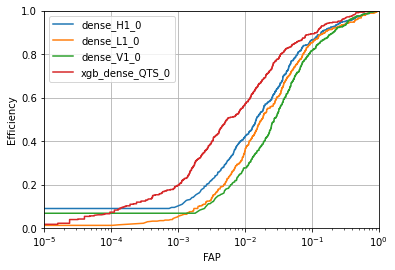

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

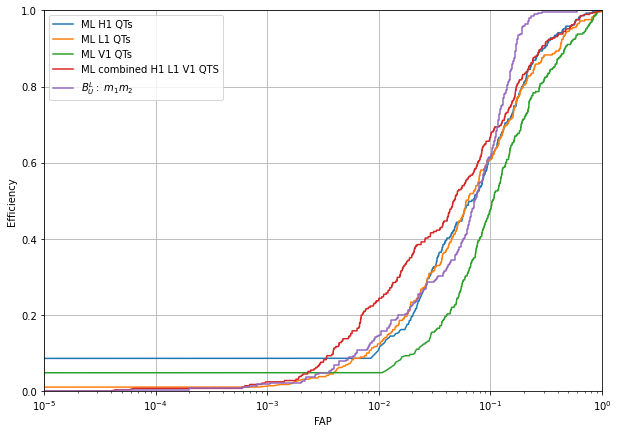

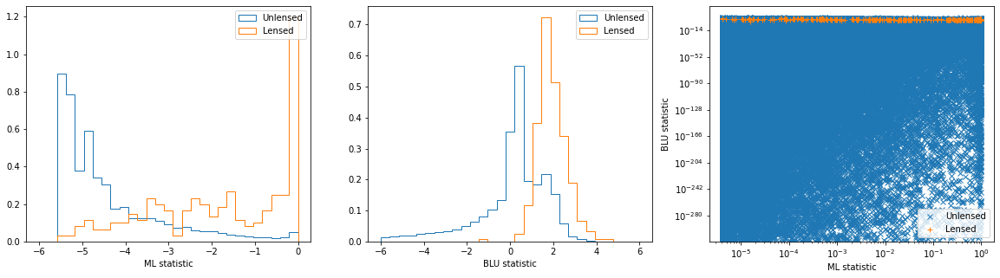

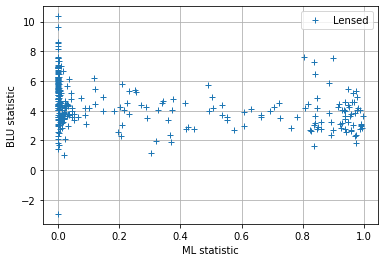

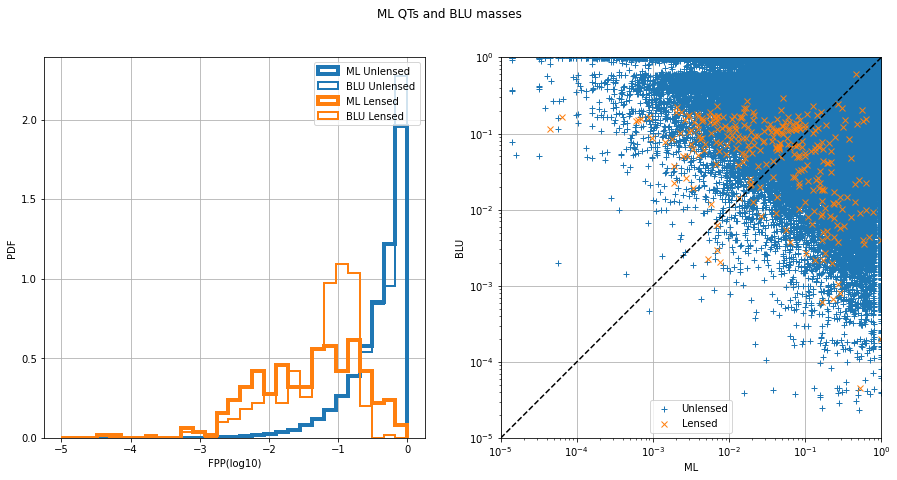

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8895289127816037, 'val_xgb_dense_QTS_0_roc': 0.9596511542750658, 'test_xgb_dense_QTS_0_acc': 0.9864463074491286, 'val_xgb_dense_QTS_0_acc': 0.9960610733375412, 'test_xgb_dense_QTS_0_f1': 0.023356401384083045, 'val_xgb_dense_QTS_0_f1': 0.2906474820143885}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9596


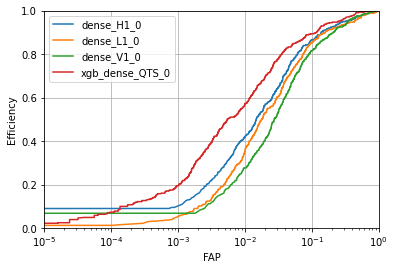

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8896
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

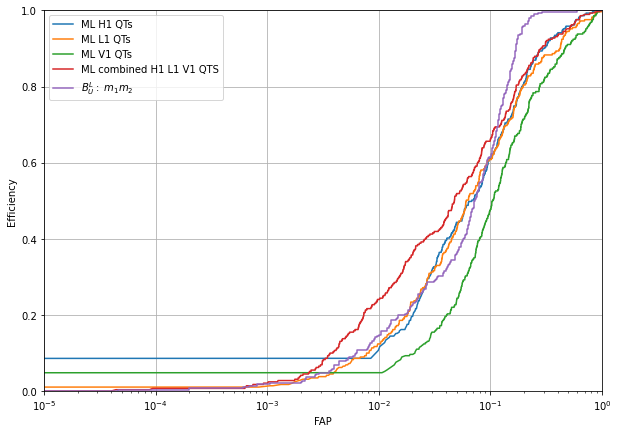

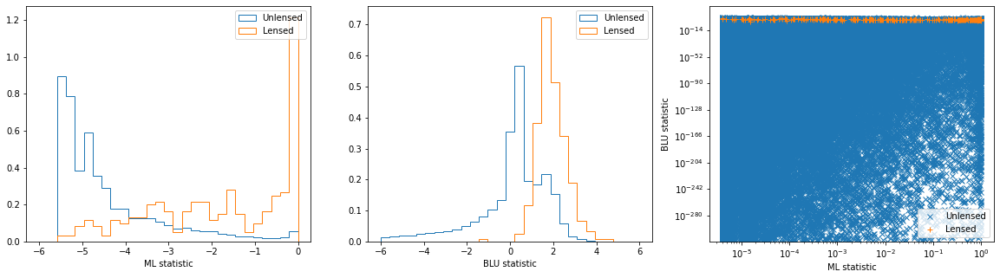

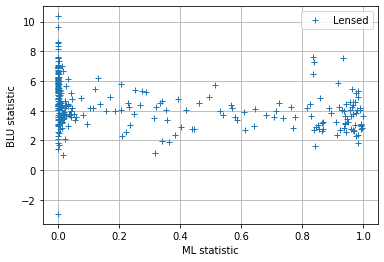

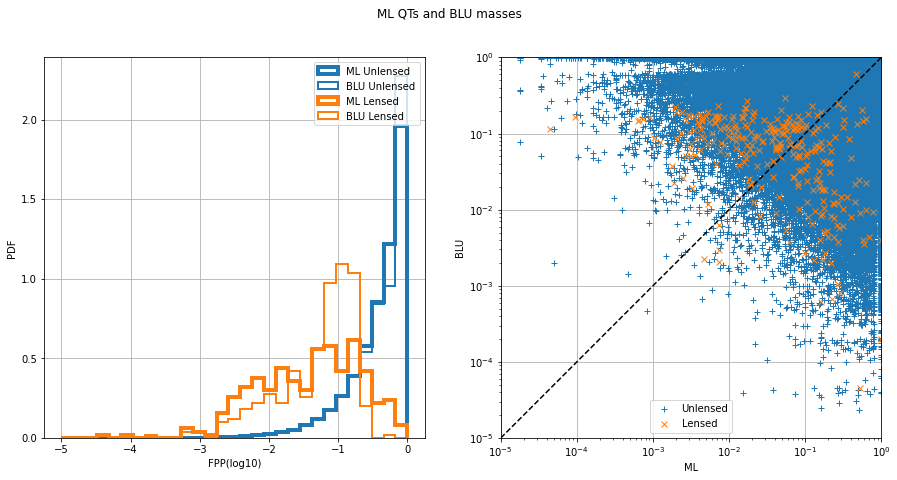

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8896094470852234, 'val_xgb_dense_QTS_0_roc': 0.9596101690641411, 'test_xgb_dense_QTS_0_acc': 0.9859761099661858, 'val_xgb_dense_QTS_0_acc': 0.9960211247912688, 'test_xgb_dense_QTS_0_f1': 0.02286351596263767, 'val_xgb_dense_QTS_0_f1': 0.29461756373937675}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9595


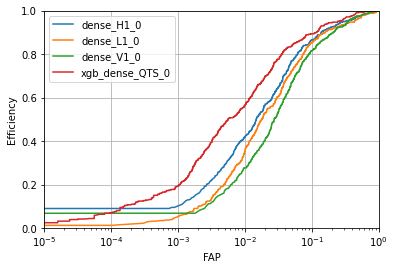

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8894
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

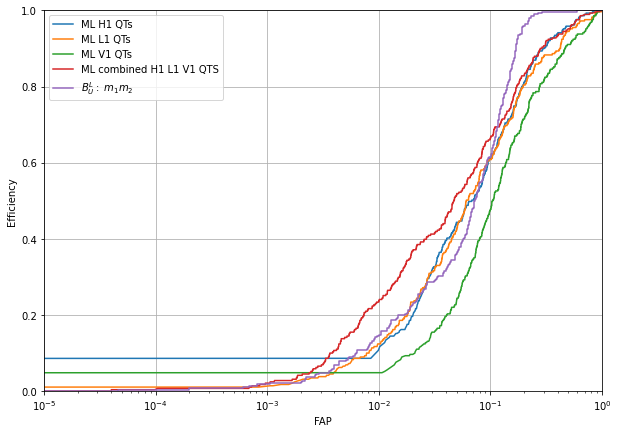

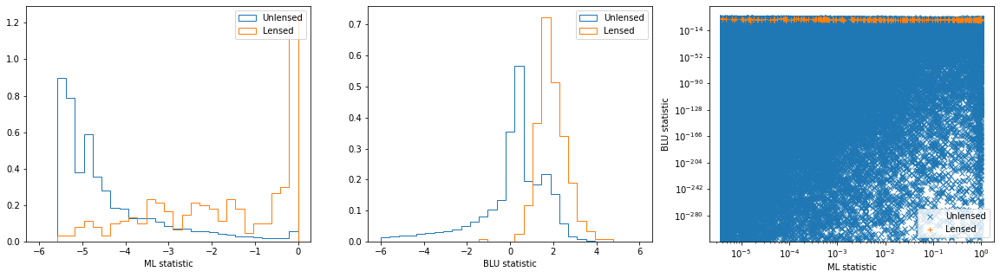

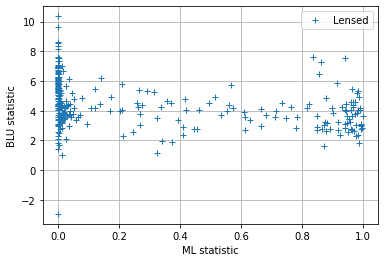

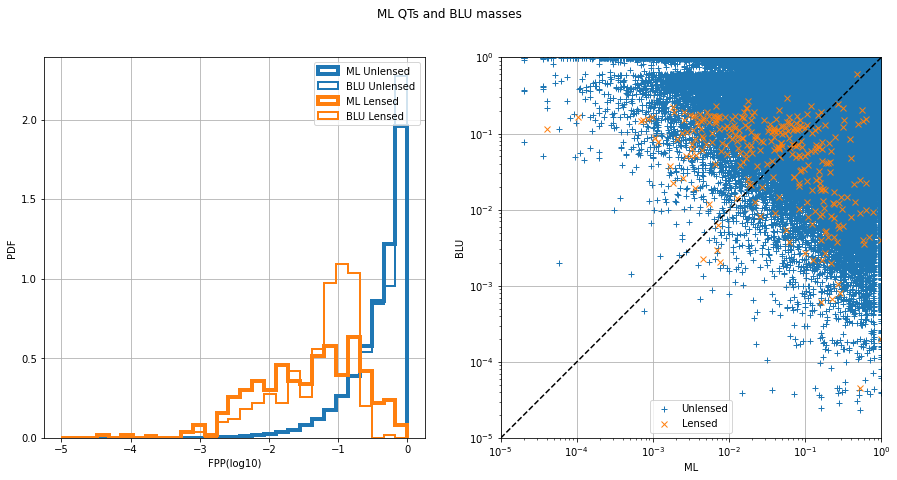

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.889367513946569, 'val_xgb_dense_QTS_0_roc': 0.9595132852009554, 'test_xgb_dense_QTS_0_acc': 0.9856059545008904, 'val_xgb_dense_QTS_0_acc': 0.9960211247912688, 'test_xgb_dense_QTS_0_f1': 0.022554347826086955, 'val_xgb_dense_QTS_0_f1': 0.300561797752809}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9594


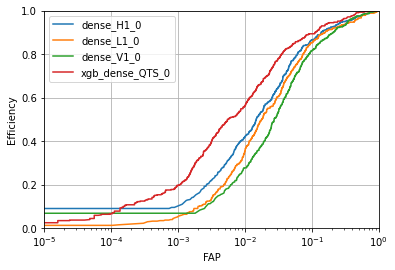

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8891
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

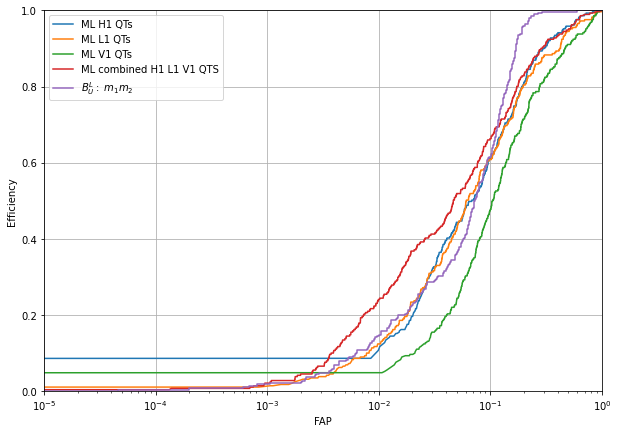

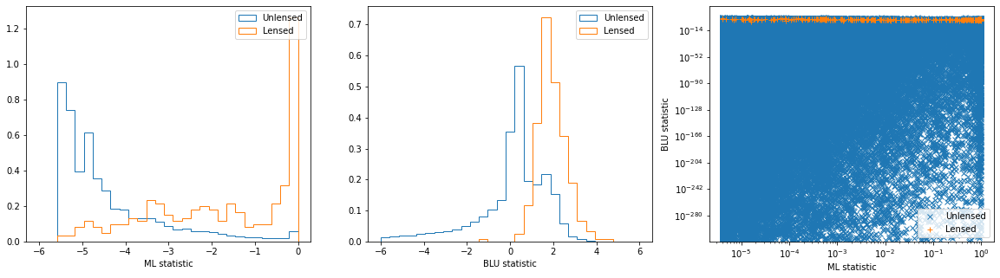

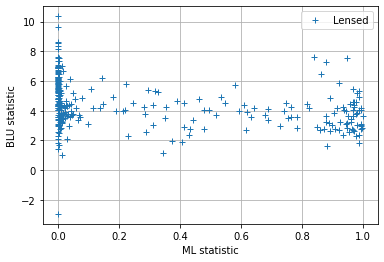

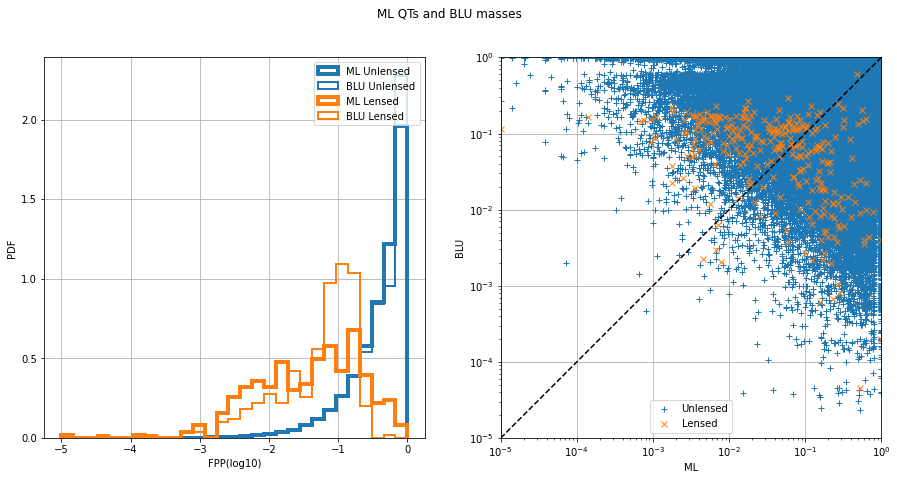

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8891413319857837, 'val_xgb_dense_QTS_0_roc': 0.9594147572597621, 'test_xgb_dense_QTS_0_acc': 0.9852157906320654, 'val_xgb_dense_QTS_0_acc': 0.9959891659542509, 'test_xgb_dense_QTS_0_f1': 0.0222310440651052, 'val_xgb_dense_QTS_0_f1': 0.3047091412742382}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9598


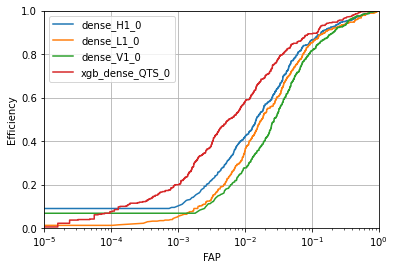

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8896
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

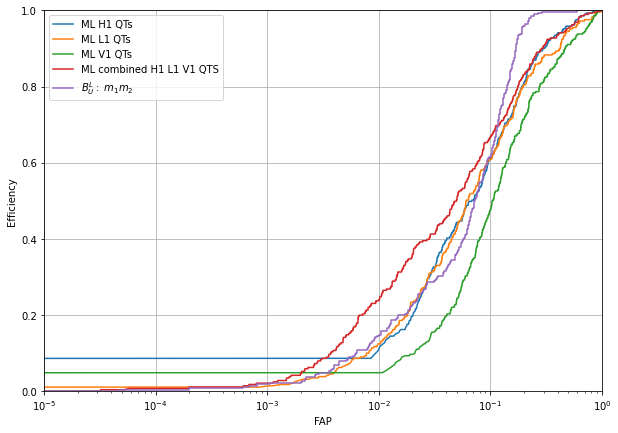

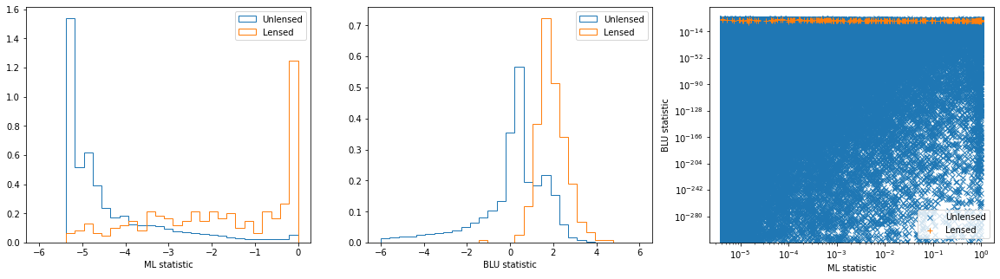

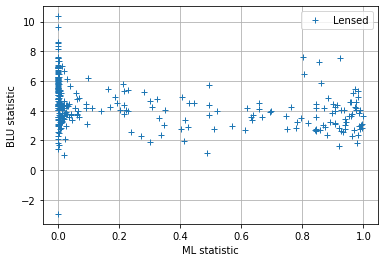

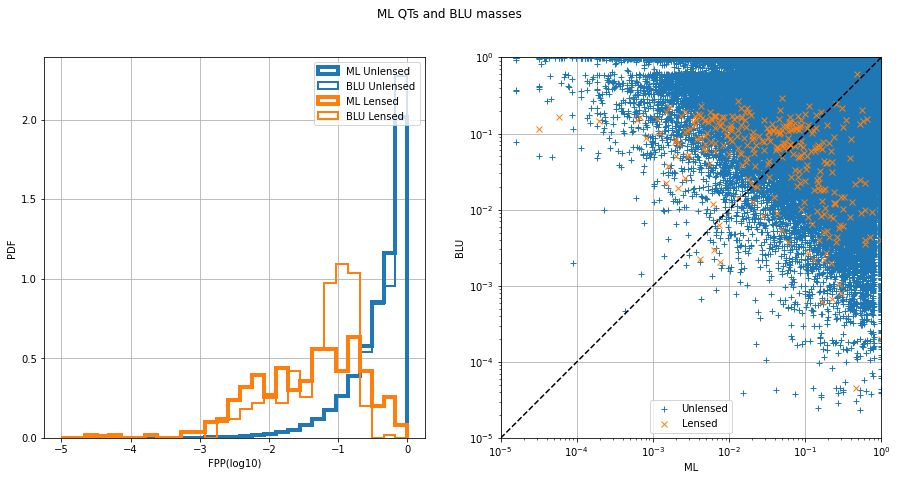

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8896405916941834, 'val_xgb_dense_QTS_0_roc': 0.9597504507497657, 'test_xgb_dense_QTS_0_acc': 0.986584365433482, 'val_xgb_dense_QTS_0_acc': 0.9961170013023226, 'test_xgb_dense_QTS_0_f1': 0.02330662782228696, 'val_xgb_dense_QTS_0_f1': 0.2915451895043732}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9597


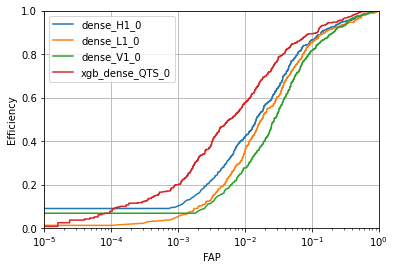

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8896
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

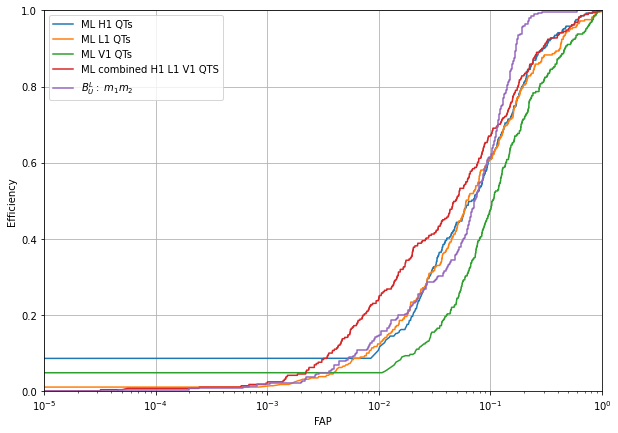

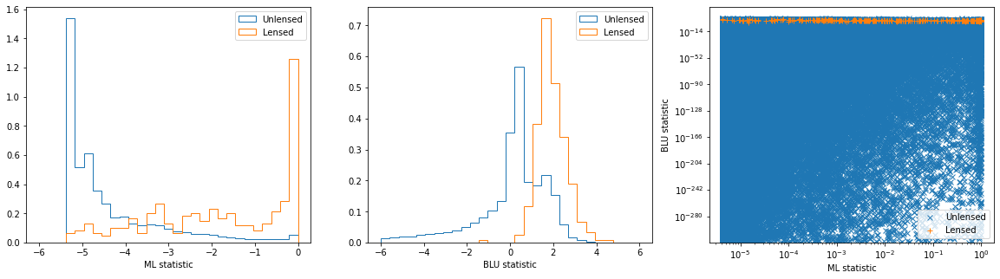

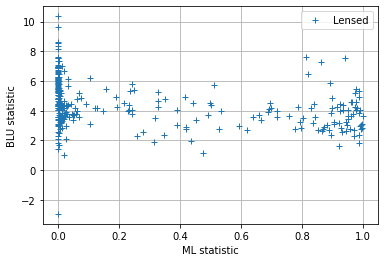

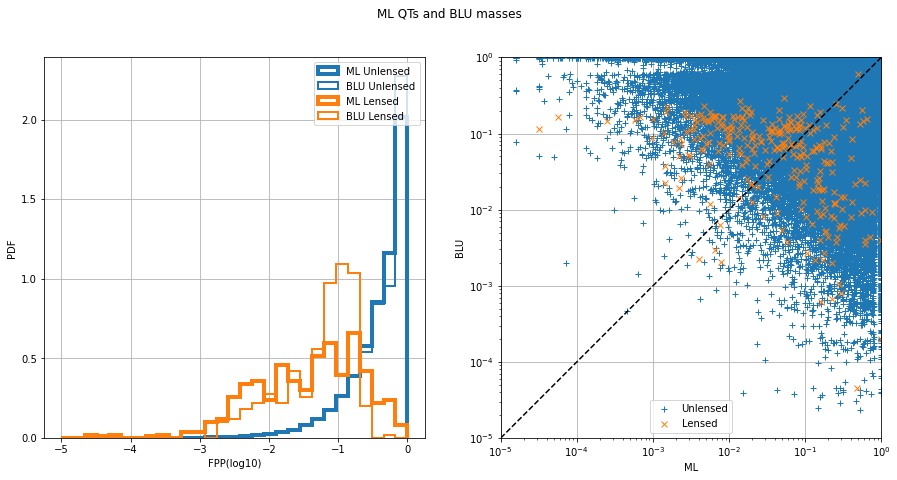

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8895529506132155, 'val_xgb_dense_QTS_0_roc': 0.9596533334080466, 'test_xgb_dense_QTS_0_acc': 0.9860241301346565, 'val_xgb_dense_QTS_0_acc': 0.9960850424653047, 'test_xgb_dense_QTS_0_f1': 0.022940271366624704, 'val_xgb_dense_QTS_0_f1': 0.2979942693409742}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9596


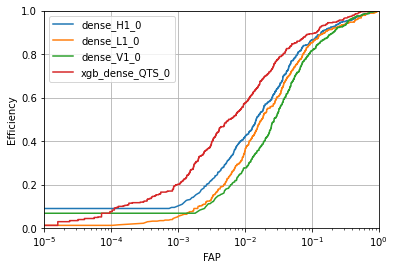

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8894
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

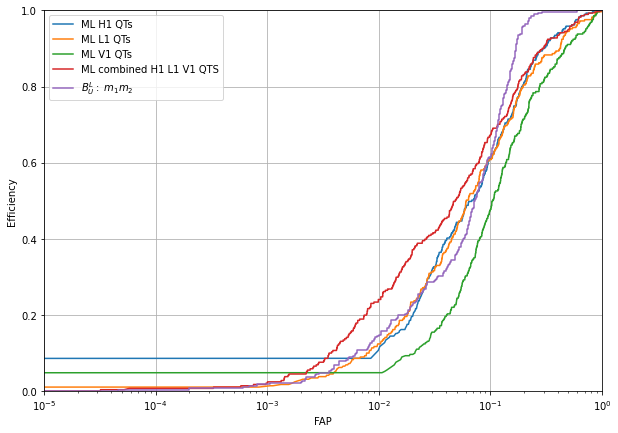

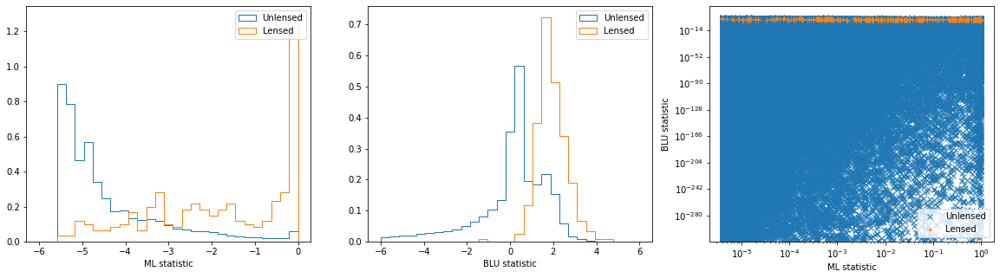

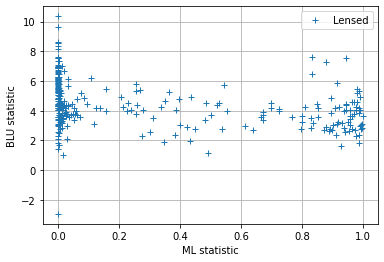

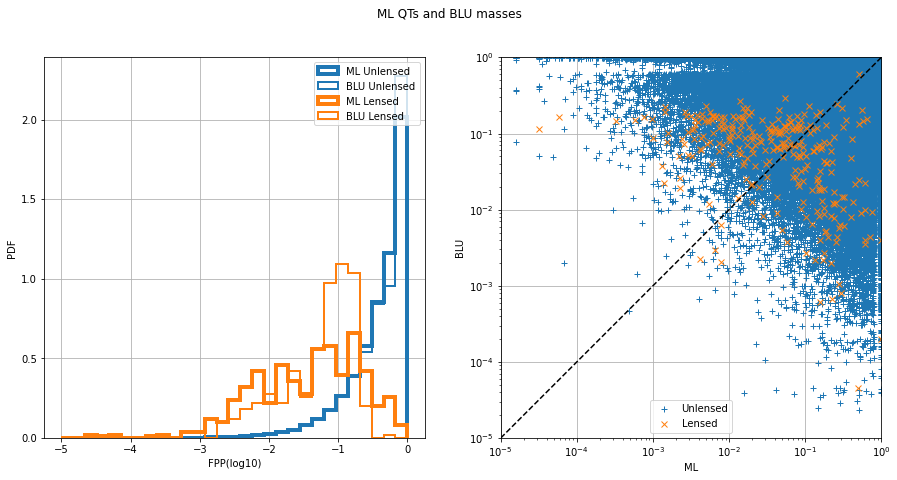

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8894059476461393, 'val_xgb_dense_QTS_0_roc': 0.9595948178505544, 'test_xgb_dense_QTS_0_acc': 0.9856279637447728, 'val_xgb_dense_QTS_0_acc': 0.9960450939190323, 'test_xgb_dense_QTS_0_f1': 0.022854033464834715, 'val_xgb_dense_QTS_0_f1': 0.30575035063113604}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9596


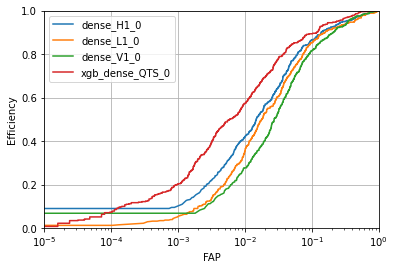

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8893
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

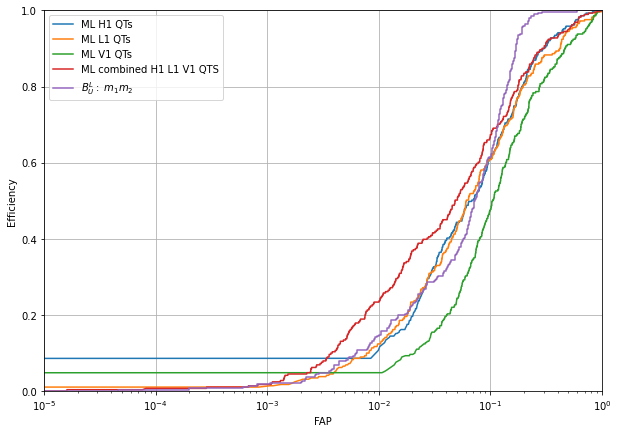

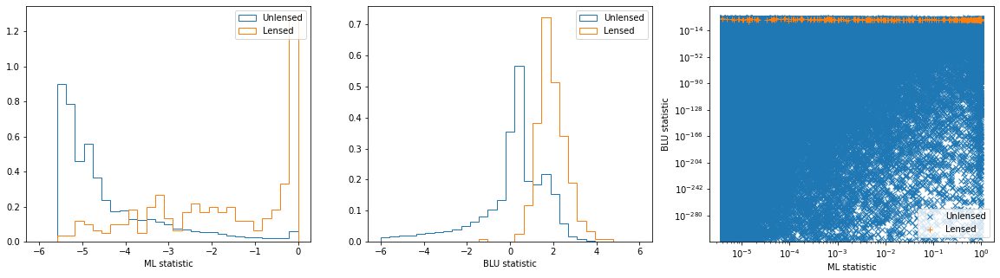

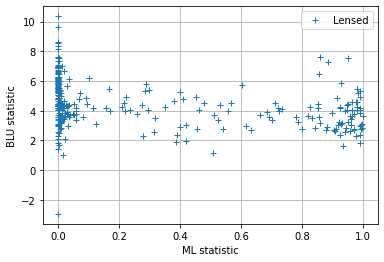

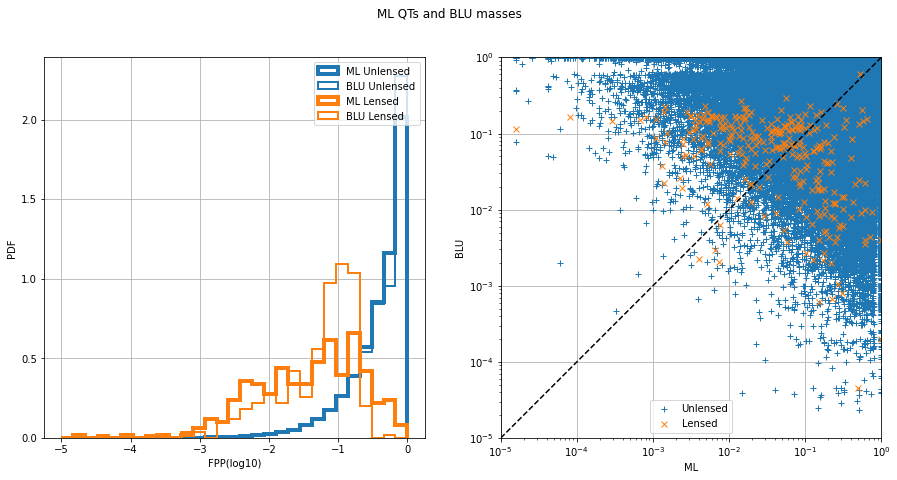

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8893459218645674, 'val_xgb_dense_QTS_0_roc': 0.9596376222483874, 'test_xgb_dense_QTS_0_acc': 0.9852137897917125, 'val_xgb_dense_QTS_0_acc': 0.995973186535742, 'test_xgb_dense_QTS_0_f1': 0.02274530547474213, 'val_xgb_dense_QTS_0_f1': 0.3019390581717452}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9595


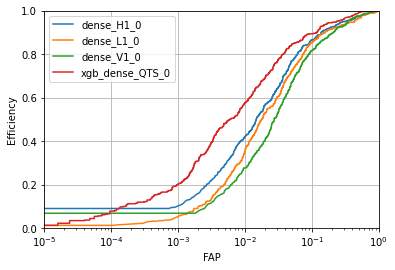

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8890
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

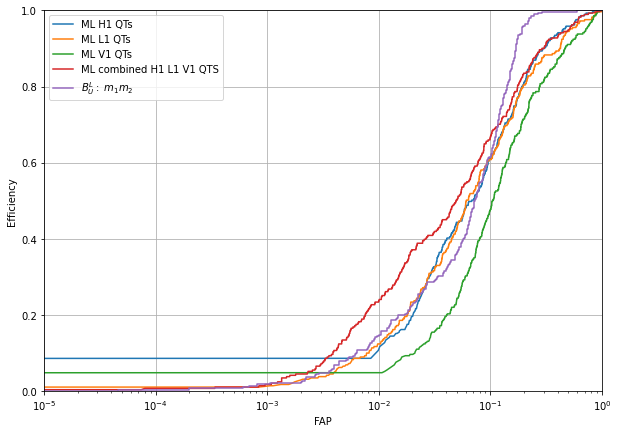

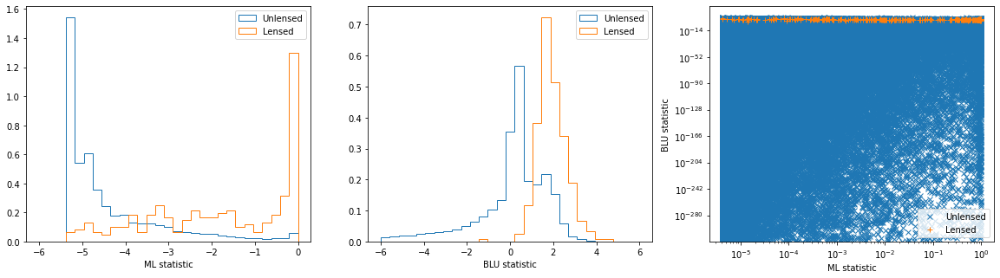

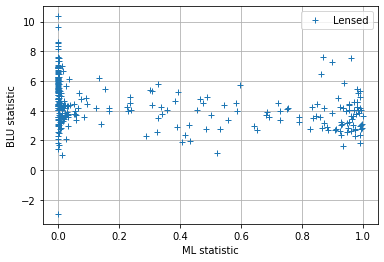

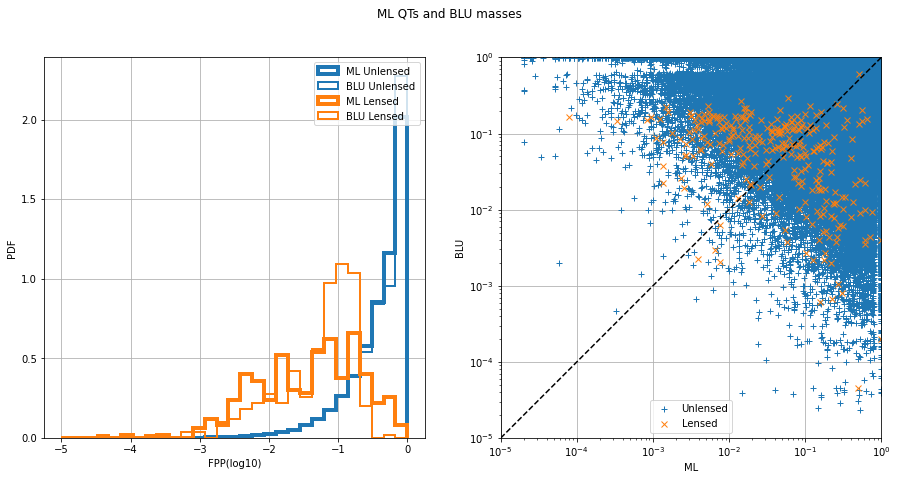

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8890402306822776, 'val_xgb_dense_QTS_0_roc': 0.9595001520334384, 'test_xgb_dense_QTS_0_acc': 0.984847636007123, 'val_xgb_dense_QTS_0_acc': 0.9959412276987241, 'test_xgb_dense_QTS_0_f1': 0.02220787604906391, 'val_xgb_dense_QTS_0_f1': 0.30601092896174864}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


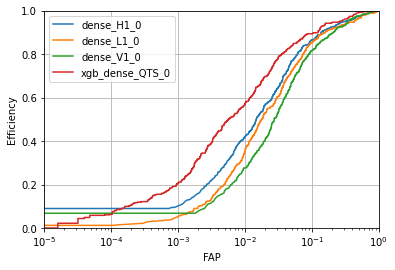

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8892
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

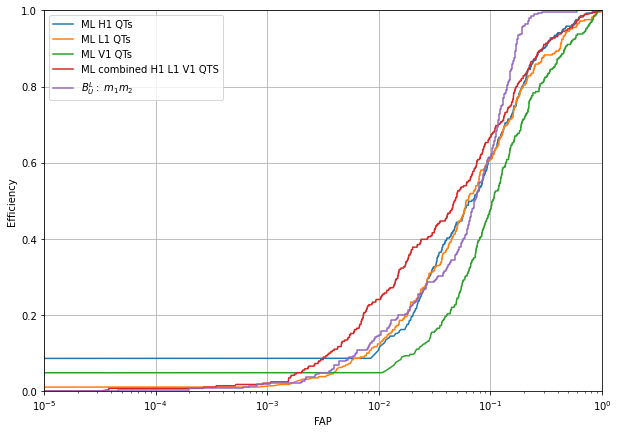

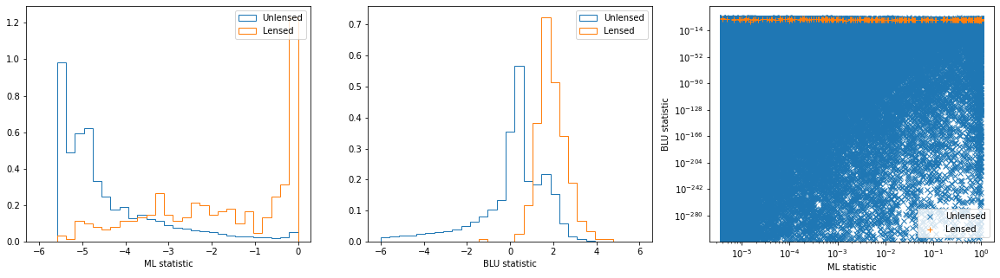

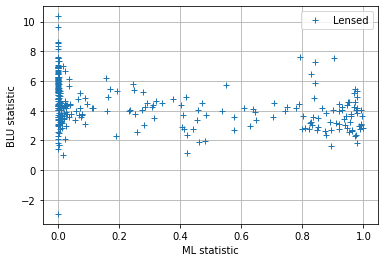

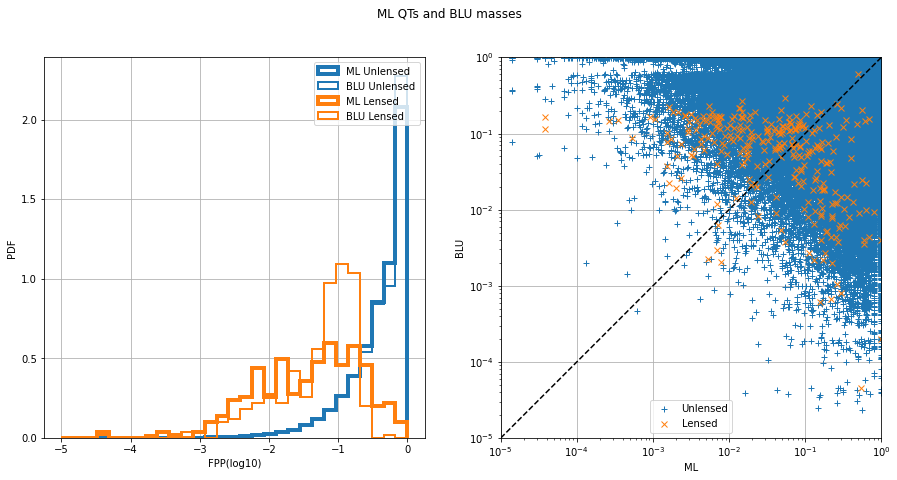

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.889179535213872, 'val_xgb_dense_QTS_0_roc': 0.959016793099184, 'test_xgb_dense_QTS_0_acc': 0.9863602713139519, 'val_xgb_dense_QTS_0_acc': 0.9960850424653047, 'test_xgb_dense_QTS_0_f1': 0.022652329749103944, 'val_xgb_dense_QTS_0_f1': 0.2959770114942529}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


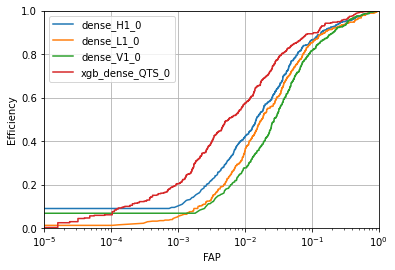

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8891
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

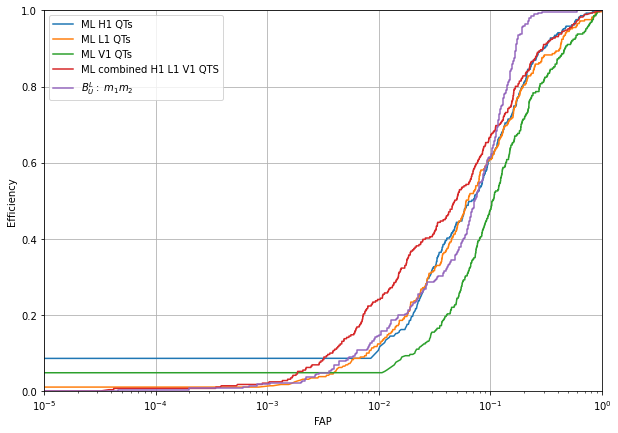

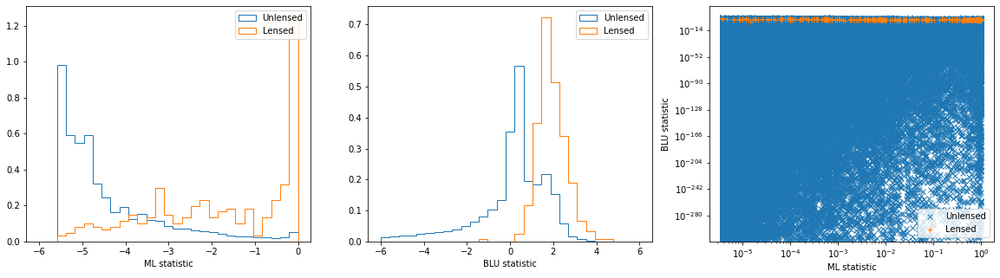

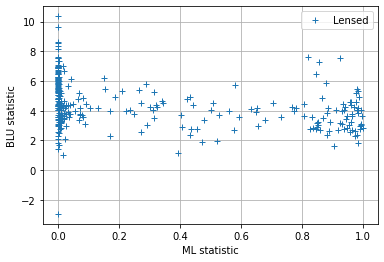

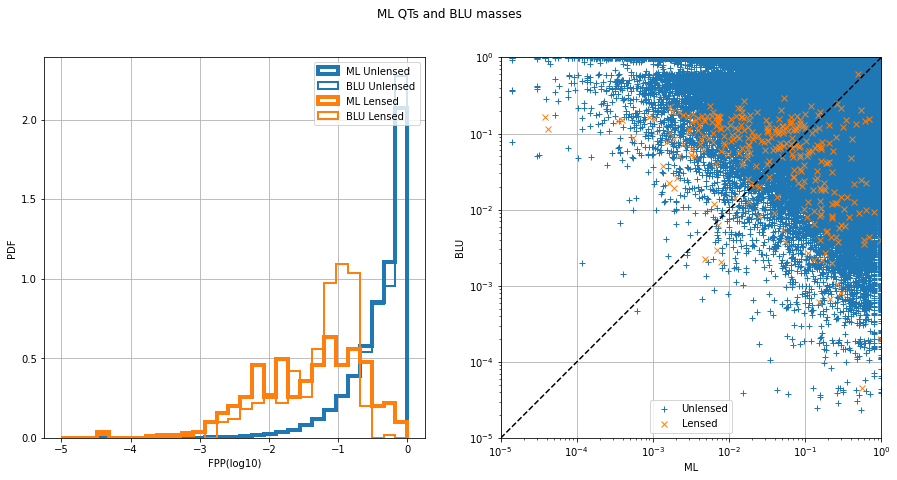

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8891007277264327, 'val_xgb_dense_QTS_0_roc': 0.9590068216201433, 'test_xgb_dense_QTS_0_acc': 0.985890073831009, 'val_xgb_dense_QTS_0_acc': 0.9960211247912688, 'test_xgb_dense_QTS_0_f1': 0.022998060404544194, 'val_xgb_dense_QTS_0_f1': 0.2926136363636364}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


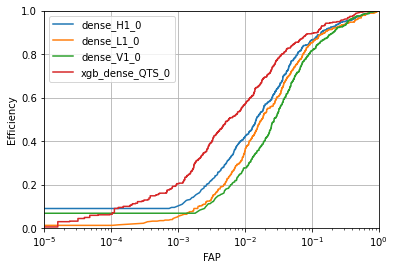

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8889
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

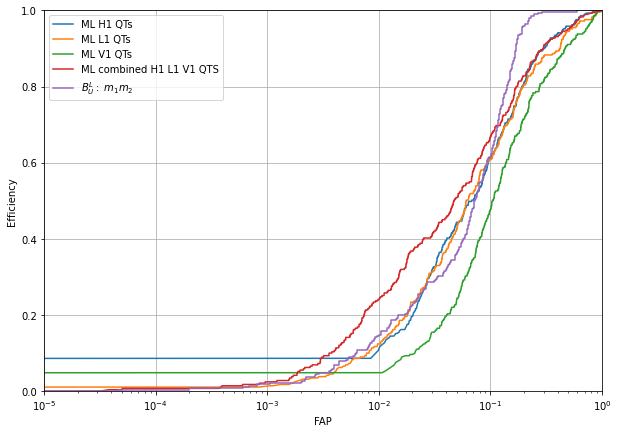

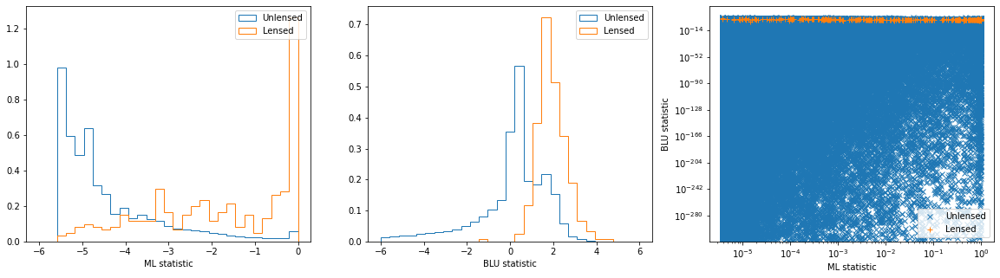

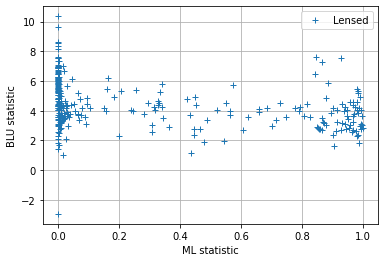

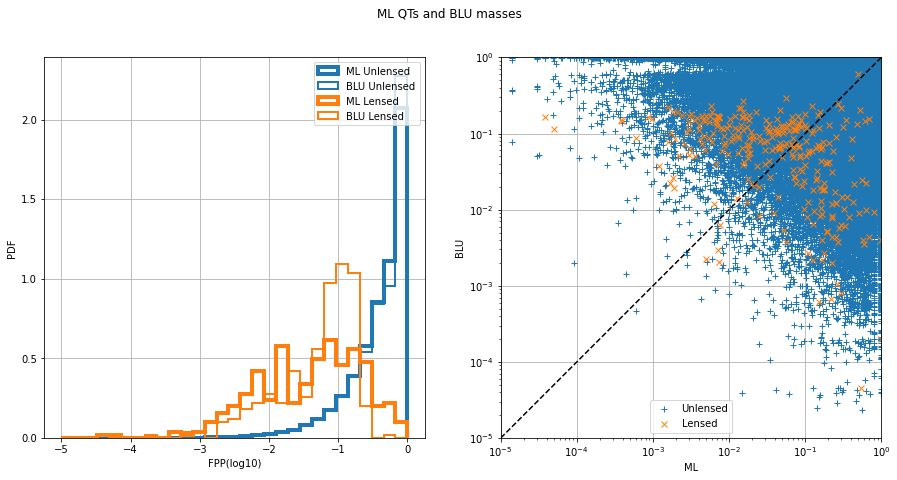

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8889421530270238, 'val_xgb_dense_QTS_0_roc': 0.9590403355179921, 'test_xgb_dense_QTS_0_acc': 0.9854839032393605, 'val_xgb_dense_QTS_0_acc': 0.9960131350820144, 'test_xgb_dense_QTS_0_f1': 0.02236895297129767, 'val_xgb_dense_QTS_0_f1': 0.30014025245441794}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


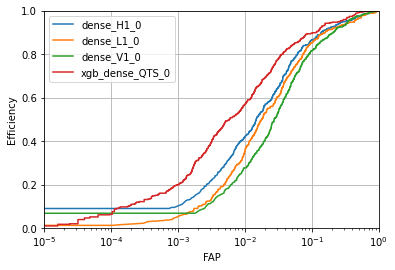

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8889
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

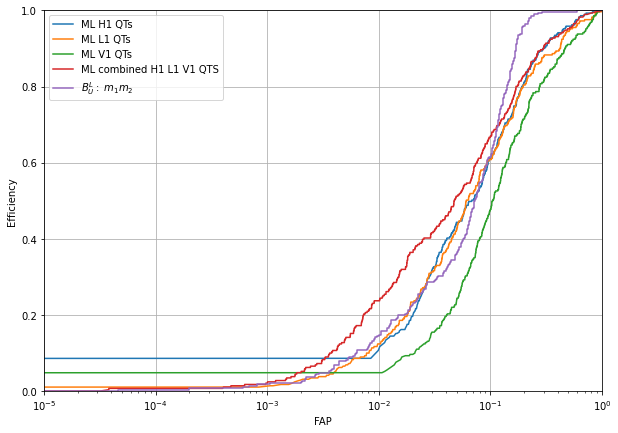

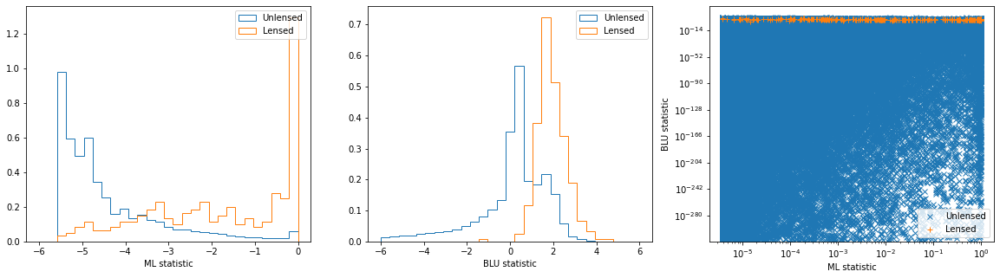

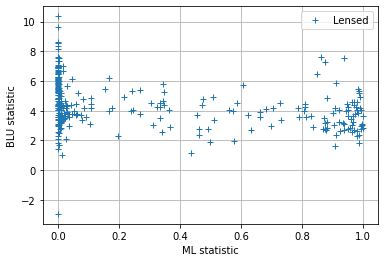

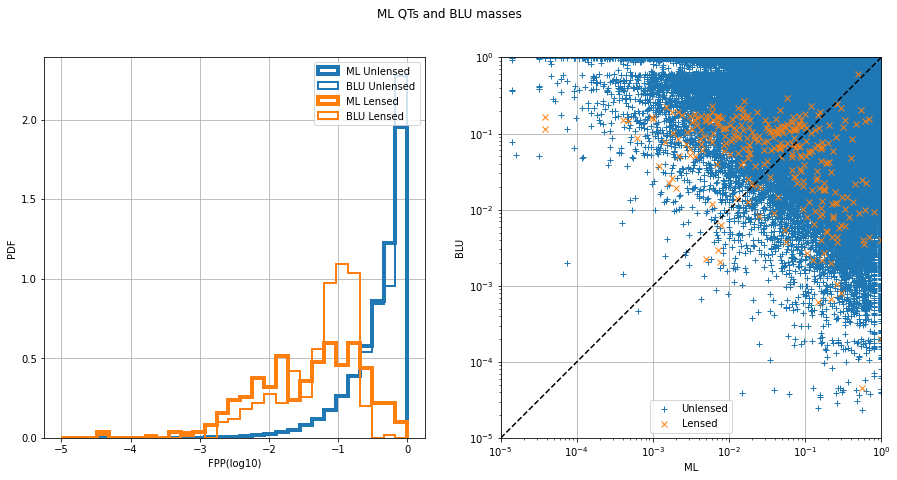

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8889320191615504, 'val_xgb_dense_QTS_0_roc': 0.959043944706991, 'test_xgb_dense_QTS_0_acc': 0.9850177074371236, 'val_xgb_dense_QTS_0_acc': 0.9959651968264874, 'test_xgb_dense_QTS_0_f1': 0.022199007573779052, 'val_xgb_dense_QTS_0_f1': 0.30344827586206896}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9590


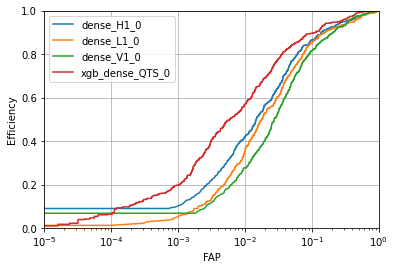

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8889
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

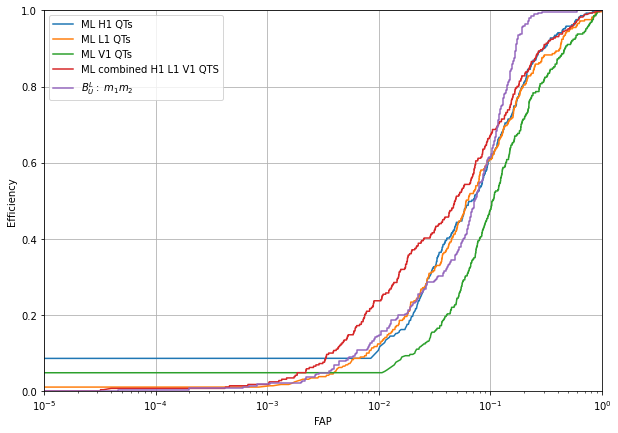

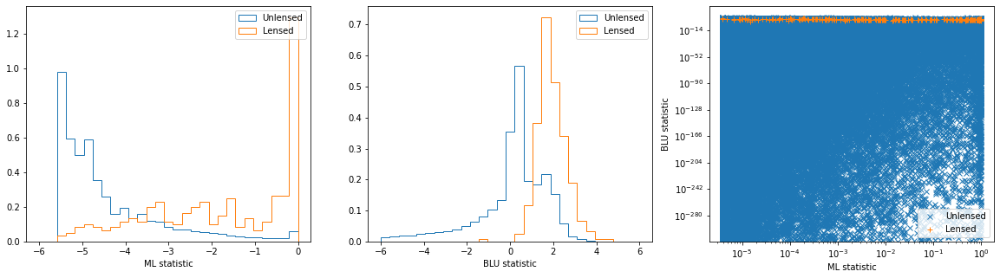

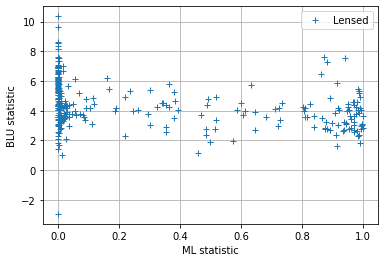

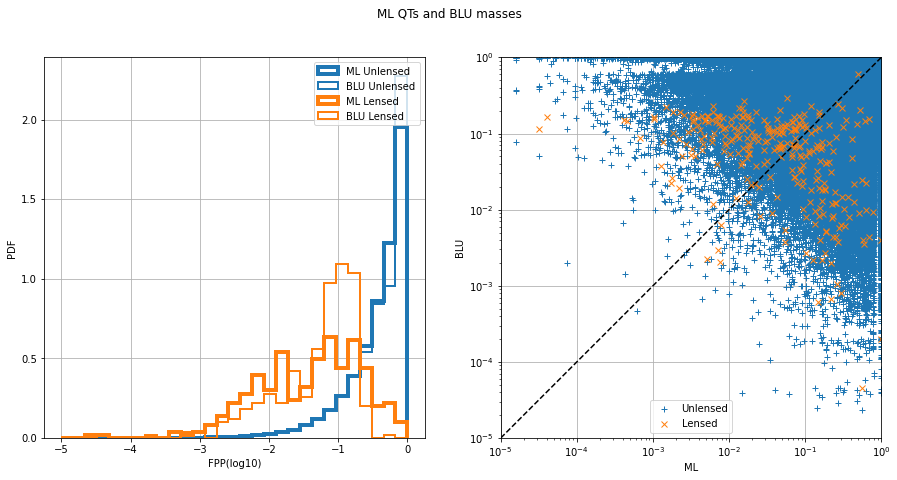

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8888724749621801, 'val_xgb_dense_QTS_0_roc': 0.9589669162474366, 'test_xgb_dense_QTS_0_acc': 0.9847115788631225, 'val_xgb_dense_QTS_0_acc': 0.9959332379894695, 'test_xgb_dense_QTS_0_f1': 0.022014591066171766, 'val_xgb_dense_QTS_0_f1': 0.305593451568895}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9598


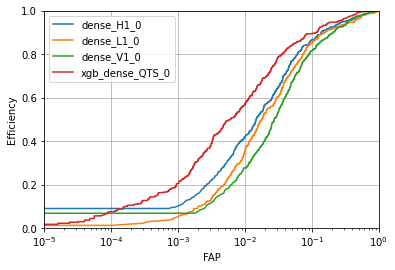

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8896
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

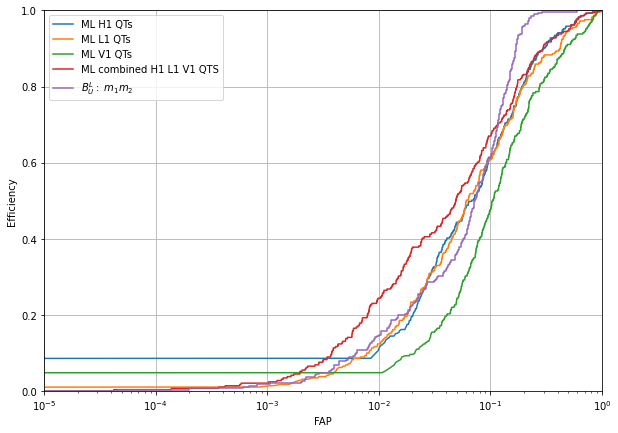

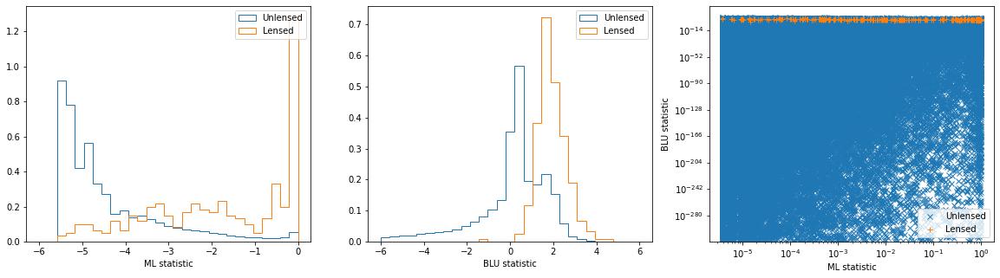

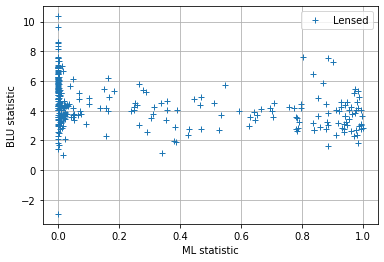

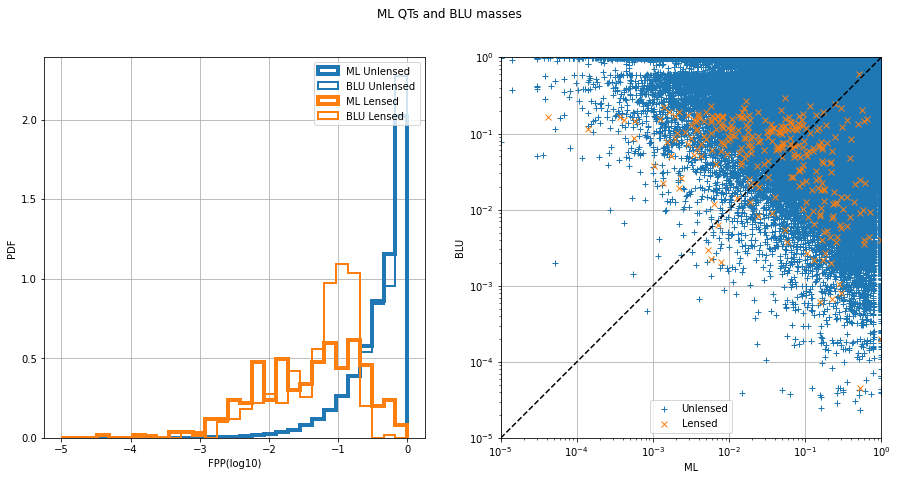

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8895922064424018, 'val_xgb_dense_QTS_0_roc': 0.9597676308785325, 'test_xgb_dense_QTS_0_acc': 0.9859360931591268, 'val_xgb_dense_QTS_0_acc': 0.9960530836282868, 'test_xgb_dense_QTS_0_f1': 0.022799944390379537, 'val_xgb_dense_QTS_0_f1': 0.29629629629629634}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9597


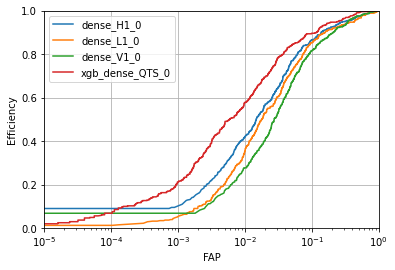

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

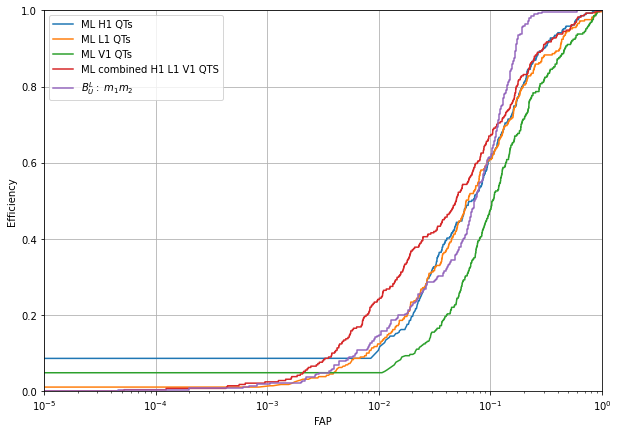

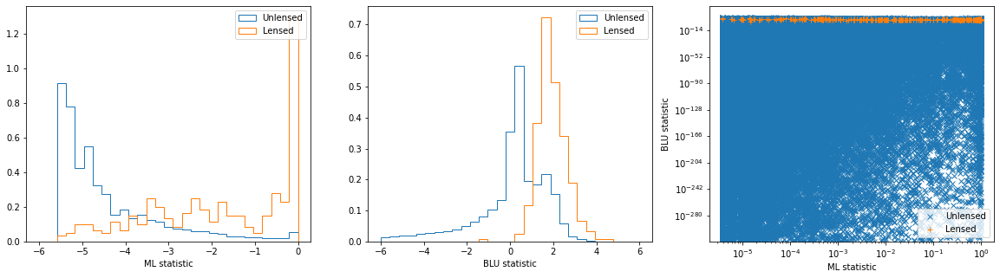

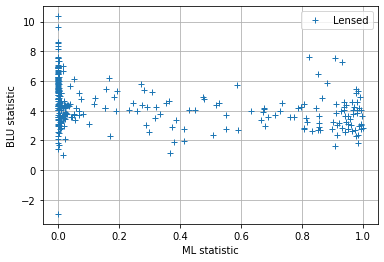

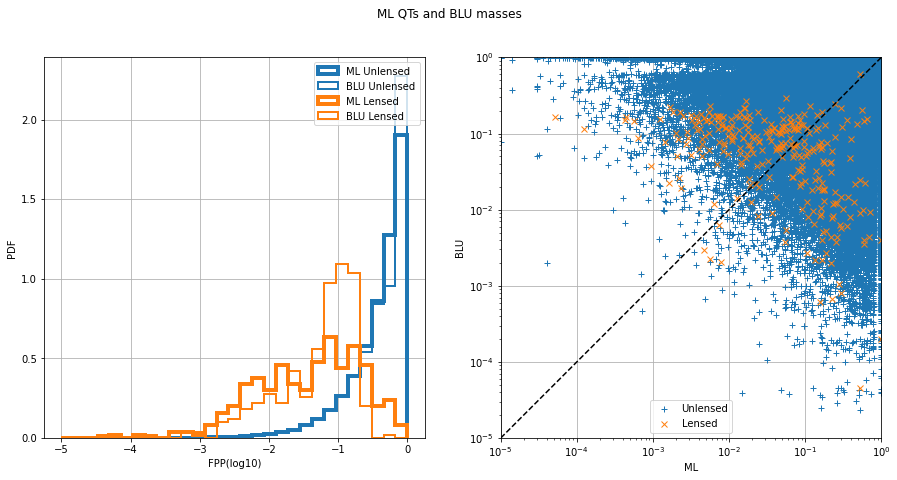

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8894675041711382, 'val_xgb_dense_QTS_0_roc': 0.9597336597518884, 'test_xgb_dense_QTS_0_acc': 0.9854318813901839, 'val_xgb_dense_QTS_0_acc': 0.9959811762449965, 'test_xgb_dense_QTS_0_f1': 0.022815729432290967, 'val_xgb_dense_QTS_0_f1': 0.29846582984658293}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9599


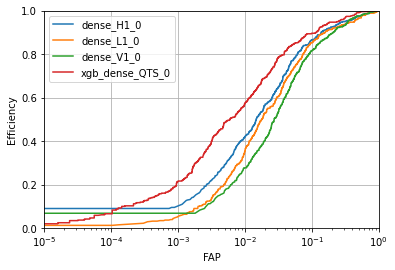

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

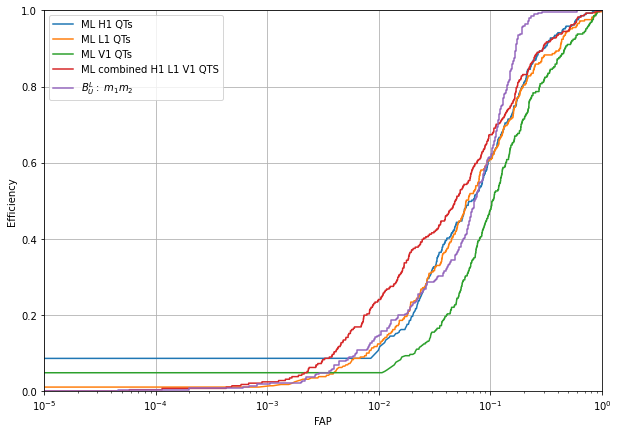

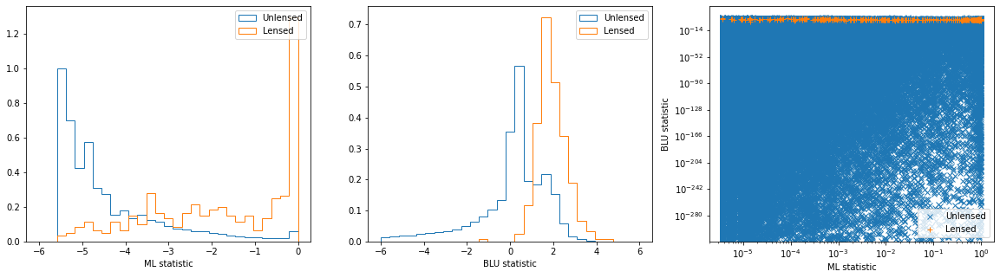

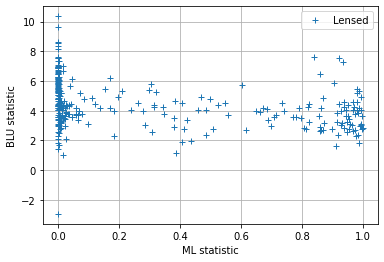

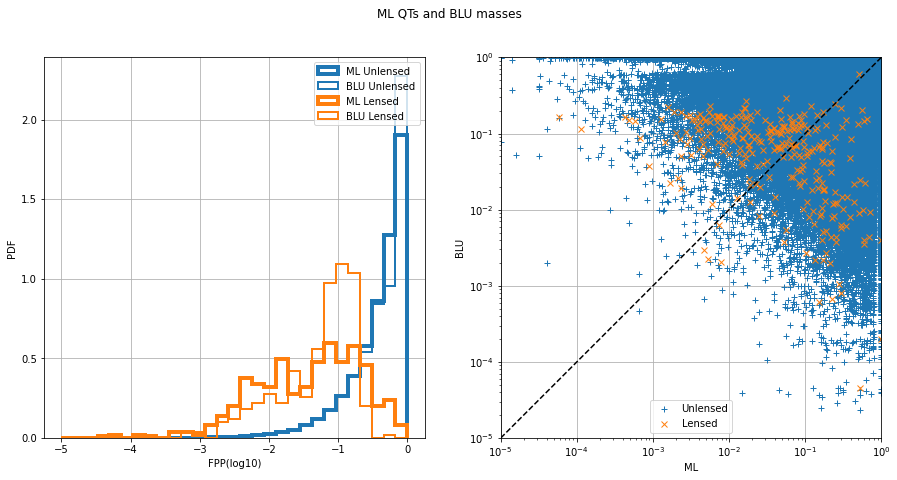

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8895037363520721, 'val_xgb_dense_QTS_0_roc': 0.959883251394042, 'test_xgb_dense_QTS_0_acc': 0.9851117469337122, 'val_xgb_dense_QTS_0_acc': 0.9959492174079785, 'test_xgb_dense_QTS_0_f1': 0.022079116835326585, 'val_xgb_dense_QTS_0_f1': 0.29485396383866475}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9598


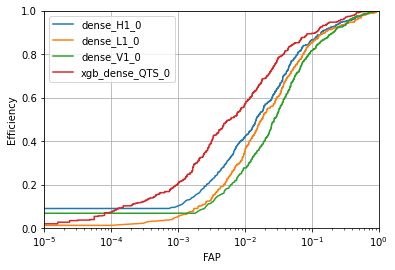

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8897
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

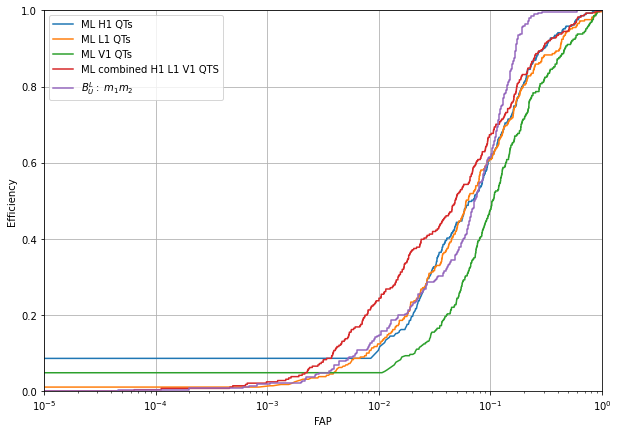

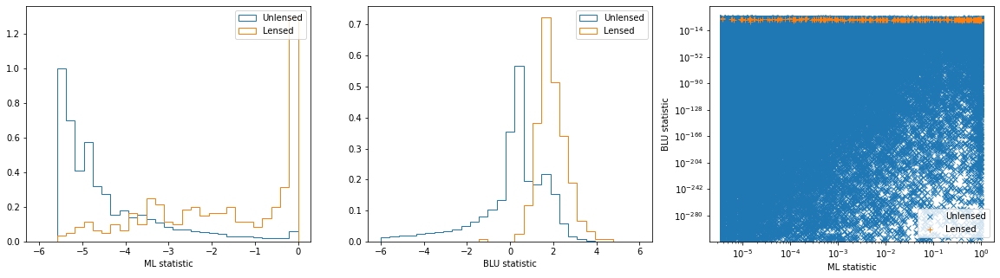

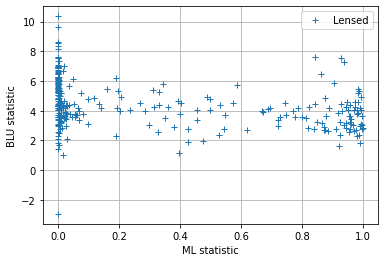

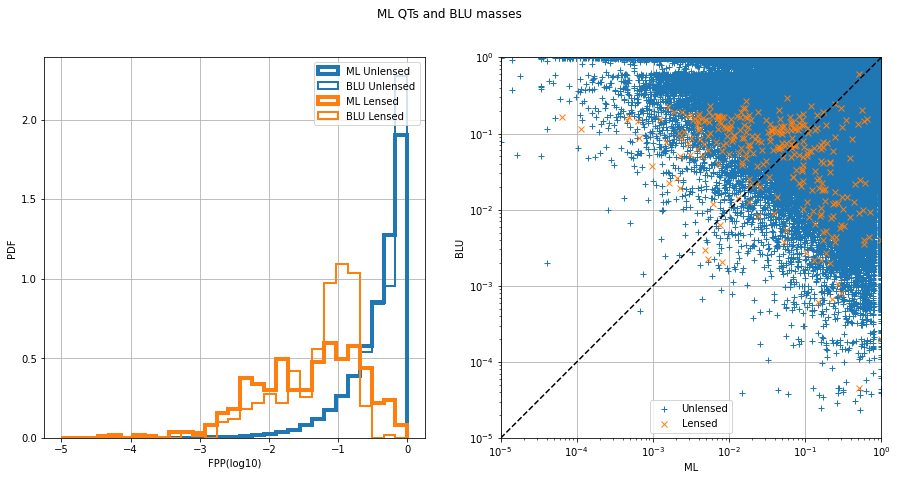

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8896553659481576, 'val_xgb_dense_QTS_0_roc': 0.959772757678, 'test_xgb_dense_QTS_0_acc': 0.9848256267632406, 'val_xgb_dense_QTS_0_acc': 0.9959332379894695, 'test_xgb_dense_QTS_0_f1': 0.021924168171266443, 'val_xgb_dense_QTS_0_f1': 0.30178326474622774}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9597


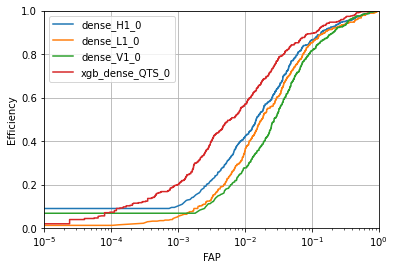

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8894
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

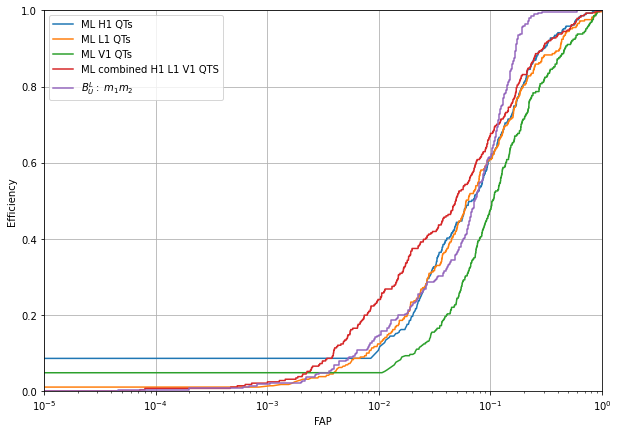

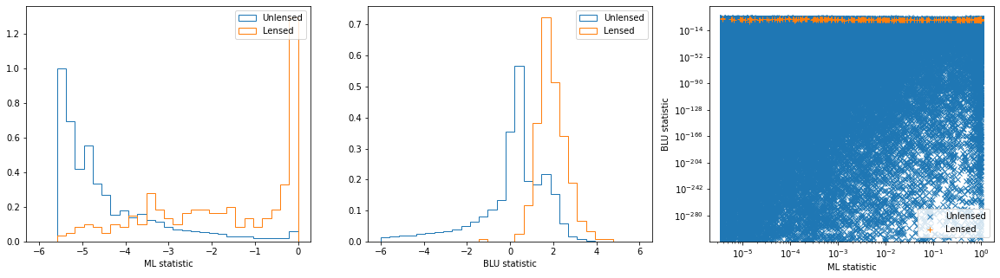

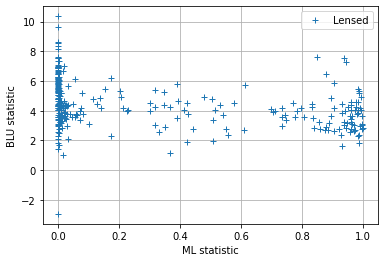

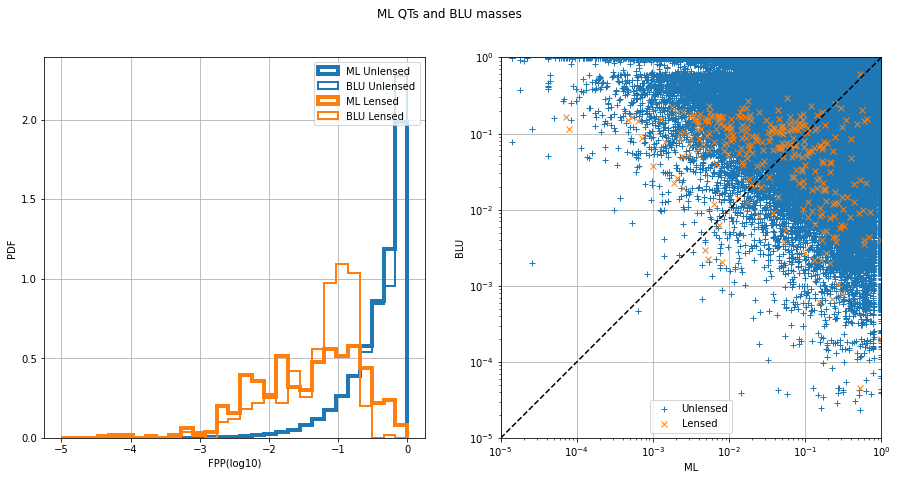

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8893554055940684, 'val_xgb_dense_QTS_0_roc': 0.9596950093263001, 'test_xgb_dense_QTS_0_acc': 0.9844874847435923, 'val_xgb_dense_QTS_0_acc': 0.9959252482802151, 'test_xgb_dense_QTS_0_f1': 0.022443575841634096, 'val_xgb_dense_QTS_0_f1': 0.30894308943089427}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9605


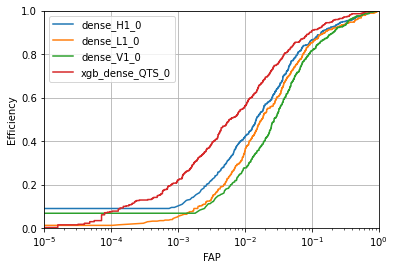

ML H1 QTs auc = 0.8782
ML L1 QTs auc = 0.8650
ML V1 QTs auc = 0.8176
ML combined H1 L1 V1 QTS auc = 0.8898
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

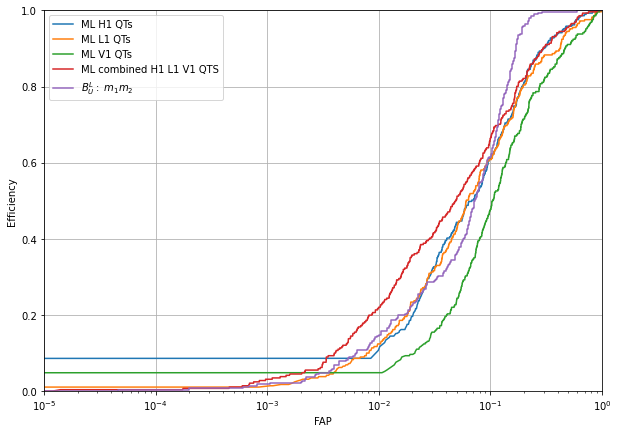

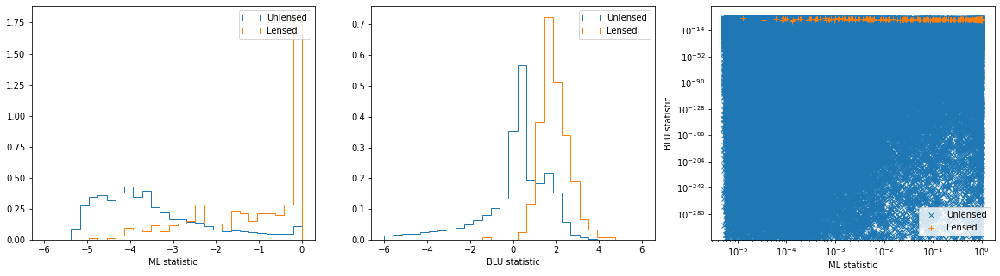

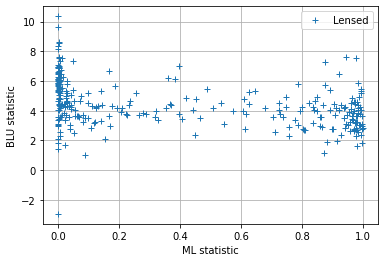

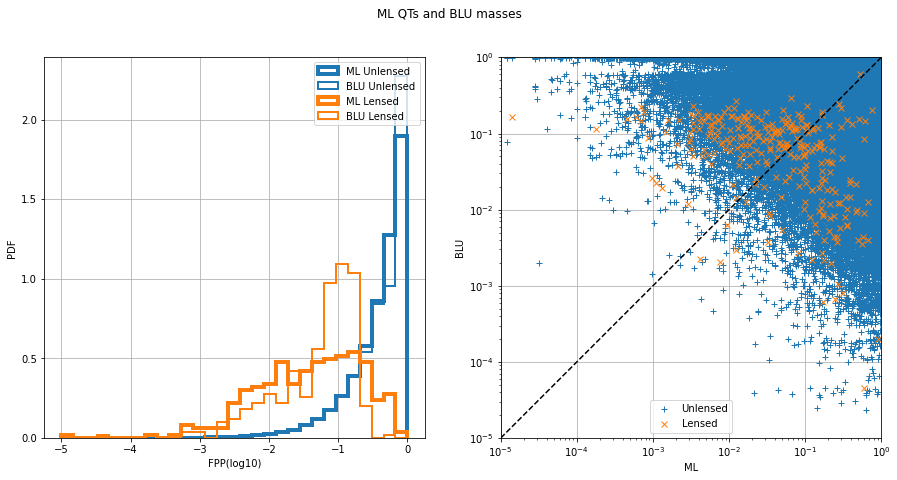

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8898495089330368, 'val_xgb_dense_QTS_0_roc': 0.9605165035468892, 'test_xgb_dense_QTS_0_acc': 0.9715780627863703, 'val_xgb_dense_QTS_0_acc': 0.9944871006144086, 'test_xgb_dense_QTS_0_f1': 0.016069820599847615, 'val_xgb_dense_QTS_0_f1': 0.324853228962818}
dense_H1_0 auc = 0.9398
dense_L1_0 auc = 0.9300
dense_V1_0 auc = 0.9244
xgb_dense_QTS_0 auc = 0.9604


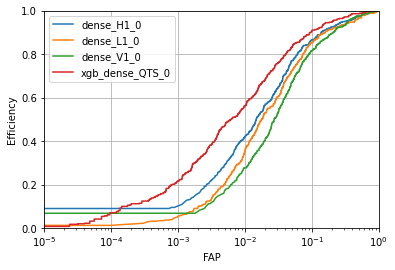

In [ ]:
scale_pos_weight_xgbqts_arr =[ 0.01,0.1,1,10,100]
max_depth_xgbqts_arr =[ 4,5,6,7,8]
n_estimators_xgbqts_arr = [105,120,135,150,165]
include_phenom = 0
cols = ['xgb_dense_QTS_0_roc', 'xgb_dense_QTS_0_acc', 'xgb_dense_QTS_0_f1']
res=pd.DataFrame(columns=['scale_pos_weight_xgbqts', 'max_depth_xgbqts', 'n_estimators_xgbqts', 'val_xgb_dense_QTS_0_roc', 'test_xgb_dense_QTS_0_acc', 'val_xgb_dense_QTS_0_acc', 'test_xgb_dense_QTS_0_f1', 'val_xgb_dense_QTS_0_f1'])
for scale_pos_weight_xgbqts in scale_pos_weight_xgbqts_arr:
    for max_depth_xgbqts in max_depth_xgbqts_arr:
        for n_estimators_xgbqts in n_estimators_xgbqts_arr:
            df_test_scores,df_val_scores=train_test_xgbqts(base_out_dir,df_dir_train_features_in, df_dir_test_features_in, tag_qts,train_size_lensed_xgbqts, cv_size_lensed_xgbqts, scale_pos_weight_xgbqts, max_depth_xgbqts, n_estimators_xgbqts, cv_splits, compare_to_blu, path_to_blu,include_phenom)
            res_dict={'scale_pos_weight_xgbqts':scale_pos_weight_xgbqts,'max_depth_xgbqts':max_depth_xgbqts, 'n_estimators_xgbqts':n_estimators_xgbqts}
            for col in cols:
                res_dict['test_'+col]= df_test_scores[col]
                res_dict['val_'+col]= df_val_scores[col]
            print(res_dict)
            res=res.append(res_dict,ignore_index=True)

In [ ]:
res['test_xgb_dense_QTS_0_roc'].max()

In [ ]:
idx = res['test_xgb_dense_QTS_0_roc'].idxmax()

In [ ]:
res.iloc[idx]

In [ ]:
#res.to_csv('optimise_xgbqts.csv')
res.to_csv('optimise_xgbqts_whitened.csv')

dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9605


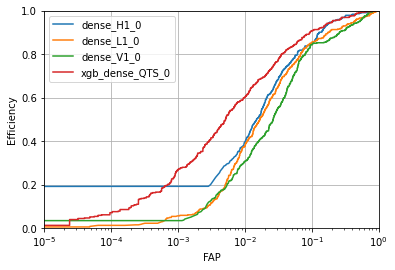

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8979
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

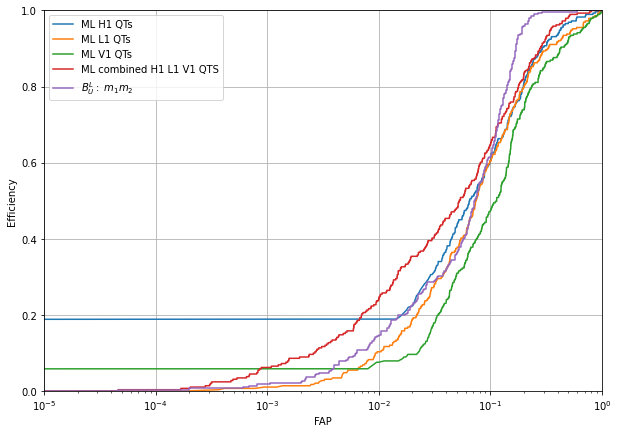

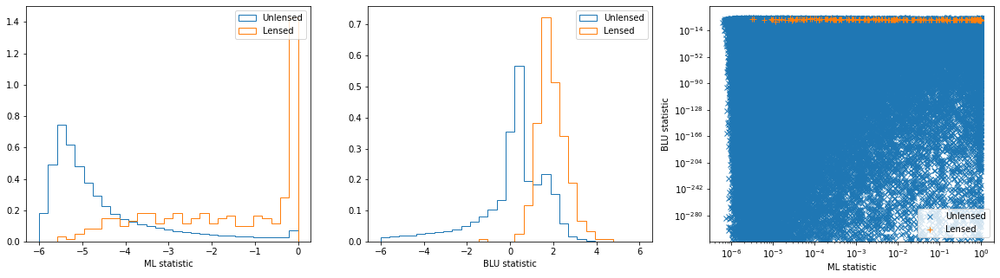

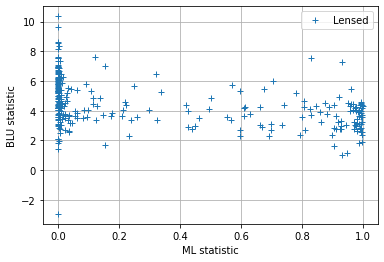

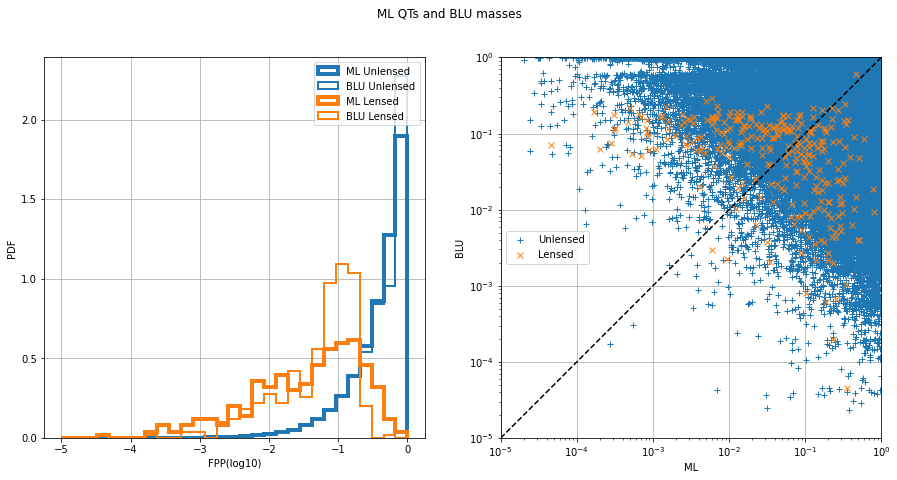

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8979019210926324, 'val_xgb_dense_QTS_0_roc': 0.9605114934866883, 'test_xgb_dense_QTS_0_acc': 0.9823505872466436, 'val_xgb_dense_QTS_0_acc': 0.9959012791524516, 'test_xgb_dense_QTS_0_f1': 0.02130256296460668, 'val_xgb_dense_QTS_0_f1': 0.3464968152866242}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9615


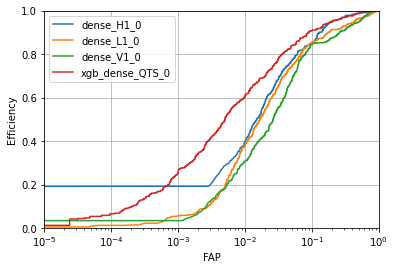

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8980
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

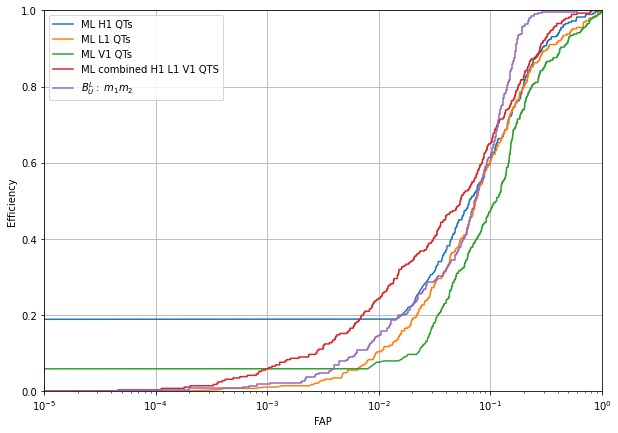

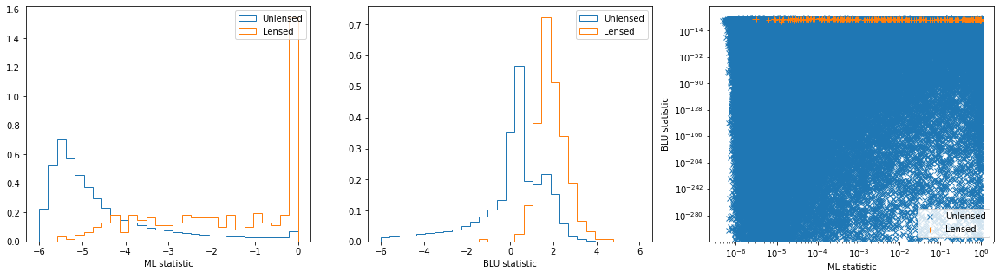

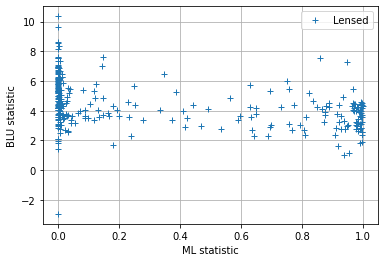

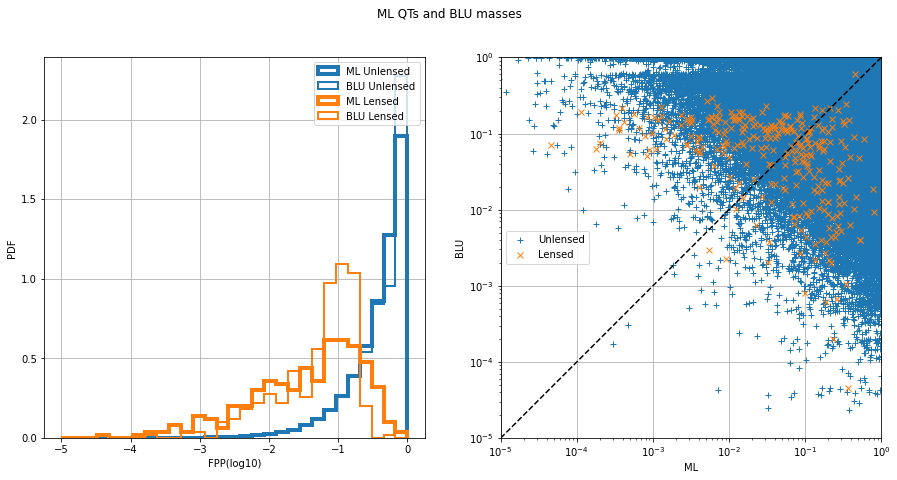

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8980240744180996, 'val_xgb_dense_QTS_0_roc': 0.9614696504756307, 'test_xgb_dense_QTS_0_acc': 0.9813181536245223, 'val_xgb_dense_QTS_0_acc': 0.9958213820599069, 'test_xgb_dense_QTS_0_f1': 0.02035463225264925, 'val_xgb_dense_QTS_0_f1': 0.3535228677379481}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9611


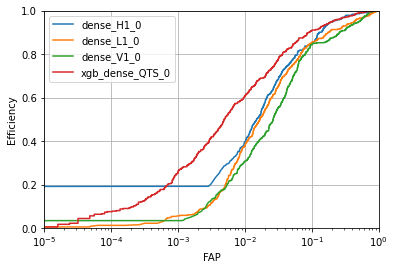

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8984
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

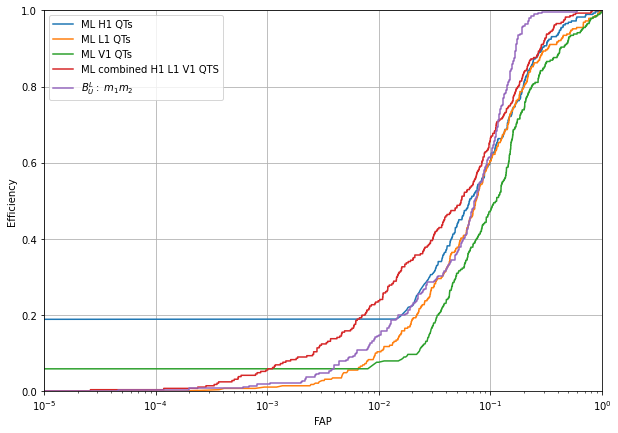

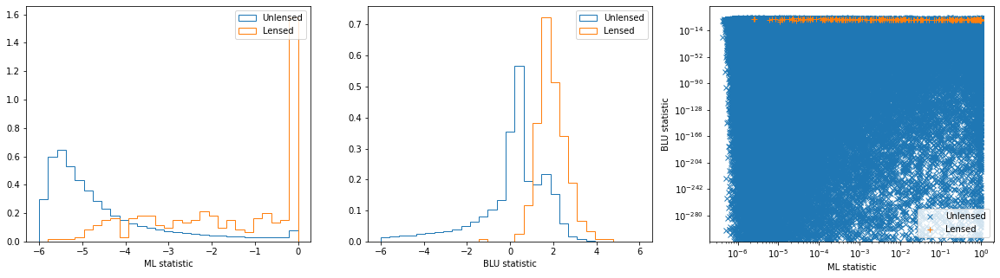

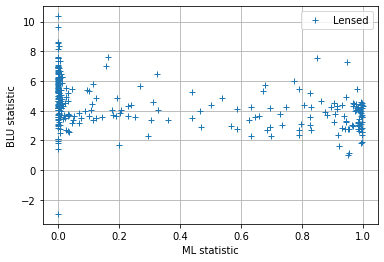

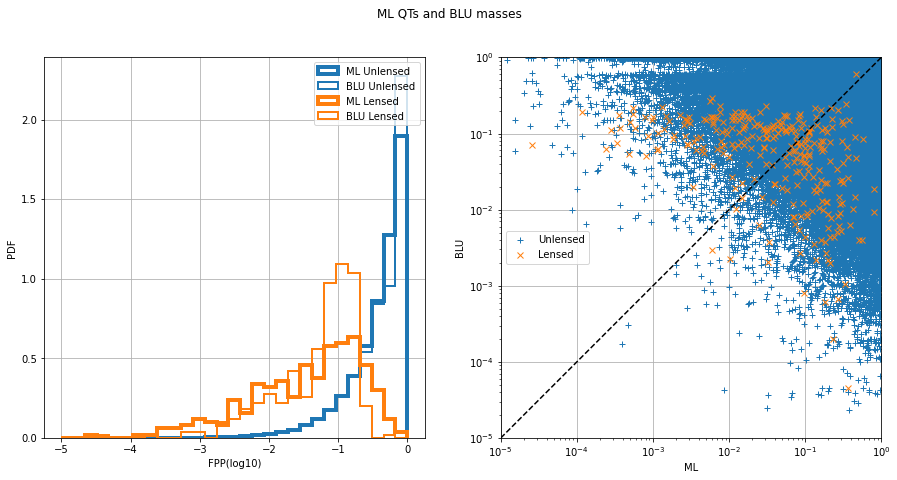

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8983799636651734, 'val_xgb_dense_QTS_0_roc': 0.9611064065186584, 'test_xgb_dense_QTS_0_acc': 0.9803837611796955, 'val_xgb_dense_QTS_0_acc': 0.9957015364210896, 'test_xgb_dense_QTS_0_f1': 0.01999200319872051, 'val_xgb_dense_QTS_0_f1': 0.3518072289156627}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9607


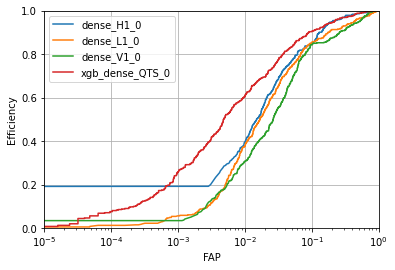

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8989
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

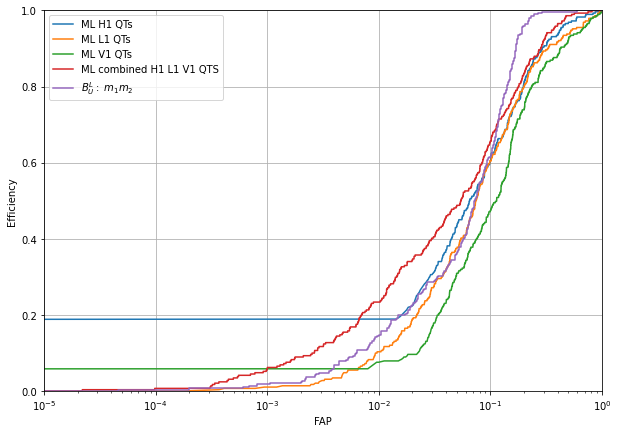

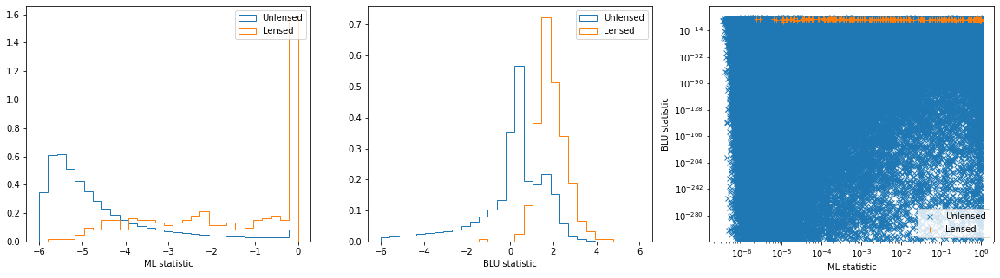

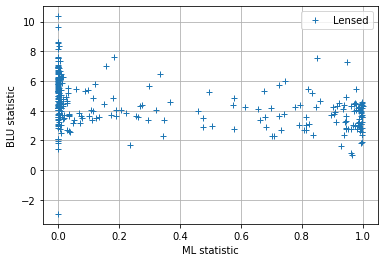

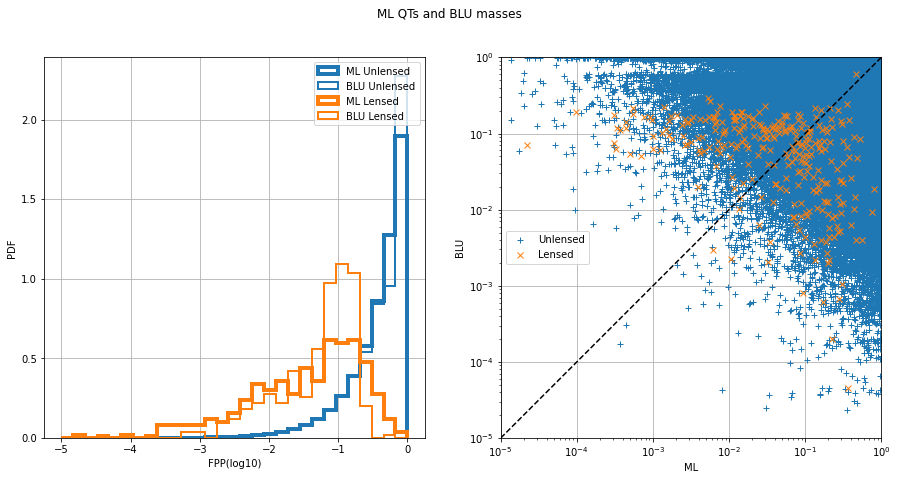

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.89887121190966, 'val_xgb_dense_QTS_0_roc': 0.9607052125716984, 'test_xgb_dense_QTS_0_acc': 0.9797334880649873, 'val_xgb_dense_QTS_0_acc': 0.9956296290377993, 'test_xgb_dense_QTS_0_f1': 0.01936295866008326, 'val_xgb_dense_QTS_0_f1': 0.35112692763938314}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9604


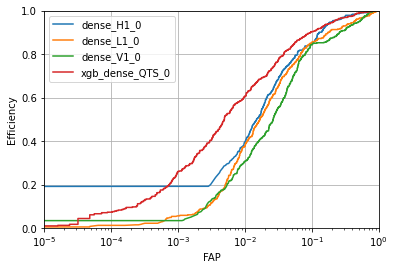

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8982
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

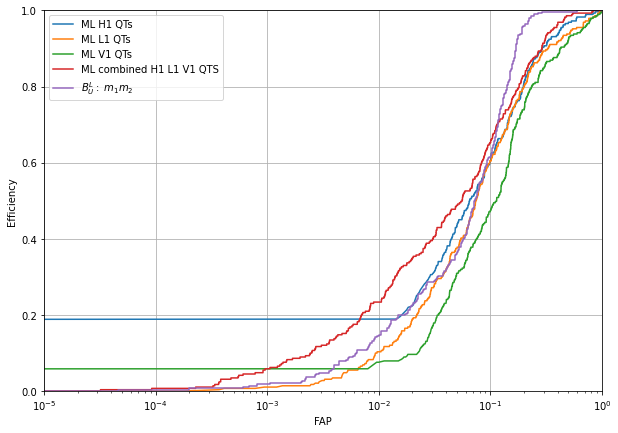

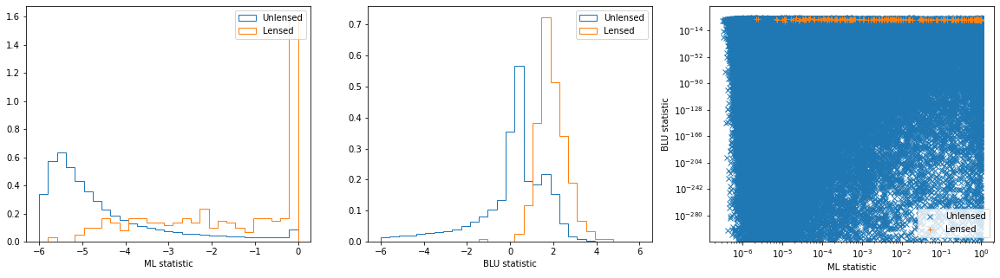

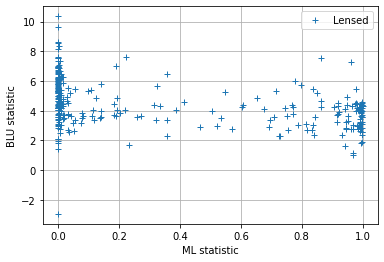

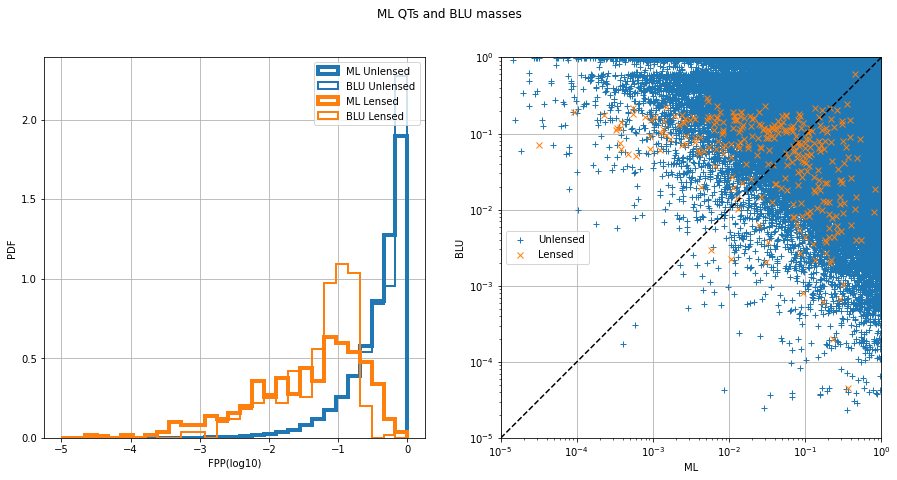

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8981976710423295, 'val_xgb_dense_QTS_0_roc': 0.9603922540539073, 'test_xgb_dense_QTS_0_acc': 0.9791132275555734, 'val_xgb_dense_QTS_0_acc': 0.9955737010730179, 'test_xgb_dense_QTS_0_f1': 0.019351808360732737, 'val_xgb_dense_QTS_0_f1': 0.3497652582159625}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9611


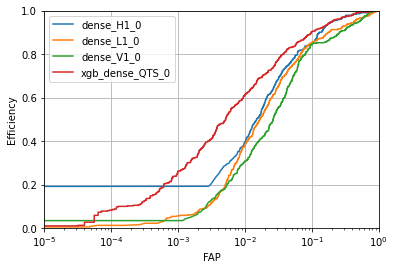

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8984
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

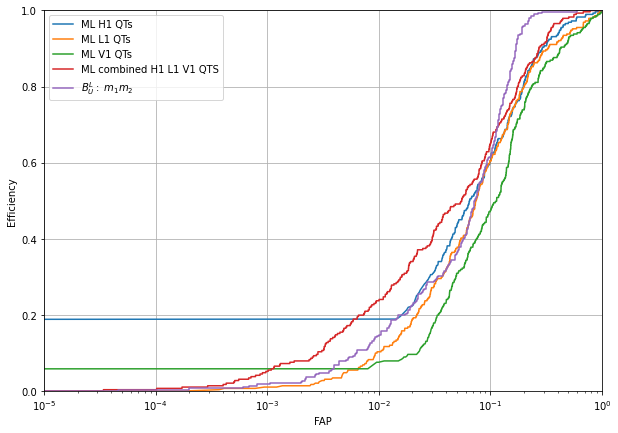

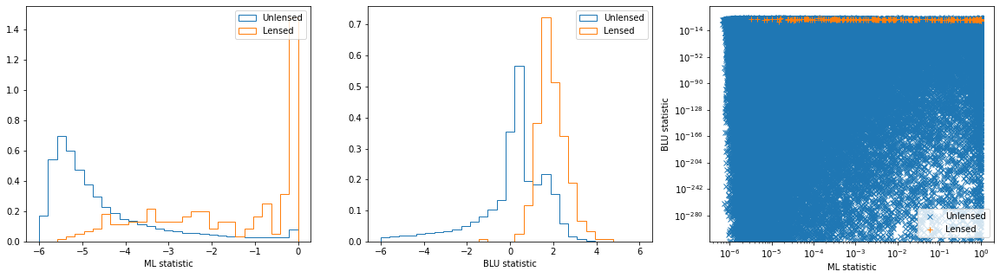

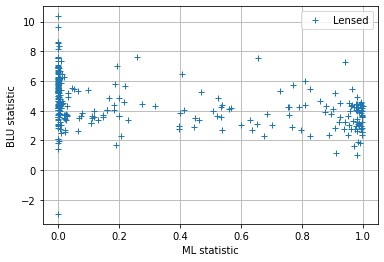

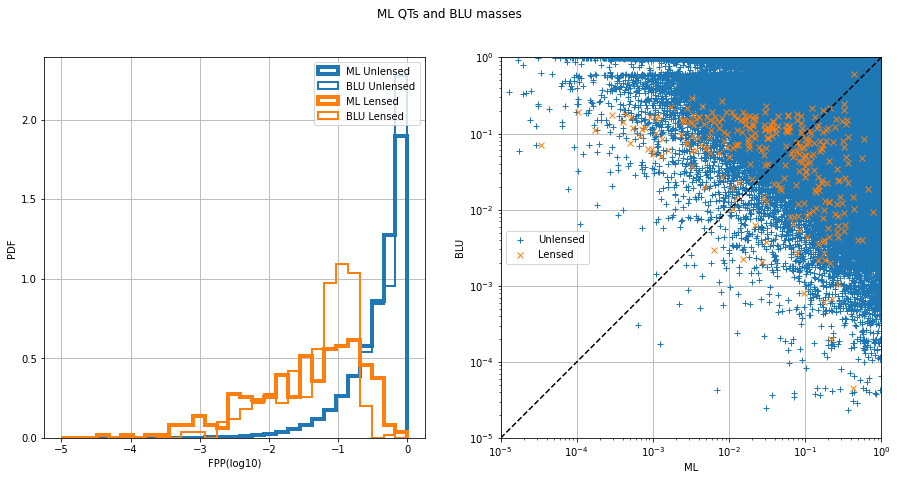

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8984276747018726, 'val_xgb_dense_QTS_0_roc': 0.9611280324678362, 'test_xgb_dense_QTS_0_acc': 0.9802797174813421, 'val_xgb_dense_QTS_0_acc': 0.9958133923506524, 'test_xgb_dense_QTS_0_f1': 0.019693654266958422, 'val_xgb_dense_QTS_0_f1': 0.3562653562653563}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9615


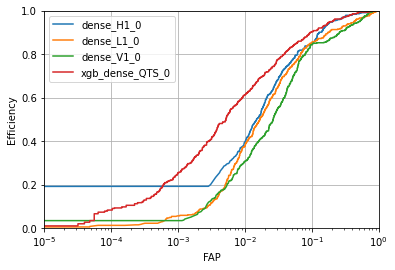

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8988
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

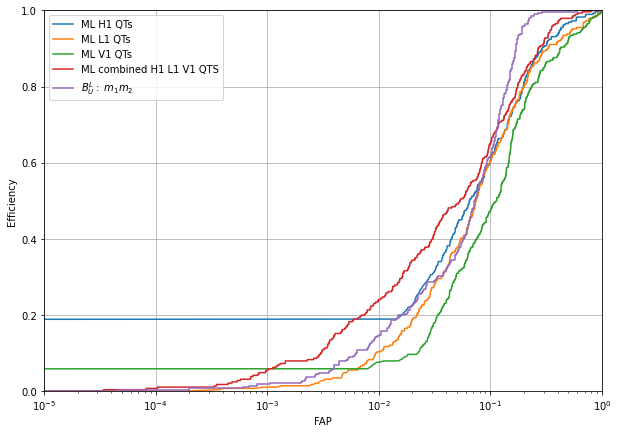

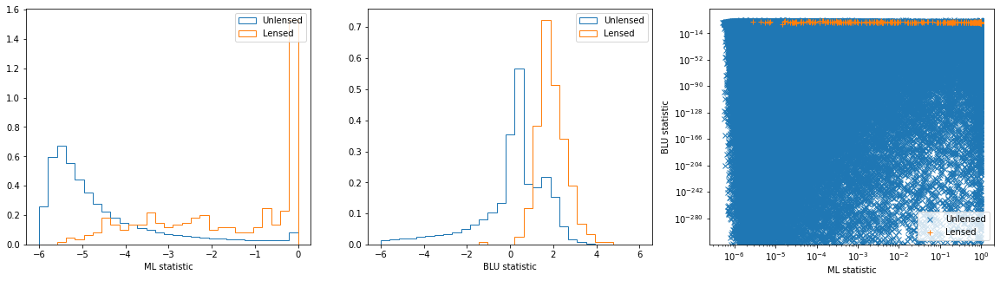

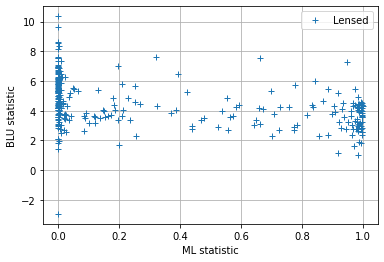

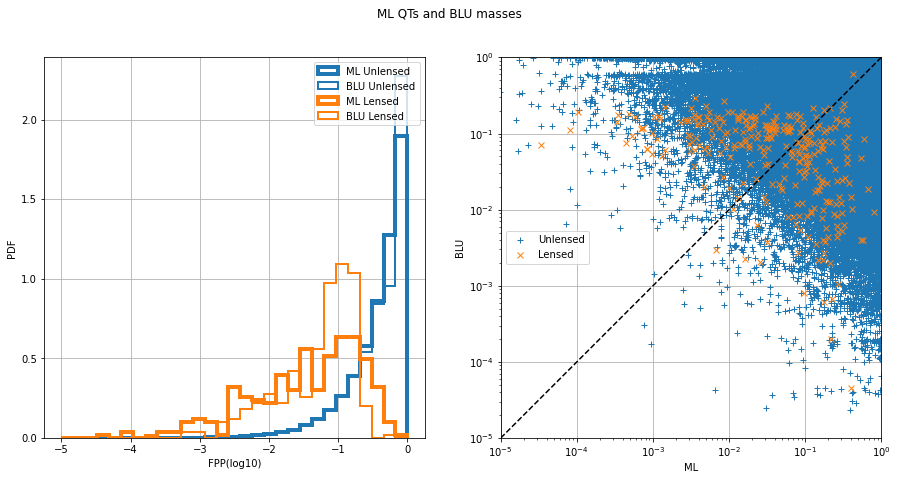

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8987942929124262, 'val_xgb_dense_QTS_0_roc': 0.9615323978315448, 'test_xgb_dense_QTS_0_acc': 0.9792672922627503, 'val_xgb_dense_QTS_0_acc': 0.9957095261303441, 'test_xgb_dense_QTS_0_f1': 0.01893580761219466, 'val_xgb_dense_QTS_0_f1': 0.35223160434258144}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9609


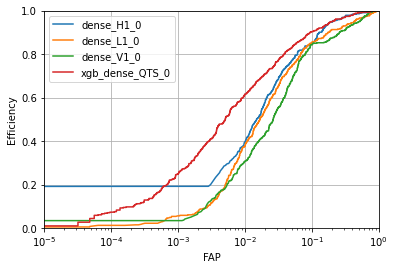

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8984
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

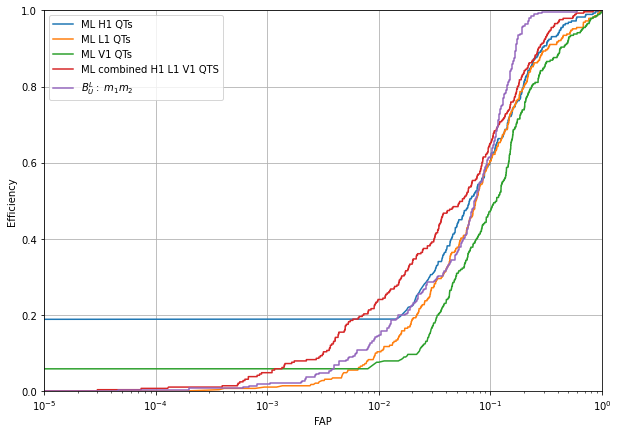

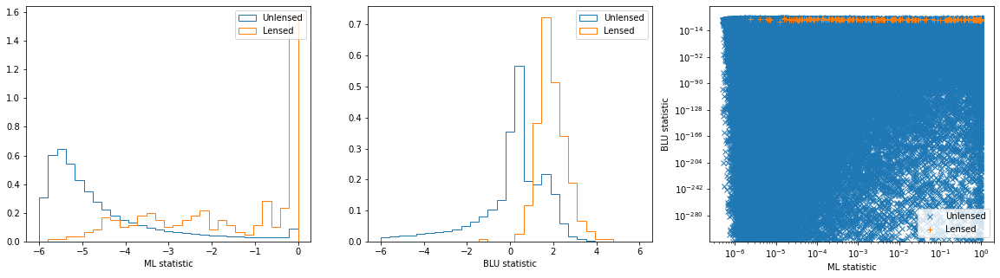

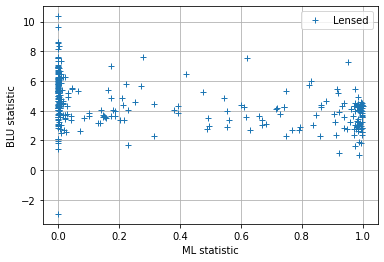

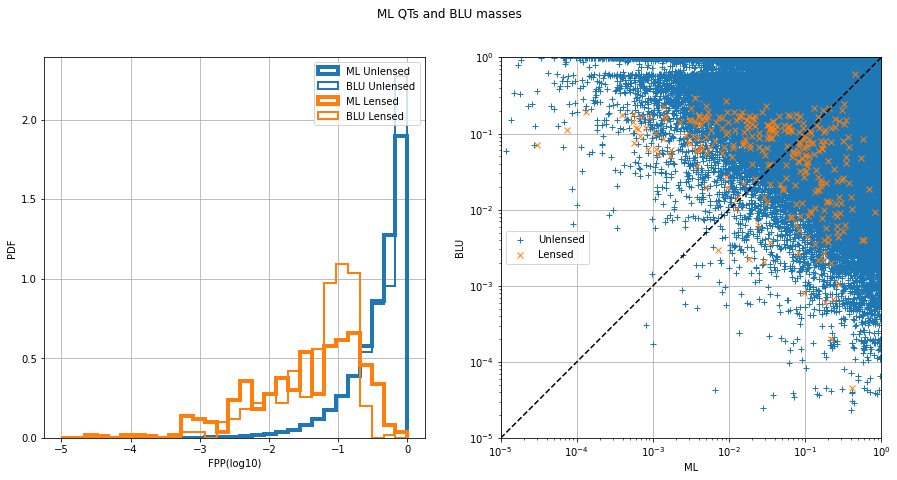

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8983877136987481, 'val_xgb_dense_QTS_0_roc': 0.9608589484578237, 'test_xgb_dense_QTS_0_acc': 0.9781728325896877, 'val_xgb_dense_QTS_0_acc': 0.9955657113637635, 'test_xgb_dense_QTS_0_f1': 0.01818018180181802, 'val_xgb_dense_QTS_0_f1': 0.35540069686411146}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9606


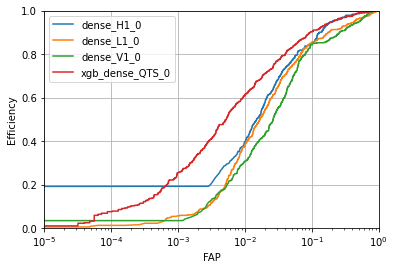

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8984
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

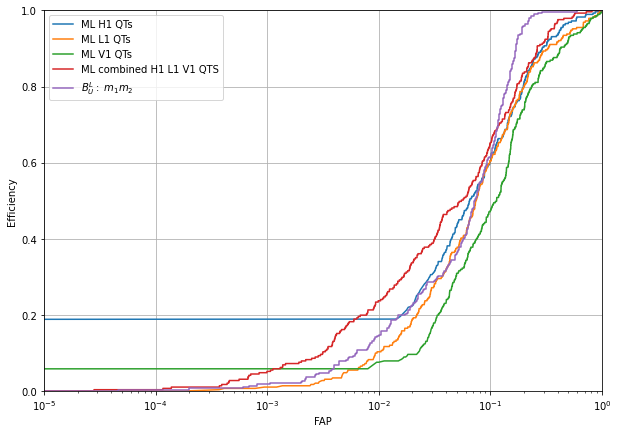

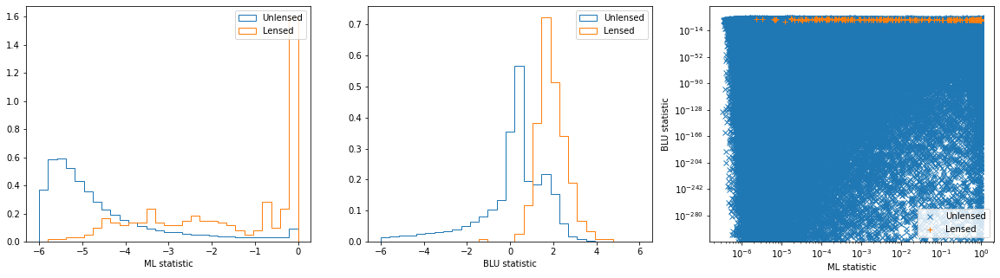

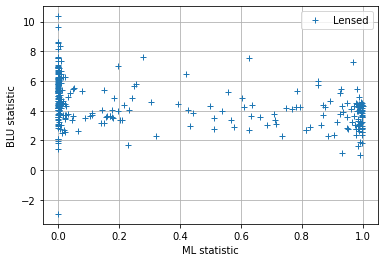

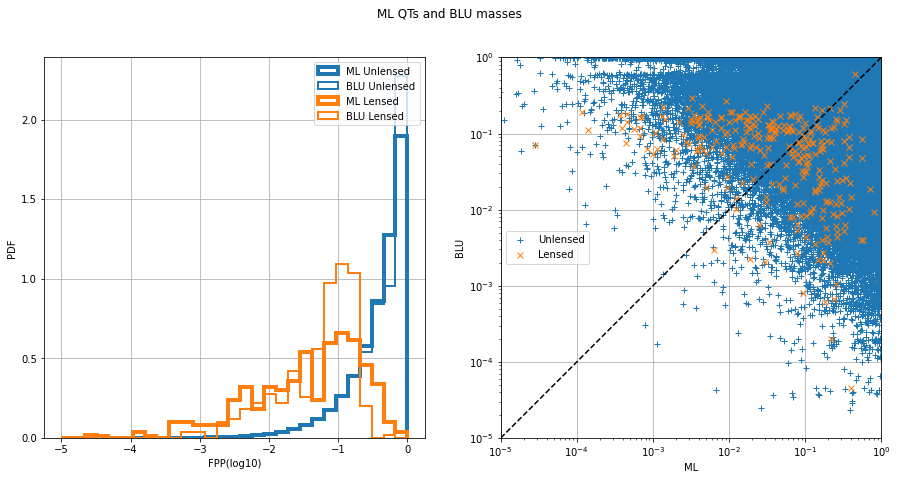

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8983743945109975, 'val_xgb_dense_QTS_0_roc': 0.9606323867257491, 'test_xgb_dense_QTS_0_acc': 0.97731247123792, 'val_xgb_dense_QTS_0_acc': 0.995373958341656, 'test_xgb_dense_QTS_0_f1': 0.018013336797436566, 'val_xgb_dense_QTS_0_f1': 0.3516237402015677}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9601


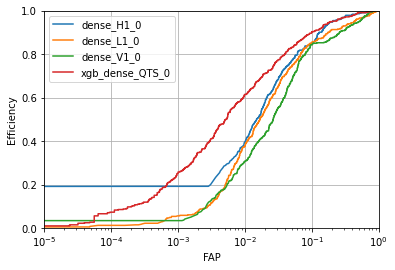

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8981
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

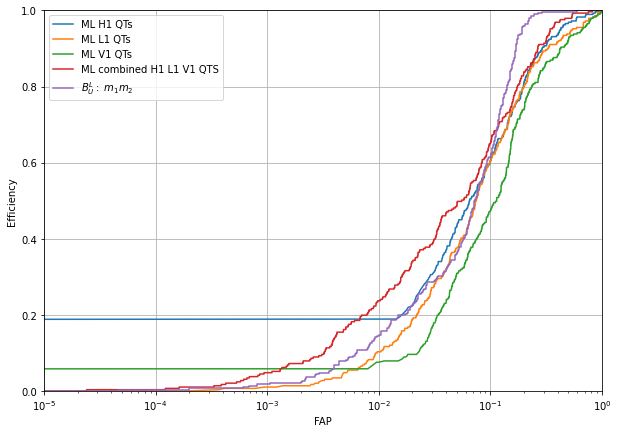

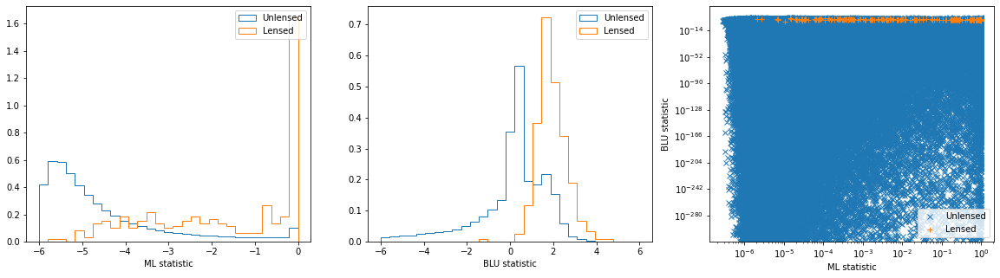

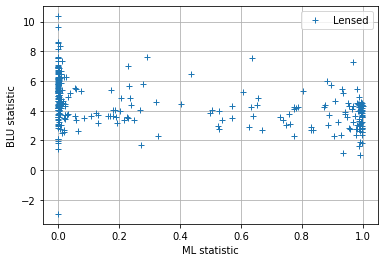

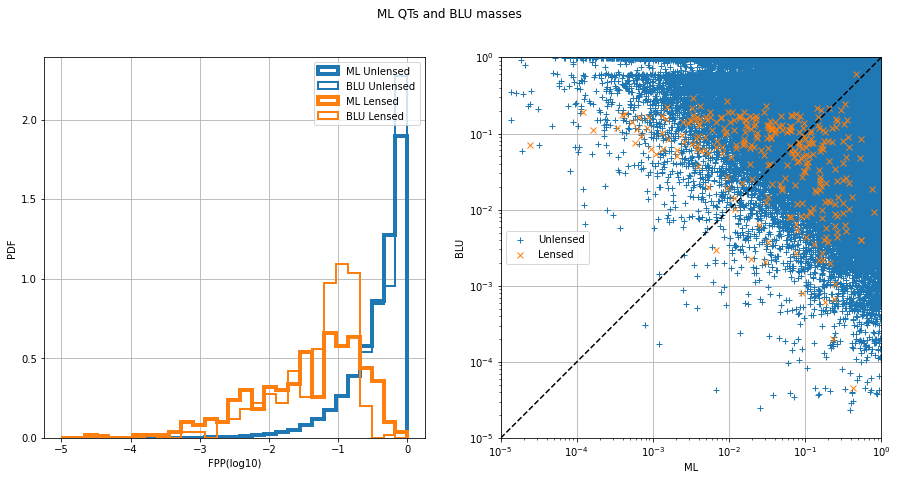

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8981270160535908, 'val_xgb_dense_QTS_0_roc': 0.9601224890648383, 'test_xgb_dense_QTS_0_acc': 0.9764140939194461, 'val_xgb_dense_QTS_0_acc': 0.9953180303768746, 'test_xgb_dense_QTS_0_f1': 0.017830361606398934, 'val_xgb_dense_QTS_0_f1': 0.35033259423503327}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9617


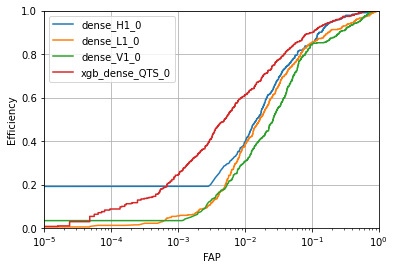

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8991
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

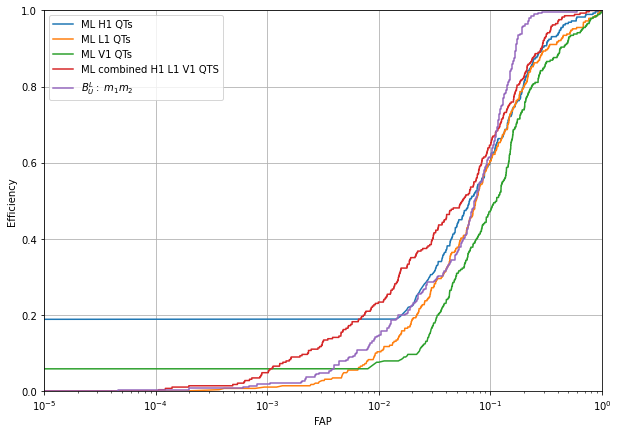

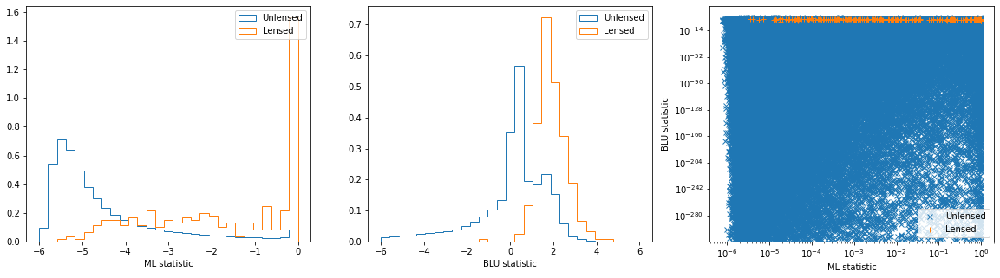

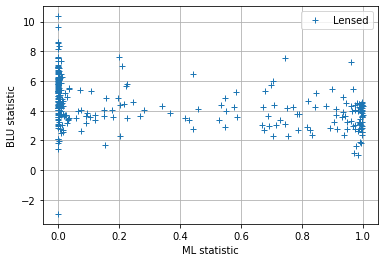

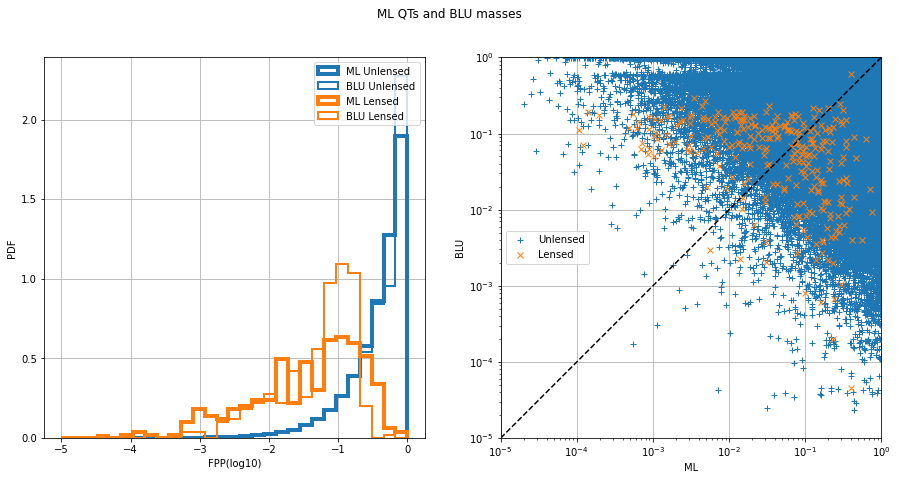

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8990721899219305, 'val_xgb_dense_QTS_0_roc': 0.96172326653279, 'test_xgb_dense_QTS_0_acc': 0.979665459492987, 'val_xgb_dense_QTS_0_acc': 0.9956615878748173, 'test_xgb_dense_QTS_0_f1': 0.01967782386418443, 'val_xgb_dense_QTS_0_f1': 0.34970059880239523}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9615


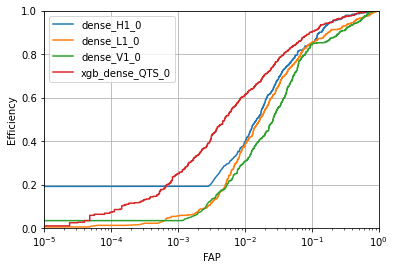

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8991
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

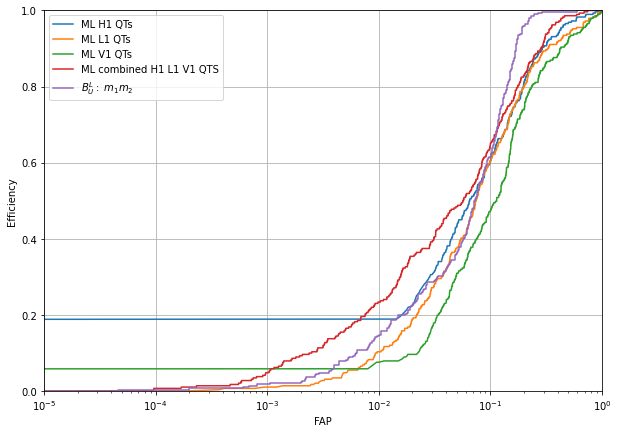

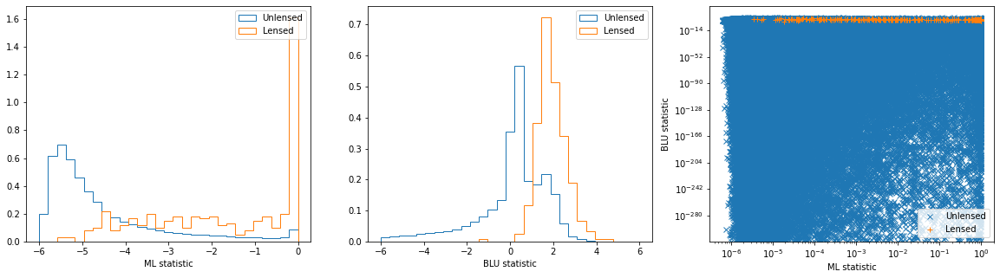

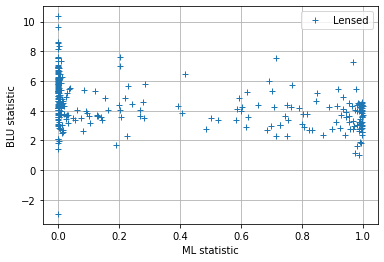

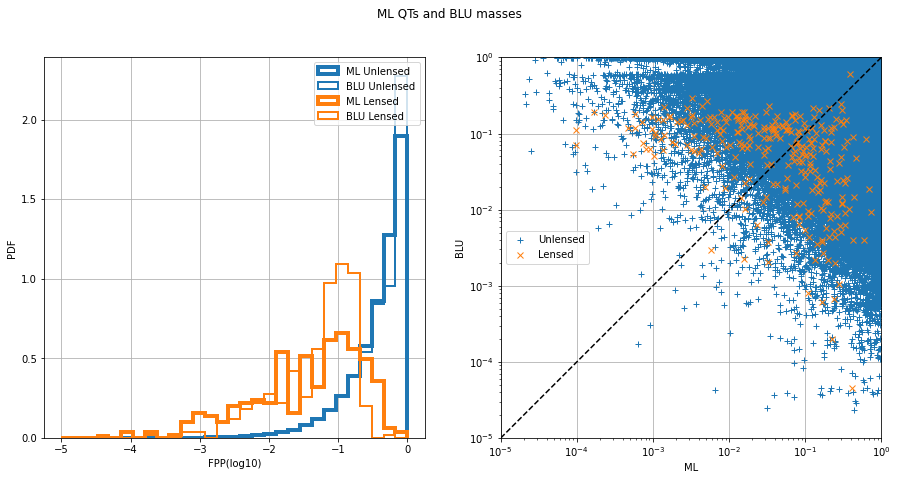

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8991360649212435, 'val_xgb_dense_QTS_0_roc': 0.9615205779807796, 'test_xgb_dense_QTS_0_acc': 0.9783389023389824, 'val_xgb_dense_QTS_0_acc': 0.9955497319452545, 'test_xgb_dense_QTS_0_f1': 0.019028633562885103, 'val_xgb_dense_QTS_0_f1': 0.3500583430571762}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9615


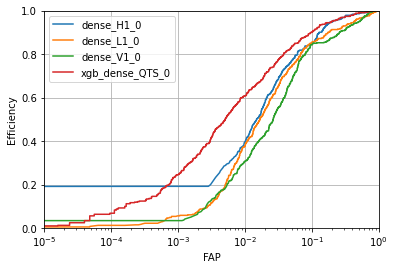

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8993
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

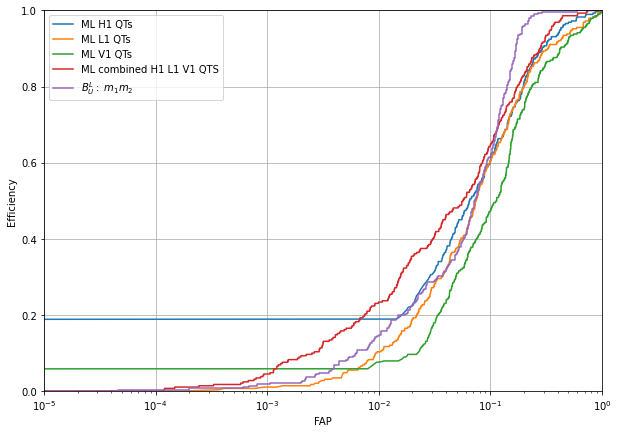

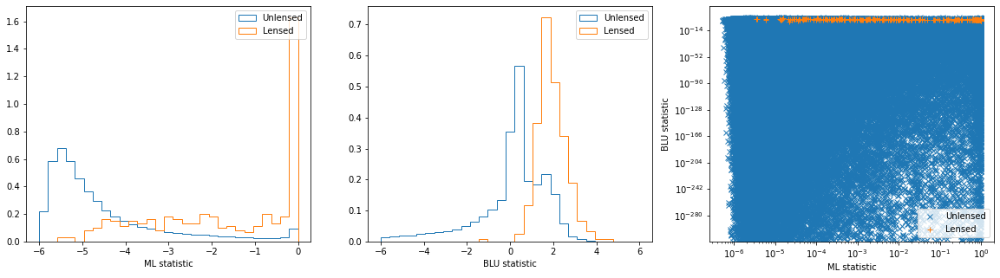

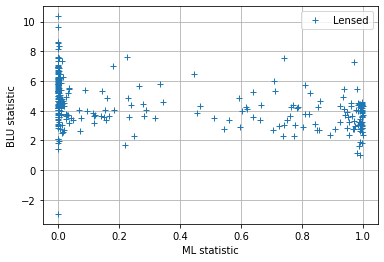

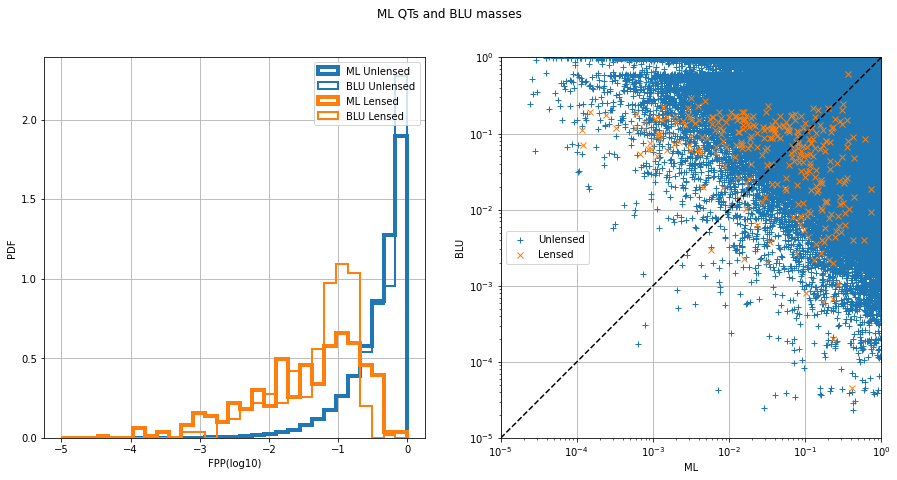

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8993281061437993, 'val_xgb_dense_QTS_0_roc': 0.9615128634608974, 'test_xgb_dense_QTS_0_acc': 0.9775625762820385, 'val_xgb_dense_QTS_0_acc': 0.9954538554342007, 'test_xgb_dense_QTS_0_f1': 0.018554174689305095, 'val_xgb_dense_QTS_0_f1': 0.3511972633979476}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9615


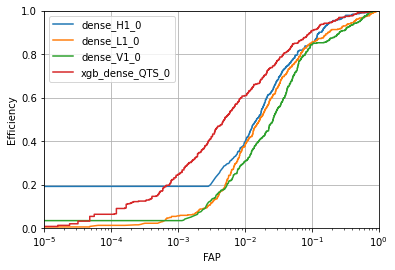

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8993
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

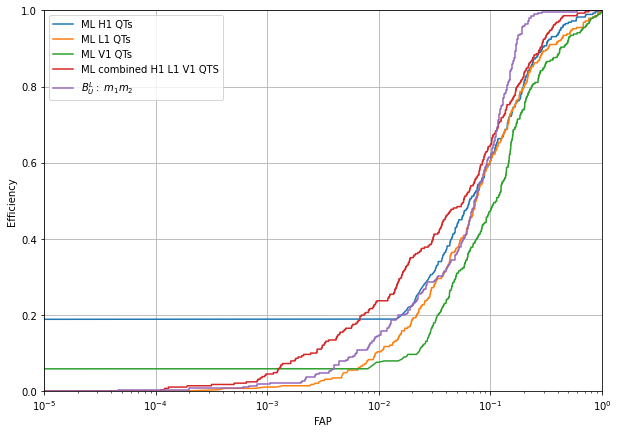

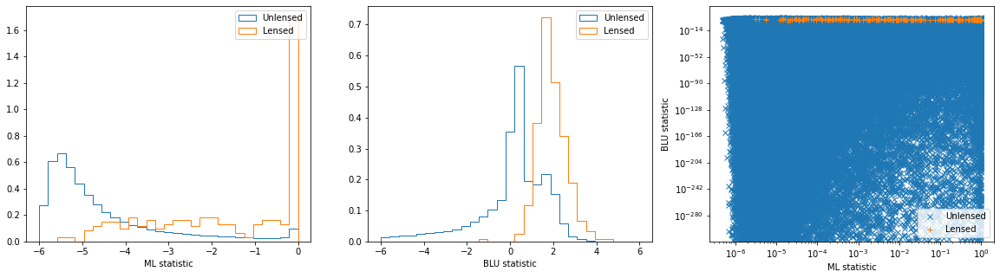

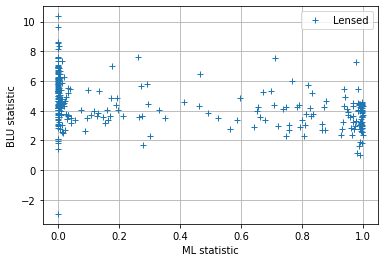

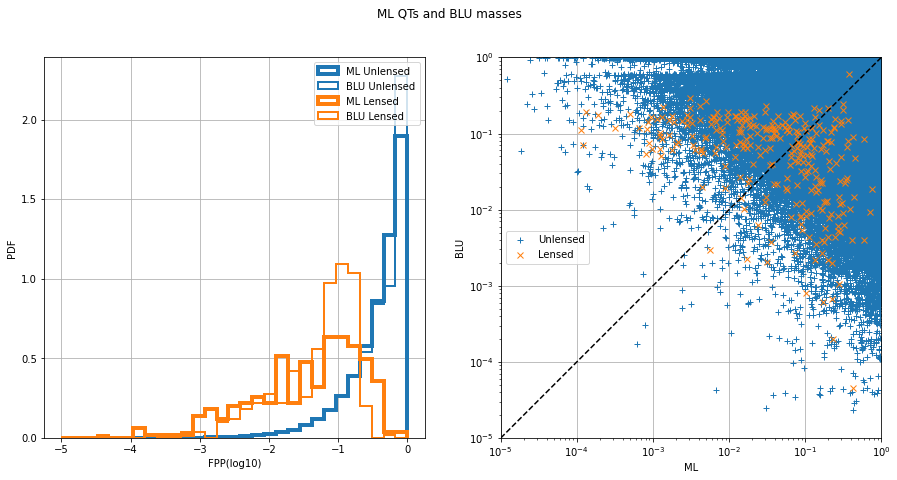

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8993474485489443, 'val_xgb_dense_QTS_0_roc': 0.9615382347948856, 'test_xgb_dense_QTS_0_acc': 0.9766221813161527, 'val_xgb_dense_QTS_0_acc': 0.9953180303768746, 'test_xgb_dense_QTS_0_f1': 0.017821116341627436, 'val_xgb_dense_QTS_0_f1': 0.3488888888888889}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9615


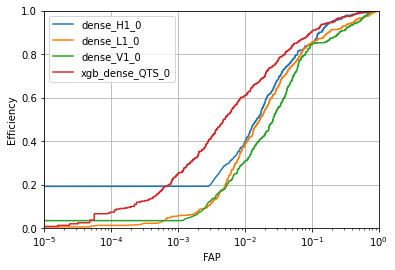

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8996
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

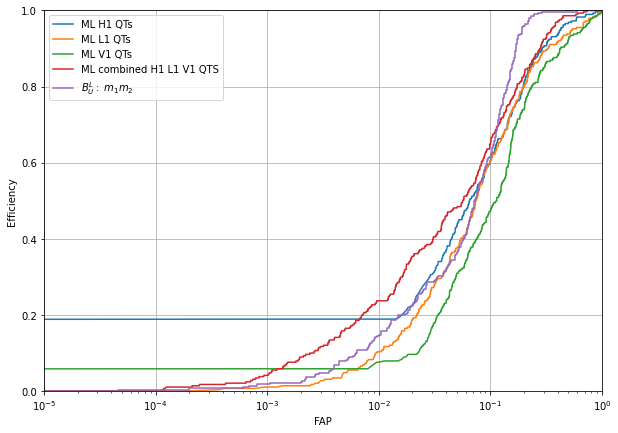

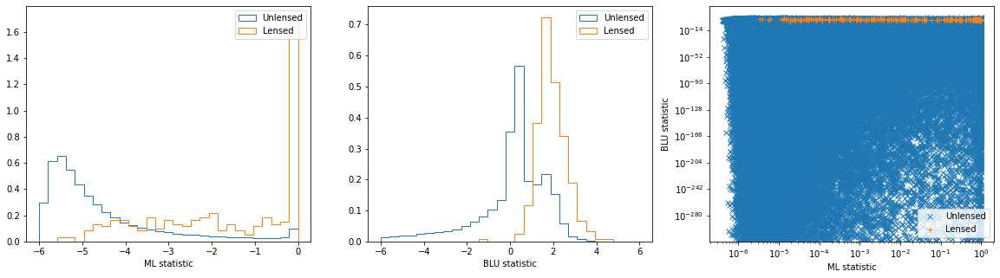

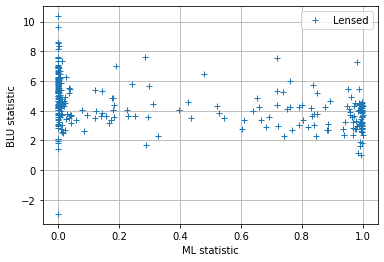

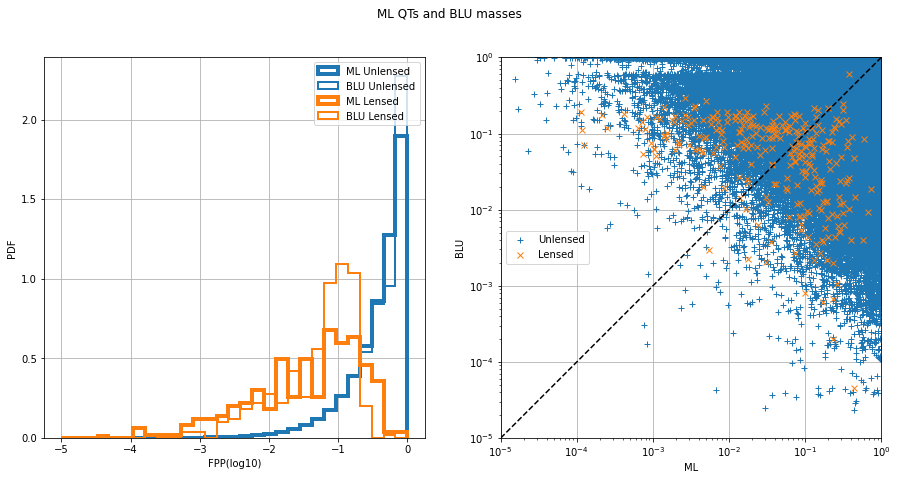

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8996029898246702, 'val_xgb_dense_QTS_0_roc': 0.9614760711353056, 'test_xgb_dense_QTS_0_acc': 0.9759358930750915, 'val_xgb_dense_QTS_0_acc': 0.9952541127028387, 'test_xgb_dense_QTS_0_f1': 0.017642734623866698, 'val_xgb_dense_QTS_0_f1': 0.35152838427947597}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9631


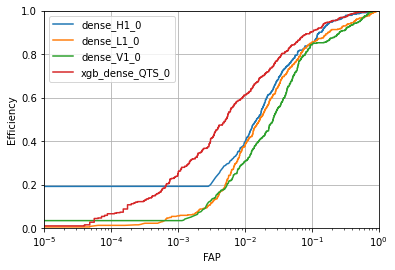

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8982
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

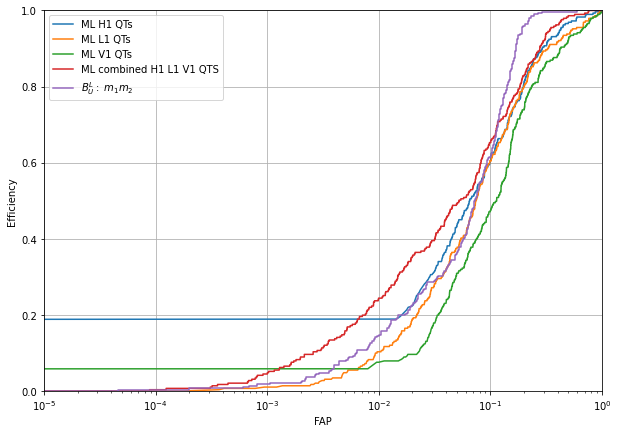

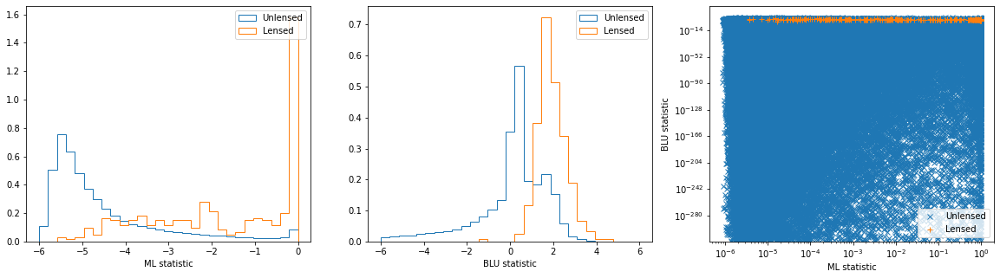

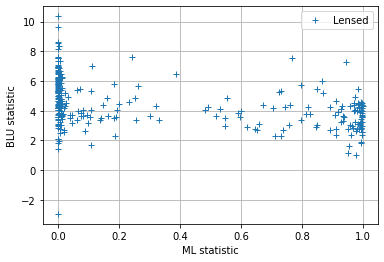

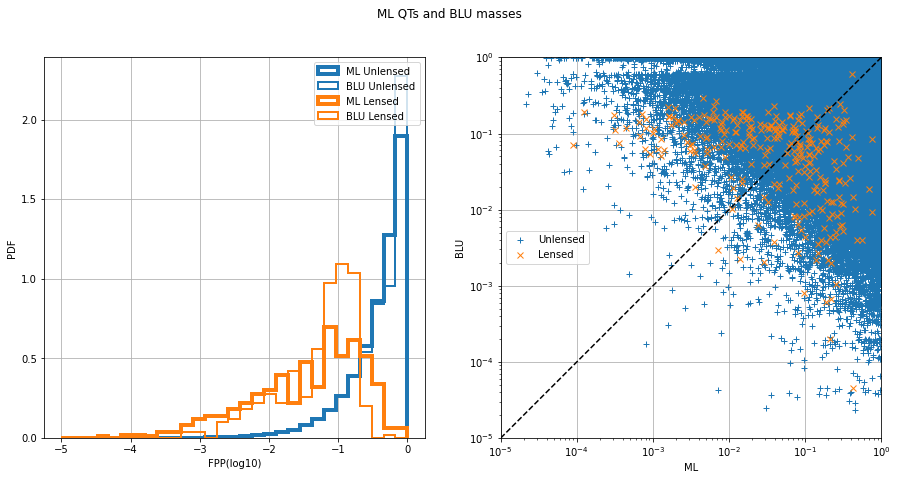

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8982086511165288, 'val_xgb_dense_QTS_0_roc': 0.963113961961833, 'test_xgb_dense_QTS_0_acc': 0.9789951779747494, 'val_xgb_dense_QTS_0_acc': 0.9955976702007814, 'test_xgb_dense_QTS_0_f1': 0.019428357930132638, 'val_xgb_dense_QTS_0_f1': 0.3463819691577699}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9631


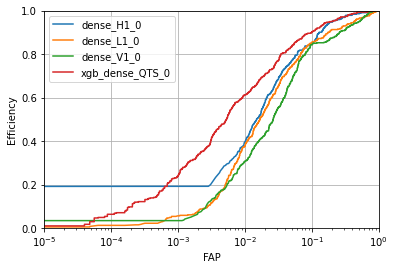

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8976
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

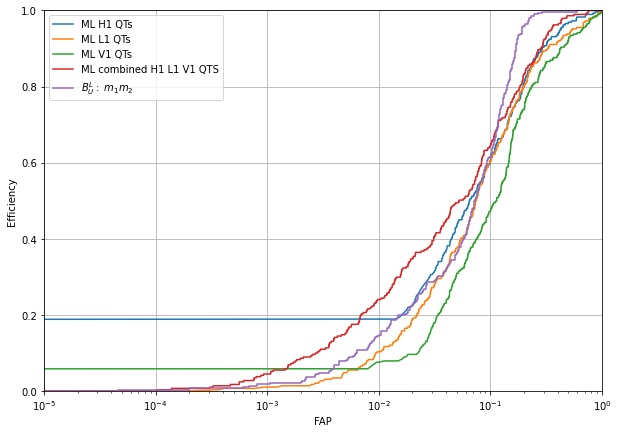

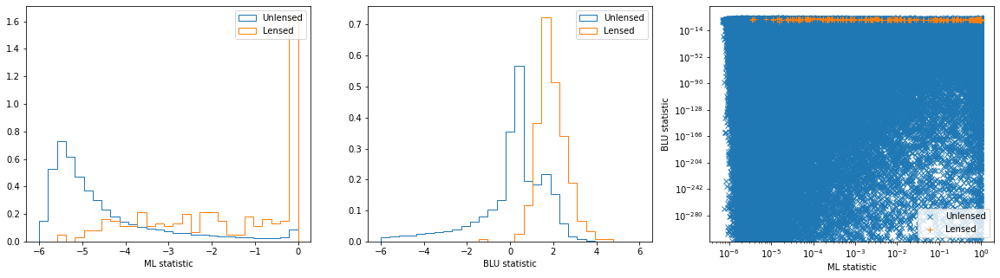

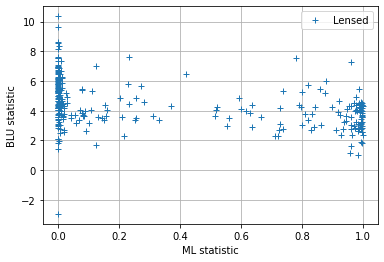

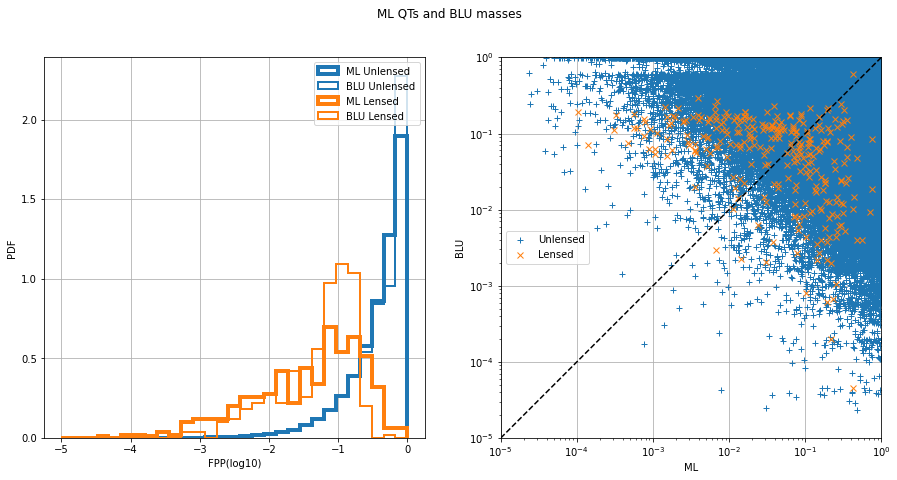

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8975621407702064, 'val_xgb_dense_QTS_0_roc': 0.9630501153111565, 'test_xgb_dense_QTS_0_acc': 0.9779187258648633, 'val_xgb_dense_QTS_0_acc': 0.9953979274694194, 'test_xgb_dense_QTS_0_f1': 0.01884779516358464, 'val_xgb_dense_QTS_0_f1': 0.33944954128440363}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9624


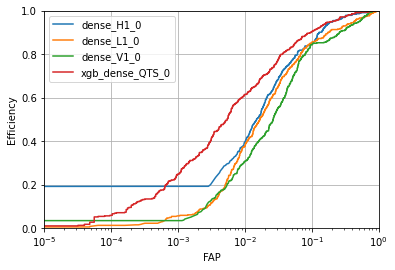

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8973
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

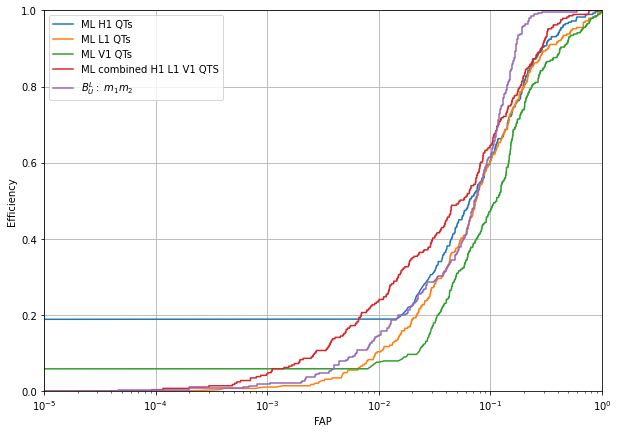

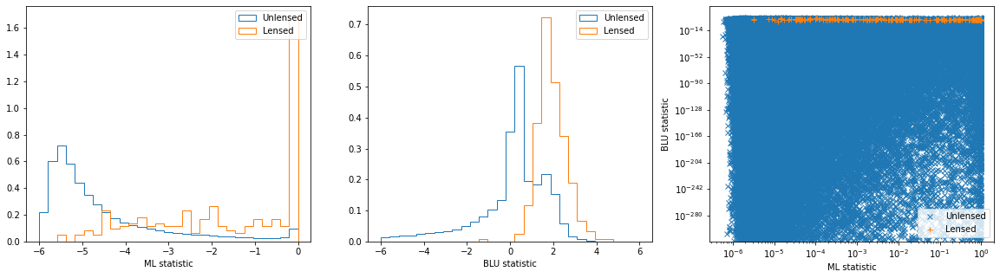

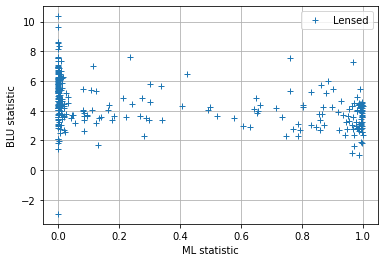

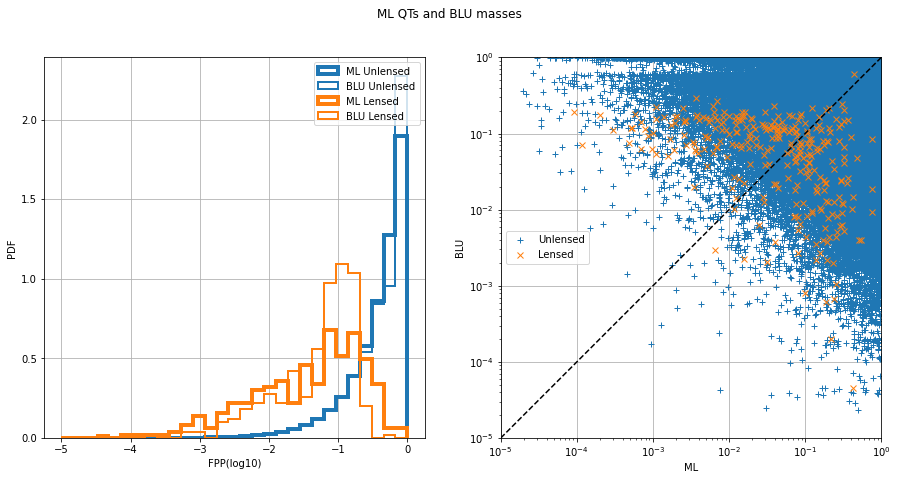

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8973338088888777, 'val_xgb_dense_QTS_0_roc': 0.962431980893362, 'test_xgb_dense_QTS_0_acc': 0.9769283098901539, 'val_xgb_dense_QTS_0_acc': 0.995326020086129, 'test_xgb_dense_QTS_0_f1': 0.017718715393133997, 'val_xgb_dense_QTS_0_f1': 0.3389830508474576}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9617


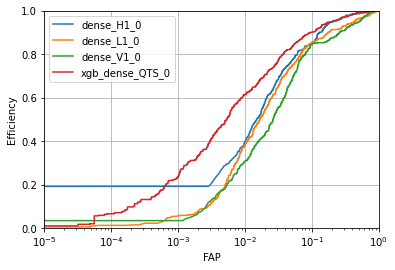

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8973
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

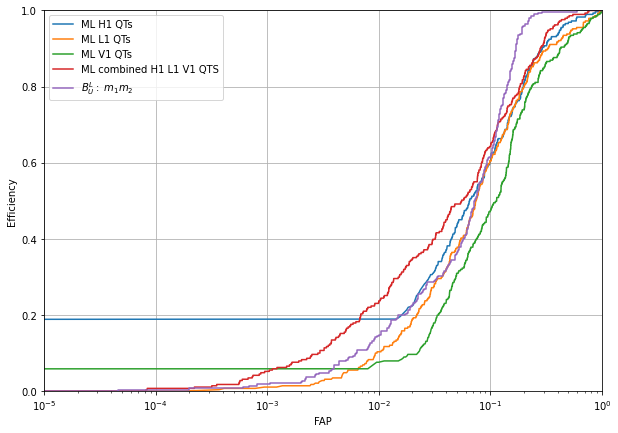

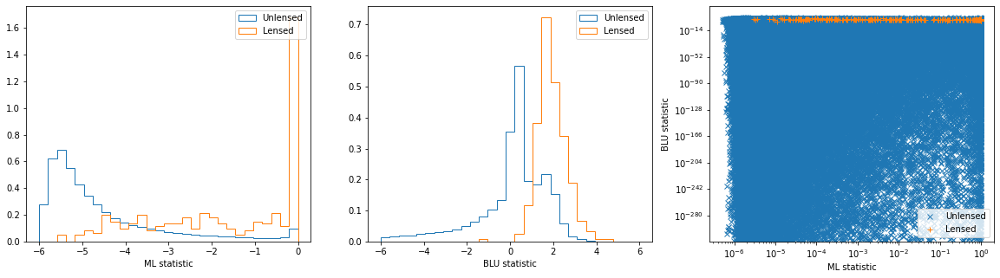

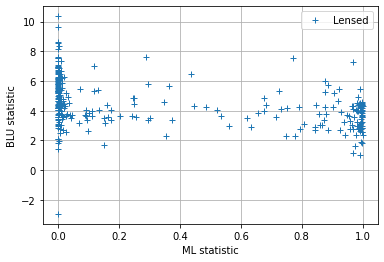

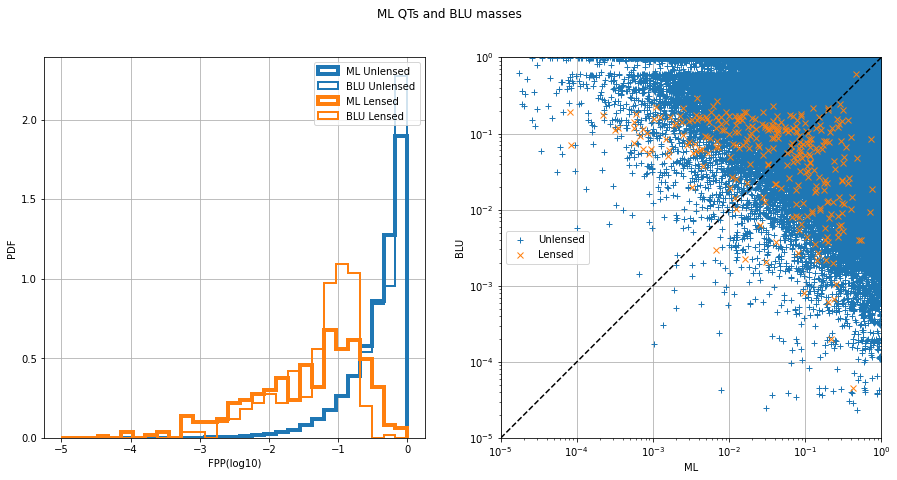

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8972736661516282, 'val_xgb_dense_QTS_0_roc': 0.9616820478433316, 'test_xgb_dense_QTS_0_acc': 0.9762180115648572, 'val_xgb_dense_QTS_0_acc': 0.9952141641565664, 'test_xgb_dense_QTS_0_f1': 0.017361111111111112, 'val_xgb_dense_QTS_0_f1': 0.33812154696132596}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9623


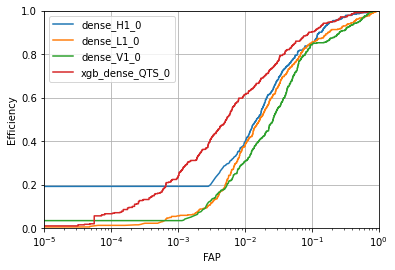

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8974
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

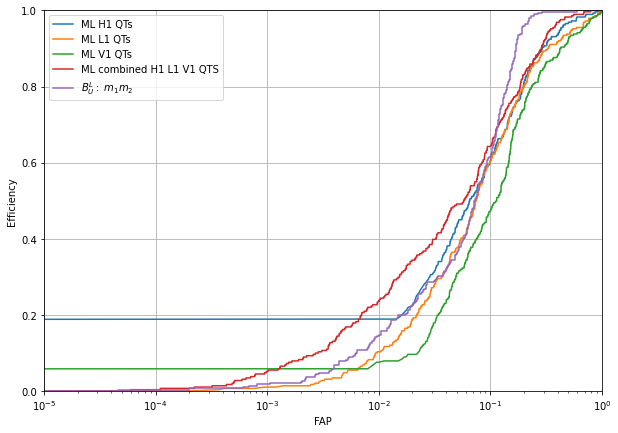

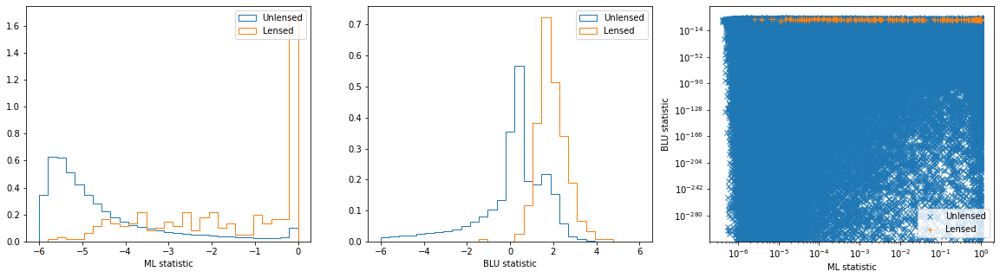

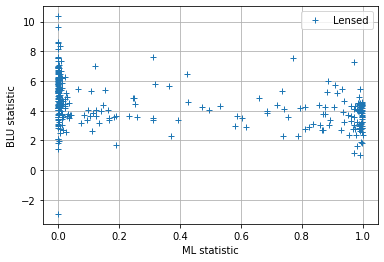

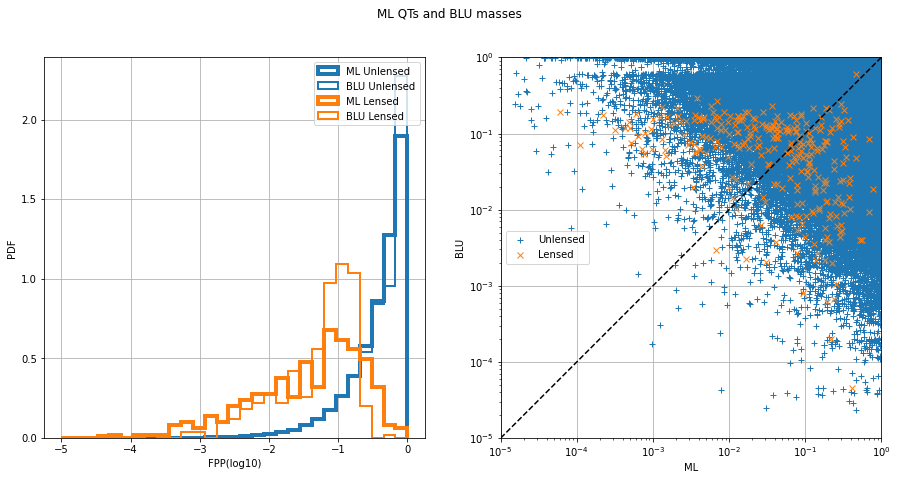

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8974458352286173, 'val_xgb_dense_QTS_0_roc': 0.9623312738191881, 'test_xgb_dense_QTS_0_acc': 0.9754656955921487, 'val_xgb_dense_QTS_0_acc': 0.9951662259010394, 'test_xgb_dense_QTS_0_f1': 0.016837716484926234, 'val_xgb_dense_QTS_0_f1': 0.34310532030401736}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9617


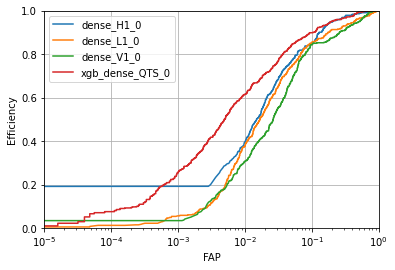

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8992
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

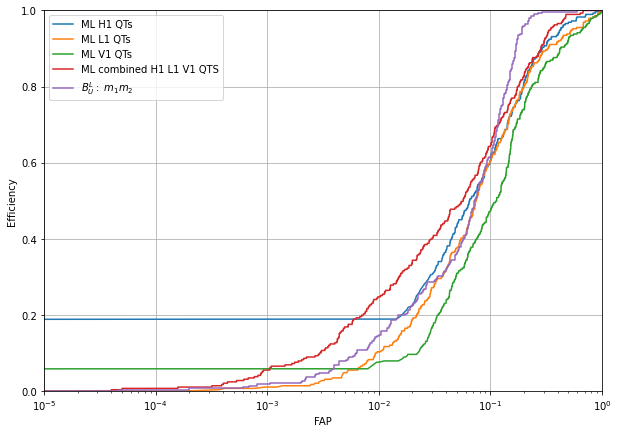

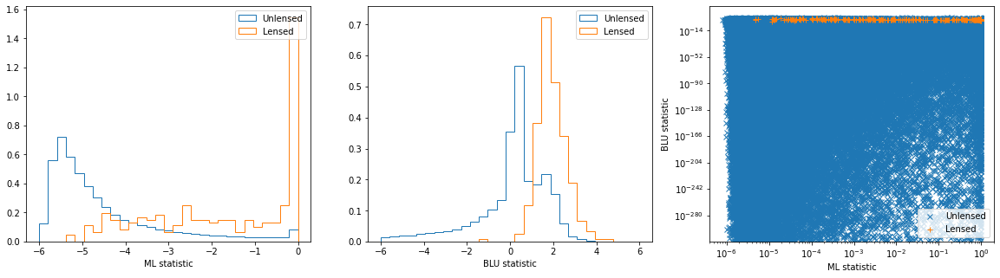

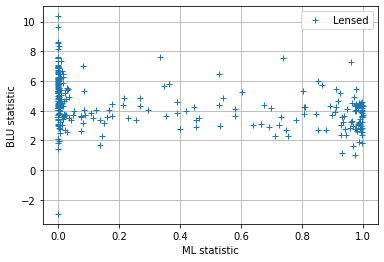

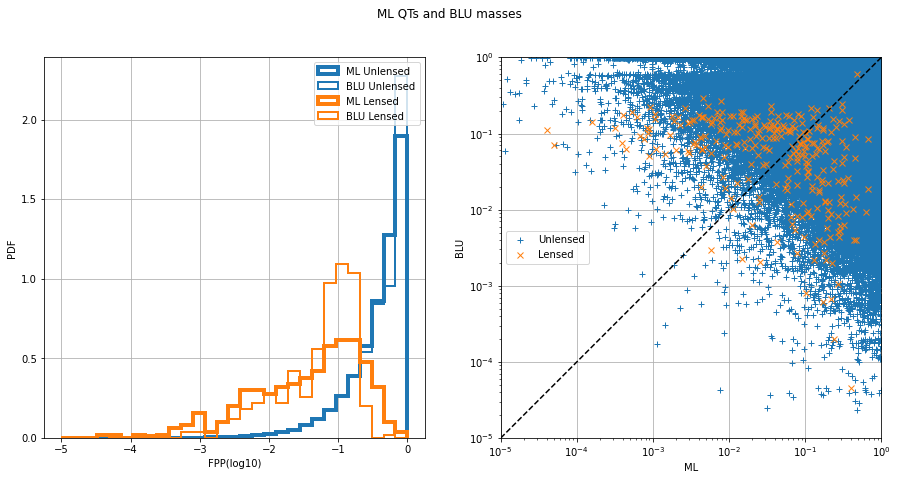

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8992462371695064, 'val_xgb_dense_QTS_0_roc': 0.9616708603302616, 'test_xgb_dense_QTS_0_acc': 0.9789771704115728, 'val_xgb_dense_QTS_0_acc': 0.9955976702007814, 'test_xgb_dense_QTS_0_f1': 0.018679368637340057, 'val_xgb_dense_QTS_0_f1': 0.3494687131050767}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9620


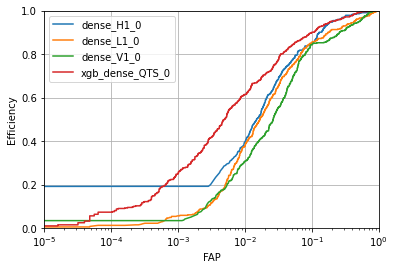

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8990
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

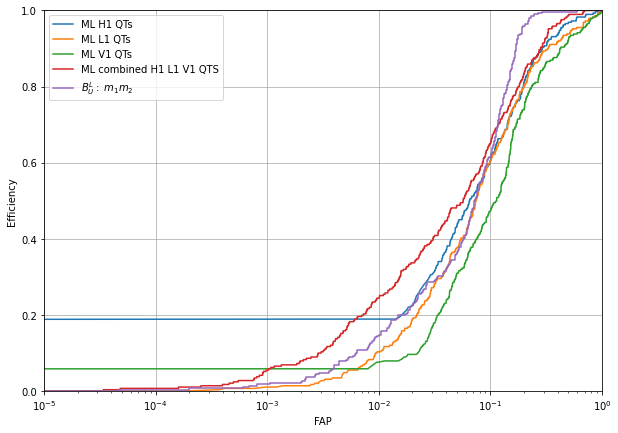

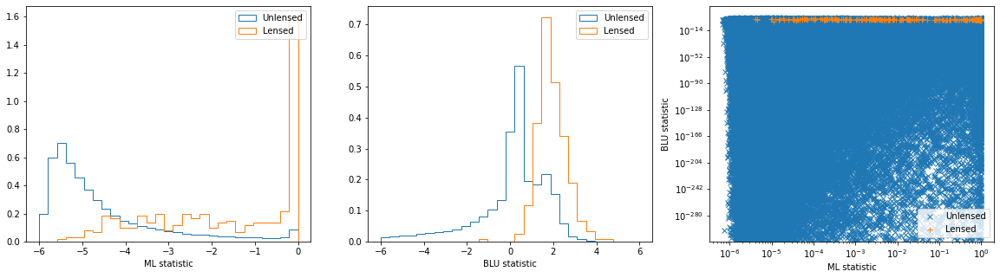

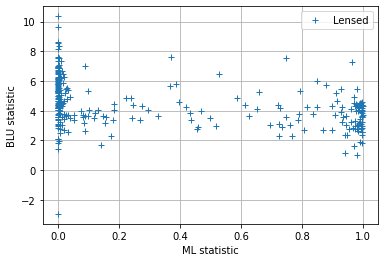

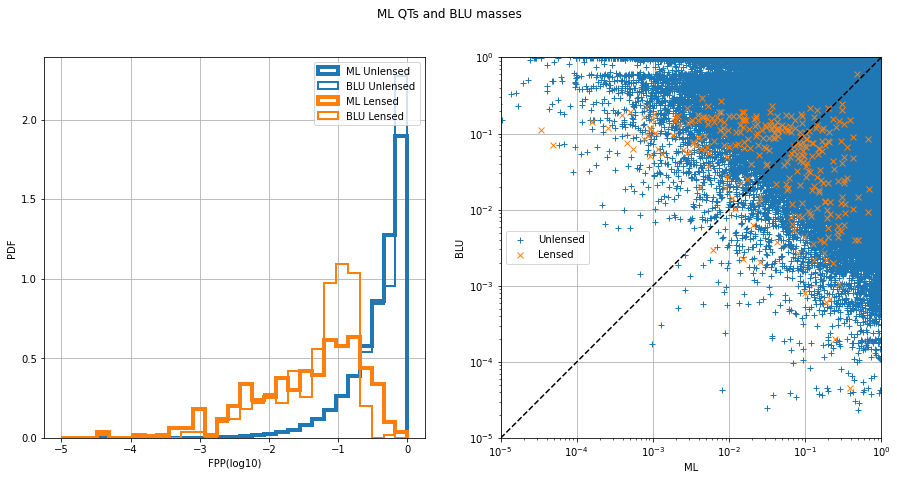

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8990252631762455, 'val_xgb_dense_QTS_0_roc': 0.9619561224570006, 'test_xgb_dense_QTS_0_acc': 0.978006762840393, 'val_xgb_dense_QTS_0_acc': 0.9955177731082366, 'test_xgb_dense_QTS_0_f1': 0.017869907076483203, 'val_xgb_dense_QTS_0_f1': 0.3499420625724218}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9616


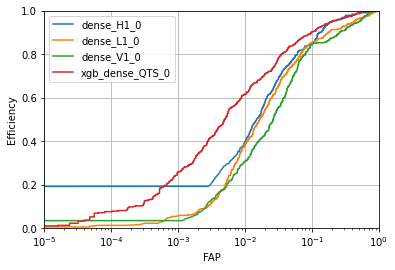

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8994
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

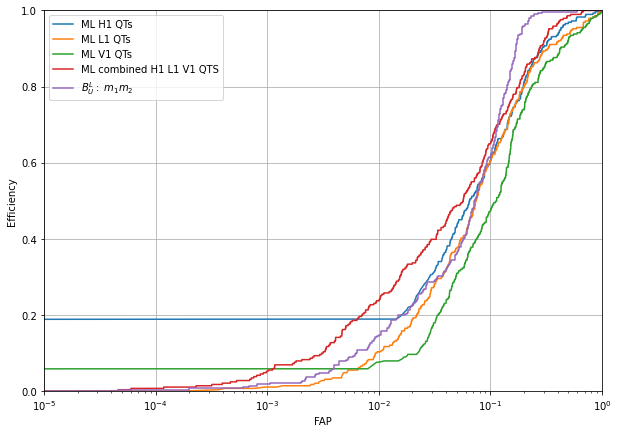

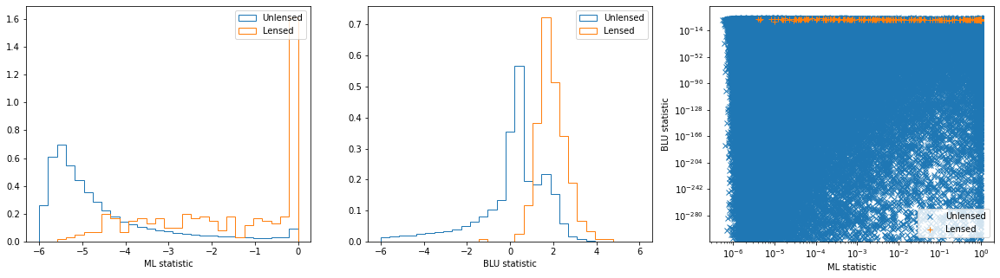

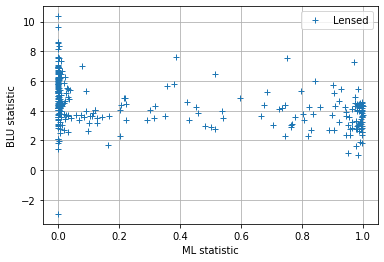

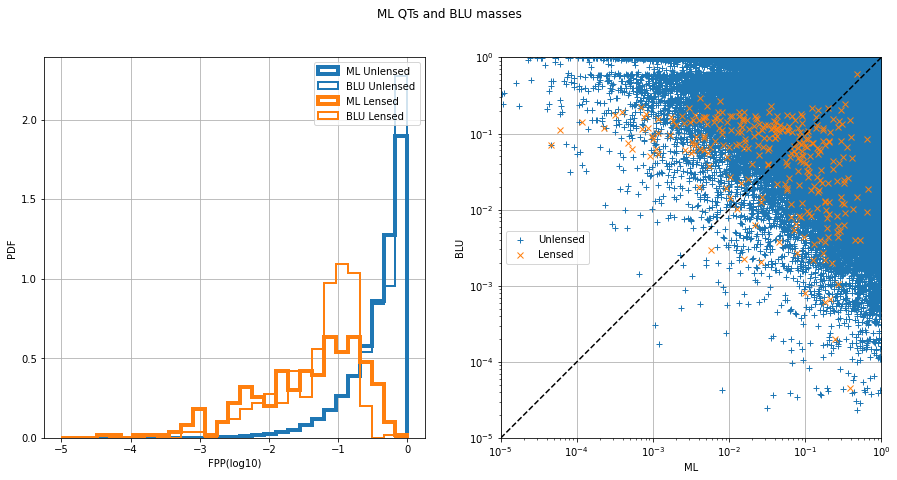

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8994464240110172, 'val_xgb_dense_QTS_0_roc': 0.9615587128079397, 'test_xgb_dense_QTS_0_acc': 0.9770983813201545, 'val_xgb_dense_QTS_0_acc': 0.9954298863064374, 'test_xgb_dense_QTS_0_f1': 0.017679368348781324, 'val_xgb_dense_QTS_0_f1': 0.3529411764705882}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9615


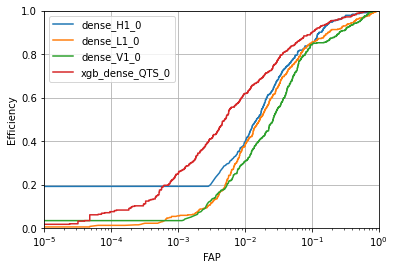

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8987
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

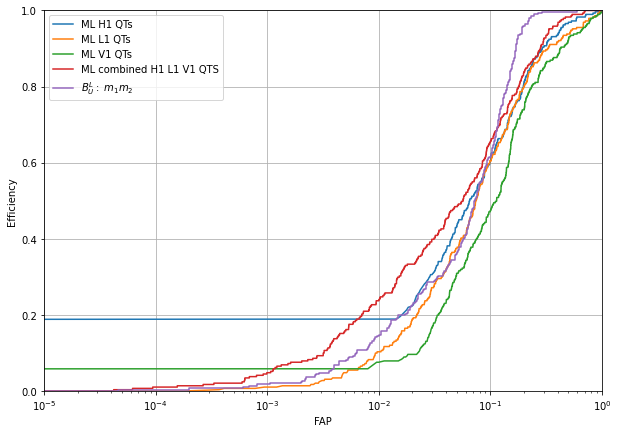

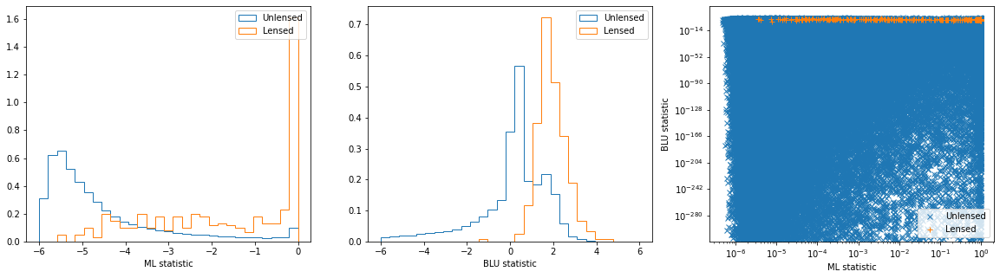

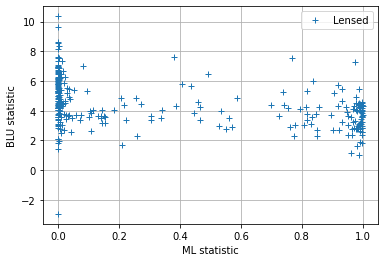

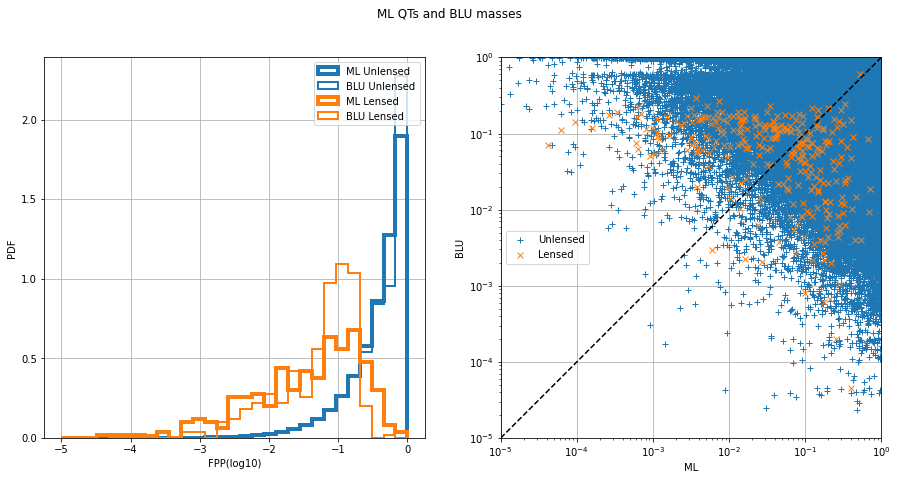

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8987404348229091, 'val_xgb_dense_QTS_0_roc': 0.9615240607022395, 'test_xgb_dense_QTS_0_acc': 0.9761599871946217, 'val_xgb_dense_QTS_0_acc': 0.995326020086129, 'test_xgb_dense_QTS_0_f1': 0.01699529741770481, 'val_xgb_dense_QTS_0_f1': 0.3521594684385382}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9614


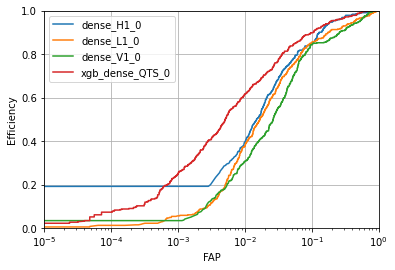

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8992
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

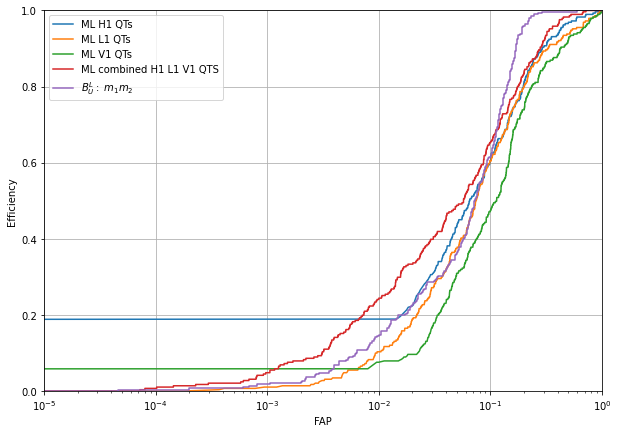

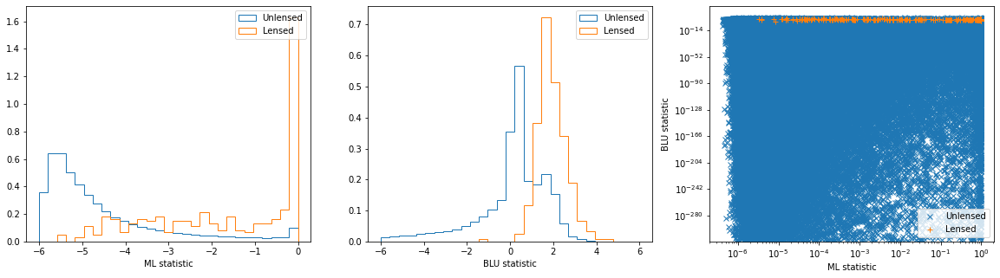

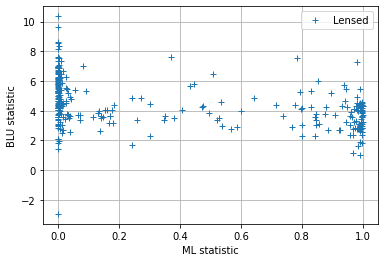

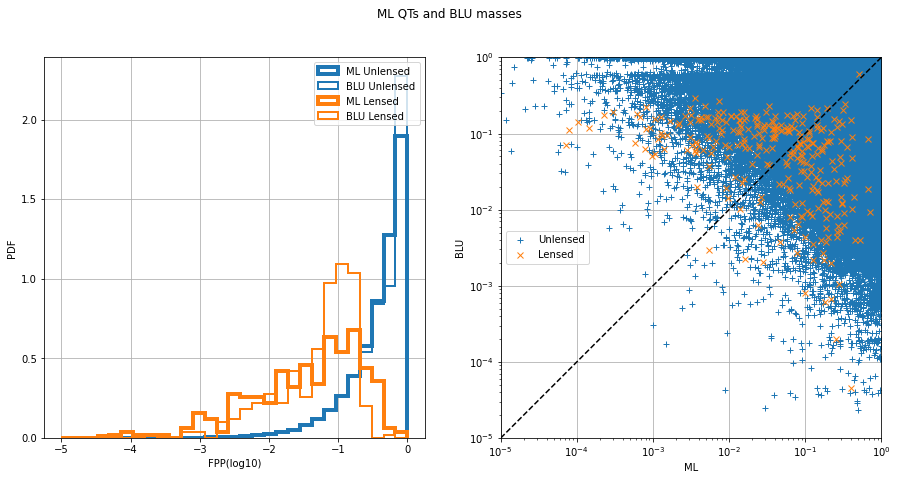

{'scale_pos_weight_xgbqts': 0.01, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.89924200956575, 'val_xgb_dense_QTS_0_roc': 0.9614066307280944, 'test_xgb_dense_QTS_0_acc': 0.9753376418095601, 'val_xgb_dense_QTS_0_acc': 0.9952780818306022, 'test_xgb_dense_QTS_0_f1': 0.016908597862498004, 'val_xgb_dense_QTS_0_f1': 0.35550708833151584}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9620


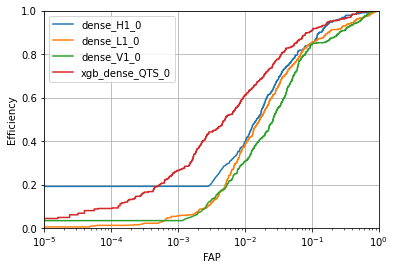

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8995
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

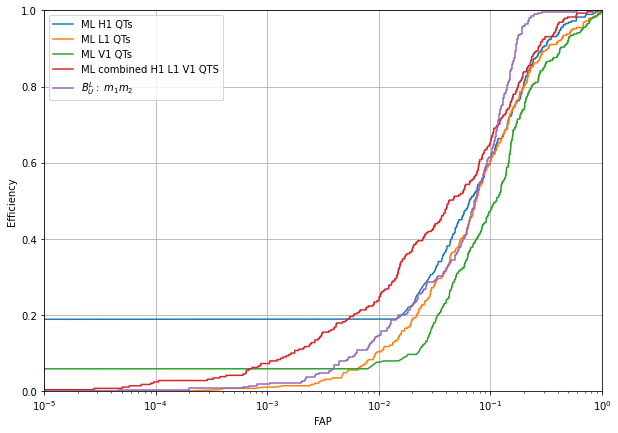

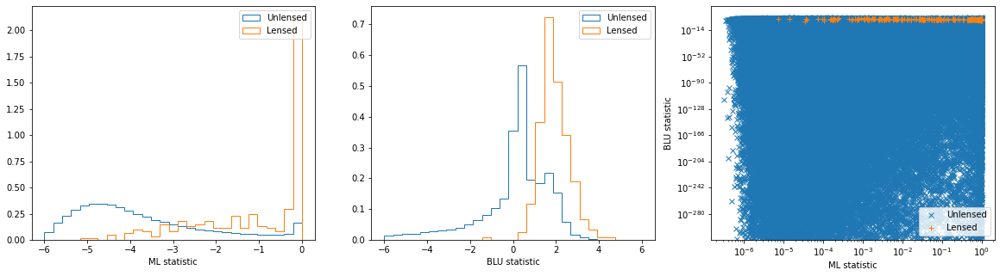

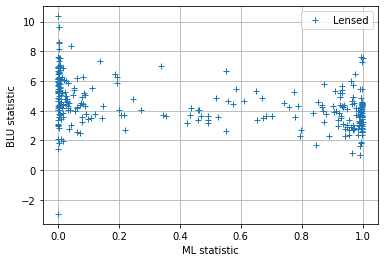

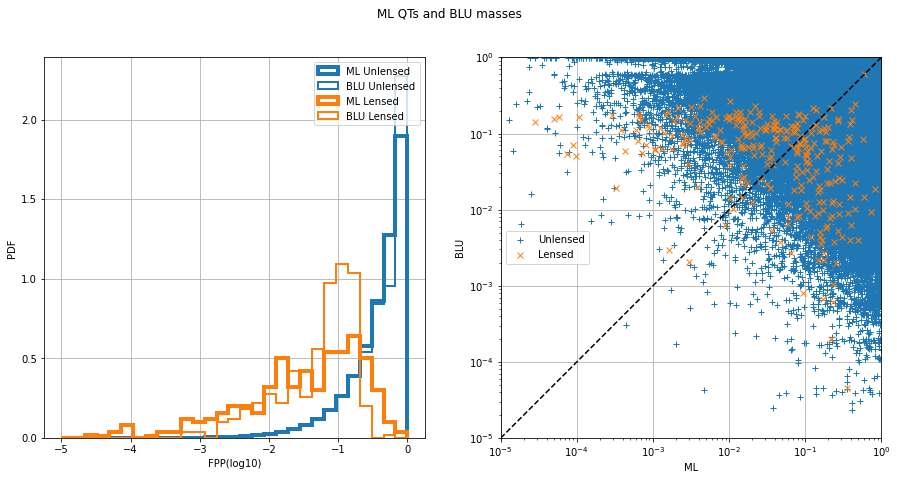

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8995406696478943, 'val_xgb_dense_QTS_0_roc': 0.9619600624072555, 'test_xgb_dense_QTS_0_acc': 0.9608675643770384, 'val_xgb_dense_QTS_0_acc': 0.9932327162614553, 'test_xgb_dense_QTS_0_f1': 0.013716591023701463, 'val_xgb_dense_QTS_0_f1': 0.33149171270718225}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9619


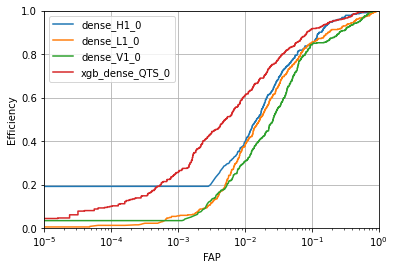

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8994
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

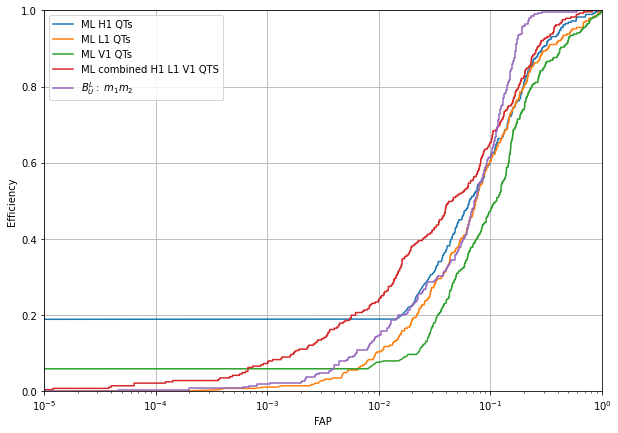

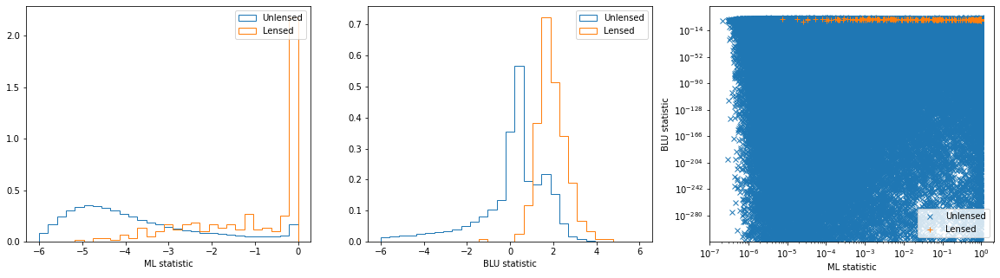

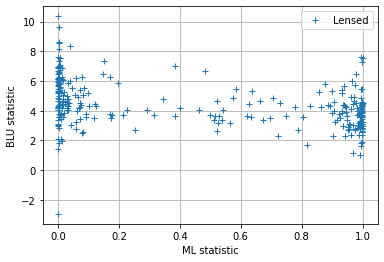

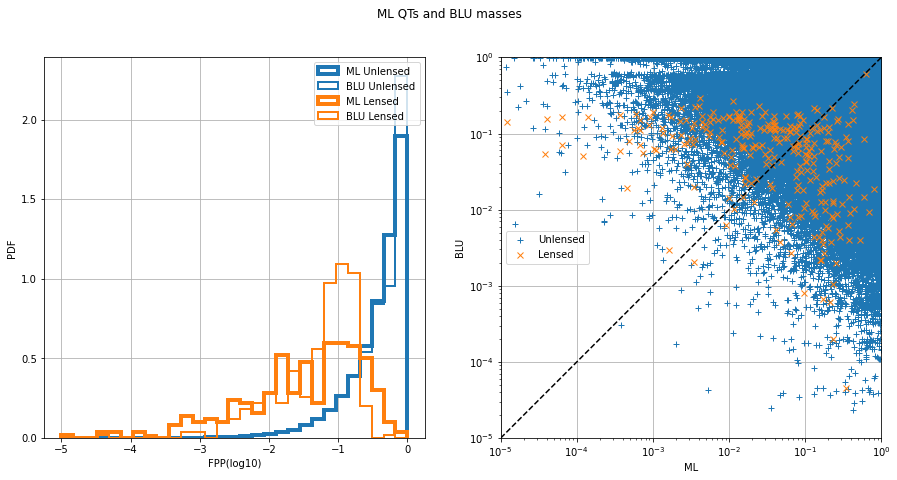

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8993598424108931, 'val_xgb_dense_QTS_0_roc': 0.961872011815259, 'test_xgb_dense_QTS_0_acc': 0.9591488425138558, 'val_xgb_dense_QTS_0_acc': 0.992929107309785, 'test_xgb_dense_QTS_0_f1': 0.013719144002705182, 'val_xgb_dense_QTS_0_f1': 0.3218390804597701}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9618


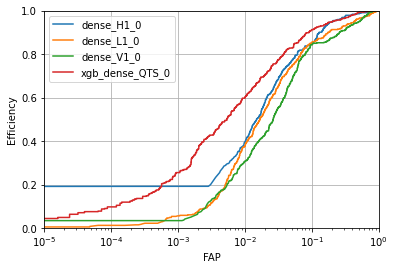

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8990
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

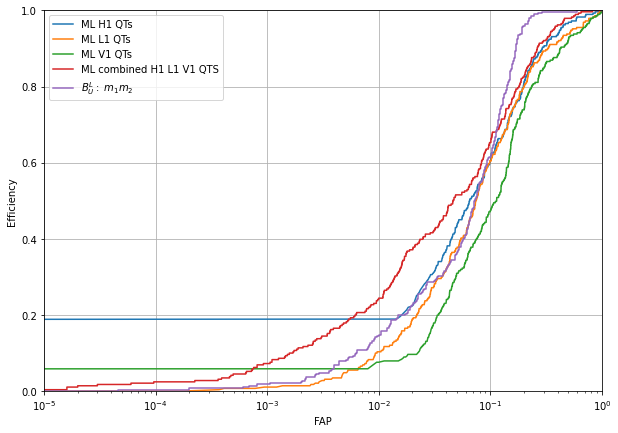

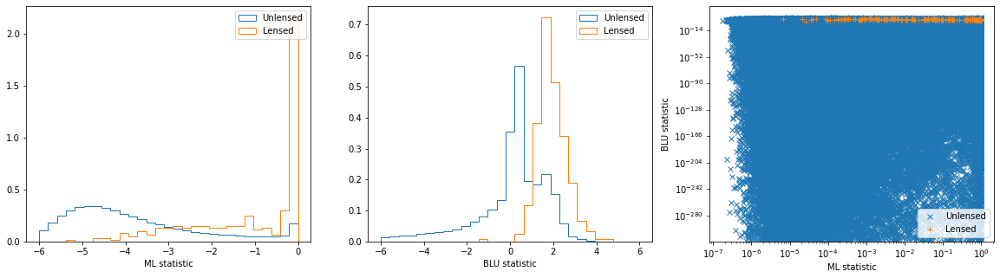

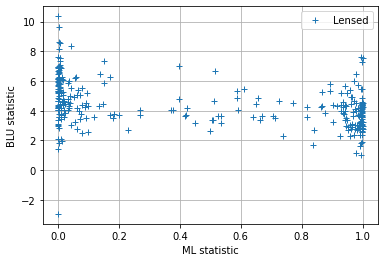

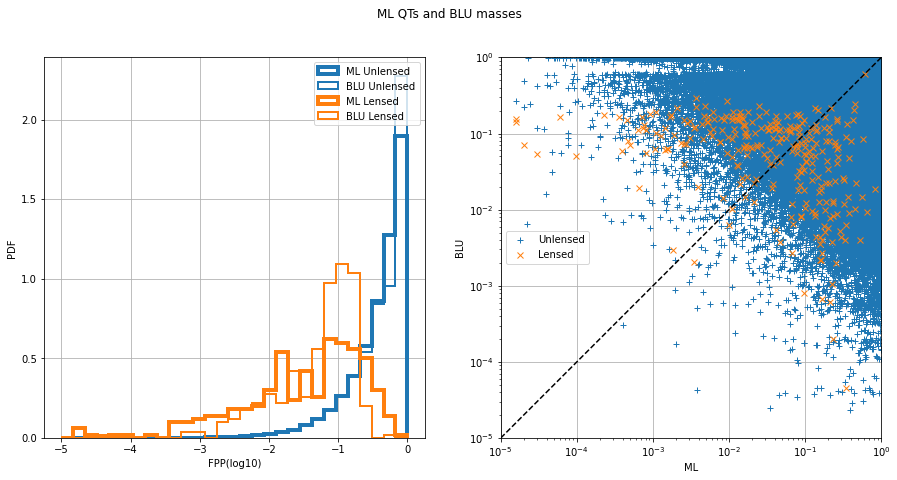

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8989928389345779, 'val_xgb_dense_QTS_0_roc': 0.9618273979587906, 'test_xgb_dense_QTS_0_acc': 0.9578042777966747, 'val_xgb_dense_QTS_0_acc': 0.9927053954506595, 'test_xgb_dense_QTS_0_f1': 0.013195451780450142, 'val_xgb_dense_QTS_0_f1': 0.3171278982797307}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9621


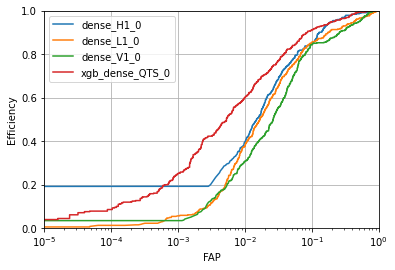

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8987
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

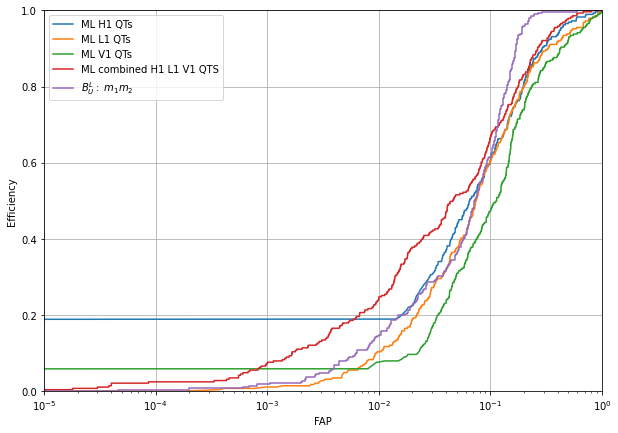

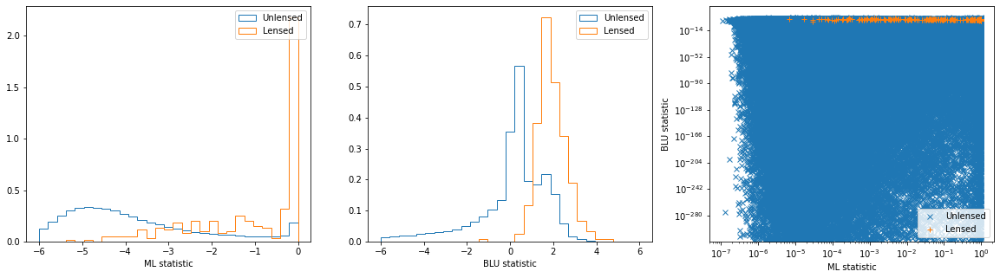

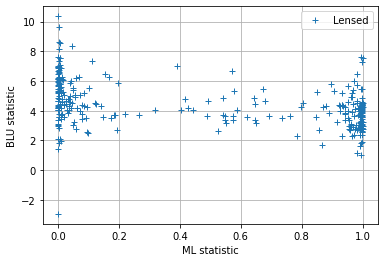

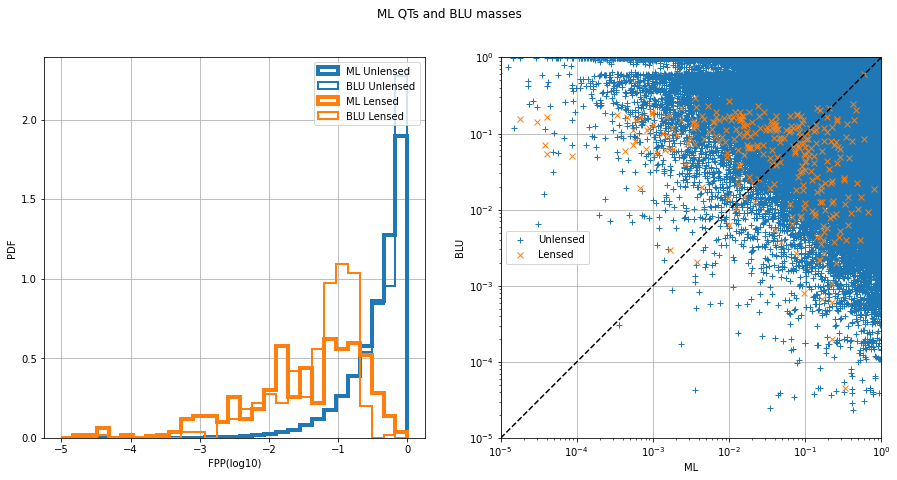

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.898684574727382, 'val_xgb_dense_QTS_0_roc': 0.9621239837944106, 'test_xgb_dense_QTS_0_acc': 0.9567218231657296, 'val_xgb_dense_QTS_0_acc': 0.9924816835915341, 'test_xgb_dense_QTS_0_f1': 0.013049826610695382, 'val_xgb_dense_QTS_0_f1': 0.314639475600874}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9612


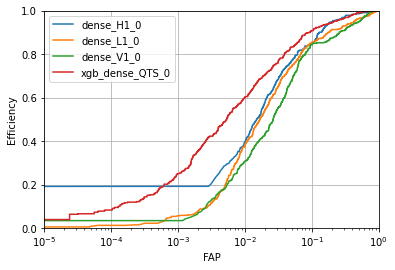

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8976
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

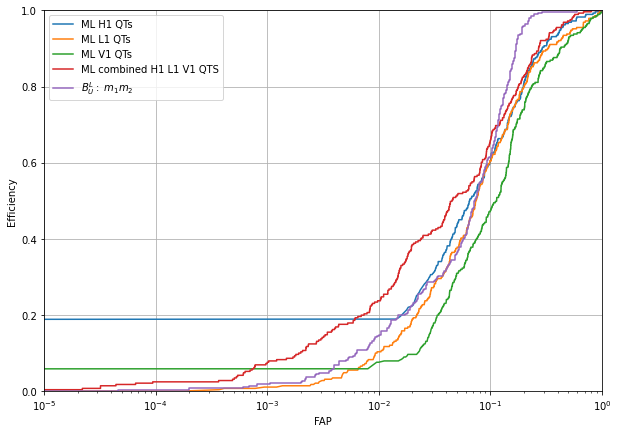

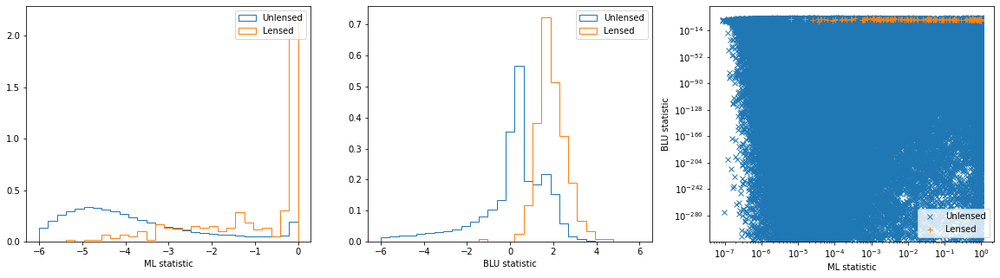

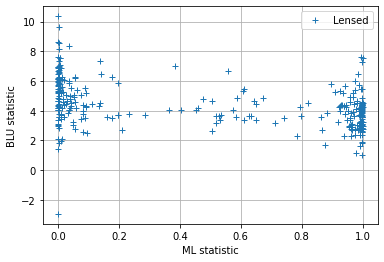

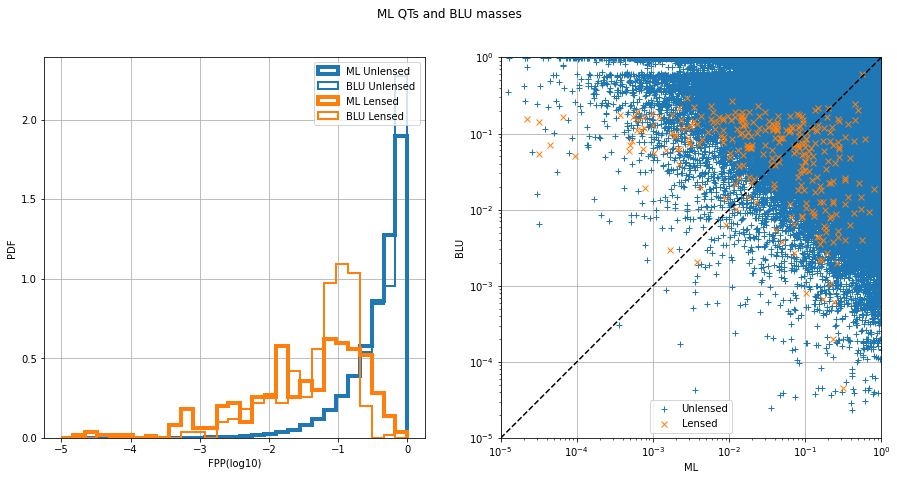

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.897592112382518, 'val_xgb_dense_QTS_0_roc': 0.9612147016451754, 'test_xgb_dense_QTS_0_acc': 0.9557574181156085, 'val_xgb_dense_QTS_0_acc': 0.992329879115699, 'test_xgb_dense_QTS_0_f1': 0.012945272743505045, 'val_xgb_dense_QTS_0_f1': 0.3133047210300429}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9638


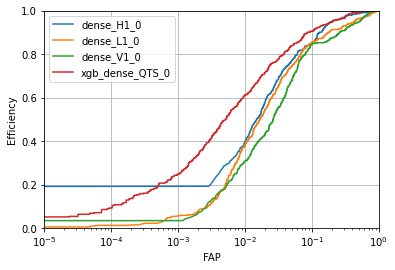

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8995
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

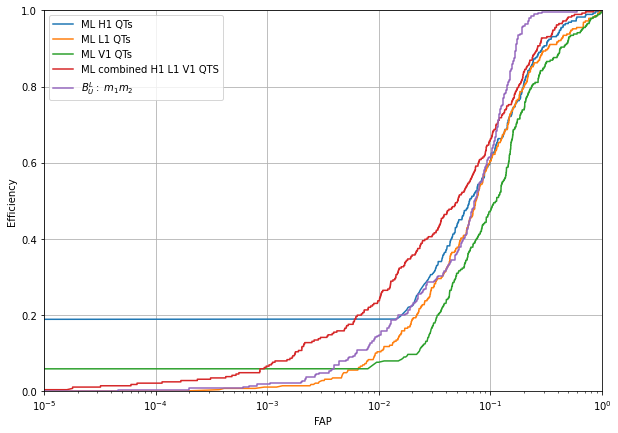

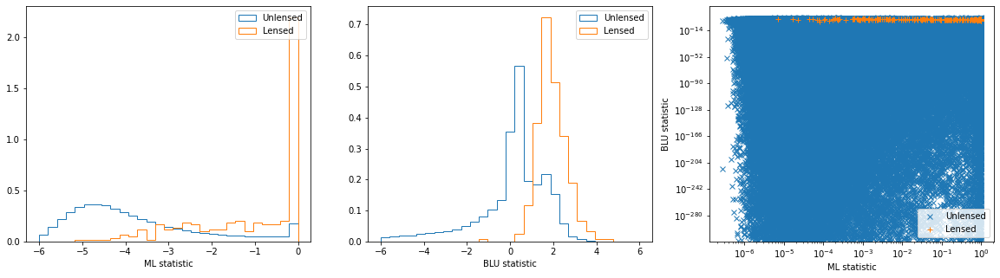

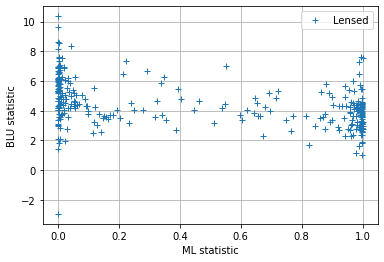

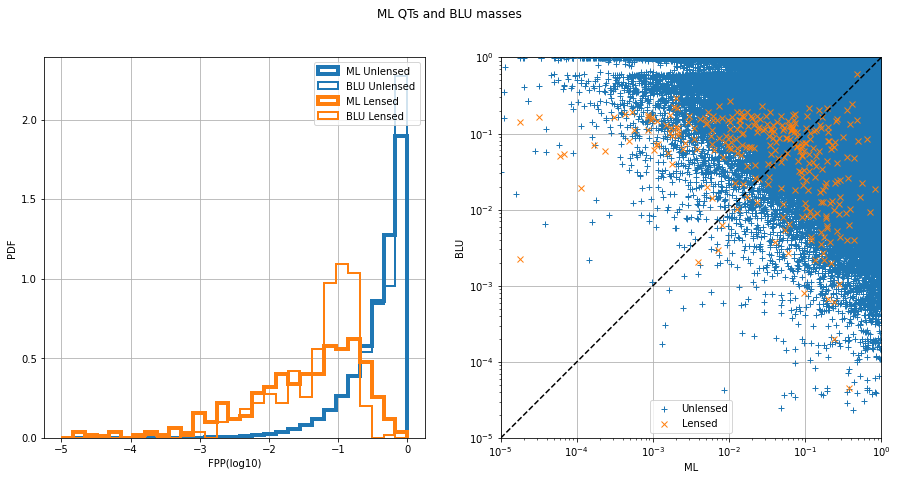

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8995441714384755, 'val_xgb_dense_QTS_0_roc': 0.9638150882700619, 'test_xgb_dense_QTS_0_acc': 0.956785850057024, 'val_xgb_dense_QTS_0_acc': 0.9925695703933334, 'test_xgb_dense_QTS_0_f1': 0.01270799049186323, 'val_xgb_dense_QTS_0_f1': 0.3181818181818182}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9638


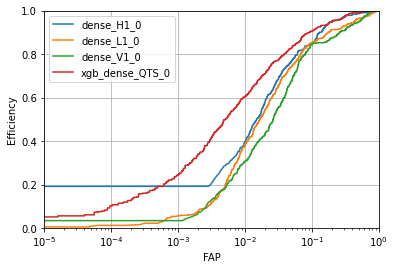

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8983
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

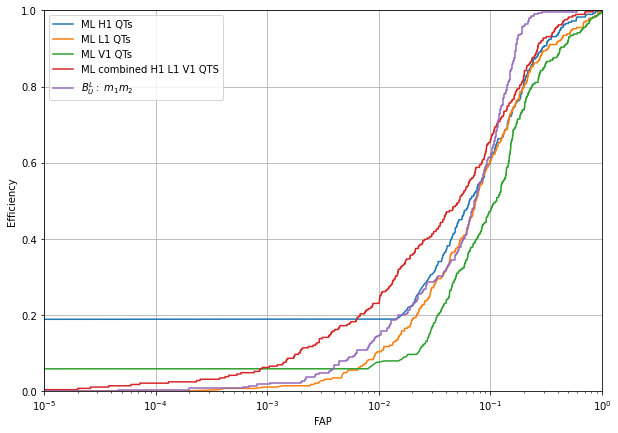

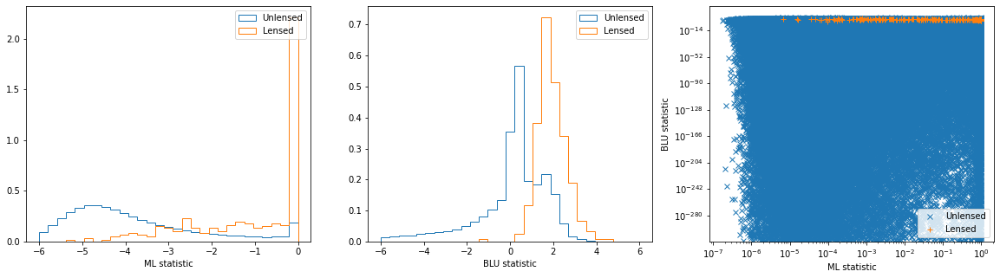

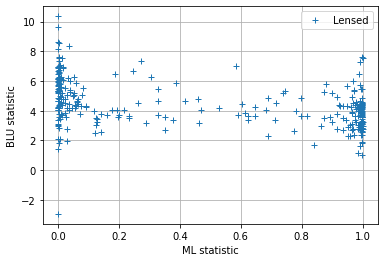

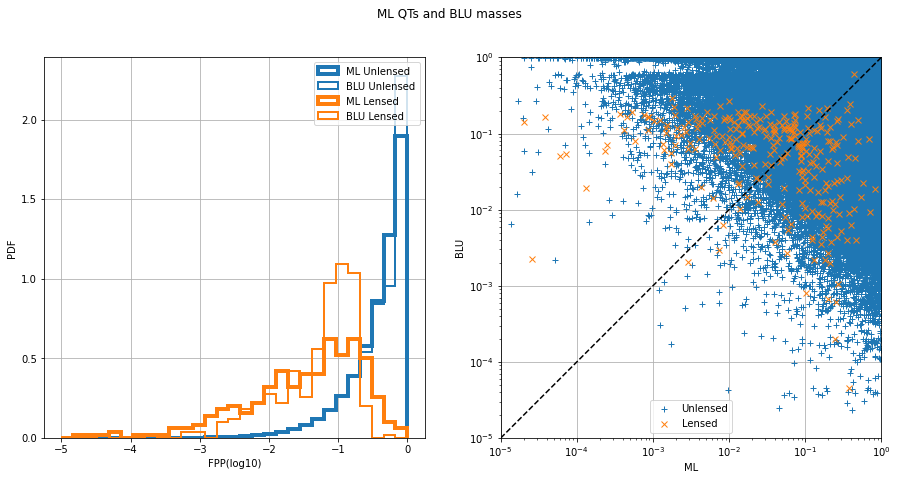

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.898318943760342, 'val_xgb_dense_QTS_0_roc': 0.9637896196533513, 'test_xgb_dense_QTS_0_acc': 0.95566337861902, 'val_xgb_dense_QTS_0_acc': 0.992345858534208, 'test_xgb_dense_QTS_0_f1': 0.012302206373969244, 'val_xgb_dense_QTS_0_f1': 0.3147353361945637}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9634


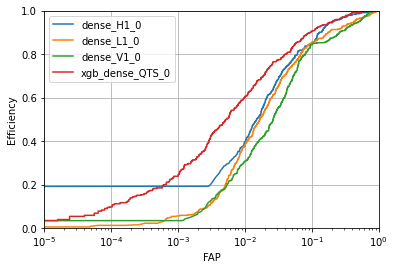

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8983
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

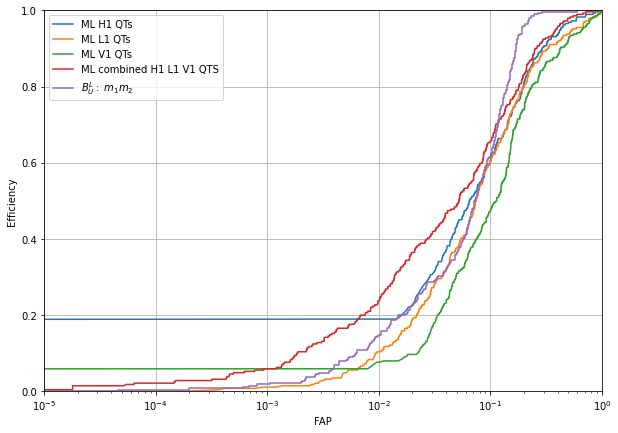

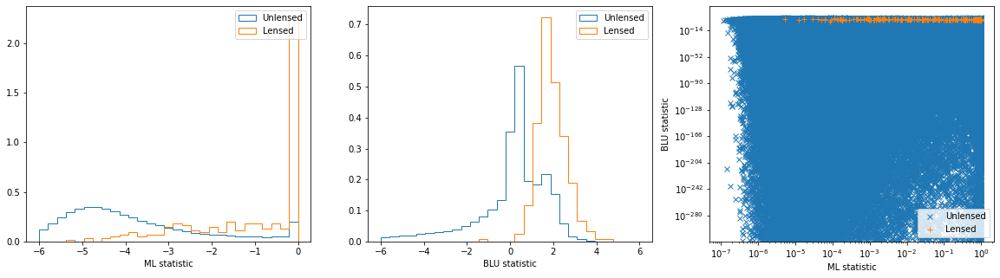

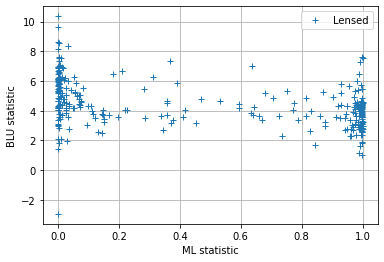

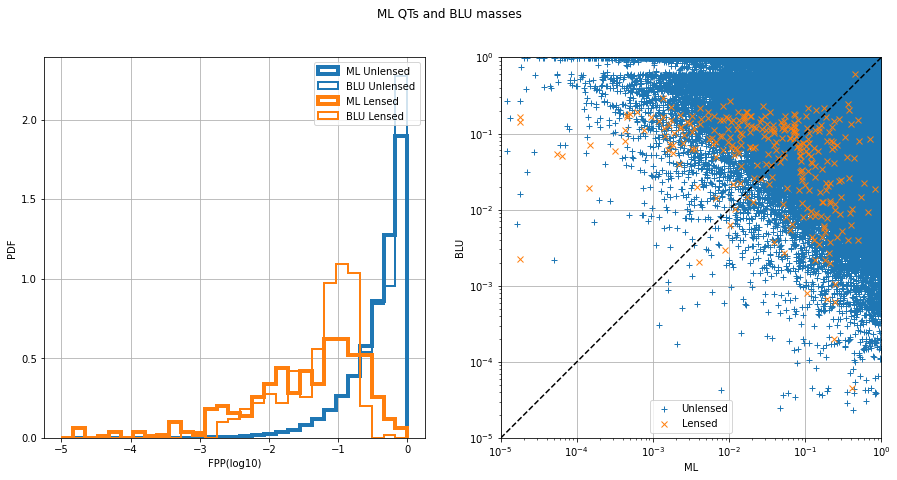

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8983359573715544, 'val_xgb_dense_QTS_0_roc': 0.963365330788106, 'test_xgb_dense_QTS_0_acc': 0.9542087676824266, 'val_xgb_dense_QTS_0_acc': 0.992114156965828, 'test_xgb_dense_QTS_0_f1': 0.012001381453980315, 'val_xgb_dense_QTS_0_f1': 0.311235170969993}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9631


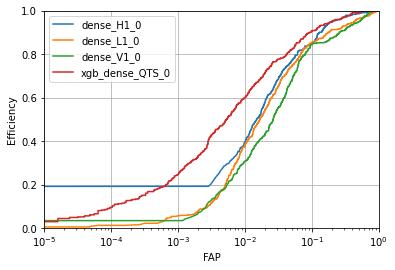

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8982
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

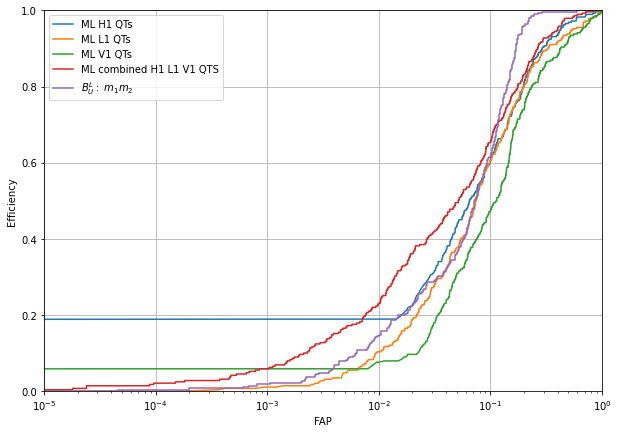

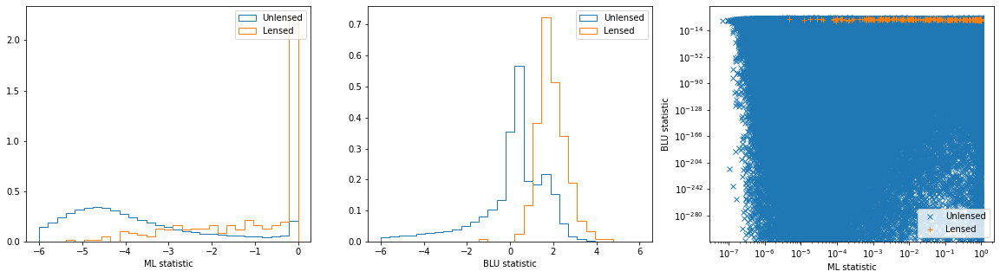

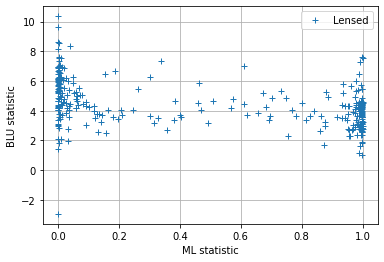

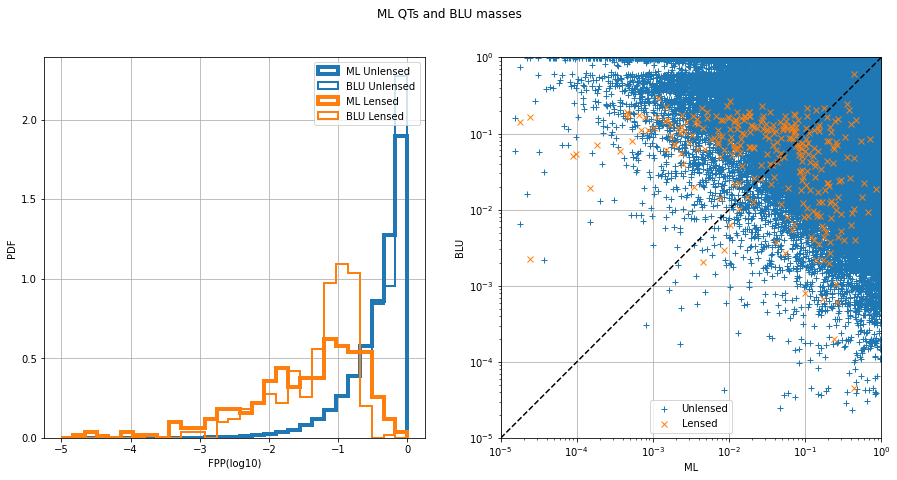

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.898184403452672, 'val_xgb_dense_QTS_0_roc': 0.9631317355152058, 'test_xgb_dense_QTS_0_acc': 0.9533624122131296, 'val_xgb_dense_QTS_0_acc': 0.9918664759789392, 'test_xgb_dense_QTS_0_f1': 0.011869939378523887, 'val_xgb_dense_QTS_0_f1': 0.3027397260273973}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9622


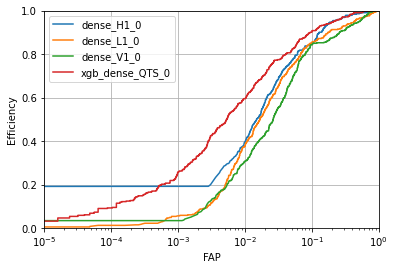

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8976
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

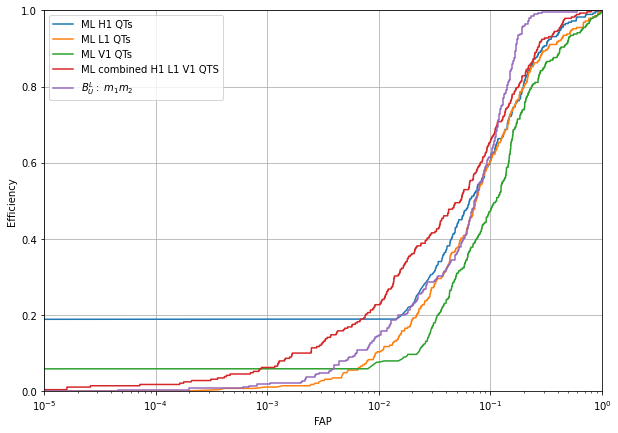

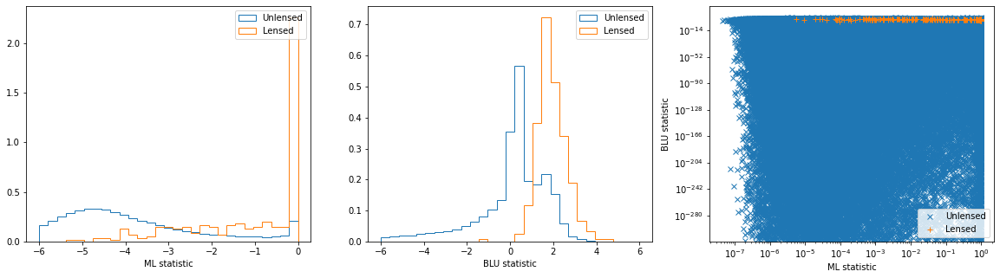

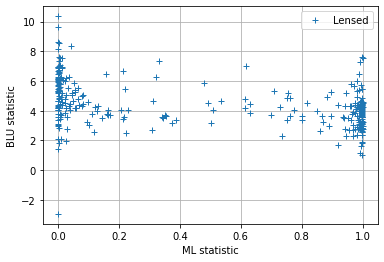

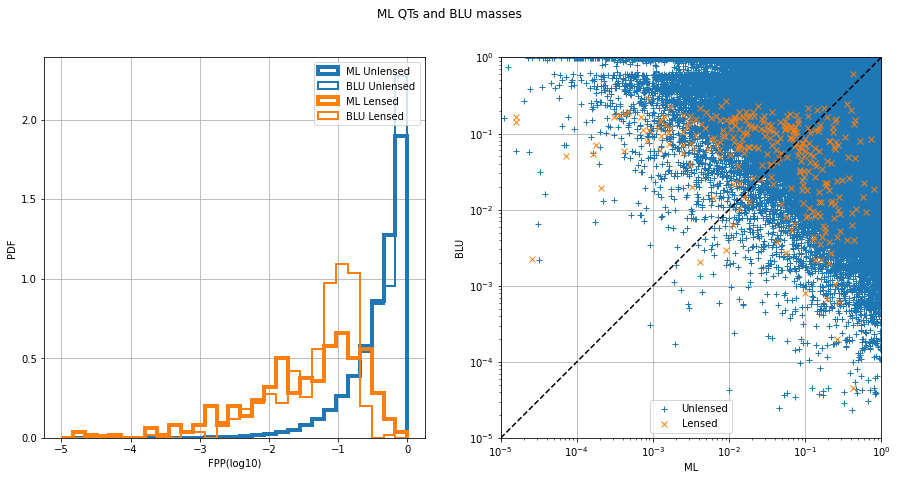

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8975537096418034, 'val_xgb_dense_QTS_0_roc': 0.9622125888979245, 'test_xgb_dense_QTS_0_acc': 0.9524840432981853, 'val_xgb_dense_QTS_0_acc': 0.9916827126660861, 'test_xgb_dense_QTS_0_f1': 0.011817576564580557, 'val_xgb_dense_QTS_0_f1': 0.29993275050437124}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9612


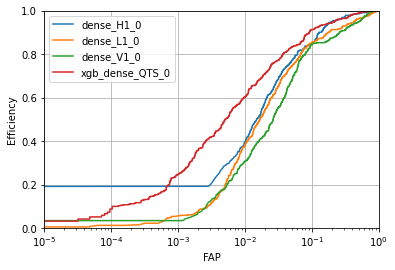

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8982
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

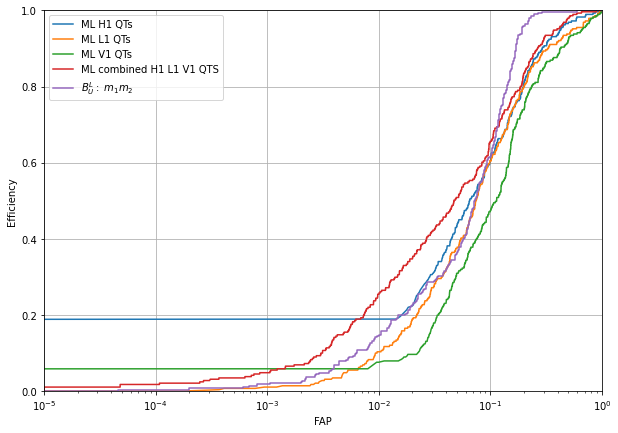

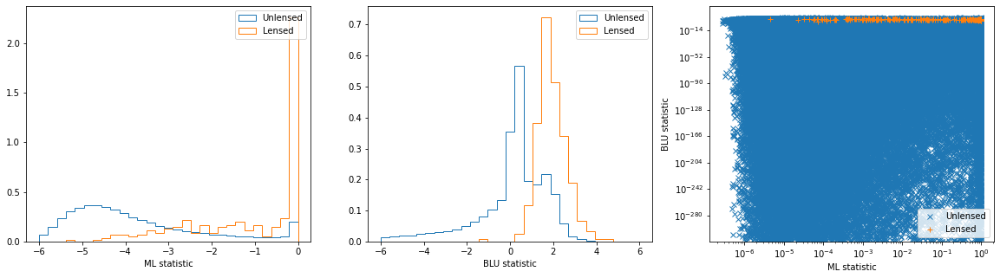

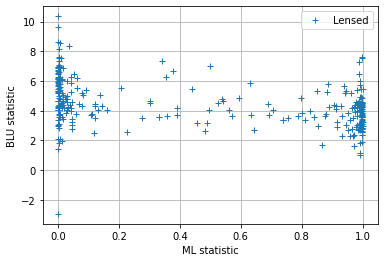

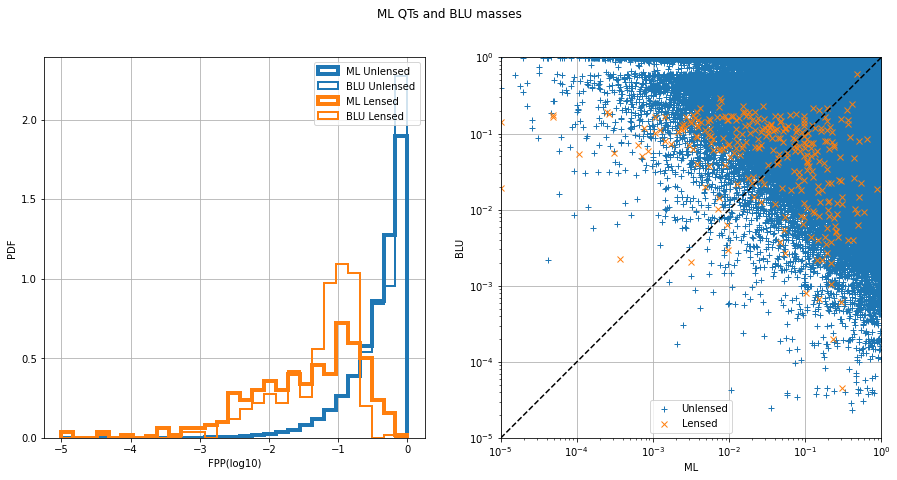

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8981685353191251, 'val_xgb_dense_QTS_0_roc': 0.961172325291321, 'test_xgb_dense_QTS_0_acc': 0.9533464054903059, 'val_xgb_dense_QTS_0_acc': 0.992130136384337, 'test_xgb_dense_QTS_0_f1': 0.012033388415745097, 'val_xgb_dense_QTS_0_f1': 0.3116701607267645}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9612


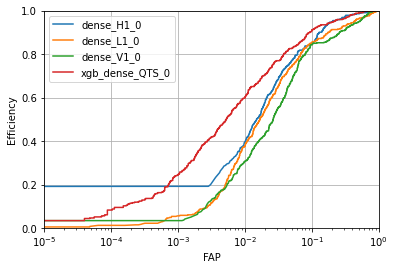

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8972
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

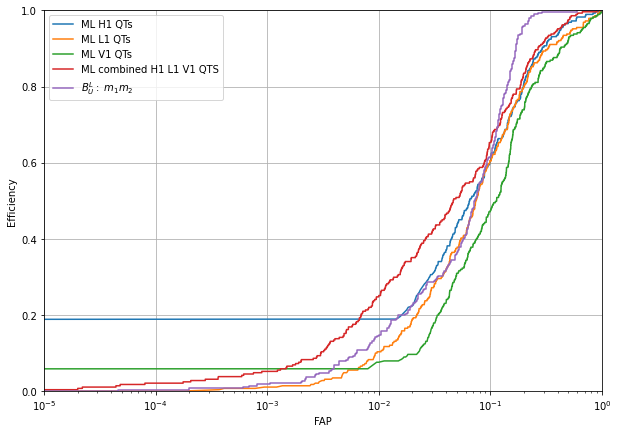

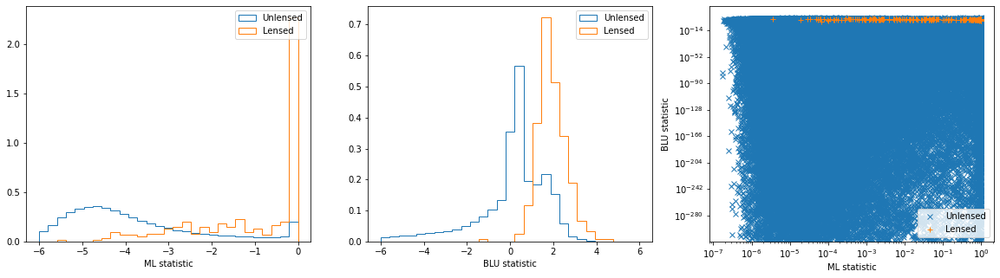

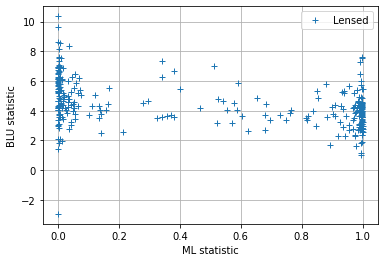

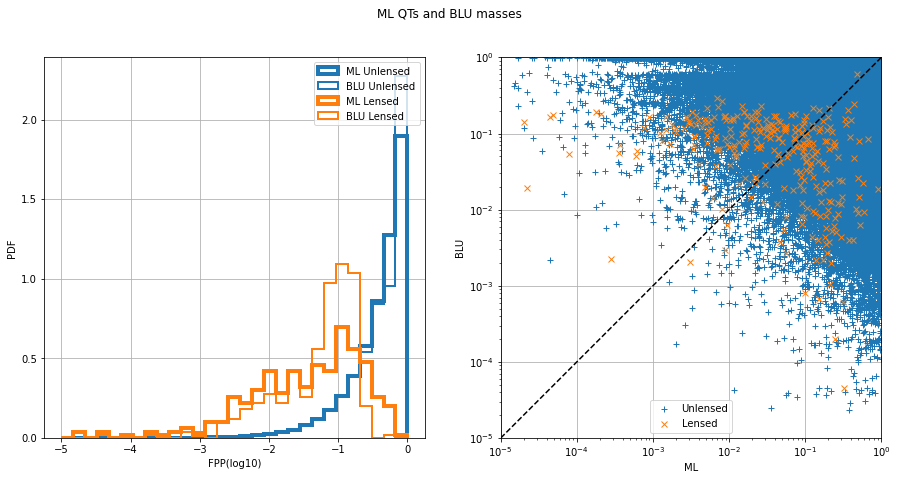

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8971559330627984, 'val_xgb_dense_QTS_0_roc': 0.9611813531279547, 'test_xgb_dense_QTS_0_acc': 0.9522759559014786, 'val_xgb_dense_QTS_0_acc': 0.9918584862696846, 'test_xgb_dense_QTS_0_f1': 0.012175929760622876, 'val_xgb_dense_QTS_0_f1': 0.305385139740968}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9614


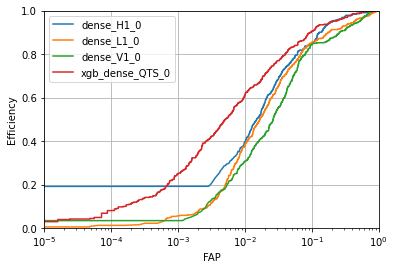

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8970
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

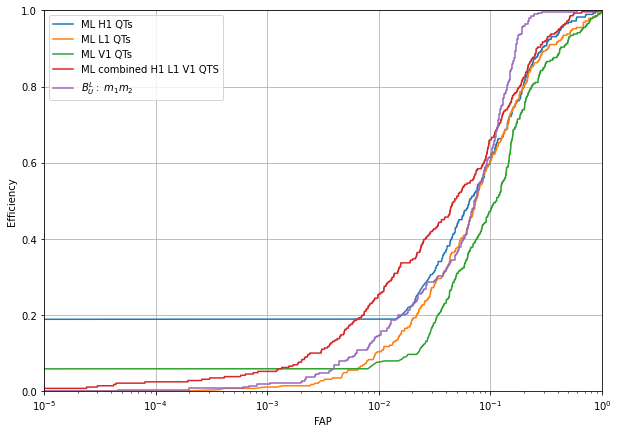

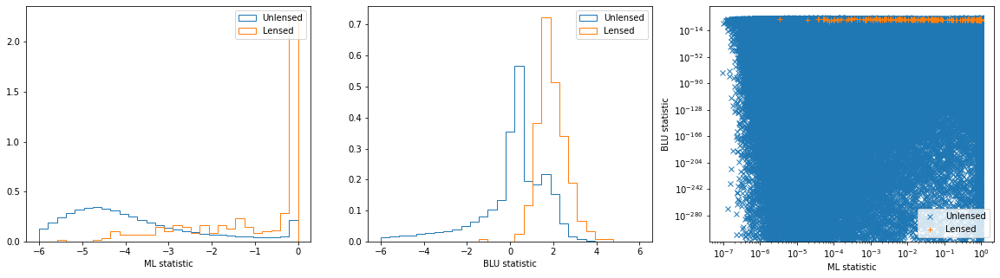

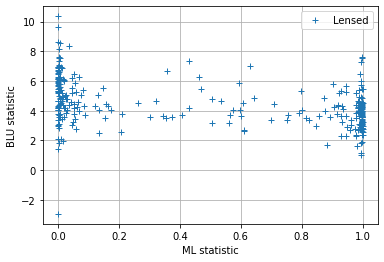

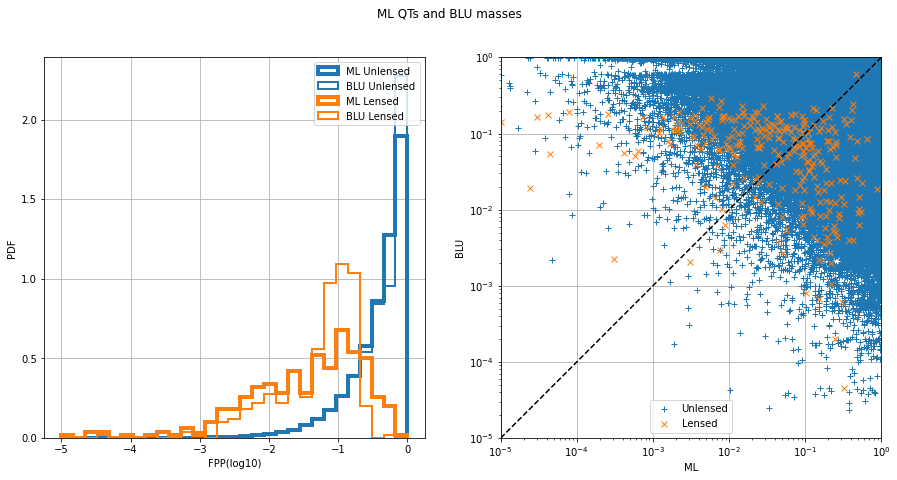

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8969675931434501, 'val_xgb_dense_QTS_0_roc': 0.9613617736648199, 'test_xgb_dense_QTS_0_acc': 0.9515996718621821, 'val_xgb_dense_QTS_0_acc': 0.991714671503104, 'test_xgb_dense_QTS_0_f1': 0.0120078418559059, 'val_xgb_dense_QTS_0_f1': 0.30449362843729044}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9605


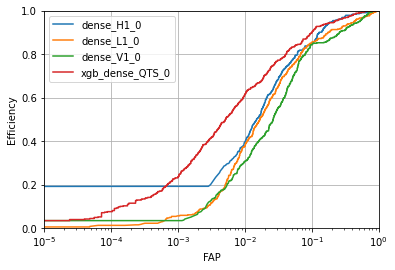

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8958
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

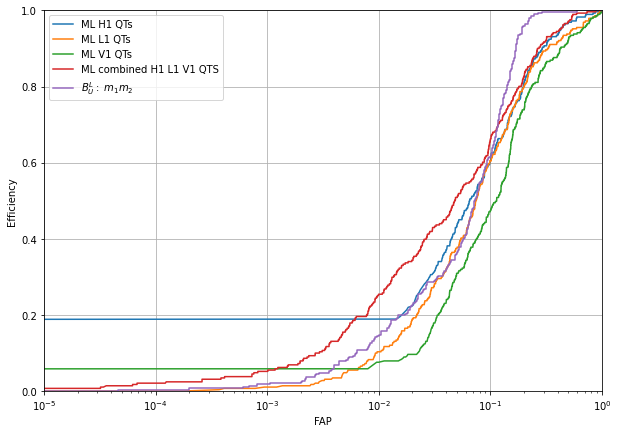

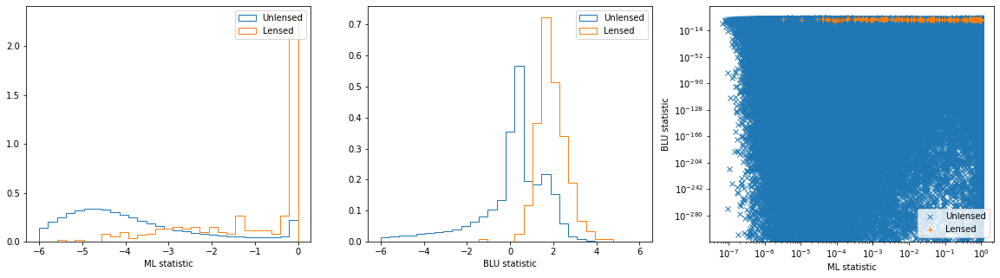

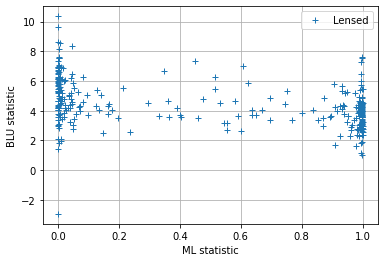

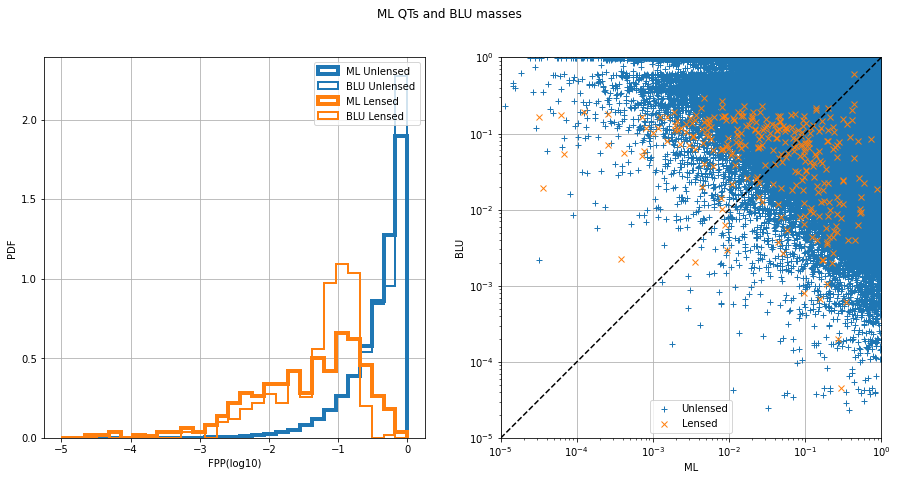

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.895831413454288, 'val_xgb_dense_QTS_0_roc': 0.9605359795479032, 'test_xgb_dense_QTS_0_acc': 0.9504772004241782, 'val_xgb_dense_QTS_0_acc': 0.9914829699347241, 'test_xgb_dense_QTS_0_f1': 0.011817782568770712, 'val_xgb_dense_QTS_0_f1': 0.30052493438320205}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9598


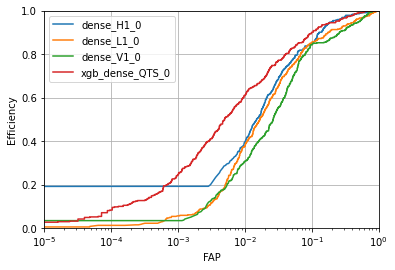

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8944
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

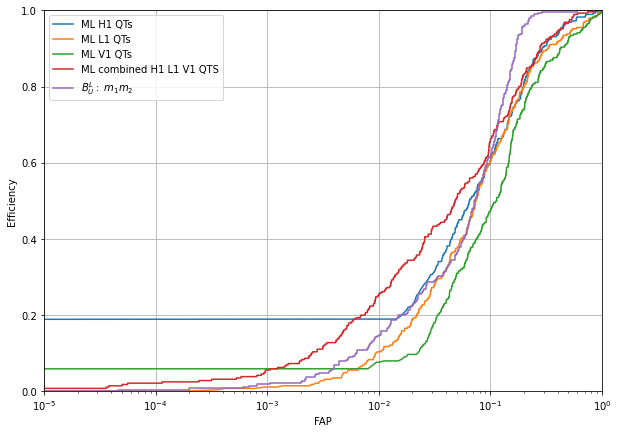

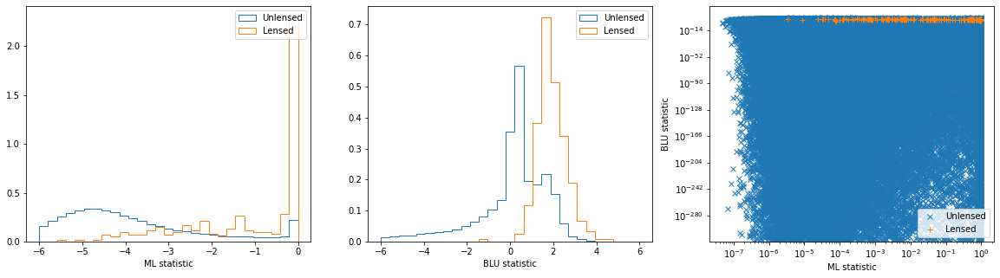

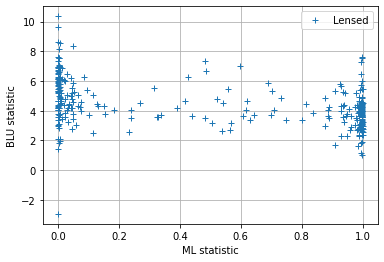

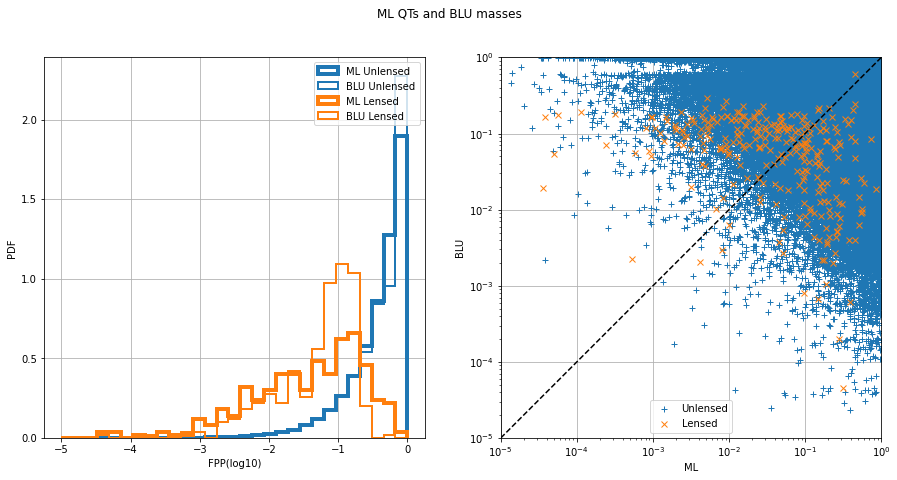

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8943537782246127, 'val_xgb_dense_QTS_0_roc': 0.9597774272486725, 'test_xgb_dense_QTS_0_acc': 0.949786910502411, 'val_xgb_dense_QTS_0_acc': 0.9912193095293262, 'test_xgb_dense_QTS_0_f1': 0.011657214870825456, 'val_xgb_dense_QTS_0_f1': 0.29596412556053814}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9604


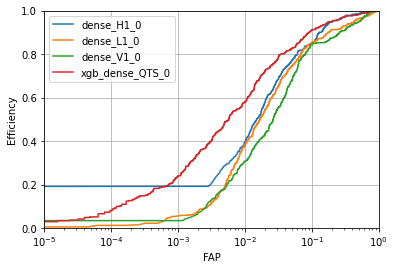

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8976
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

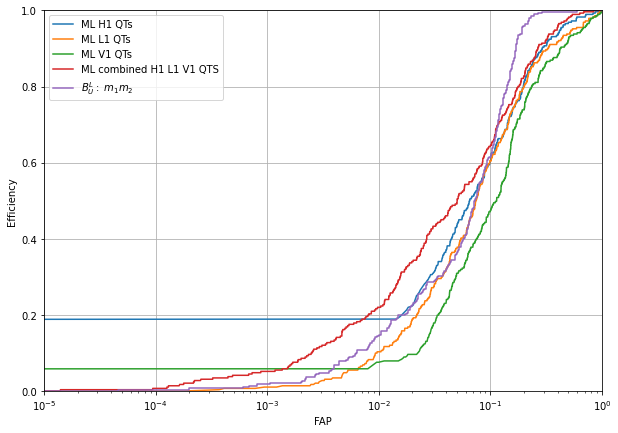

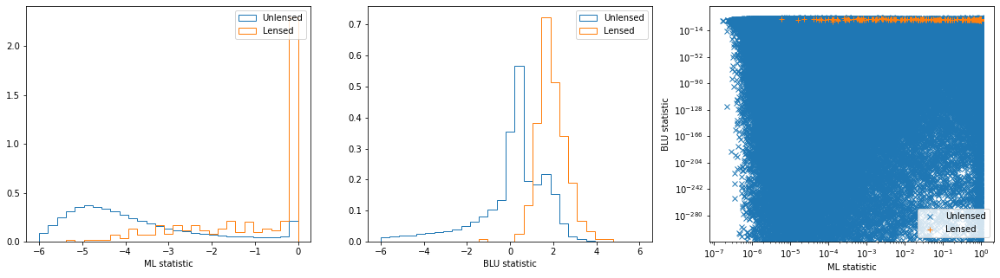

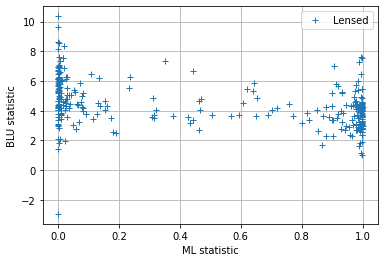

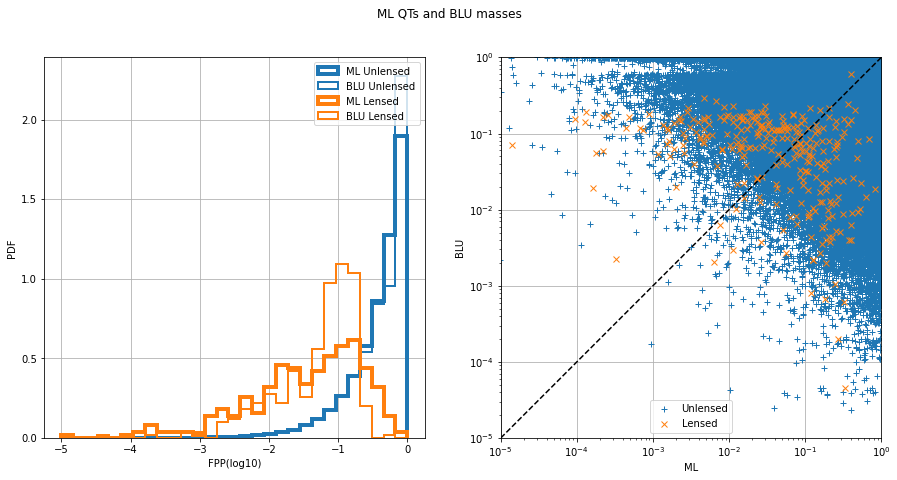

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8976082350666571, 'val_xgb_dense_QTS_0_roc': 0.9604326166554091, 'test_xgb_dense_QTS_0_acc': 0.9512295163968867, 'val_xgb_dense_QTS_0_acc': 0.9914669905162151, 'test_xgb_dense_QTS_0_f1': 0.011597258829731156, 'val_xgb_dense_QTS_0_f1': 0.29365079365079366}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9598


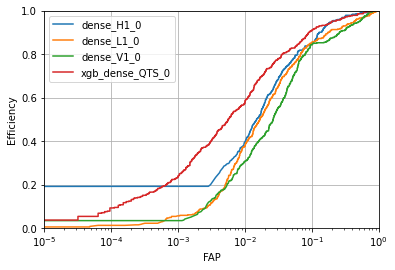

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8970
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

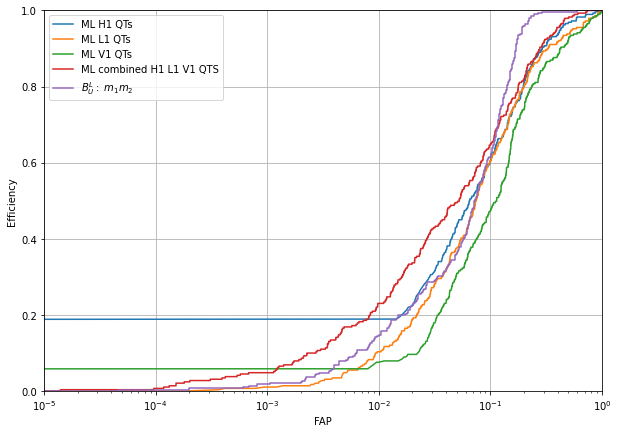

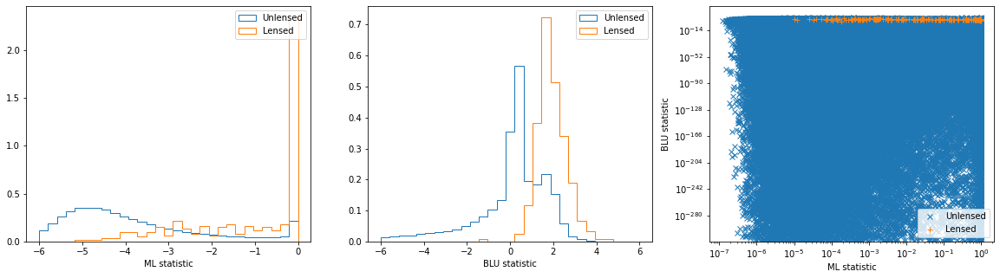

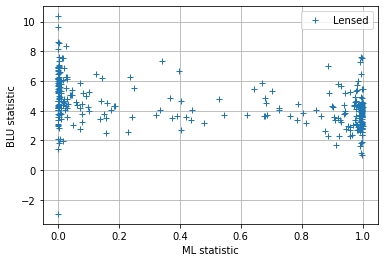

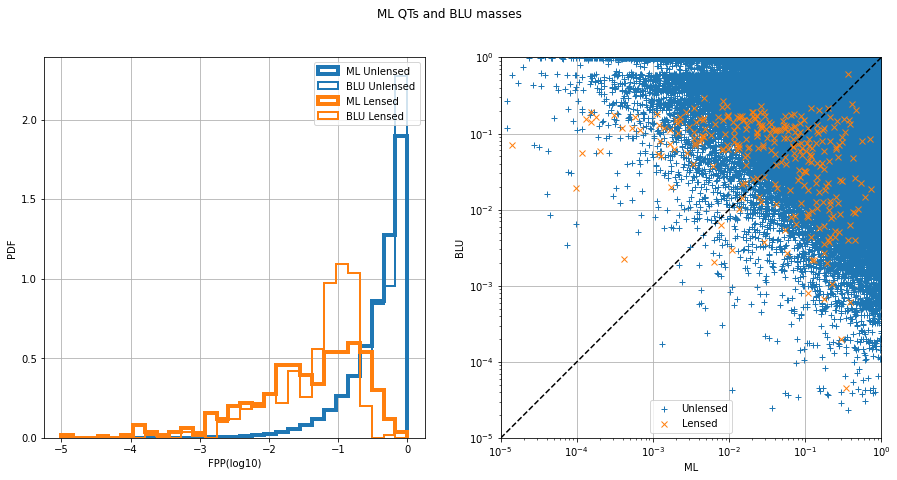

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8970384132460864, 'val_xgb_dense_QTS_0_roc': 0.9597683702272222, 'test_xgb_dense_QTS_0_acc': 0.9502991256327658, 'val_xgb_dense_QTS_0_acc': 0.9912272992385807, 'test_xgb_dense_QTS_0_f1': 0.011461318051575933, 'val_xgb_dense_QTS_0_f1': 0.2879377431906615}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9597


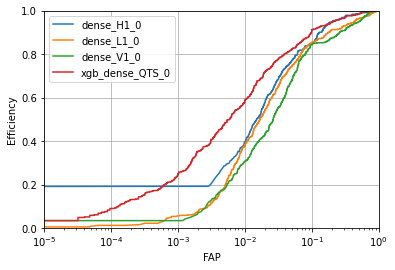

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8952
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

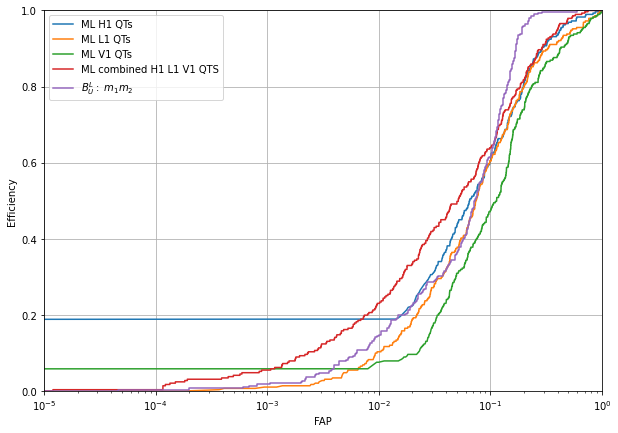

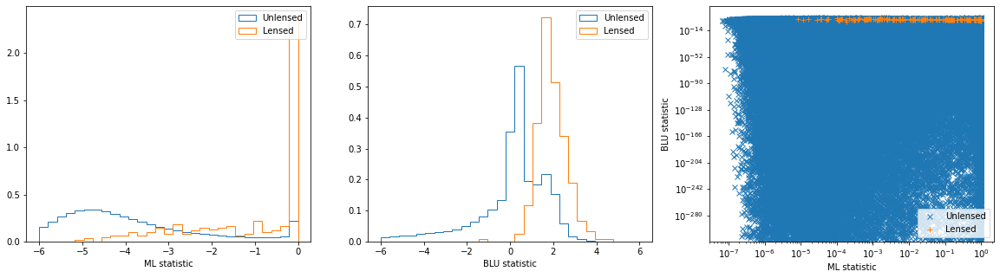

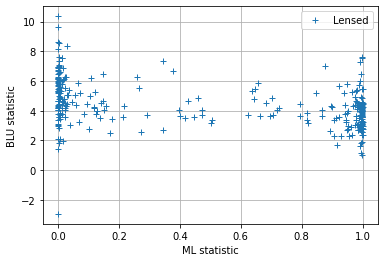

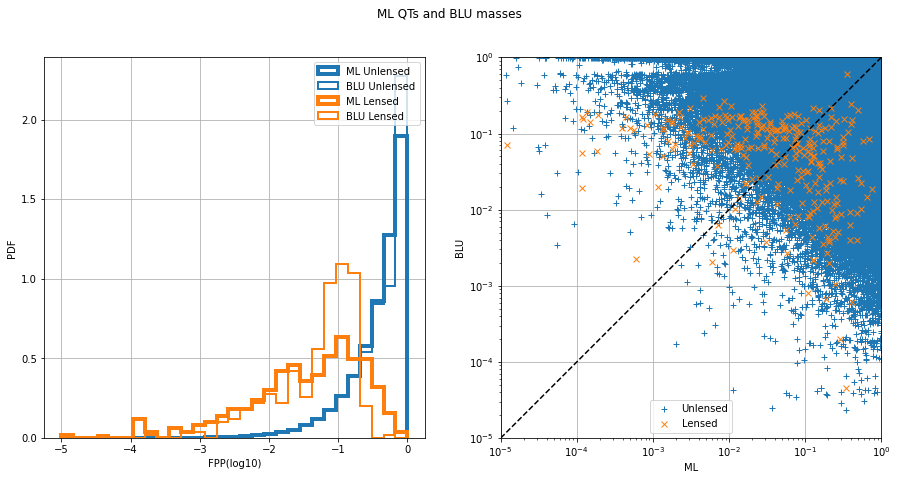

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8952361881725763, 'val_xgb_dense_QTS_0_roc': 0.9596681592949322, 'test_xgb_dense_QTS_0_acc': 0.9495368054582924, 'val_xgb_dense_QTS_0_acc': 0.9910994638905091, 'test_xgb_dense_QTS_0_f1': 0.011367645329465721, 'val_xgb_dense_QTS_0_f1': 0.28681177976952626}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9590


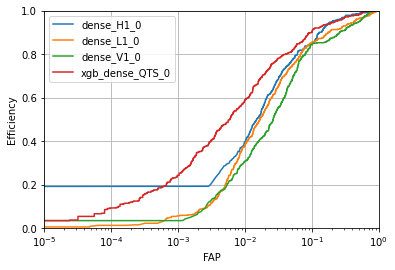

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8949
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

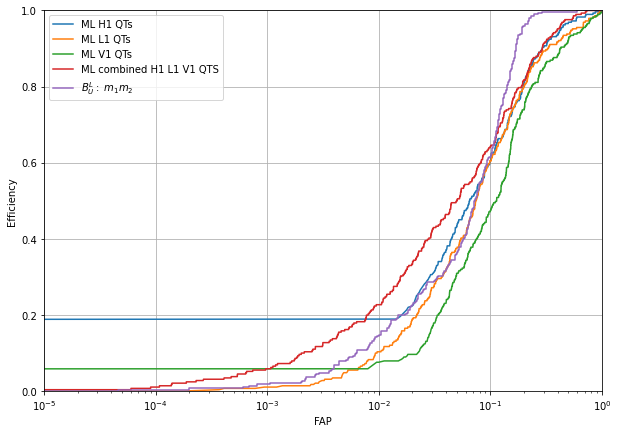

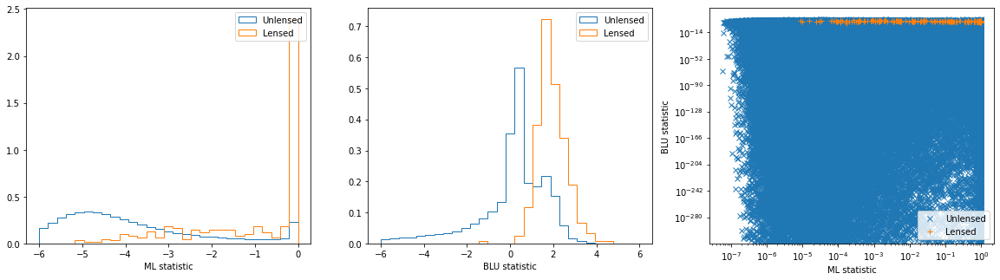

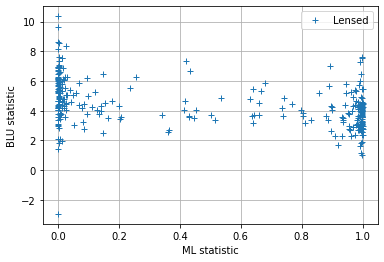

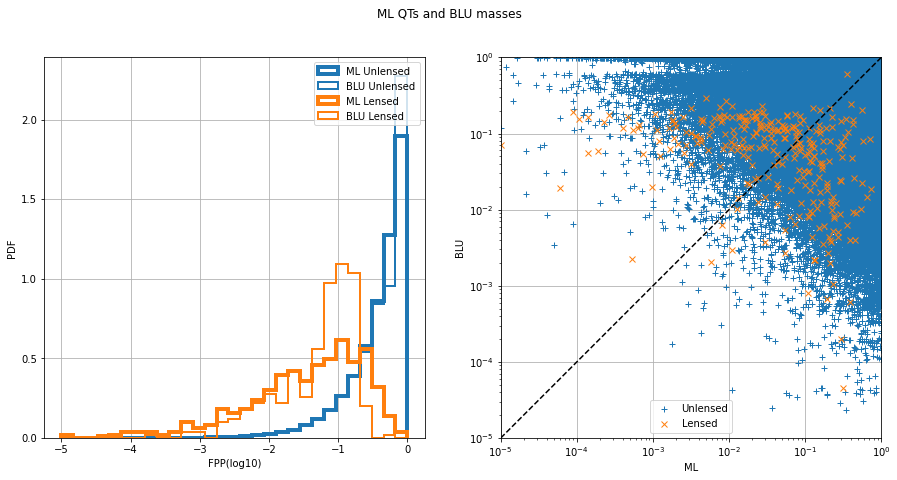

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8948704987276976, 'val_xgb_dense_QTS_0_roc': 0.9589574117254632, 'test_xgb_dense_QTS_0_acc': 0.9491346365473499, 'val_xgb_dense_QTS_0_acc': 0.9909955976702007, 'test_xgb_dense_QTS_0_f1': 0.011432571161922539, 'val_xgb_dense_QTS_0_f1': 0.28535193405199744}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9598


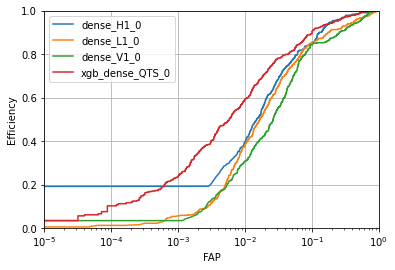

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8939
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

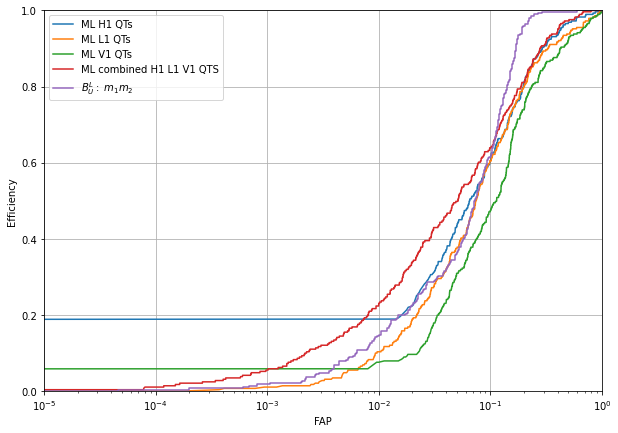

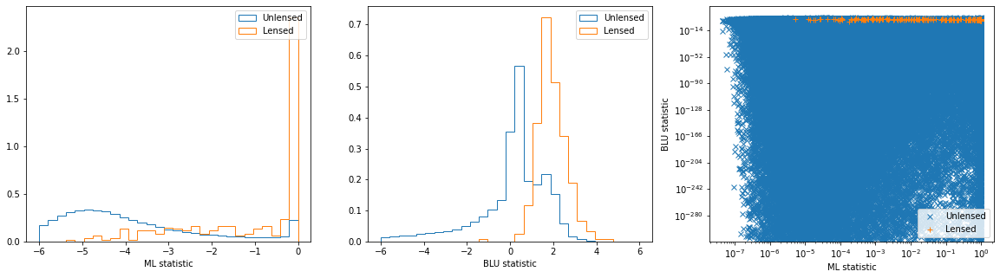

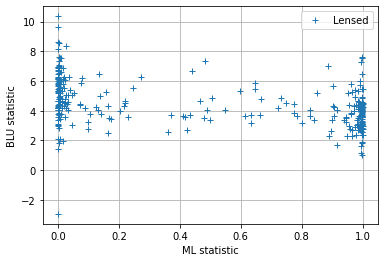

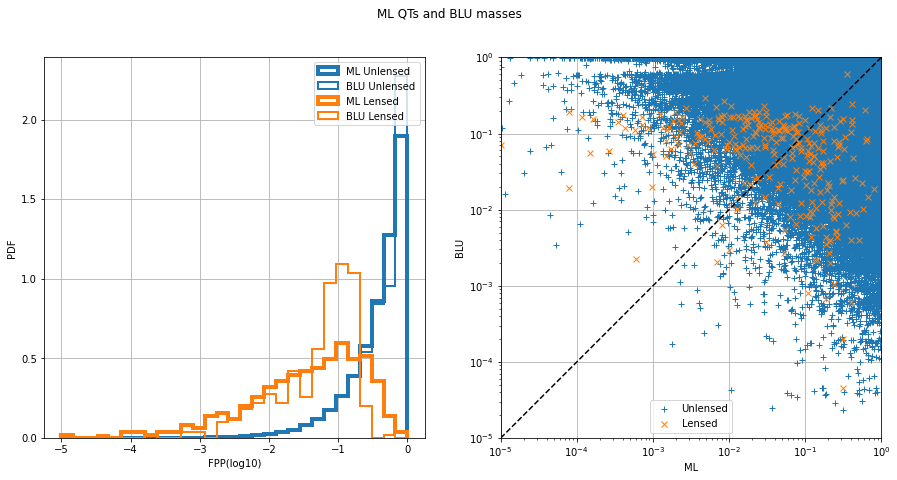

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8939357648735167, 'val_xgb_dense_QTS_0_roc': 0.9597941404203719, 'test_xgb_dense_QTS_0_acc': 0.9484683567098181, 'val_xgb_dense_QTS_0_acc': 0.9909236902869104, 'test_xgb_dense_QTS_0_f1': 0.011210504088762622, 'val_xgb_dense_QTS_0_f1': 0.2837326607818411}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9604


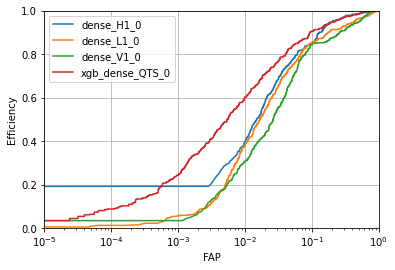

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8948
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

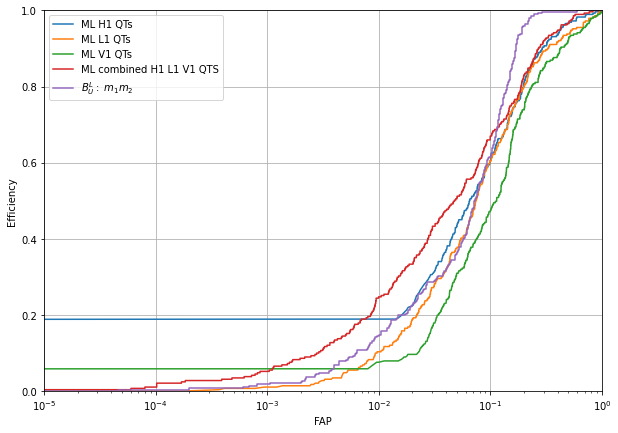

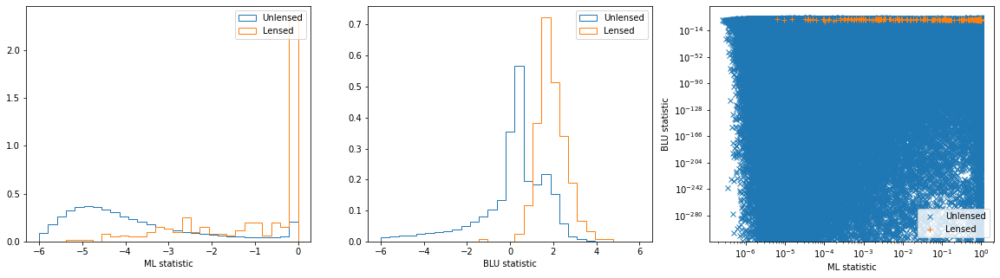

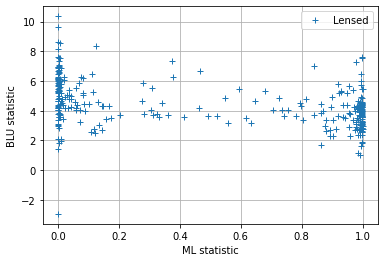

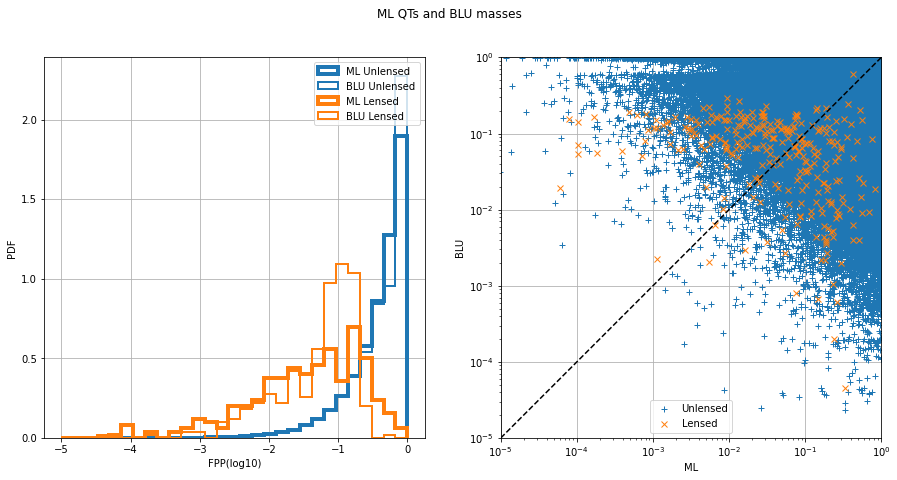

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8947783754923808, 'val_xgb_dense_QTS_0_roc': 0.9603553449890487, 'test_xgb_dense_QTS_0_acc': 0.9511874987494747, 'val_xgb_dense_QTS_0_acc': 0.9915628670272689, 'test_xgb_dense_QTS_0_f1': 0.011827608554763449, 'val_xgb_dense_QTS_0_f1': 0.29880478087649404}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9590


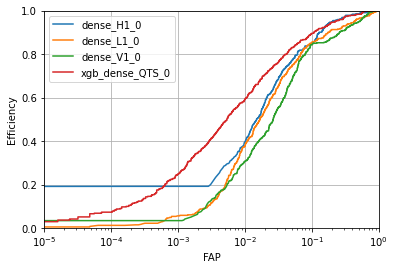

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8935
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

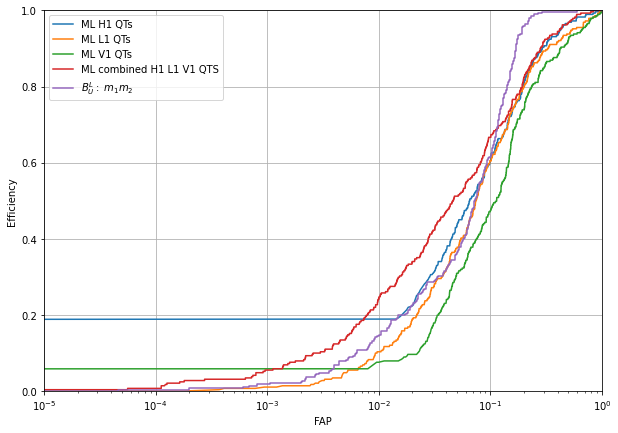

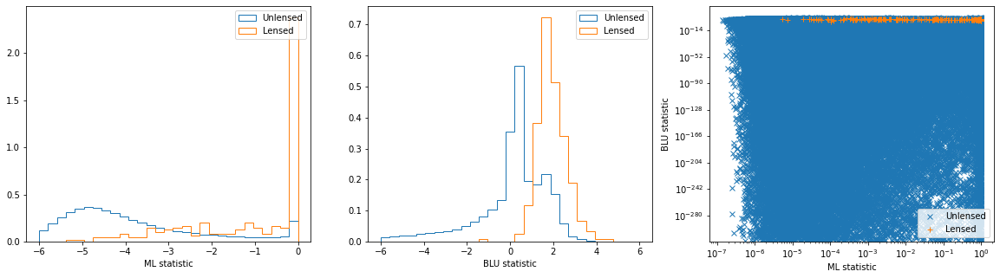

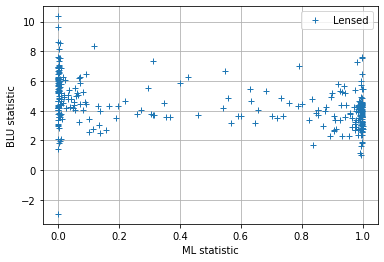

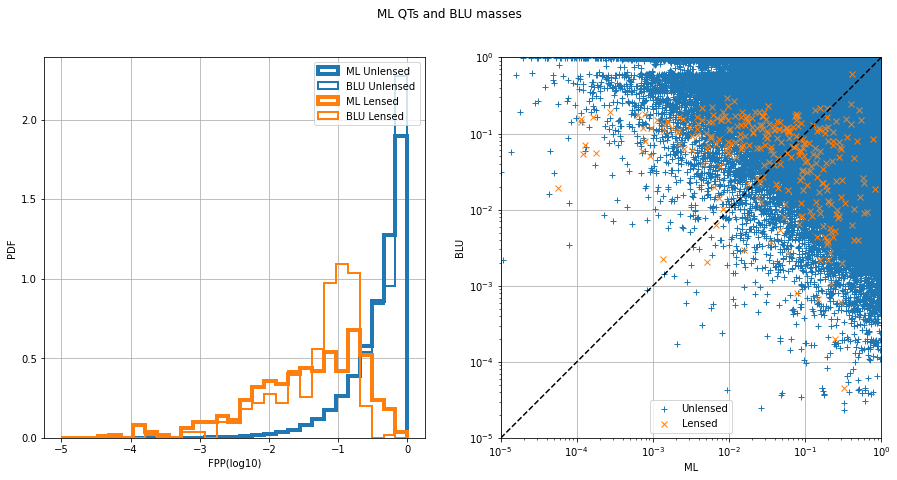

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8934879966220999, 'val_xgb_dense_QTS_0_roc': 0.9590007414499967, 'test_xgb_dense_QTS_0_acc': 0.9502851197502952, 'val_xgb_dense_QTS_0_acc': 0.9913870934236703, 'test_xgb_dense_QTS_0_f1': 0.011851262676476439, 'val_xgb_dense_QTS_0_f1': 0.29542483660130714}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9584


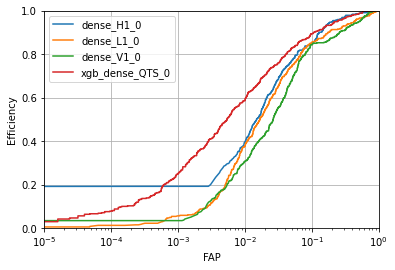

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8932
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

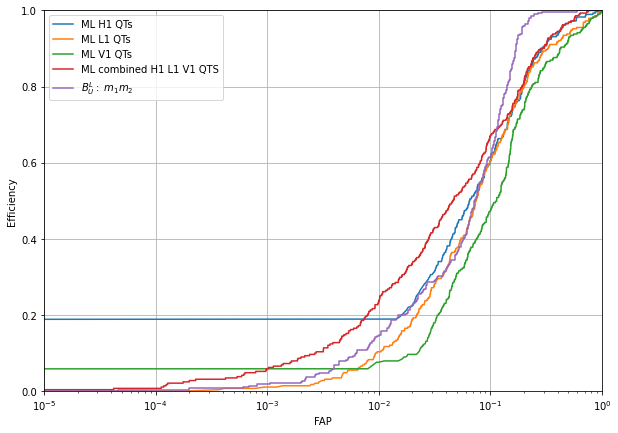

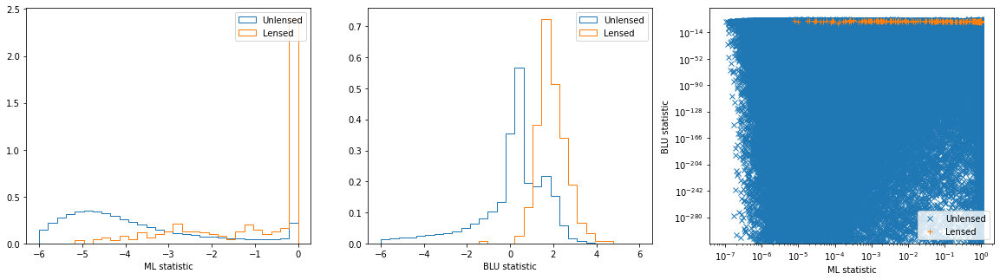

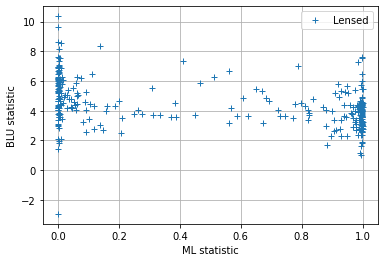

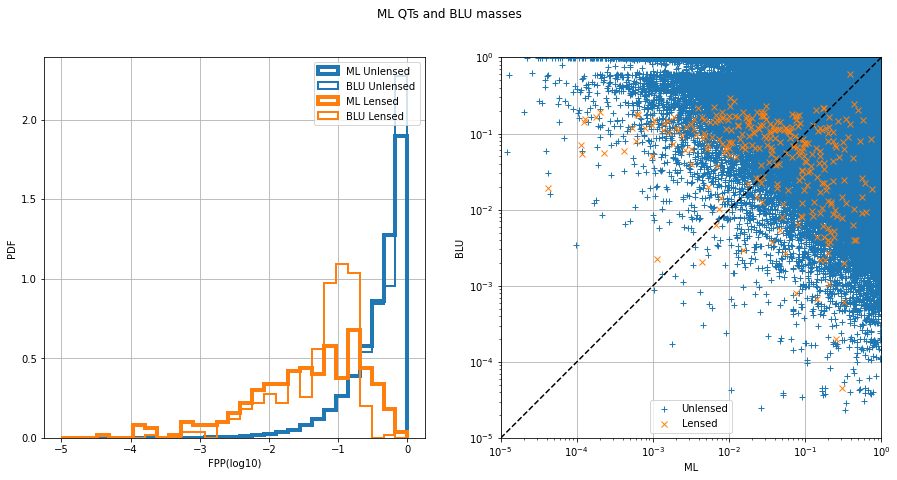

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8932026213289771, 'val_xgb_dense_QTS_0_roc': 0.958426860942598, 'test_xgb_dense_QTS_0_acc': 0.9496408491566458, 'val_xgb_dense_QTS_0_acc': 0.9913391551681434, 'test_xgb_dense_QTS_0_f1': 0.01177902548195846, 'val_xgb_dense_QTS_0_f1': 0.2961038961038961}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9578


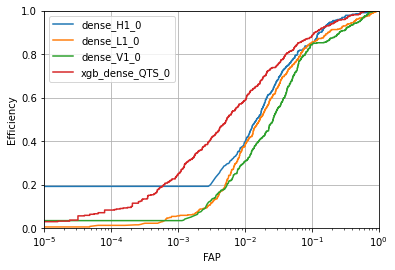

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8926
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

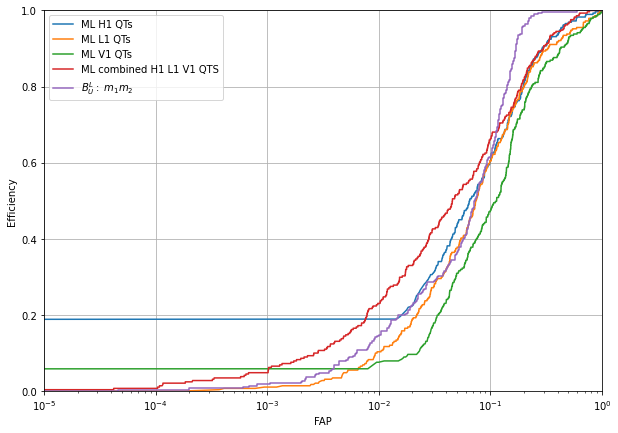

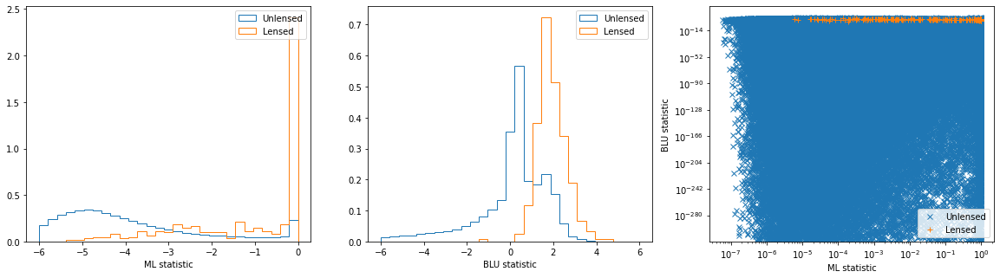

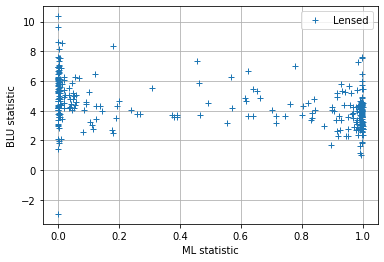

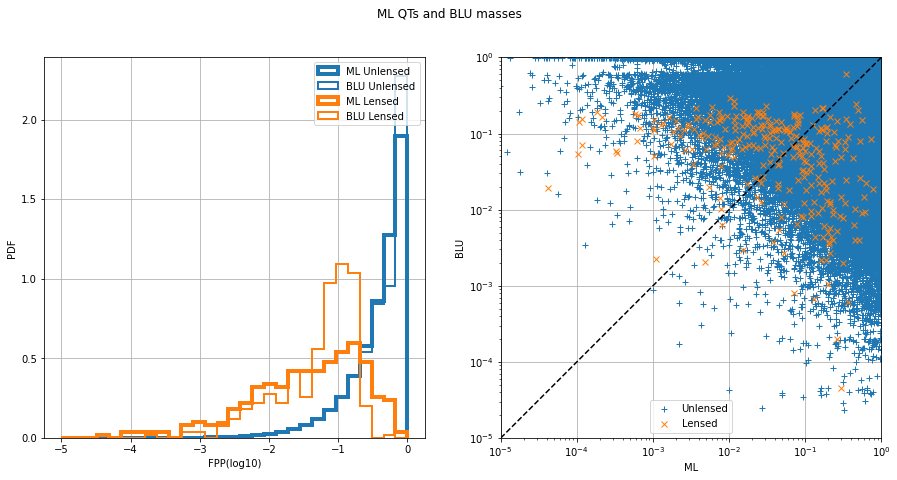

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8925727634072159, 'val_xgb_dense_QTS_0_roc': 0.9577754266489441, 'test_xgb_dense_QTS_0_acc': 0.9490606054542908, 'val_xgb_dense_QTS_0_acc': 0.9912352889478352, 'test_xgb_dense_QTS_0_f1': 0.011646414845296788, 'val_xgb_dense_QTS_0_f1': 0.2918011620400258}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9565


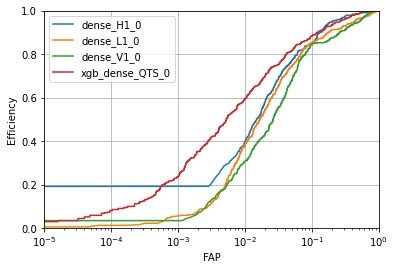

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8922
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

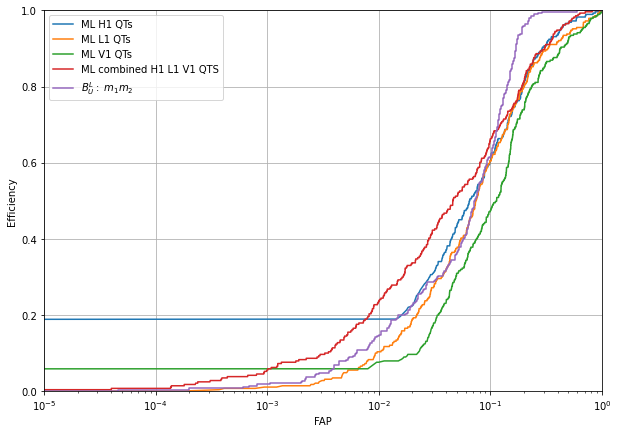

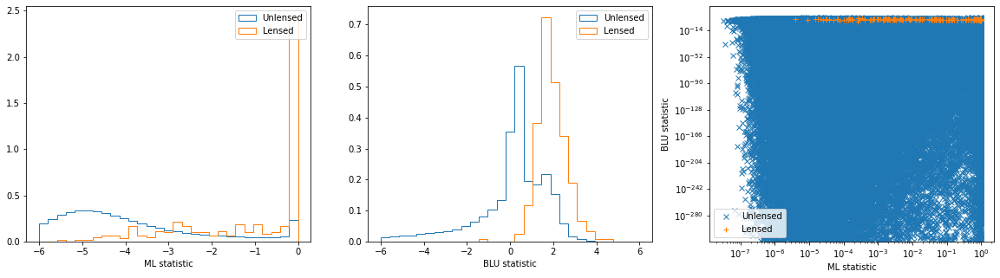

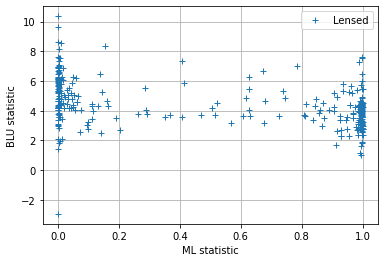

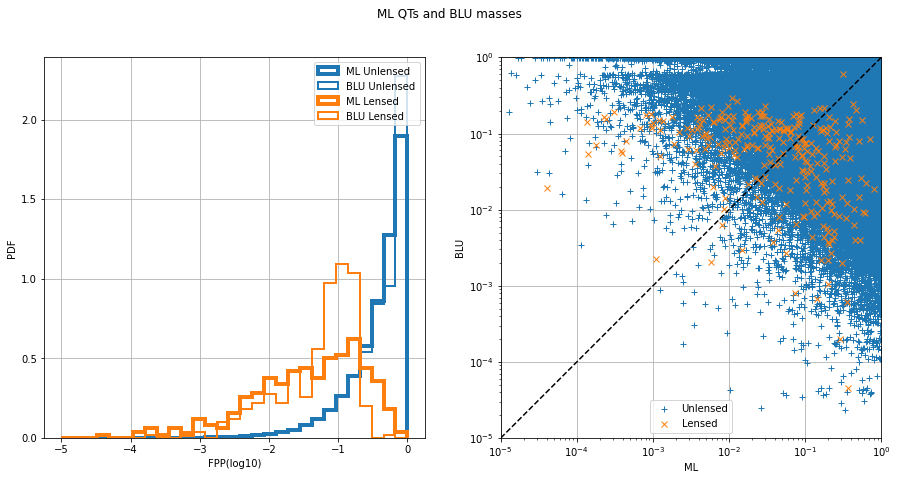

{'scale_pos_weight_xgbqts': 0.1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8921511450693527, 'val_xgb_dense_QTS_0_roc': 0.9564813621480088, 'test_xgb_dense_QTS_0_acc': 0.9481782348586406, 'val_xgb_dense_QTS_0_acc': 0.9910595153442366, 'test_xgb_dense_QTS_0_f1': 0.011601282246985192, 'val_xgb_dense_QTS_0_f1': 0.28680688336520077}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9609


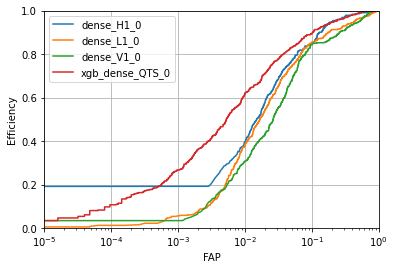

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8973
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

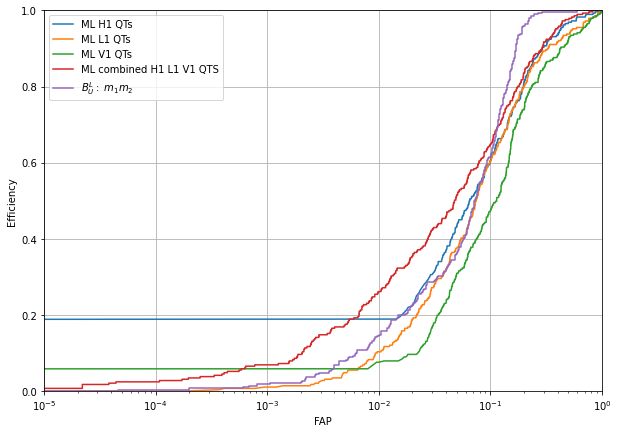

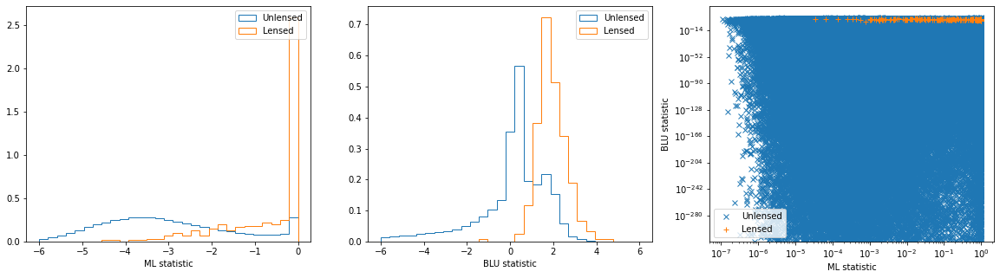

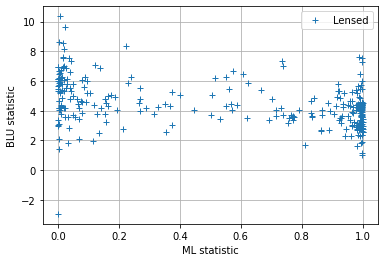

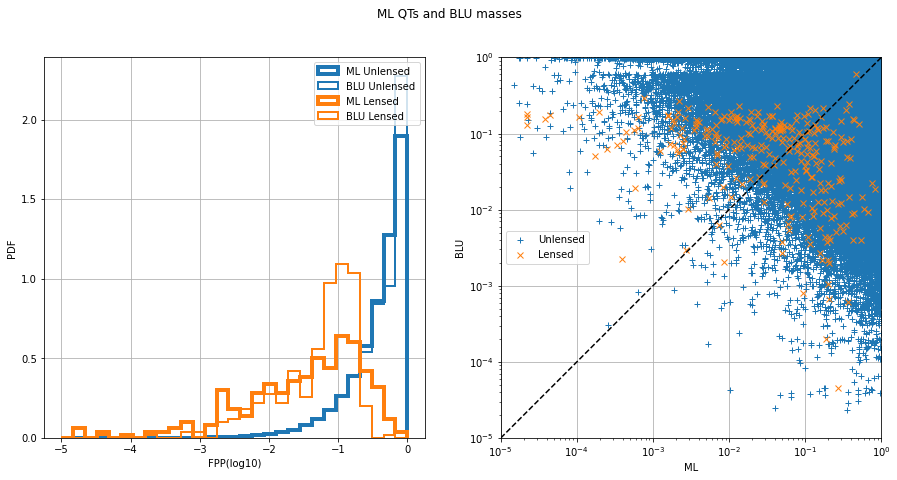

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8972869990988703, 'val_xgb_dense_QTS_0_roc': 0.9608756908143397, 'test_xgb_dense_QTS_0_acc': 0.9331379179255287, 'val_xgb_dense_QTS_0_acc': 0.9875280638537564, 'test_xgb_dense_QTS_0_f1': 0.010013331358317288, 'val_xgb_dense_QTS_0_f1': 0.24915824915824913}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9591


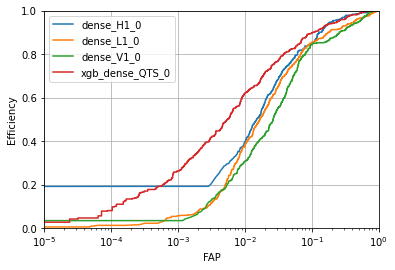

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8956
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

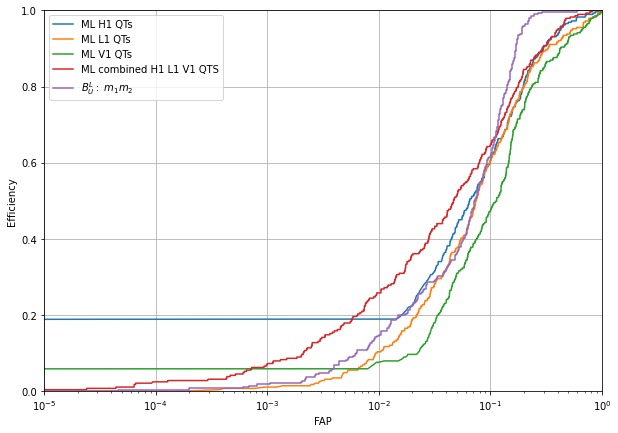

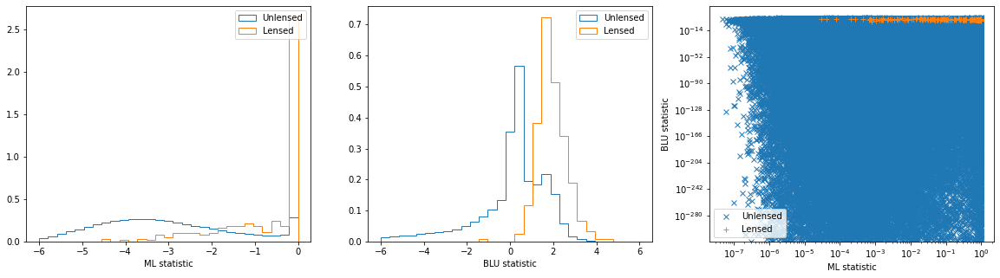

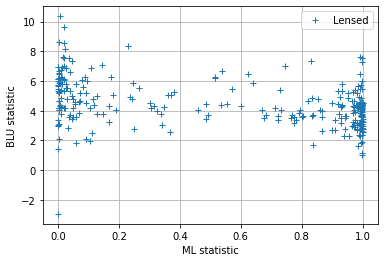

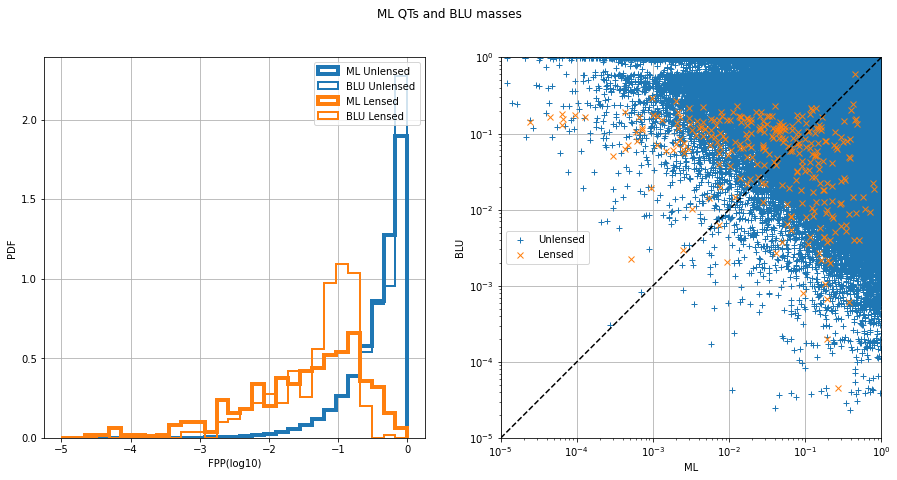

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8955860817212387, 'val_xgb_dense_QTS_0_roc': 0.959087955410581, 'test_xgb_dense_QTS_0_acc': 0.9326317053162329, 'val_xgb_dense_QTS_0_acc': 0.9873762593779213, 'test_xgb_dense_QTS_0_f1': 0.009764131521675197, 'val_xgb_dense_QTS_0_f1': 0.24904942965779467}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9582


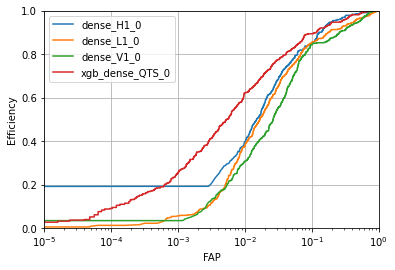

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8960
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

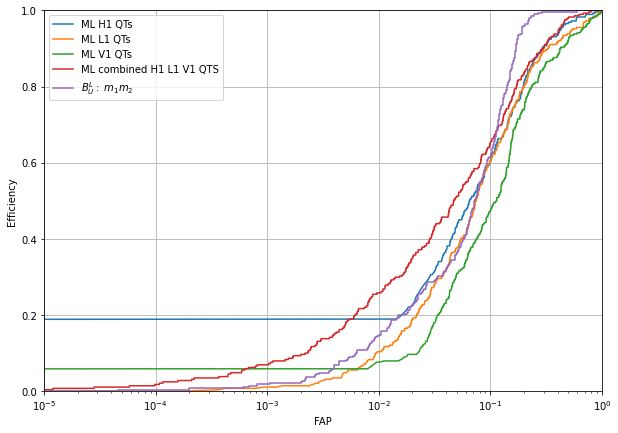

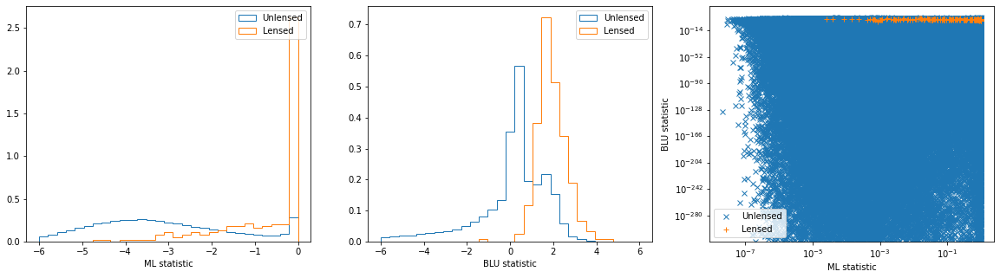

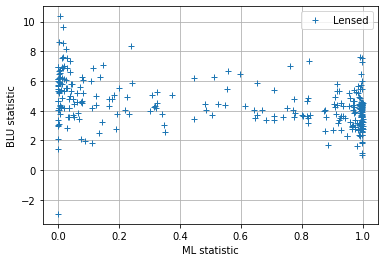

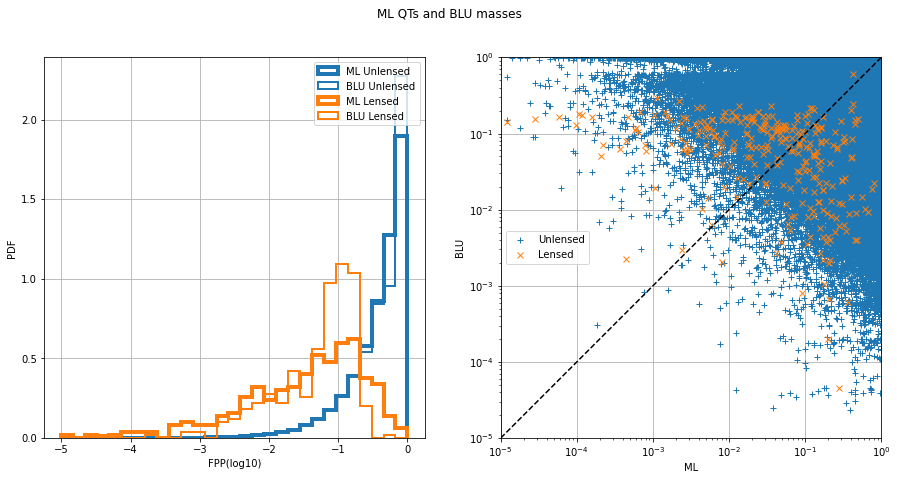

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8959587265890594, 'val_xgb_dense_QTS_0_roc': 0.9581790137508739, 'test_xgb_dense_QTS_0_acc': 0.9325396666599972, 'val_xgb_dense_QTS_0_acc': 0.9873922387964302, 'test_xgb_dense_QTS_0_f1': 0.009750939849624059, 'val_xgb_dense_QTS_0_f1': 0.24713740458015268}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9580


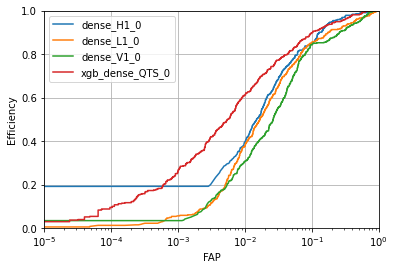

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8964
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

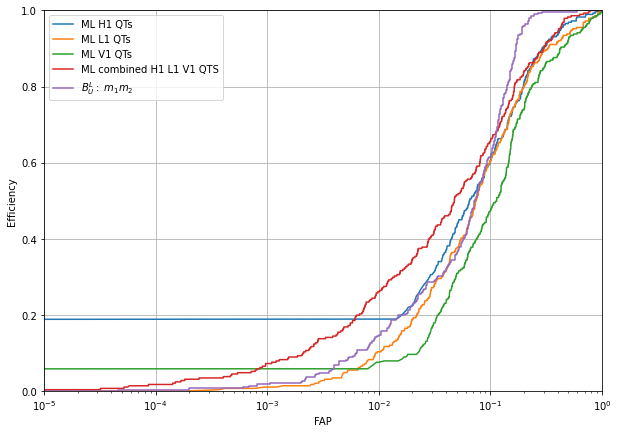

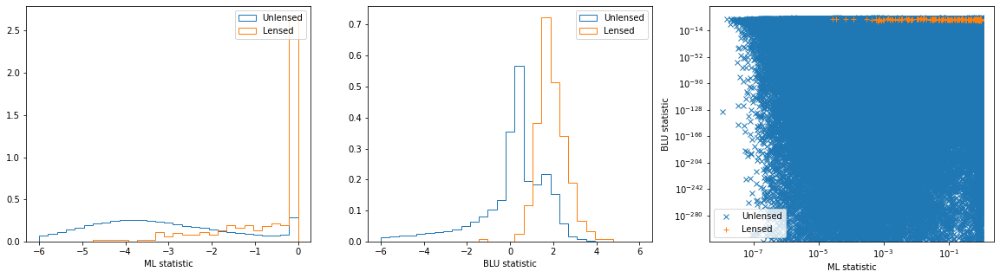

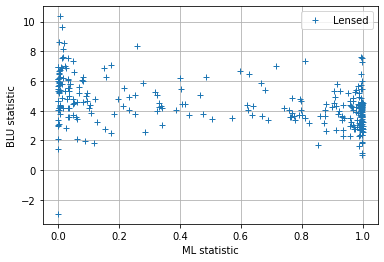

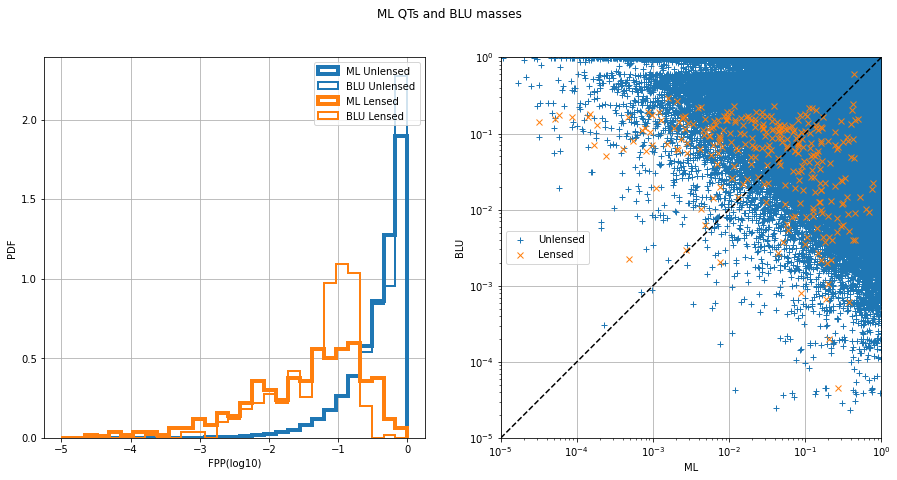

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8963538647855736, 'val_xgb_dense_QTS_0_roc': 0.957979126941267, 'test_xgb_dense_QTS_0_acc': 0.9328097801076453, 'val_xgb_dense_QTS_0_acc': 0.9873203314131399, 'test_xgb_dense_QTS_0_f1': 0.009614533872061817, 'val_xgb_dense_QTS_0_f1': 0.24536376604850216}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9577


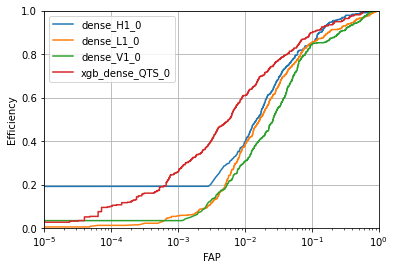

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8961
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

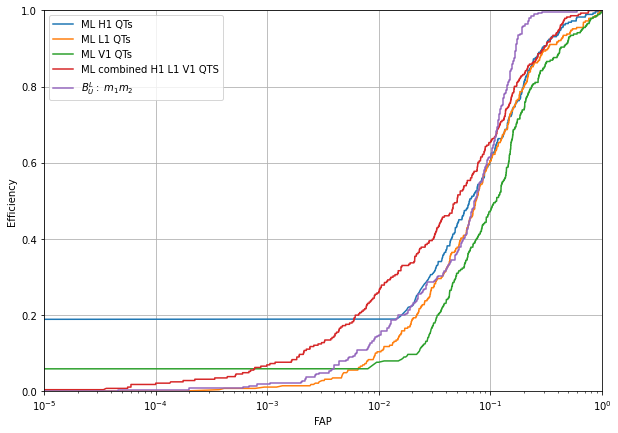

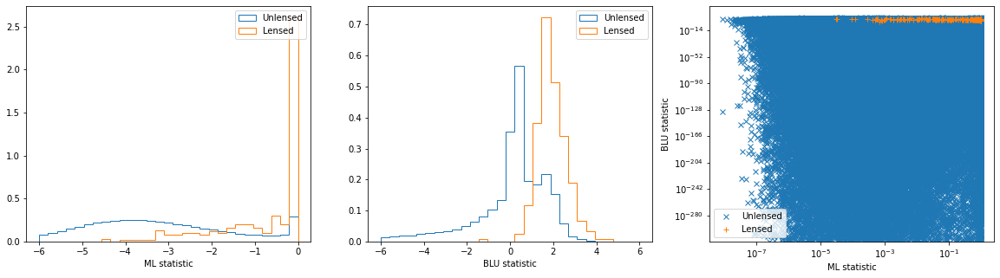

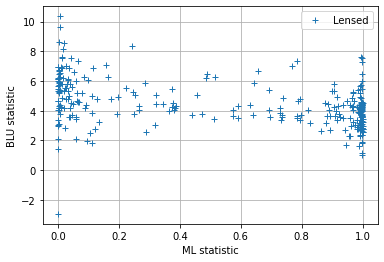

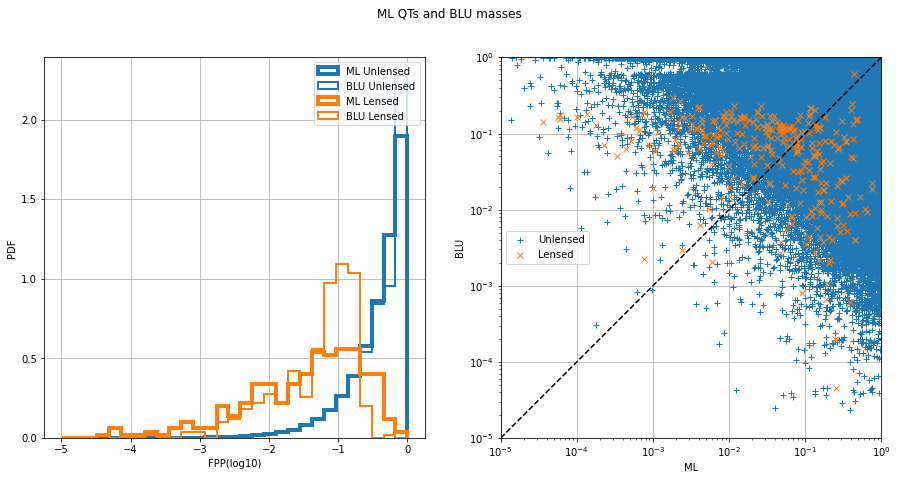

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8960825826515969, 'val_xgb_dense_QTS_0_roc': 0.957728711485673, 'test_xgb_dense_QTS_0_acc': 0.9325976910302327, 'val_xgb_dense_QTS_0_acc': 0.9873203314131399, 'test_xgb_dense_QTS_0_f1': 0.009584570605356776, 'val_xgb_dense_QTS_0_f1': 0.24751066856330012}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9603


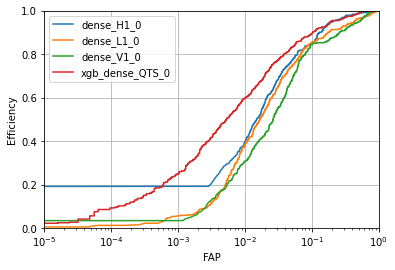

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8937
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

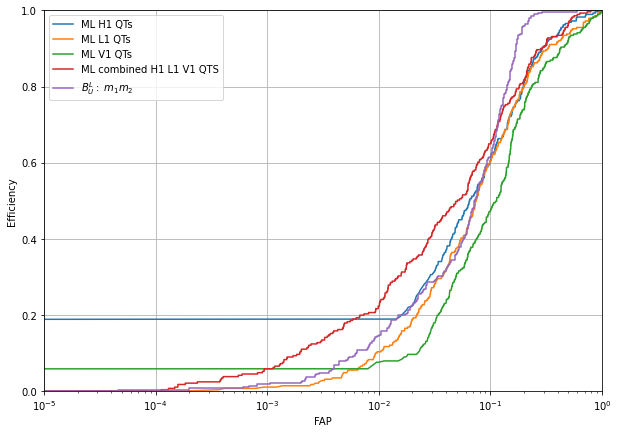

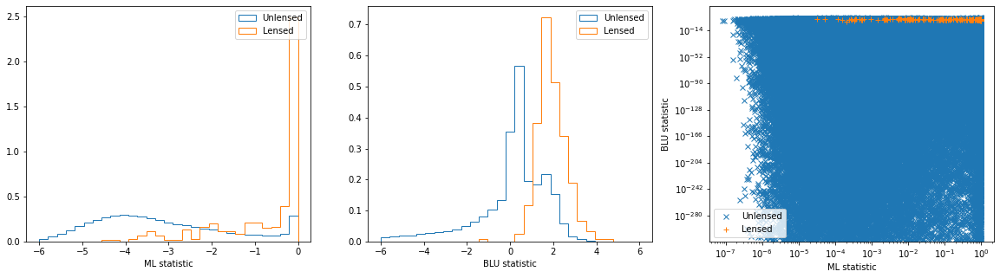

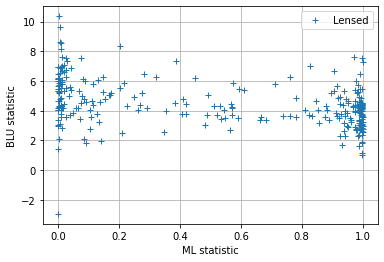

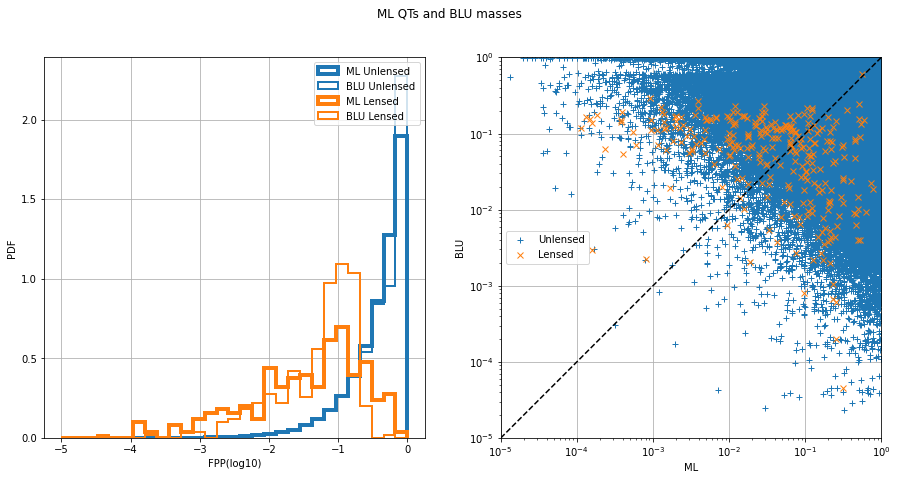

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8936526702161063, 'val_xgb_dense_QTS_0_roc': 0.9602984637812924, 'test_xgb_dense_QTS_0_acc': 0.9319354128734069, 'val_xgb_dense_QTS_0_acc': 0.9870087327522151, 'test_xgb_dense_QTS_0_f1': 0.009607546290904857, 'val_xgb_dense_QTS_0_f1': 0.23733583489681048}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9597


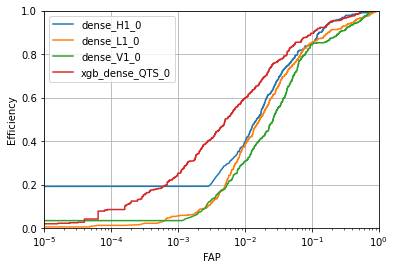

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8922
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

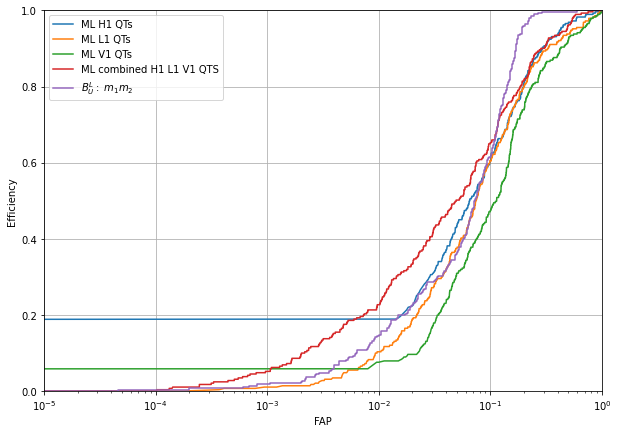

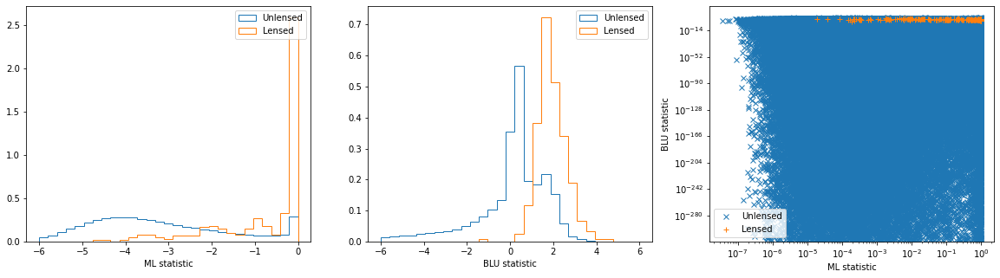

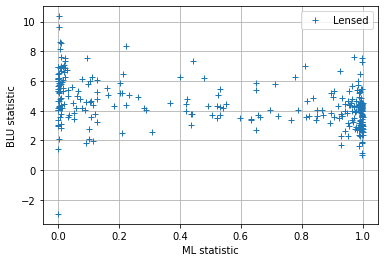

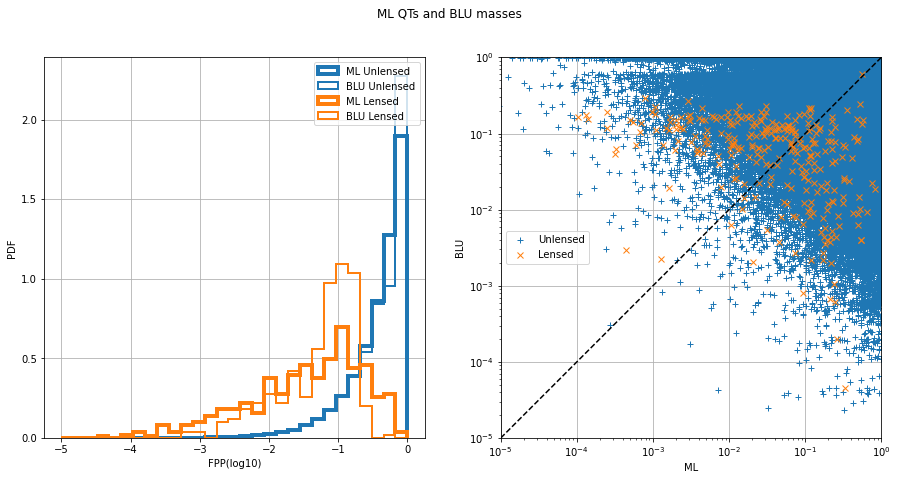

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.892223808943847, 'val_xgb_dense_QTS_0_roc': 0.9597201082686656, 'test_xgb_dense_QTS_0_acc': 0.9315072330378759, 'val_xgb_dense_QTS_0_acc': 0.9870486812984876, 'test_xgb_dense_QTS_0_f1': 0.009605369748871658, 'val_xgb_dense_QTS_0_f1': 0.2386096759041804}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9589


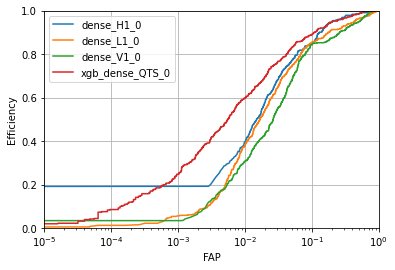

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8919
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

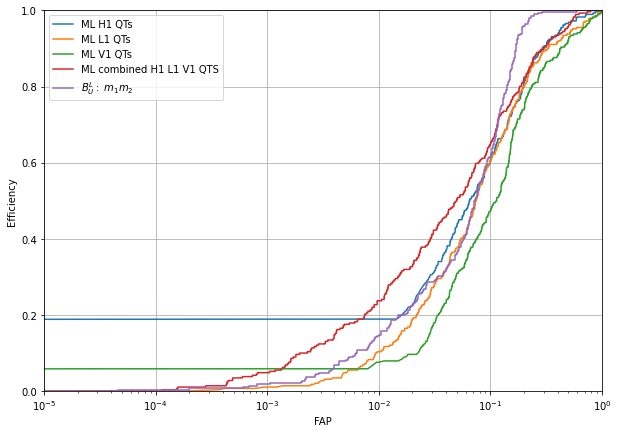

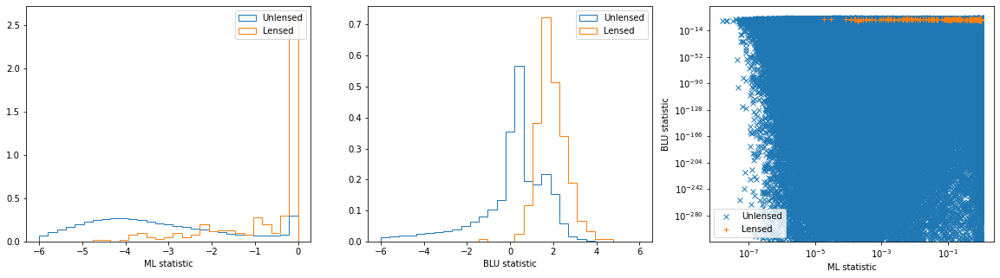

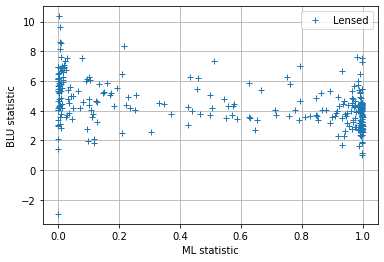

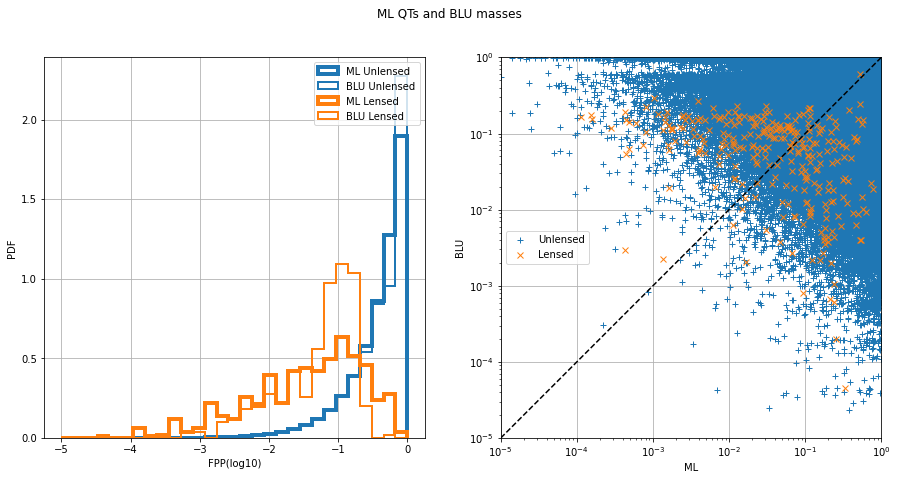

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8919135014521664, 'val_xgb_dense_QTS_0_roc': 0.9588733010837218, 'test_xgb_dense_QTS_0_acc': 0.9315912683326998, 'val_xgb_dense_QTS_0_acc': 0.9871445578095414, 'test_xgb_dense_QTS_0_f1': 0.009559675550405562, 'val_xgb_dense_QTS_0_f1': 0.2399622106754842}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9580


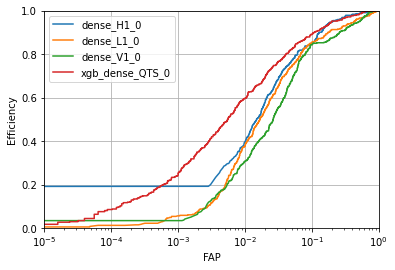

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8906
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

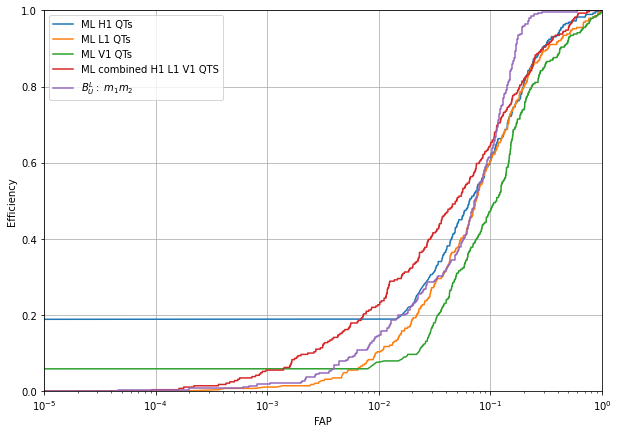

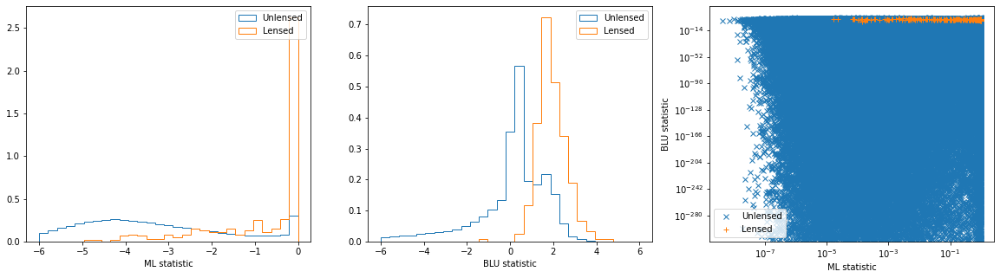

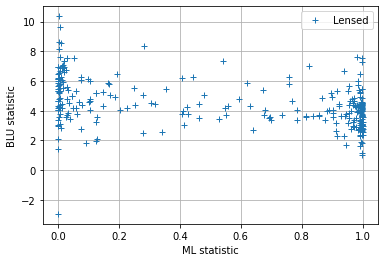

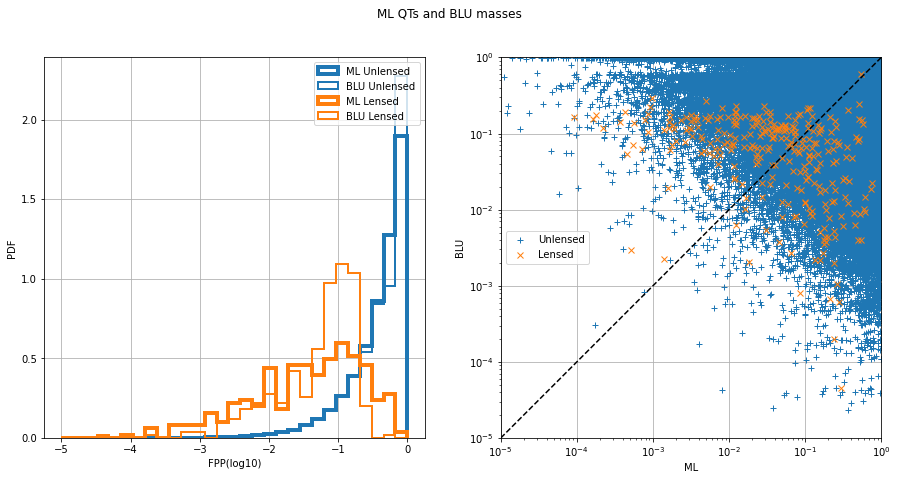

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8905765879817075, 'val_xgb_dense_QTS_0_roc': 0.958012991056916, 'test_xgb_dense_QTS_0_acc': 0.9316913103503471, 'val_xgb_dense_QTS_0_acc': 0.9871525475187958, 'test_xgb_dense_QTS_0_f1': 0.009516072879192294, 'val_xgb_dense_QTS_0_f1': 0.24293785310734464}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9575


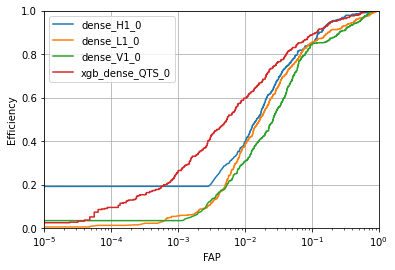

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8903
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

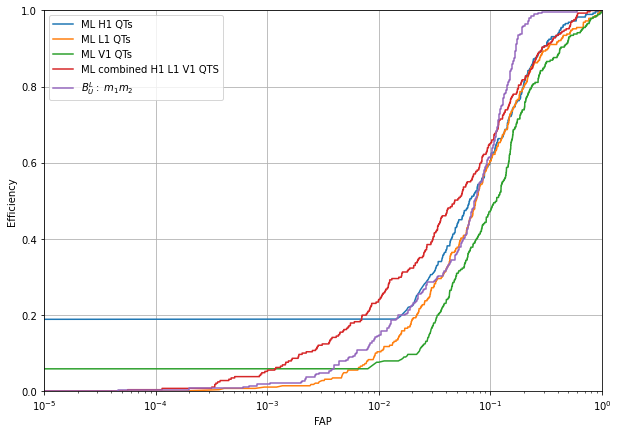

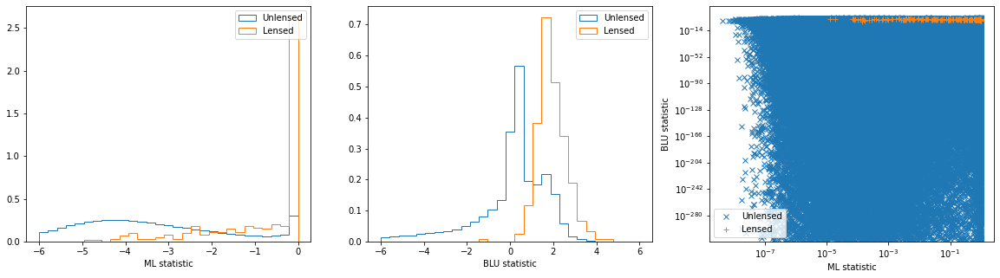

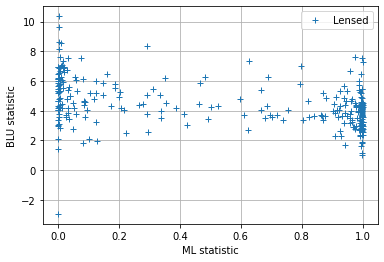

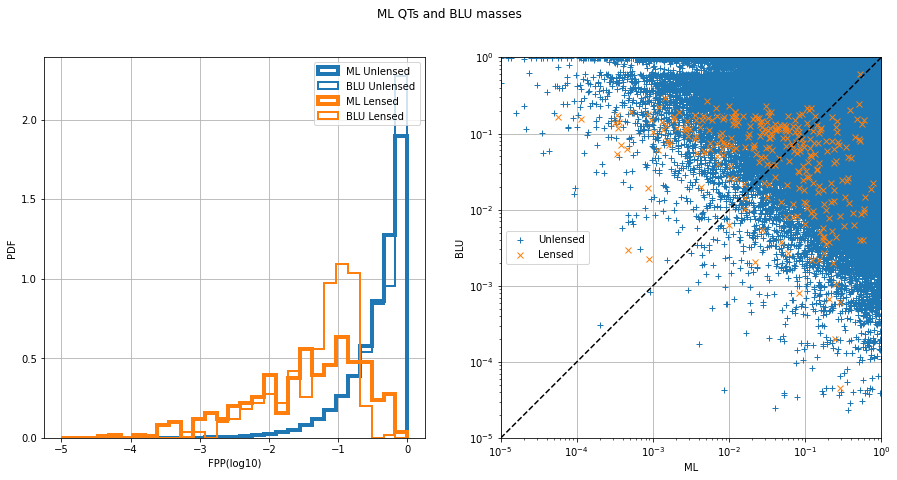

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.890338160073507, 'val_xgb_dense_QTS_0_roc': 0.9575281339687374, 'test_xgb_dense_QTS_0_acc': 0.931621280937994, 'val_xgb_dense_QTS_0_acc': 0.9870327018799786, 'test_xgb_dense_QTS_0_f1': 0.009391576567436737, 'val_xgb_dense_QTS_0_f1': 0.23909985935302389}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9616


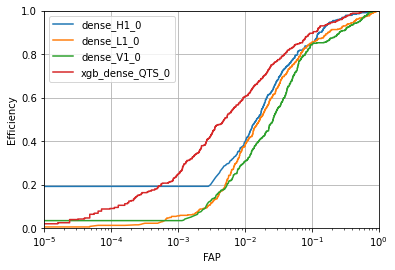

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8948
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

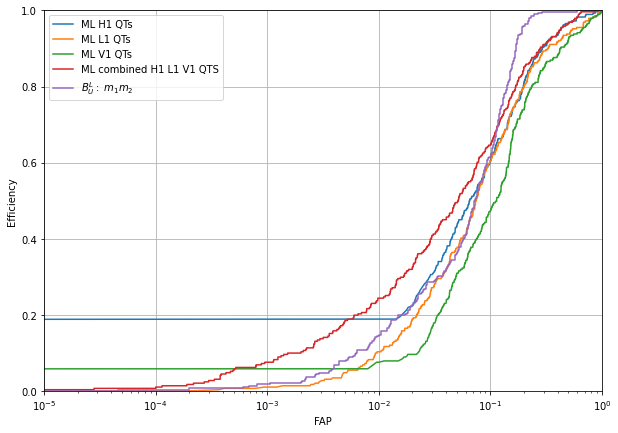

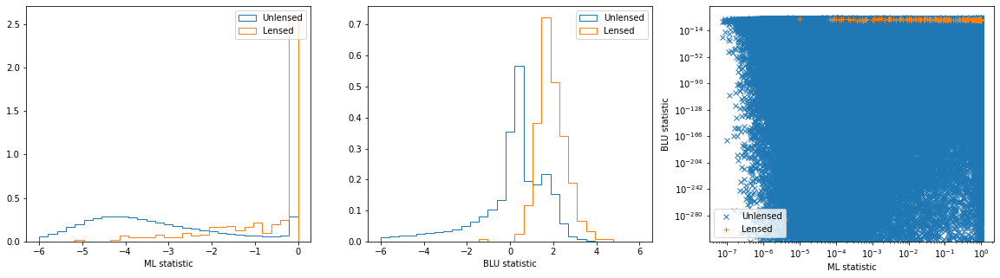

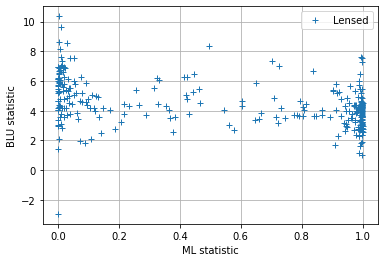

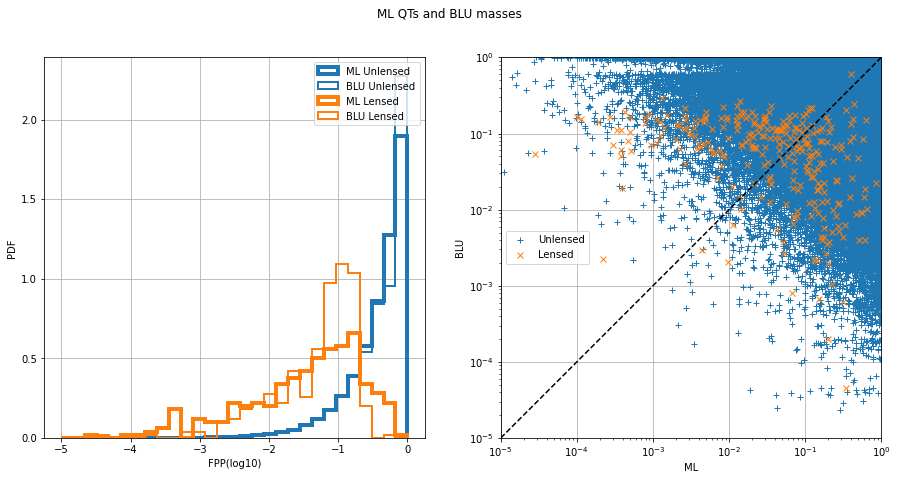

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8948289725824176, 'val_xgb_dense_QTS_0_roc': 0.961619777172757, 'test_xgb_dense_QTS_0_acc': 0.9336201204505893, 'val_xgb_dense_QTS_0_acc': 0.9875839918185377, 'test_xgb_dense_QTS_0_f1': 0.009553379508000956, 'val_xgb_dense_QTS_0_f1': 0.24489795918367344}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9603


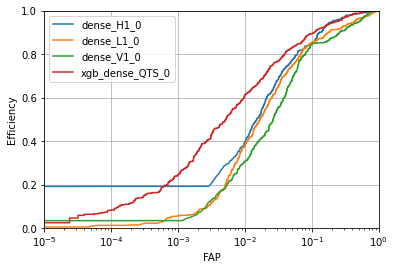

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8940
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

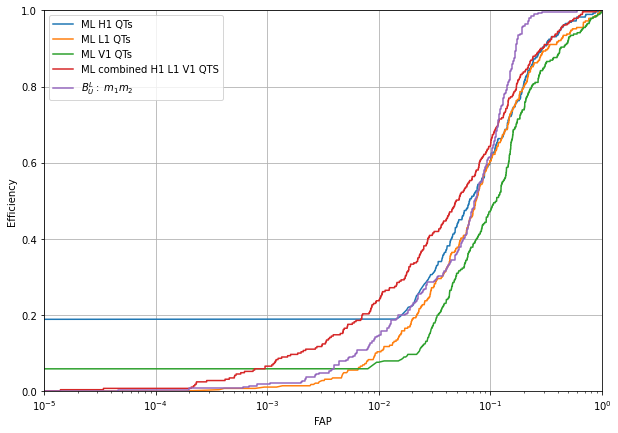

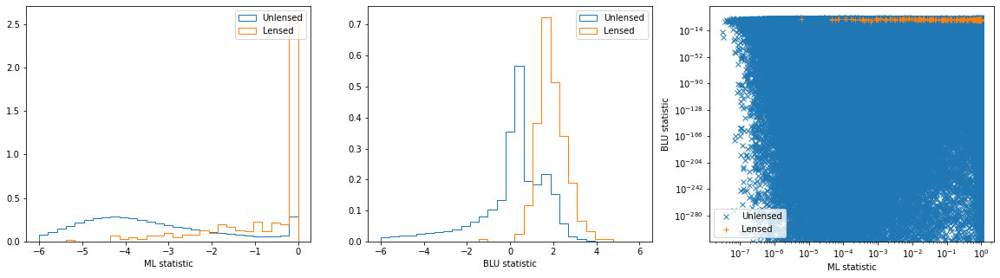

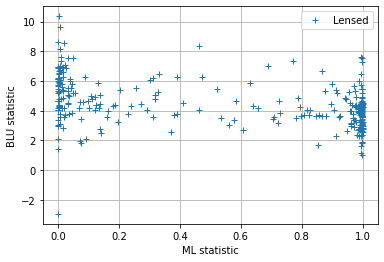

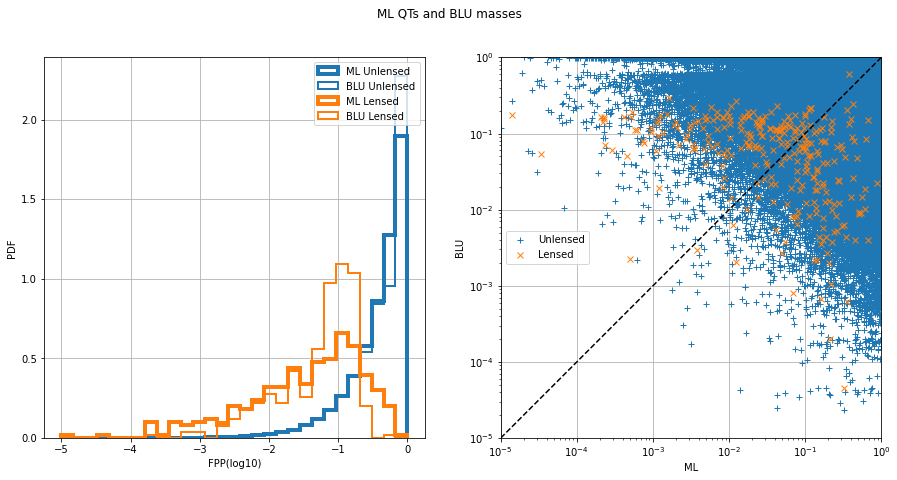

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8939583923572519, 'val_xgb_dense_QTS_0_roc': 0.96033815513201, 'test_xgb_dense_QTS_0_acc': 0.9334560515416475, 'val_xgb_dense_QTS_0_acc': 0.9875520329815198, 'test_xgb_dense_QTS_0_f1': 0.00958904109589041, 'val_xgb_dense_QTS_0_f1': 0.2480694980694981}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9601


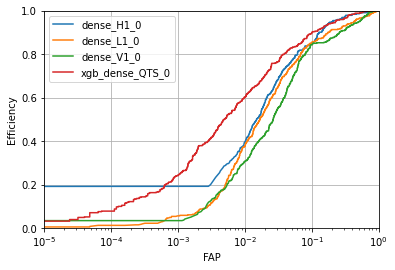

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8931
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

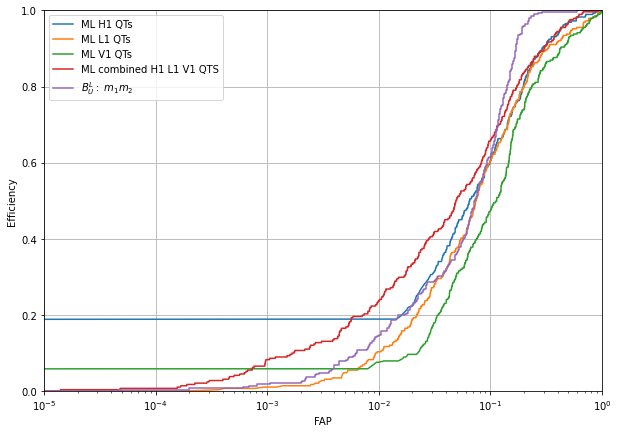

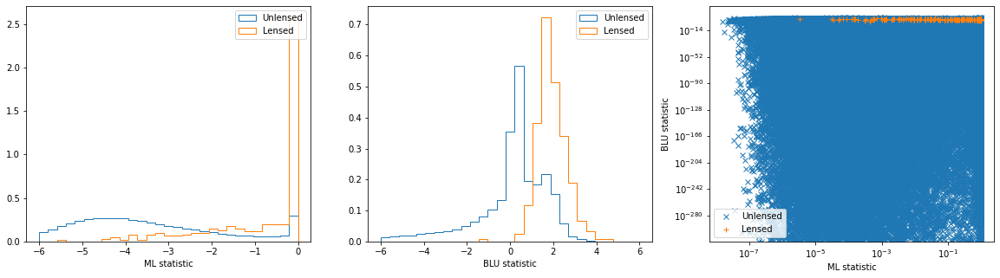

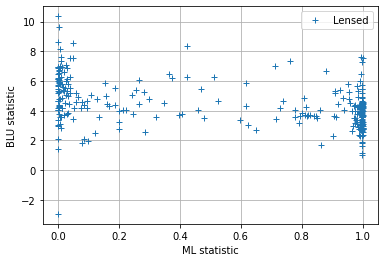

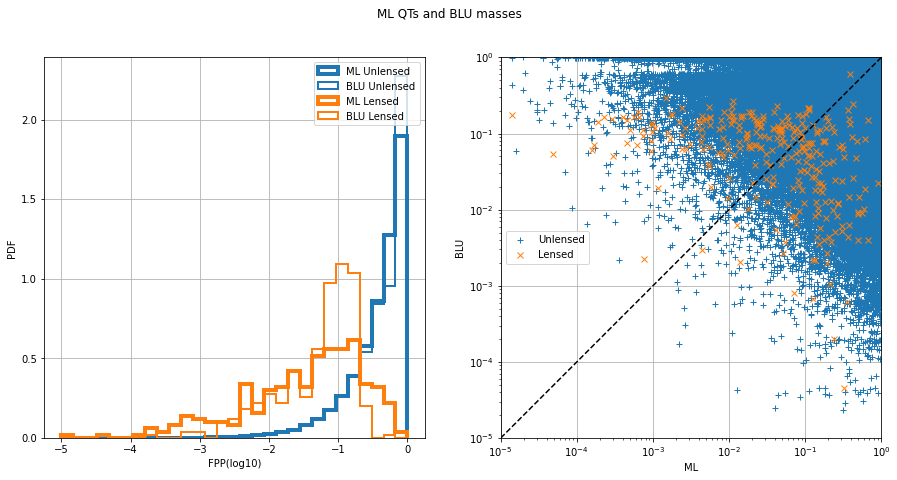

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8930982143076435, 'val_xgb_dense_QTS_0_roc': 0.9601018262146117, 'test_xgb_dense_QTS_0_acc': 0.9329798515376458, 'val_xgb_dense_QTS_0_acc': 0.9875680124000288, 'test_xgb_dense_QTS_0_f1': 0.009462976105985333, 'val_xgb_dense_QTS_0_f1': 0.2475822050290135}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9592


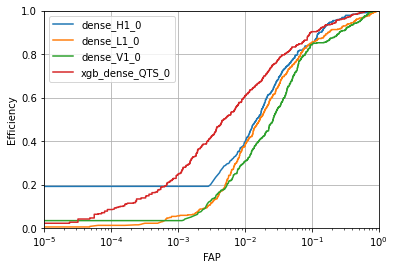

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8919
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

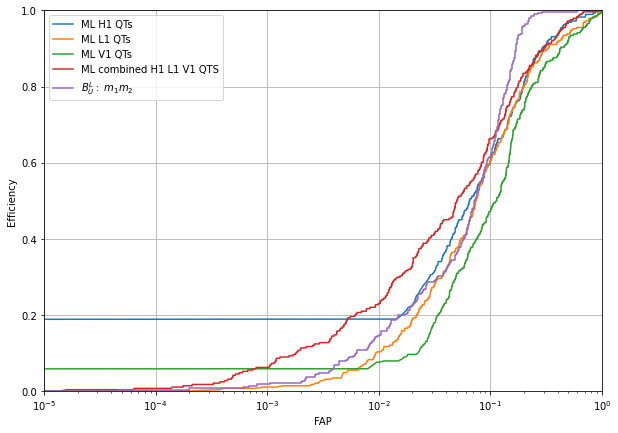

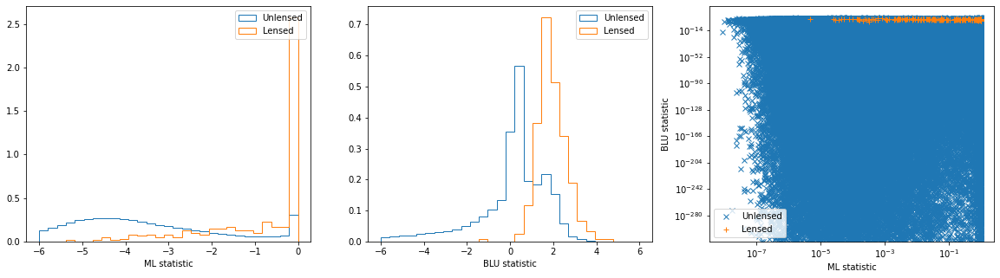

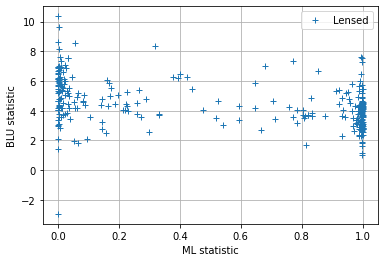

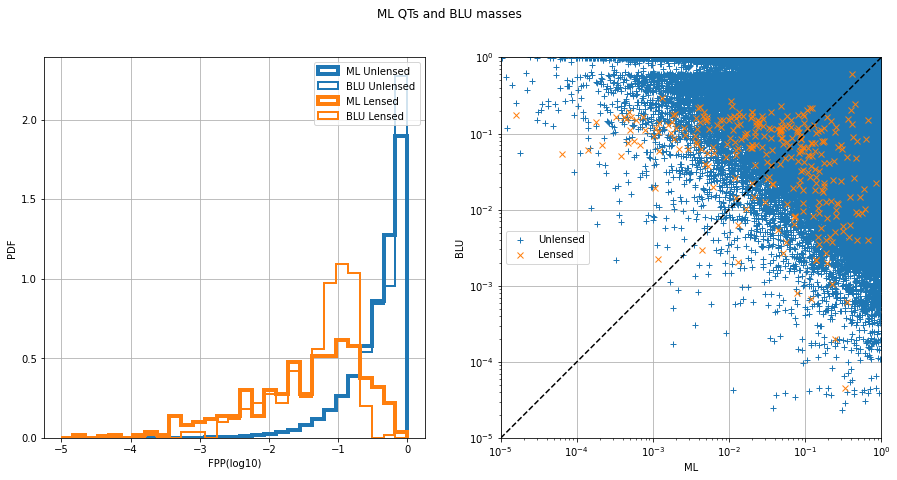

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8918933816357529, 'val_xgb_dense_QTS_0_roc': 0.9592215829579972, 'test_xgb_dense_QTS_0_acc': 0.9331779347325877, 'val_xgb_dense_QTS_0_acc': 0.9876399197833191, 'test_xgb_dense_QTS_0_f1': 0.009490761337011005, 'val_xgb_dense_QTS_0_f1': 0.24866440019426905}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9586


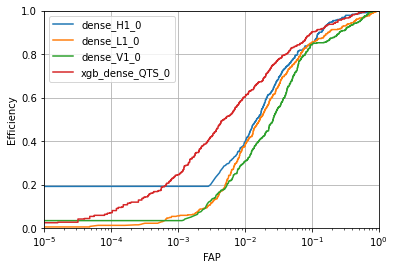

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8917
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

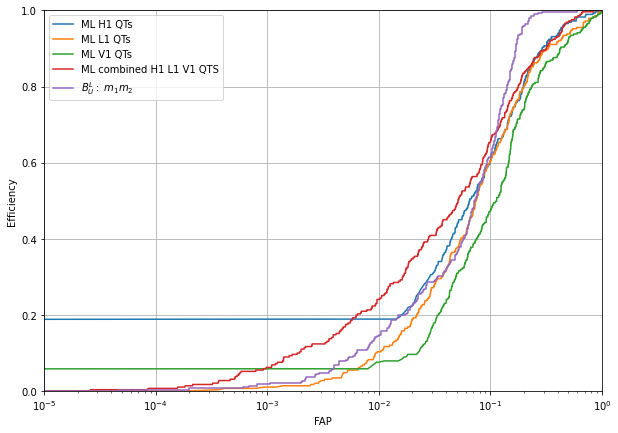

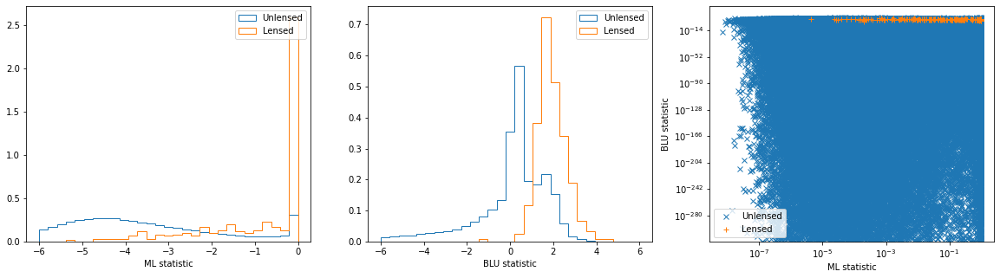

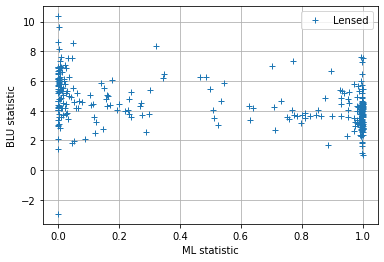

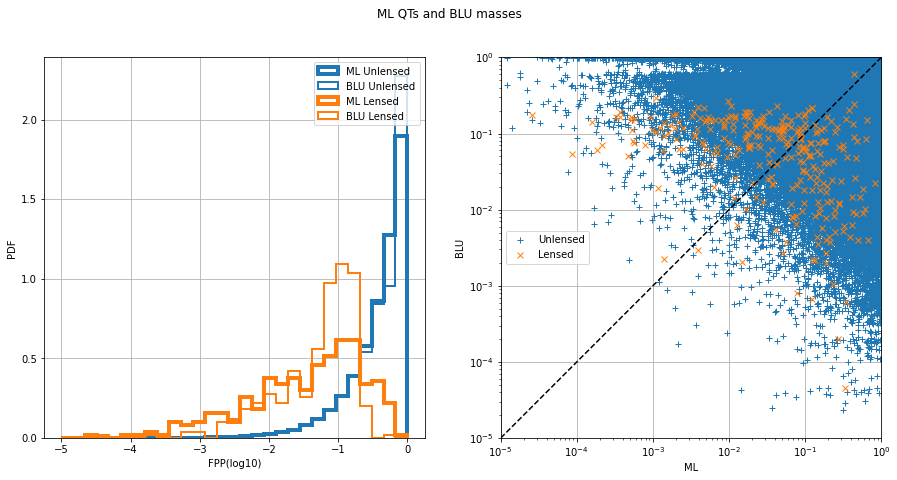

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8917165893696274, 'val_xgb_dense_QTS_0_roc': 0.9586249577501137, 'test_xgb_dense_QTS_0_acc': 0.9330358750675284, 'val_xgb_dense_QTS_0_acc': 0.9876319300740646, 'test_xgb_dense_QTS_0_f1': 0.009588068181818182, 'val_xgb_dense_QTS_0_f1': 0.24781341107871718}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9596


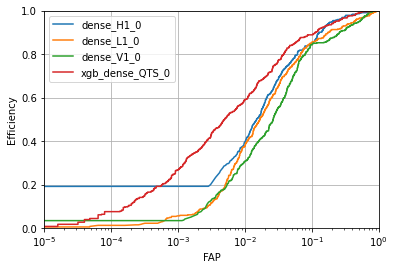

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8899
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

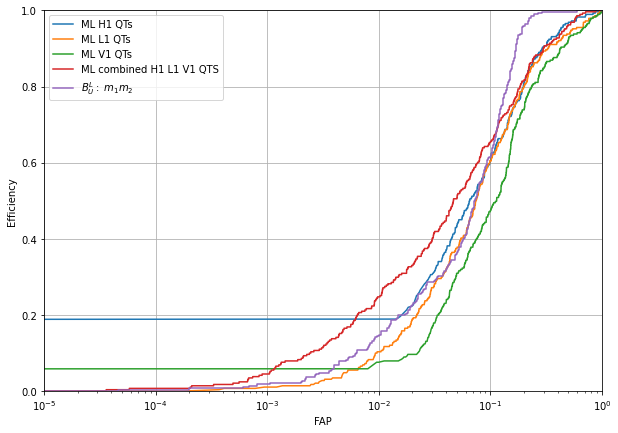

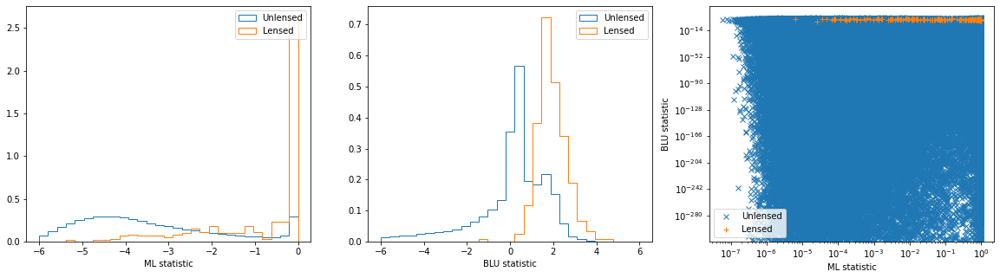

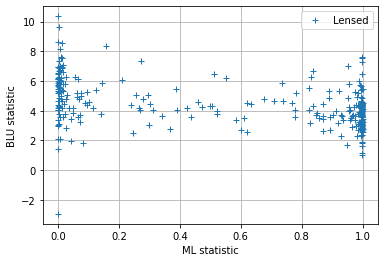

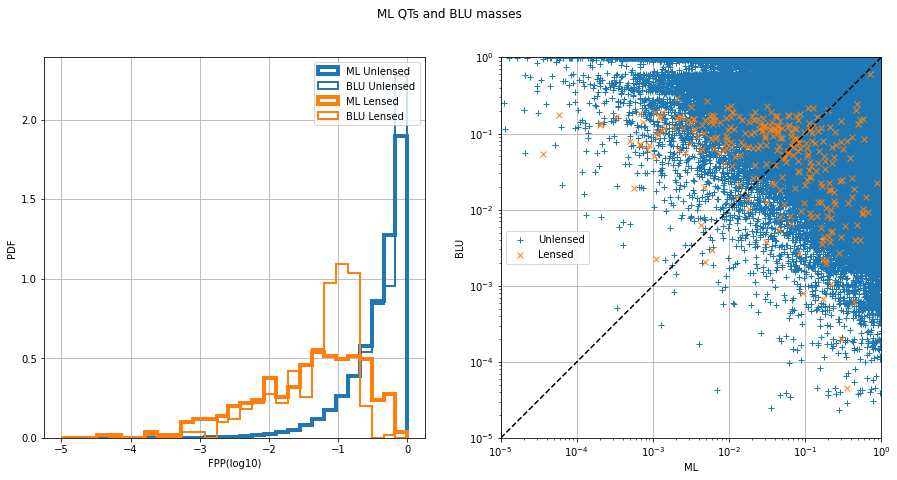

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8899450720412232, 'val_xgb_dense_QTS_0_roc': 0.9595562549794161, 'test_xgb_dense_QTS_0_acc': 0.9329898557394105, 'val_xgb_dense_QTS_0_acc': 0.987240434320595, 'test_xgb_dense_QTS_0_f1': 0.009815805812612719, 'val_xgb_dense_QTS_0_f1': 0.2391615054787994}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9591


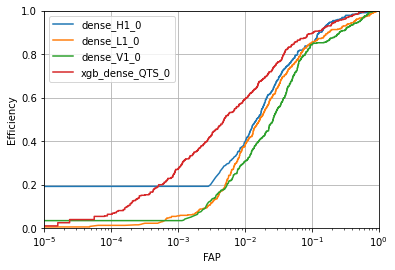

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8909
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

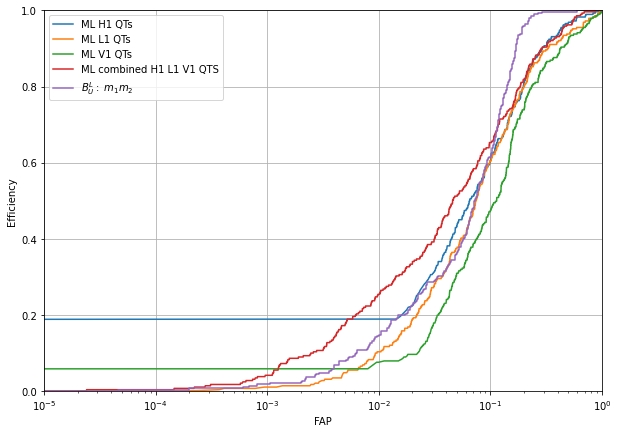

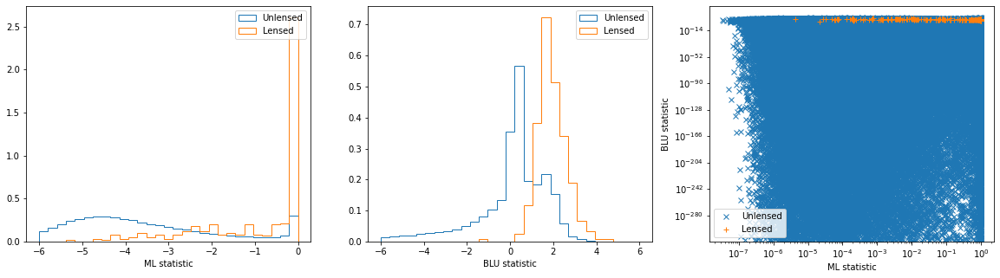

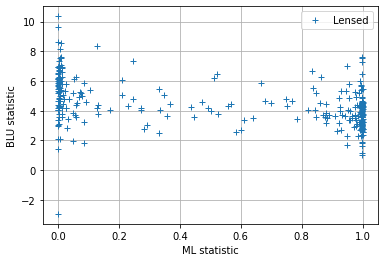

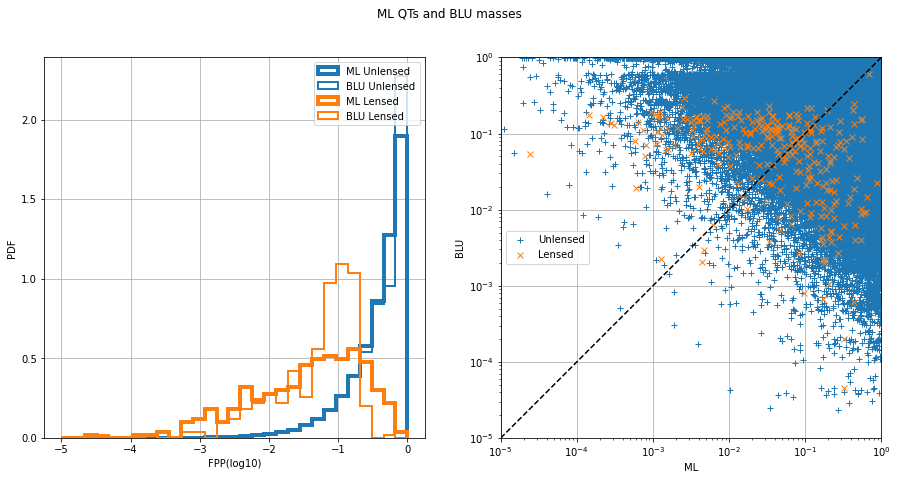

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8909134788109232, 'val_xgb_dense_QTS_0_roc': 0.9591250882257008, 'test_xgb_dense_QTS_0_acc': 0.9331979431361171, 'val_xgb_dense_QTS_0_acc': 0.9873602799594122, 'test_xgb_dense_QTS_0_f1': 0.009846080844627658, 'val_xgb_dense_QTS_0_f1': 0.24088291746641077}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9593


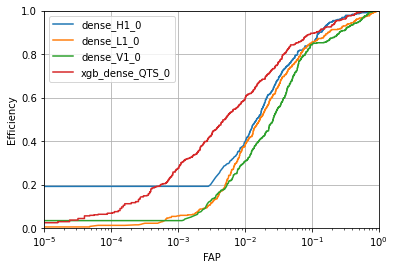

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8897
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

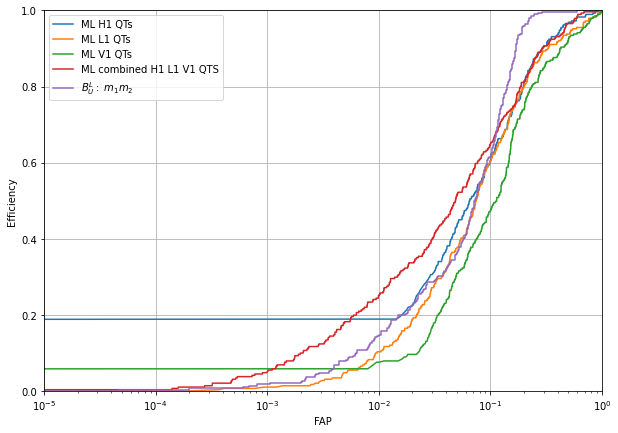

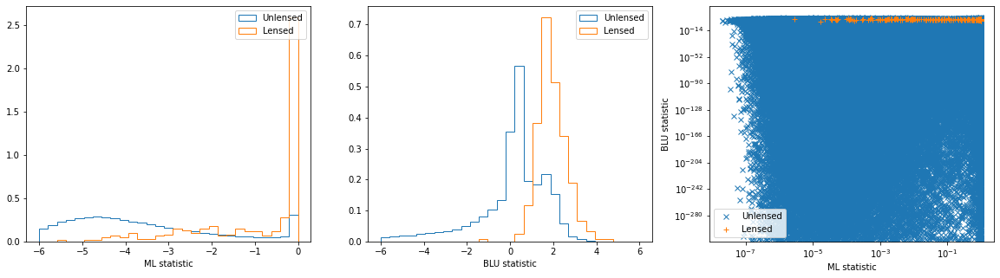

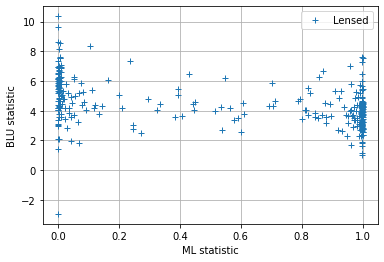

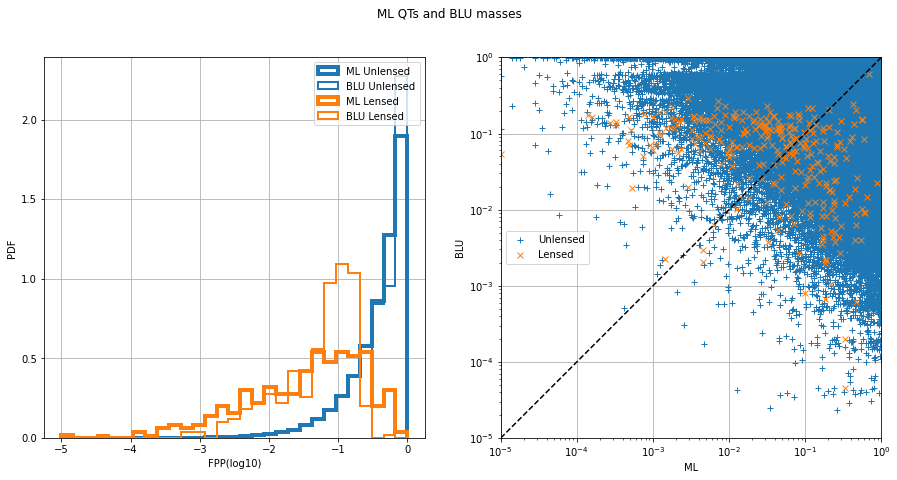

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8896577704192936, 'val_xgb_dense_QTS_0_roc': 0.9593237103599174, 'test_xgb_dense_QTS_0_acc': 0.9329878548990576, 'val_xgb_dense_QTS_0_acc': 0.9872963622853764, 'test_xgb_dense_QTS_0_f1': 0.009815515610217597, 'val_xgb_dense_QTS_0_f1': 0.2421353670162059}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9592


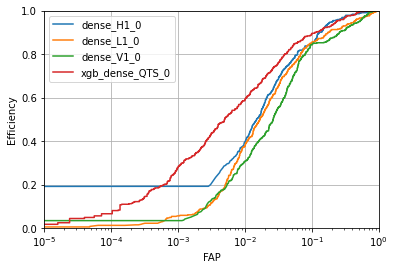

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

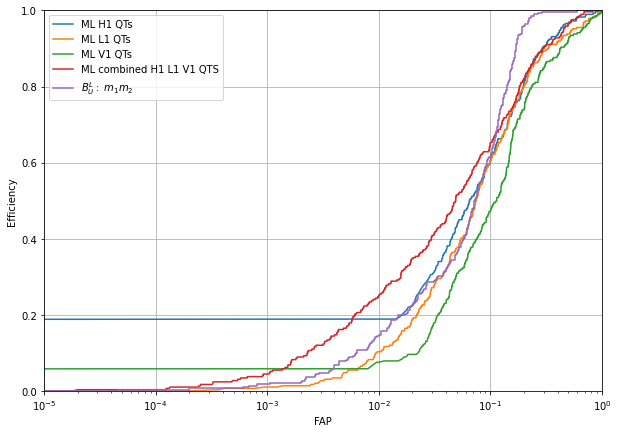

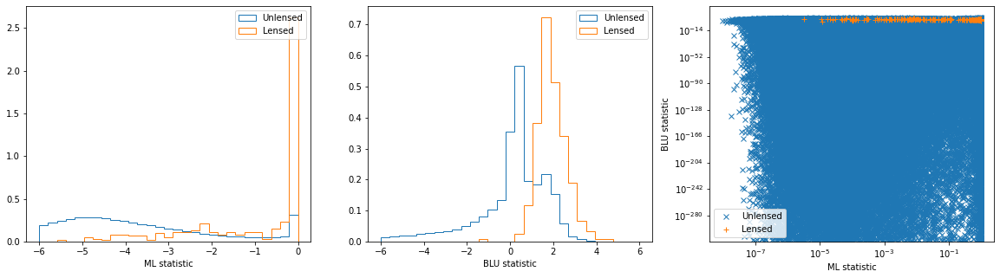

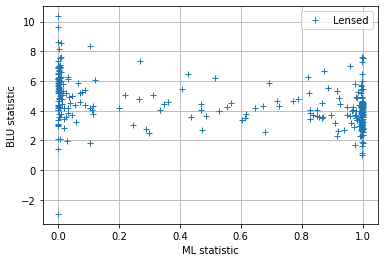

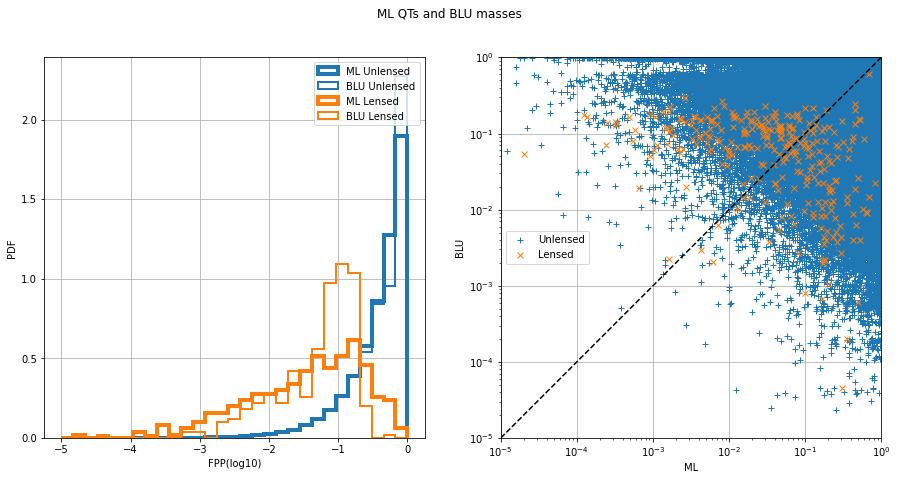

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8895206433272256, 'val_xgb_dense_QTS_0_roc': 0.9591706554528485, 'test_xgb_dense_QTS_0_acc': 0.9329358330498809, 'val_xgb_dense_QTS_0_acc': 0.9872963622853764, 'test_xgb_dense_QTS_0_f1': 0.009749468210824863, 'val_xgb_dense_QTS_0_f1': 0.23996175908221795}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9586


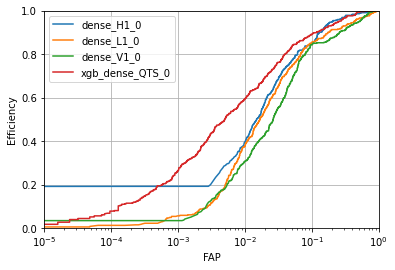

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8892
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

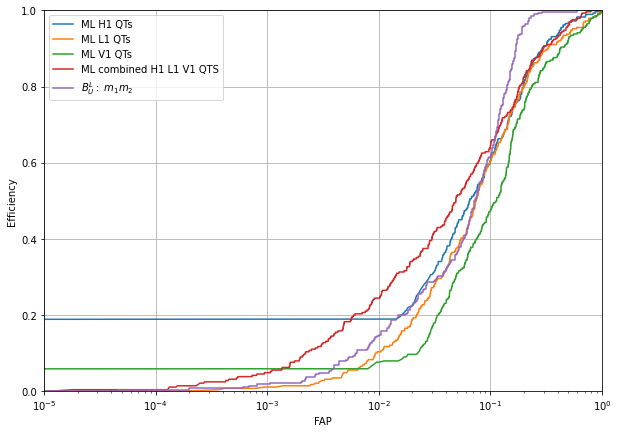

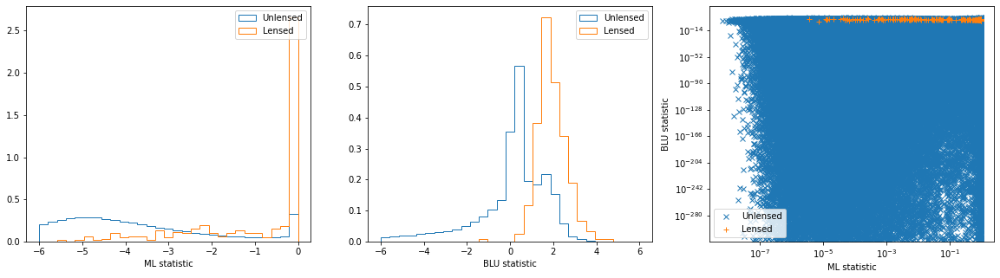

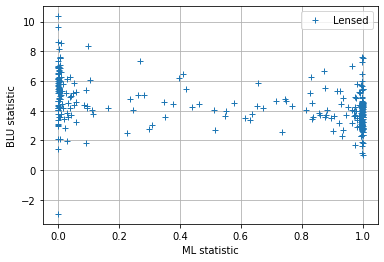

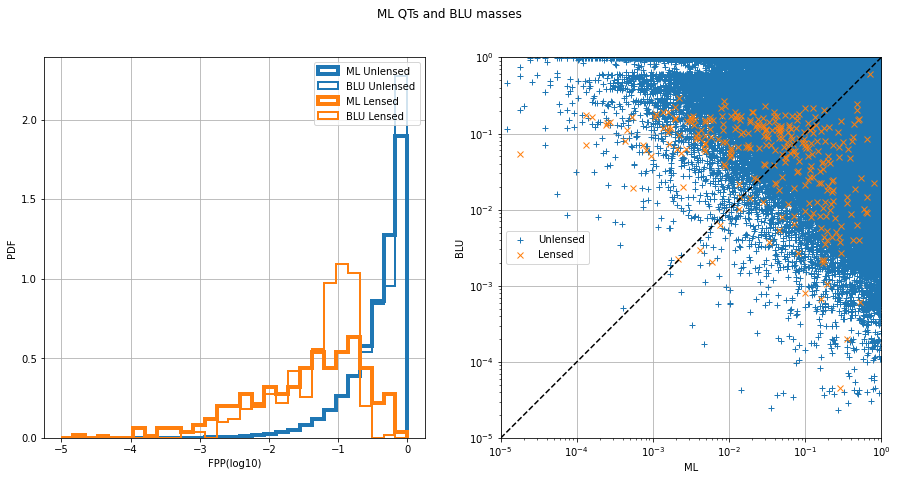

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8892260250957026, 'val_xgb_dense_QTS_0_roc': 0.9586408148338563, 'test_xgb_dense_QTS_0_acc': 0.9327677624602333, 'val_xgb_dense_QTS_0_acc': 0.9873443005409033, 'test_xgb_dense_QTS_0_f1': 0.009783697766252137, 'val_xgb_dense_QTS_0_f1': 0.24282982791586996}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9581


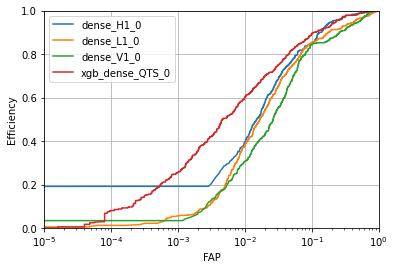

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8905
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

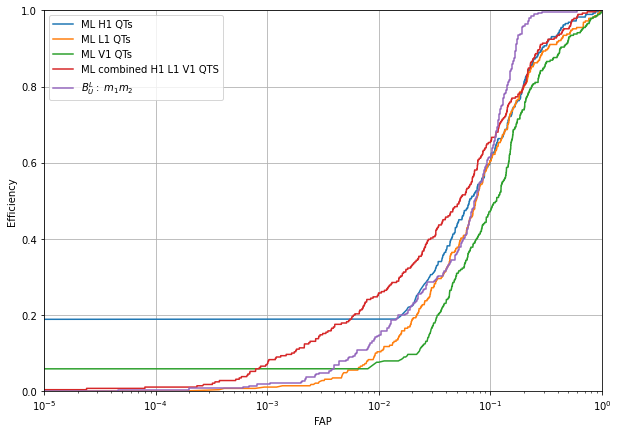

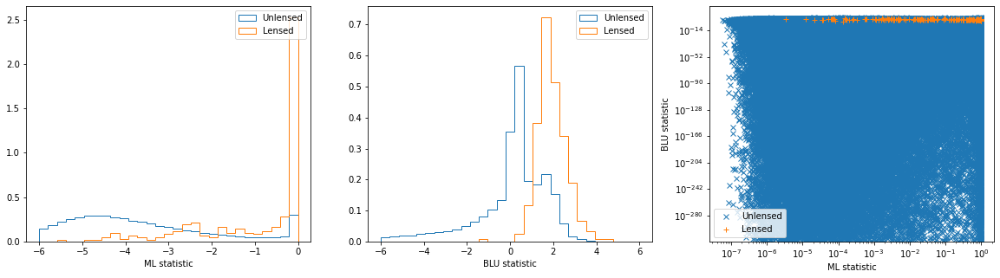

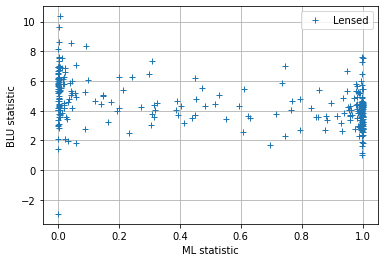

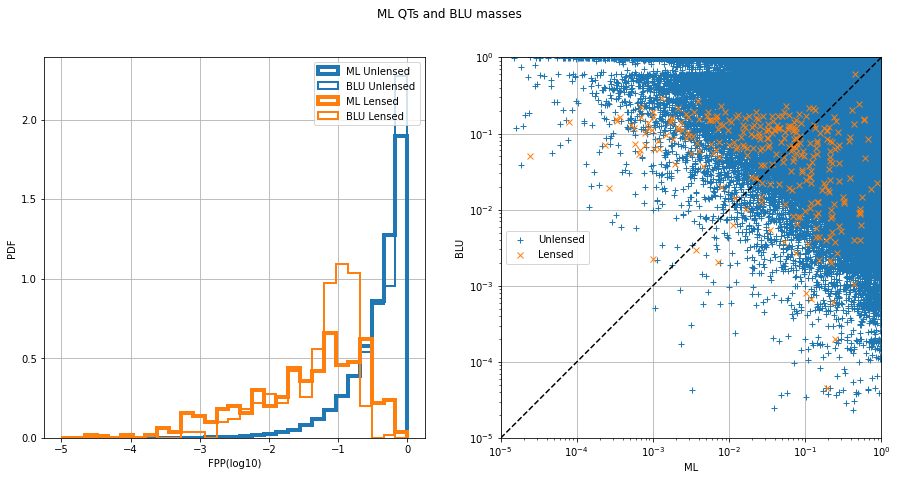

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8904736601057077, 'val_xgb_dense_QTS_0_roc': 0.9581203328127541, 'test_xgb_dense_QTS_0_acc': 0.9336161187698834, 'val_xgb_dense_QTS_0_acc': 0.9876798683295915, 'test_xgb_dense_QTS_0_f1': 0.009434525586672241, 'val_xgb_dense_QTS_0_f1': 0.24707031250000003}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9578


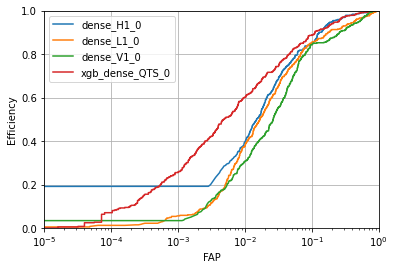

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8890
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

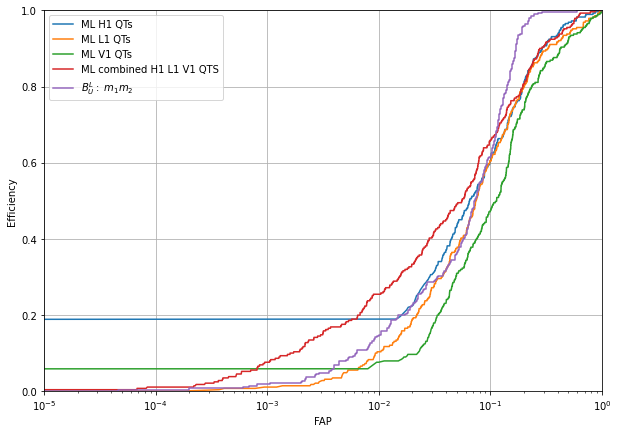

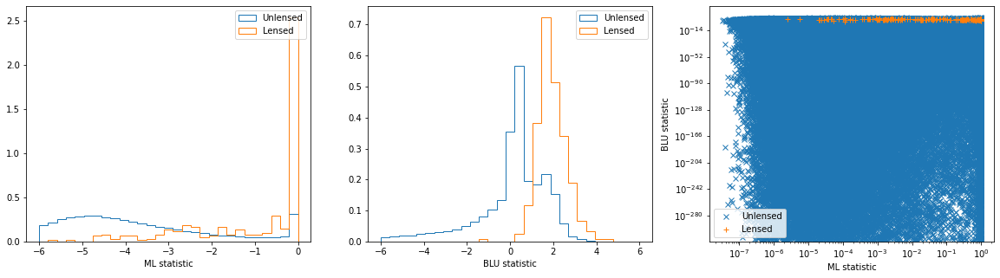

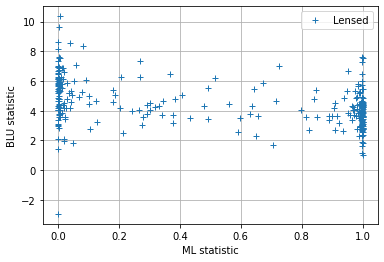

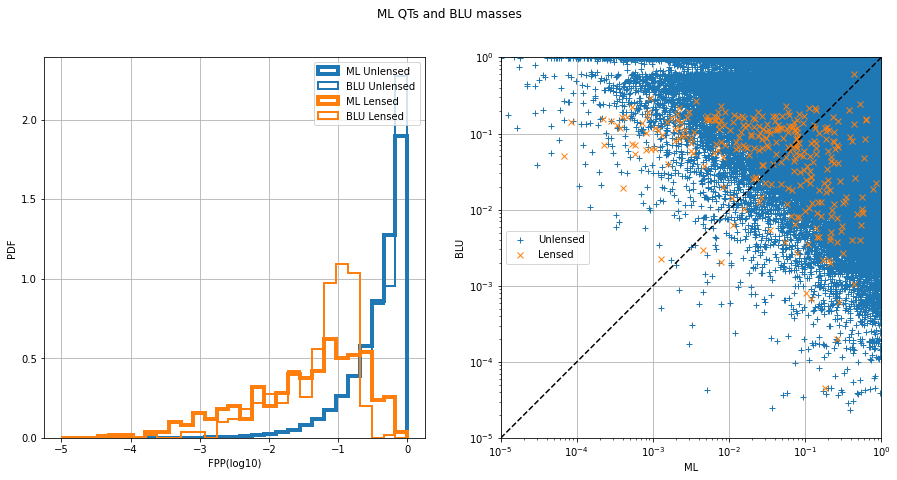

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8889723035127246, 'val_xgb_dense_QTS_0_roc': 0.9577984048279626, 'test_xgb_dense_QTS_0_acc': 0.9336061145681186, 'val_xgb_dense_QTS_0_acc': 0.9876079609463012, 'test_xgb_dense_QTS_0_f1': 0.009373973788697495, 'val_xgb_dense_QTS_0_f1': 0.2459893048128342}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9572


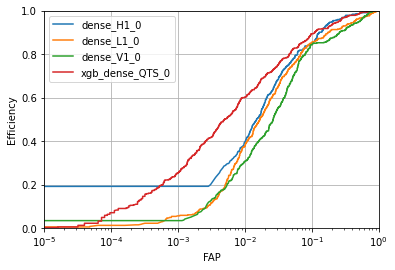

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8882
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

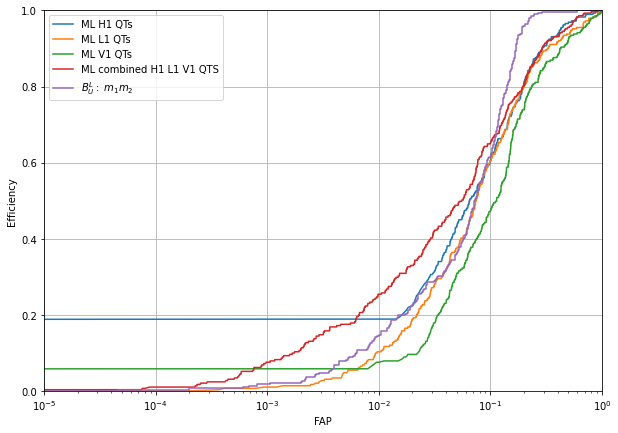

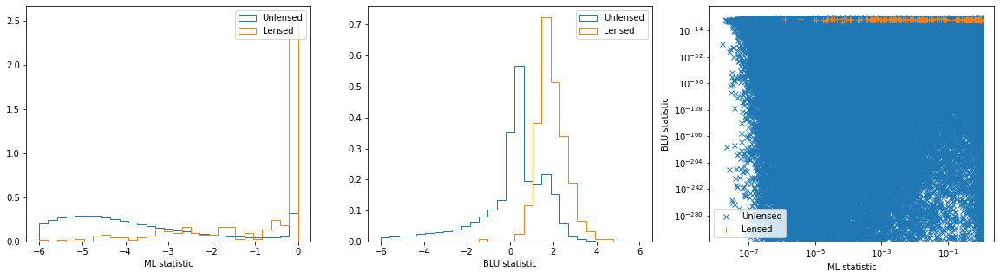

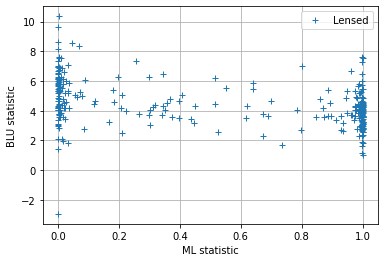

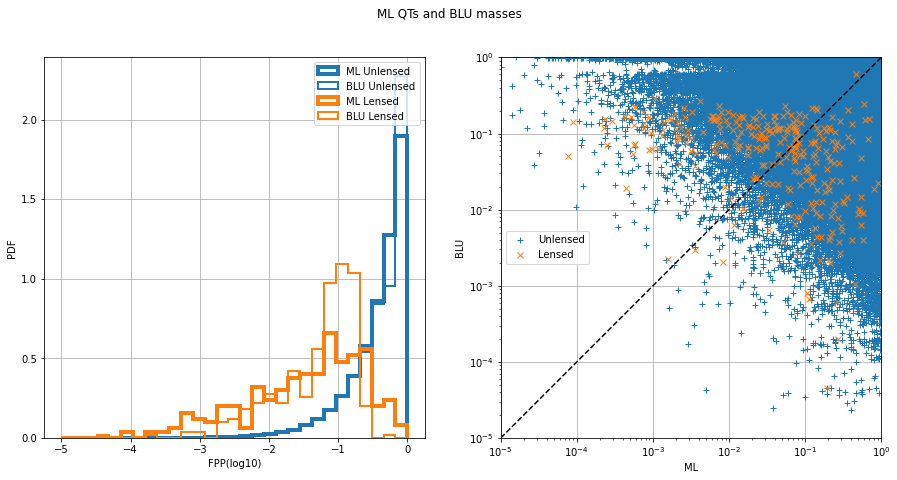

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.88815231349785, 'val_xgb_dense_QTS_0_roc': 0.9571836266640891, 'test_xgb_dense_QTS_0_acc': 0.9333159927169411, 'val_xgb_dense_QTS_0_acc': 0.9874801255982295, 'test_xgb_dense_QTS_0_f1': 0.0093924622518131, 'val_xgb_dense_QTS_0_f1': 0.2440906898215147}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9566


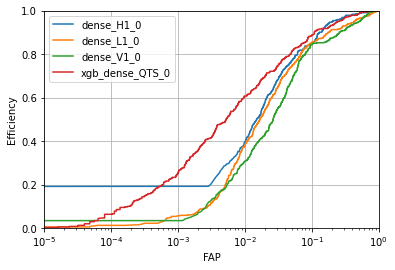

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8880
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

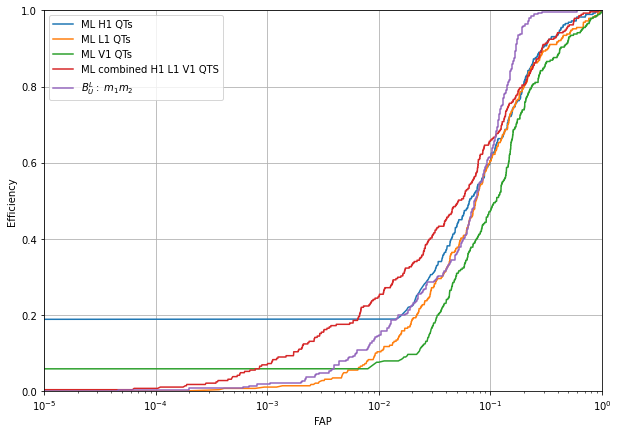

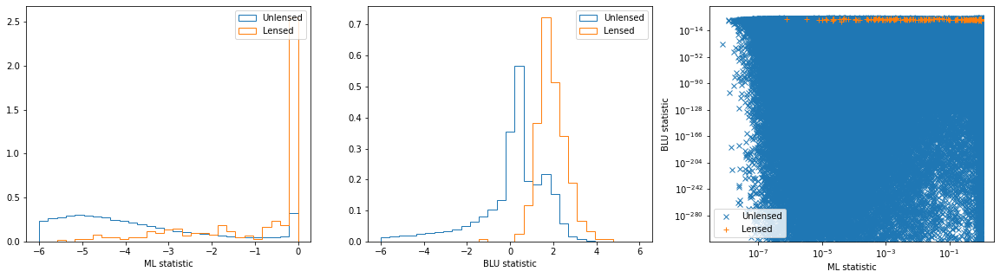

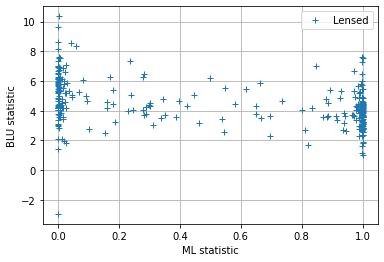

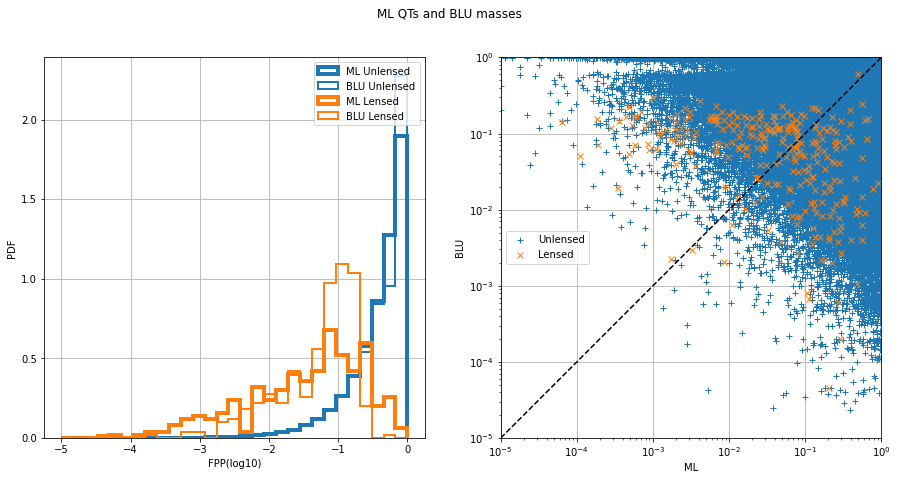

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8880272397203166, 'val_xgb_dense_QTS_0_roc': 0.9565770202488928, 'test_xgb_dense_QTS_0_acc': 0.933438043978471, 'val_xgb_dense_QTS_0_acc': 0.9875520329815198, 'test_xgb_dense_QTS_0_f1': 0.00940952267516303, 'val_xgb_dense_QTS_0_f1': 0.24588576960309777}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9564


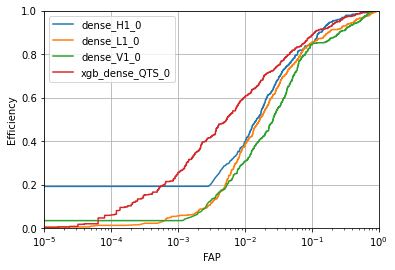

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8867
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

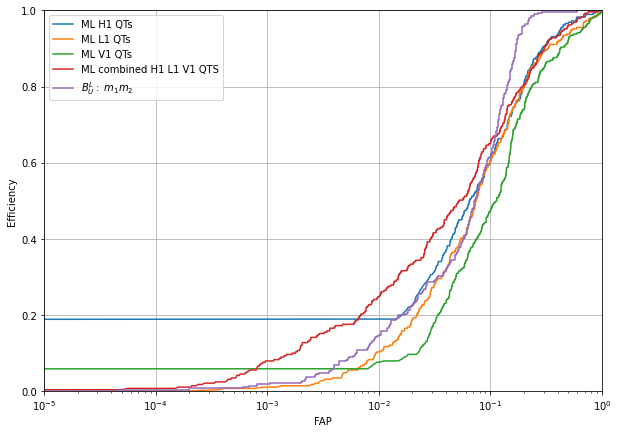

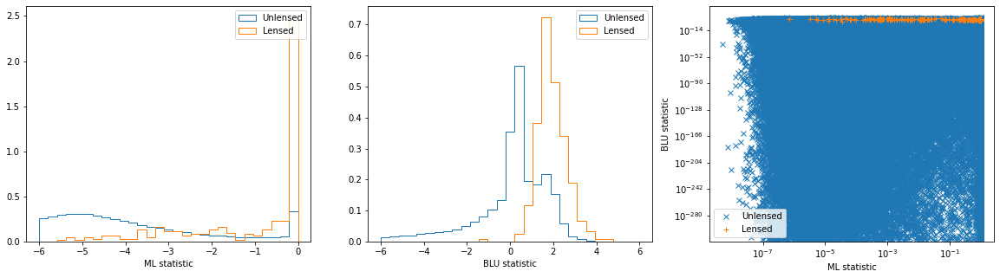

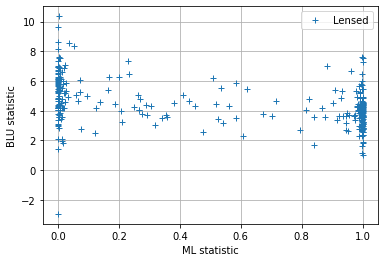

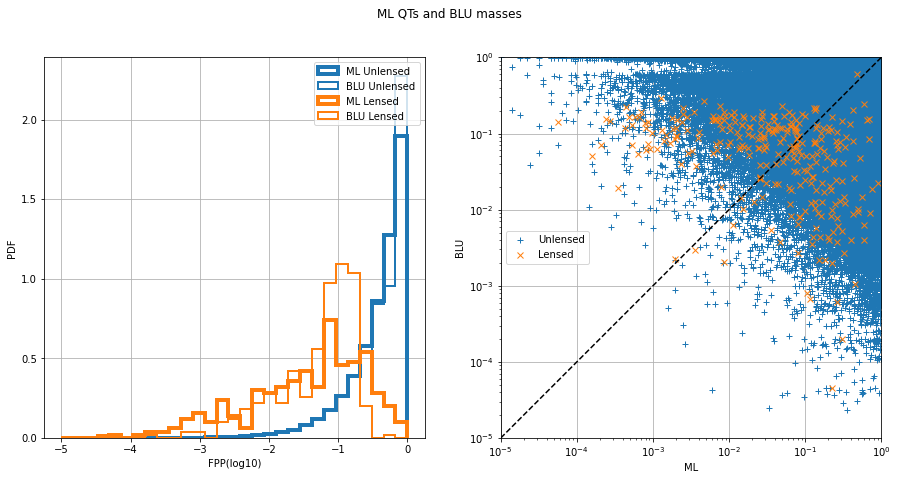

{'scale_pos_weight_xgbqts': 1, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8866970305620803, 'val_xgb_dense_QTS_0_roc': 0.9564397445993886, 'test_xgb_dense_QTS_0_acc': 0.933360011204706, 'val_xgb_dense_QTS_0_acc': 0.9874481667612116, 'test_xgb_dense_QTS_0_f1': 0.009457530335474662, 'val_xgb_dense_QTS_0_f1': 0.24434824434824437}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9609


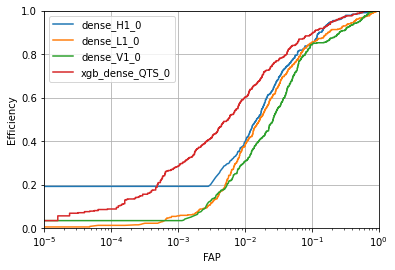

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8979
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

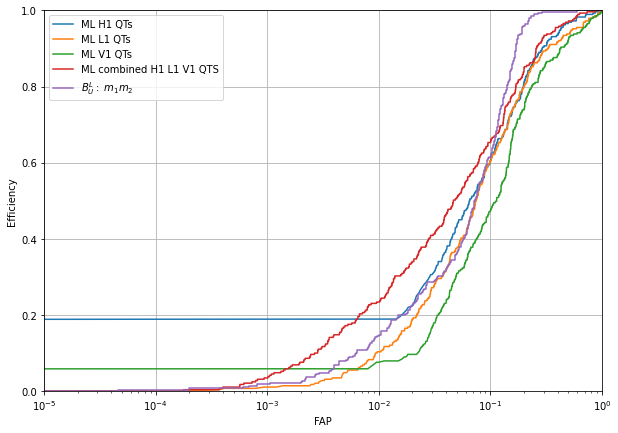

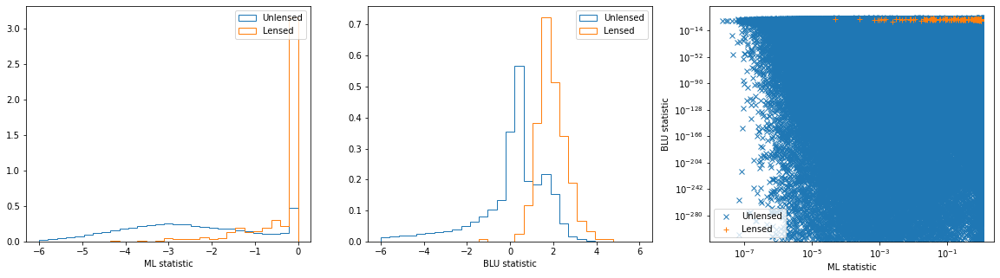

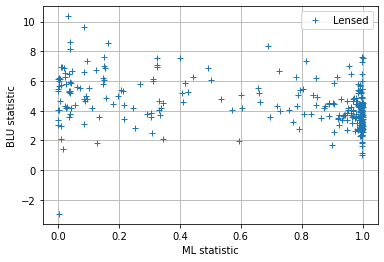

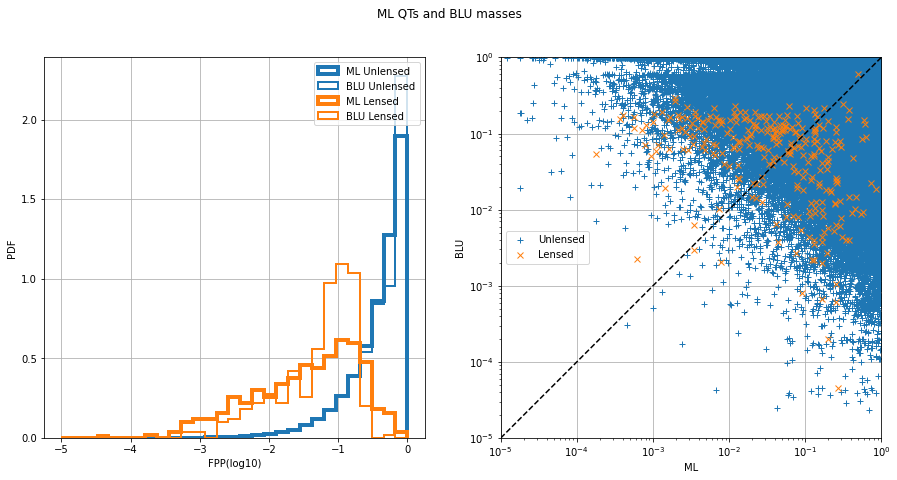

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8978784474001713, 'val_xgb_dense_QTS_0_roc': 0.9609451895911845, 'test_xgb_dense_QTS_0_acc': 0.8884971688109006, 'val_xgb_dense_QTS_0_acc': 0.9750401482890038, 'test_xgb_dense_QTS_0_f1': 0.006985032074126872, 'val_xgb_dense_QTS_0_f1': 0.16381156316916487}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9599


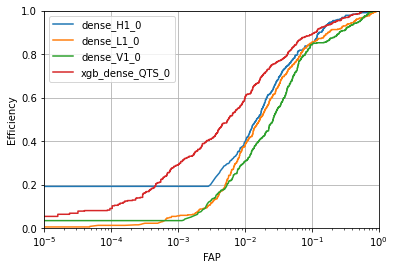

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8978
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

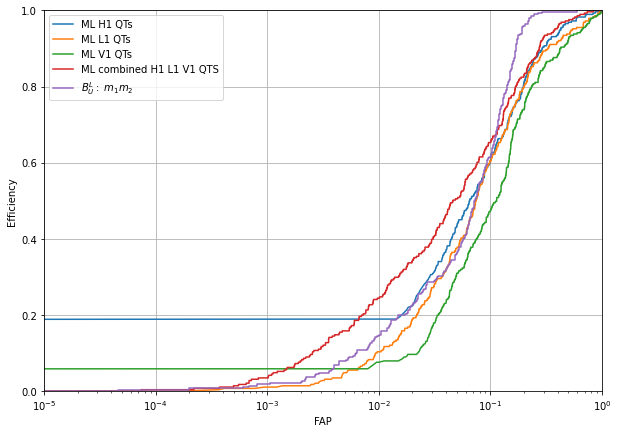

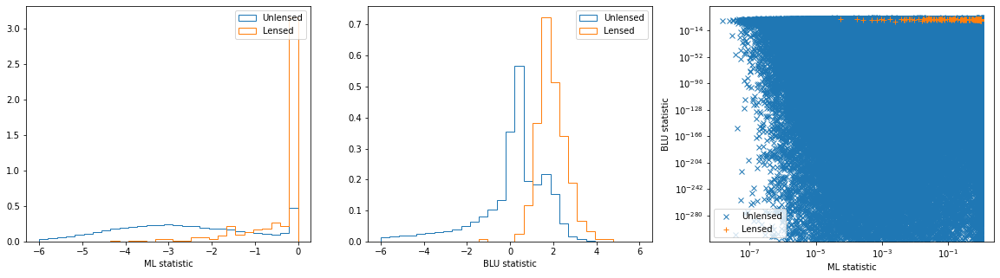

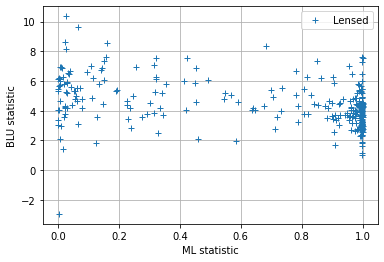

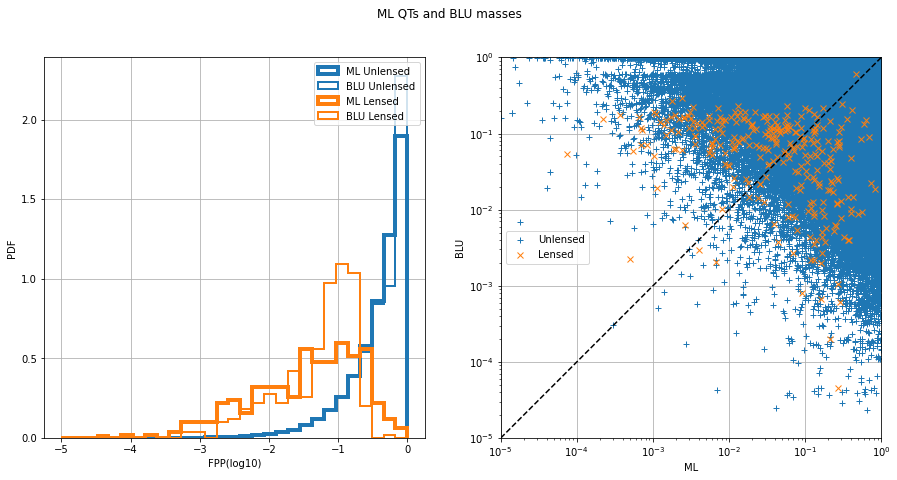

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8978395149190348, 'val_xgb_dense_QTS_0_roc': 0.9598817726966623, 'test_xgb_dense_QTS_0_acc': 0.8901518637827888, 'val_xgb_dense_QTS_0_acc': 0.9755914382275629, 'test_xgb_dense_QTS_0_f1': 0.007053589191731024, 'val_xgb_dense_QTS_0_f1': 0.16598416598416596}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9601


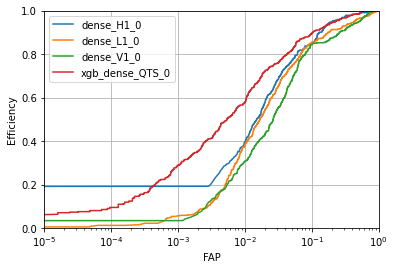

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8974
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

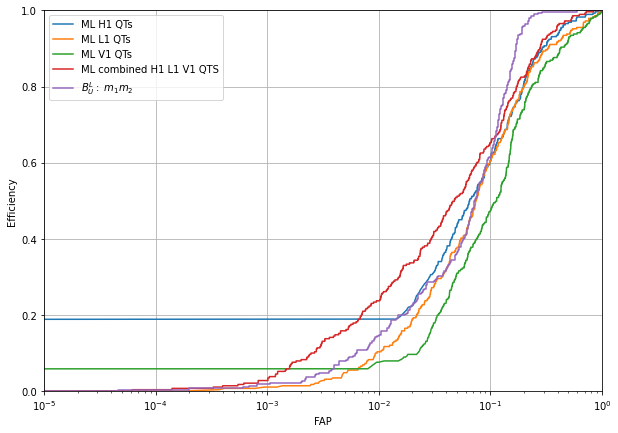

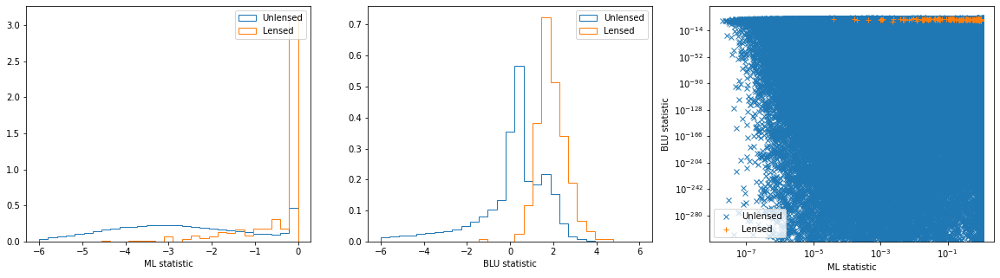

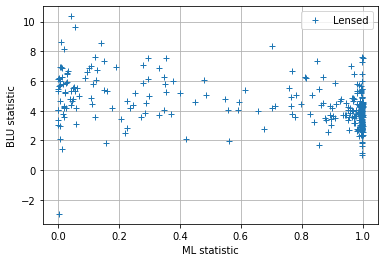

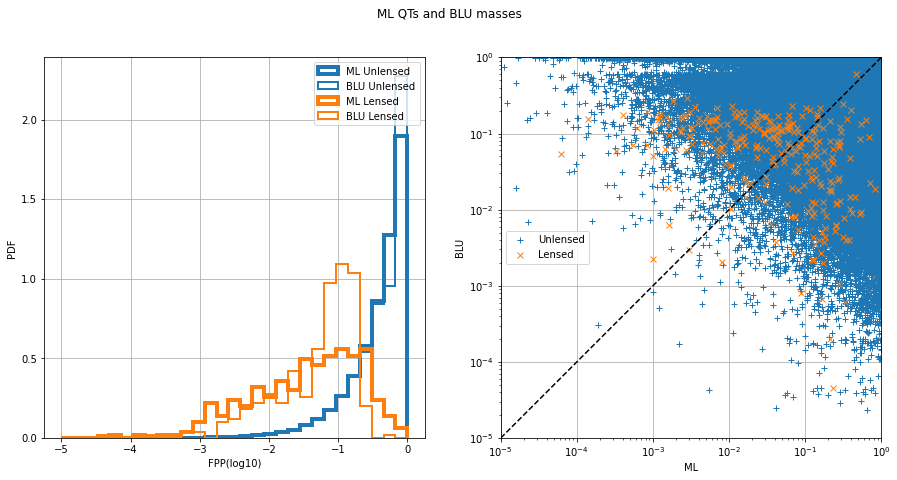

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8973957472397651, 'val_xgb_dense_QTS_0_roc': 0.9601216232486094, 'test_xgb_dense_QTS_0_acc': 0.8920826747233839, 'val_xgb_dense_QTS_0_acc': 0.9762066458401579, 'test_xgb_dense_QTS_0_f1': 0.007105776665071242, 'val_xgb_dense_QTS_0_f1': 0.16908482142857142}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9593


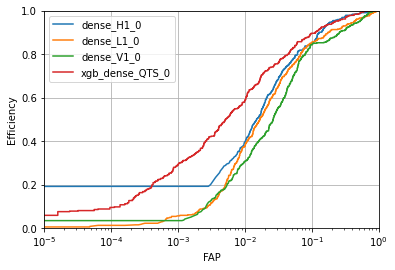

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8968
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

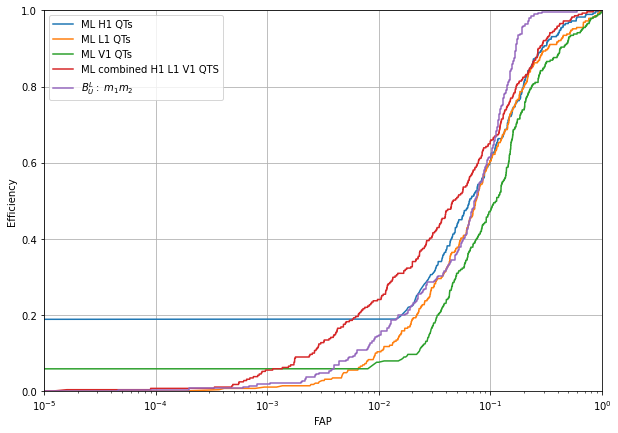

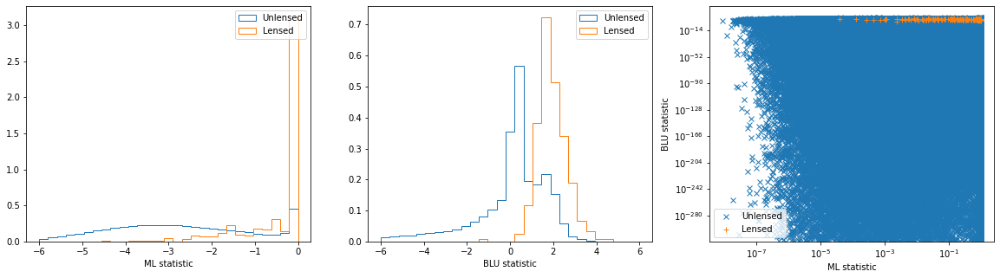

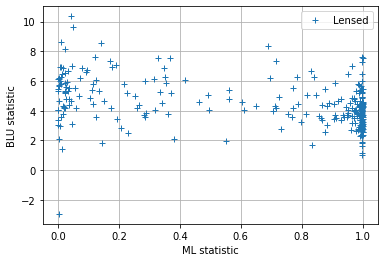

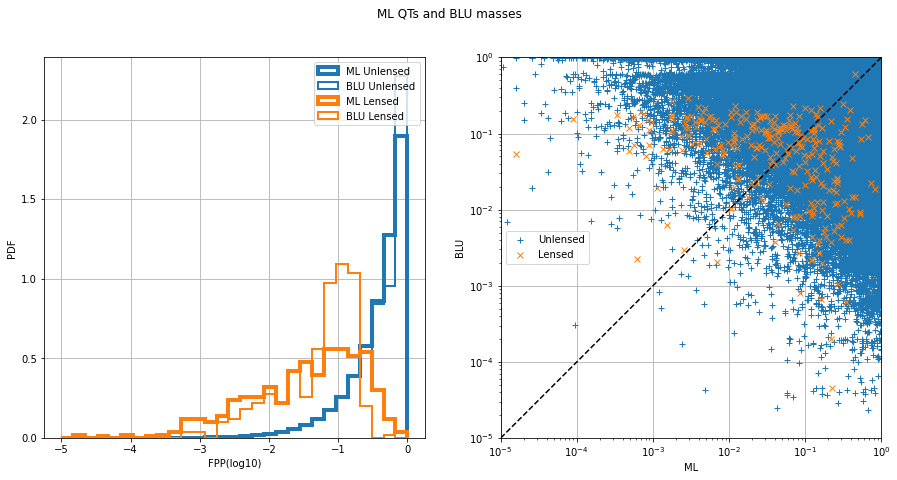

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8967695837414655, 'val_xgb_dense_QTS_0_roc': 0.9593448790802999, 'test_xgb_dense_QTS_0_acc': 0.8943856419696272, 'val_xgb_dense_QTS_0_acc': 0.9770215961841149, 'test_xgb_dense_QTS_0_f1': 0.007222253568808892, 'val_xgb_dense_QTS_0_f1': 0.17261219792865362}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9589


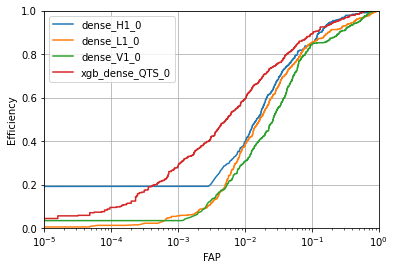

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8967
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

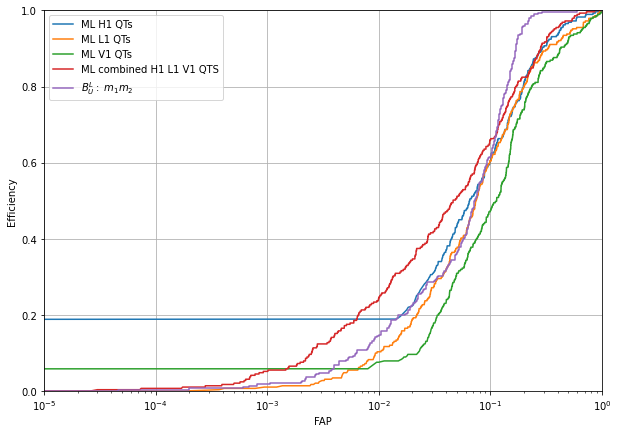

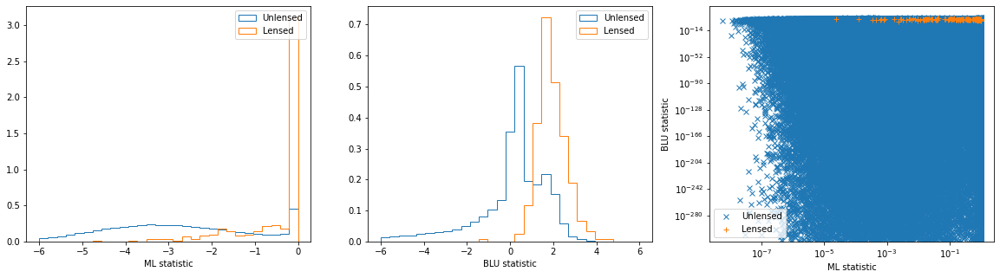

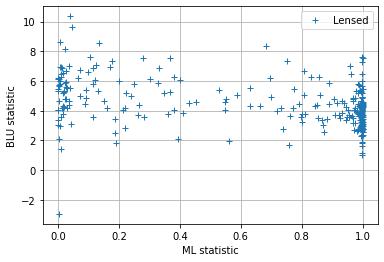

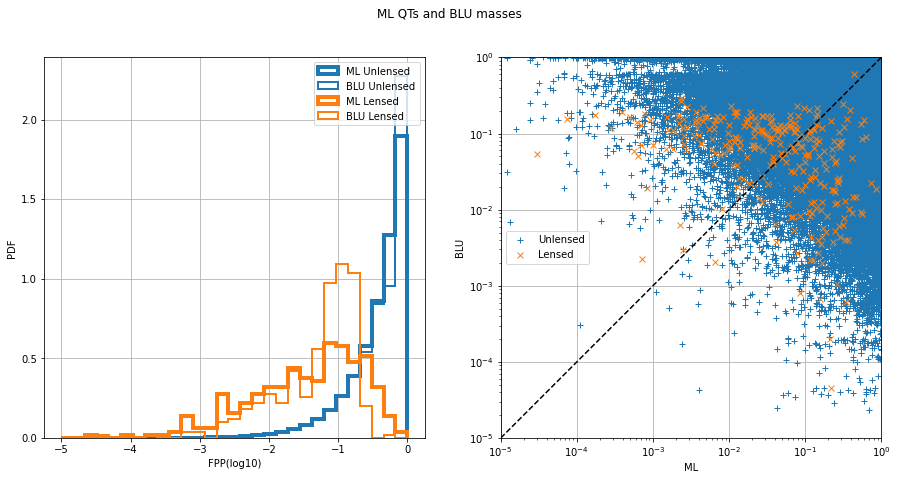

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8966938136617703, 'val_xgb_dense_QTS_0_roc': 0.9588866190884111, 'test_xgb_dense_QTS_0_acc': 0.896714620140459, 'val_xgb_dense_QTS_0_acc': 0.9775249478671472, 'test_xgb_dense_QTS_0_f1': 0.007422077797219606, 'val_xgb_dense_QTS_0_f1': 0.17386196769456683}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9596


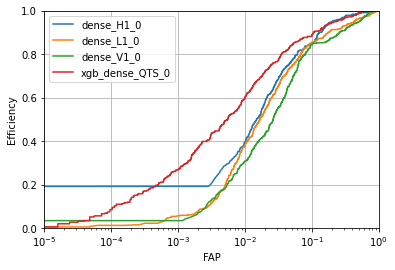

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8955
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

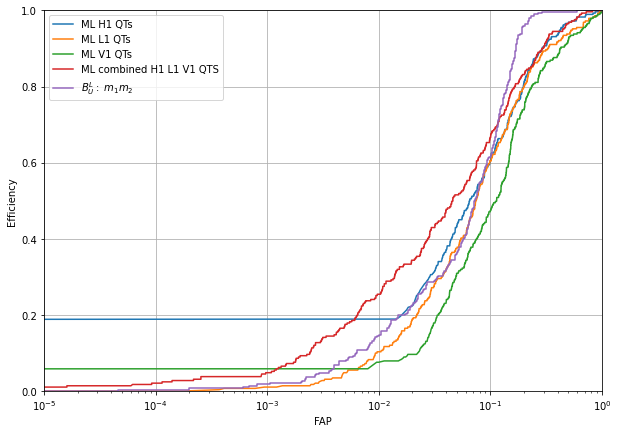

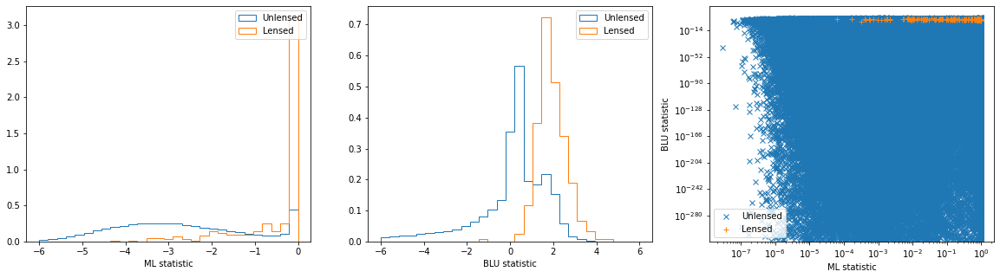

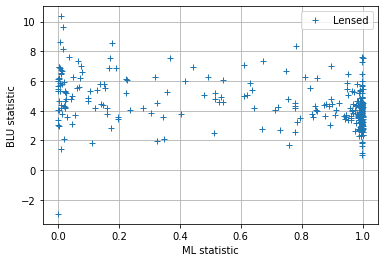

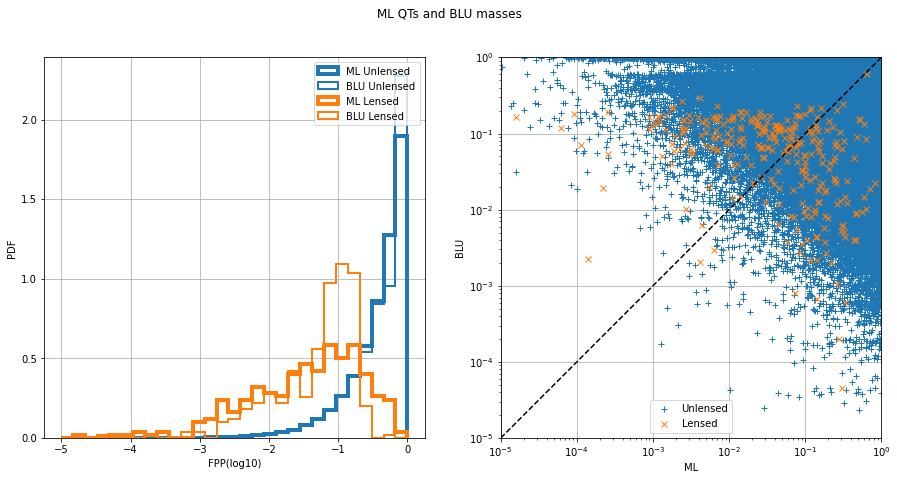

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8955338541314617, 'val_xgb_dense_QTS_0_roc': 0.9595865585474272, 'test_xgb_dense_QTS_0_acc': 0.8979811520838752, 'val_xgb_dense_QTS_0_acc': 0.9782839702463227, 'test_xgb_dense_QTS_0_f1': 0.007668054960881243, 'val_xgb_dense_QTS_0_f1': 0.18083182640144665}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9596


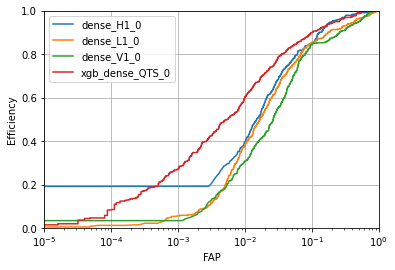

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8958
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

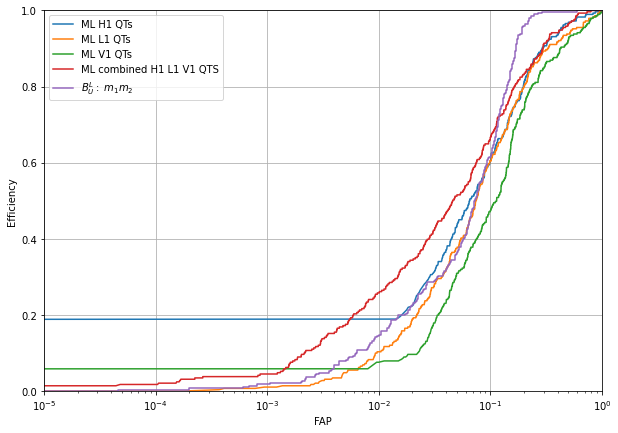

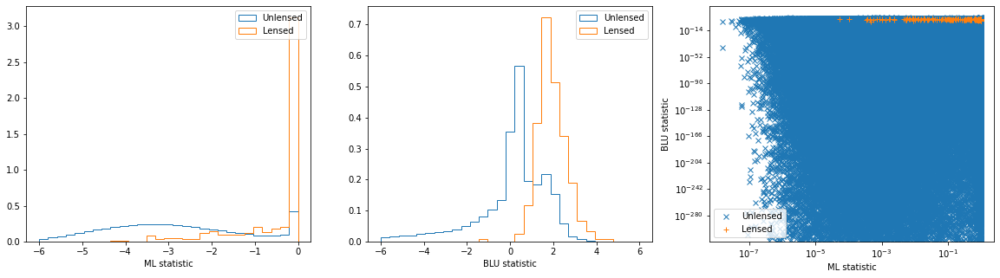

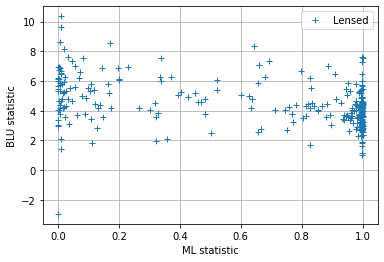

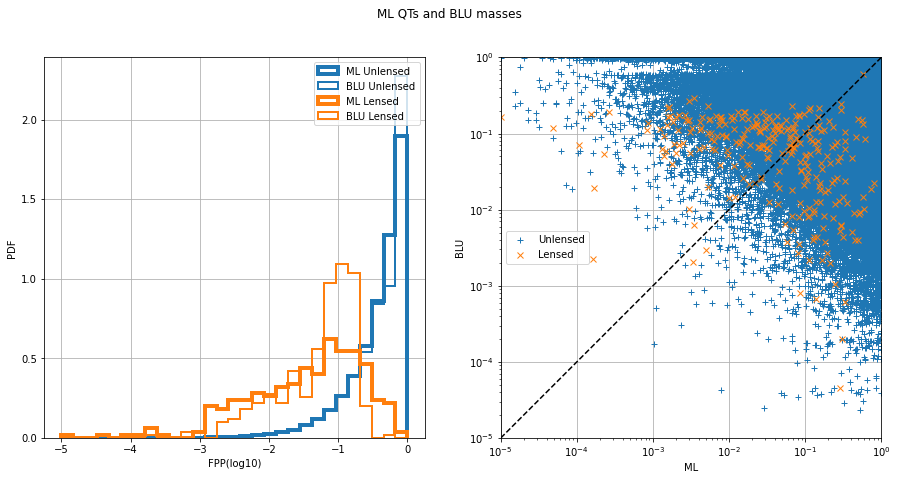

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8957555676973896, 'val_xgb_dense_QTS_0_roc': 0.959644568234763, 'test_xgb_dense_QTS_0_acc': 0.9017327277456532, 'val_xgb_dense_QTS_0_acc': 0.9791788176828246, 'test_xgb_dense_QTS_0_f1': 0.007758045942178314, 'val_xgb_dense_QTS_0_f1': 0.18409517845961176}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9591


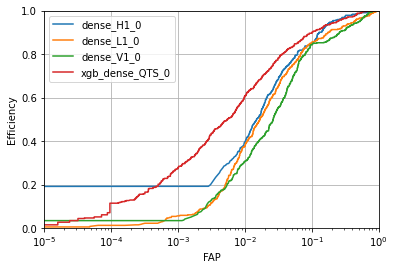

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8952
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

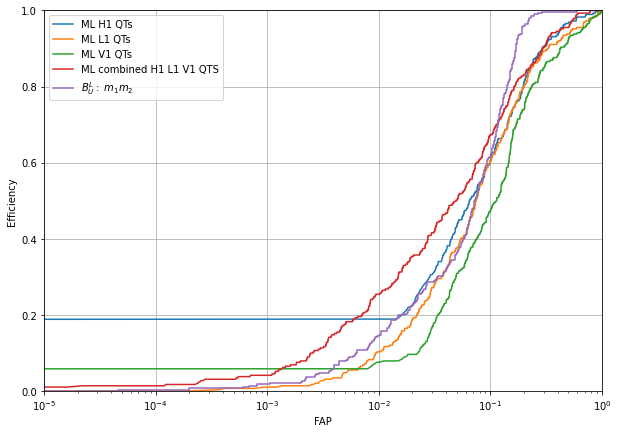

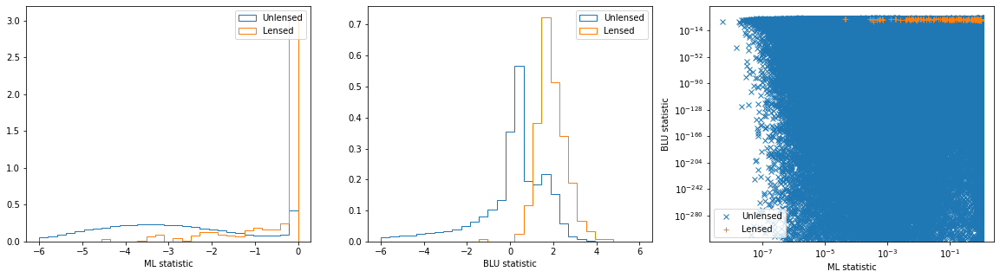

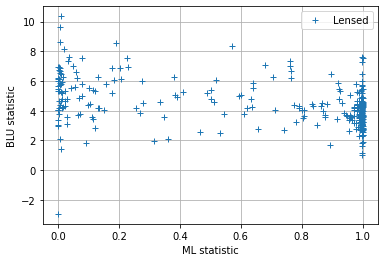

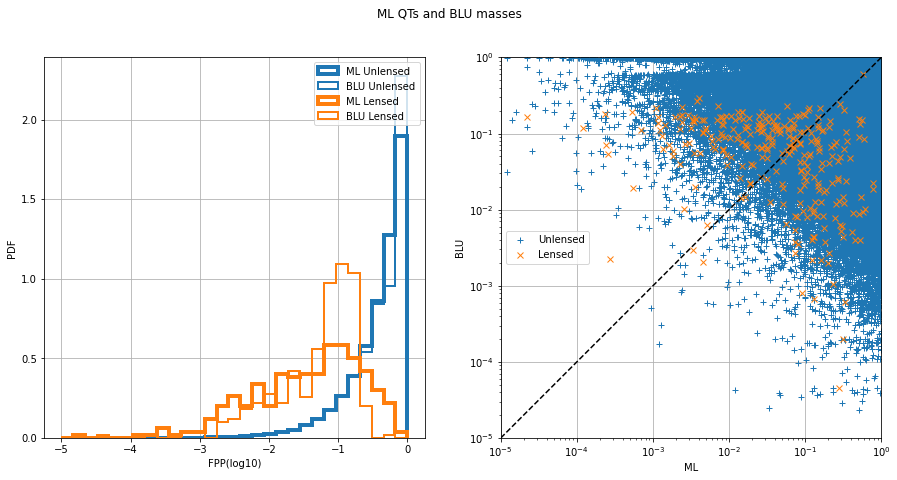

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8951528469326953, 'val_xgb_dense_QTS_0_roc': 0.9591487765685924, 'test_xgb_dense_QTS_0_acc': 0.9034574521298946, 'val_xgb_dense_QTS_0_acc': 0.9797700561676561, 'test_xgb_dense_QTS_0_f1': 0.007977137687863648, 'val_xgb_dense_QTS_0_f1': 0.18689788053949905}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9593


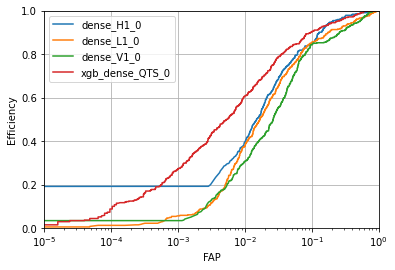

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8937
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

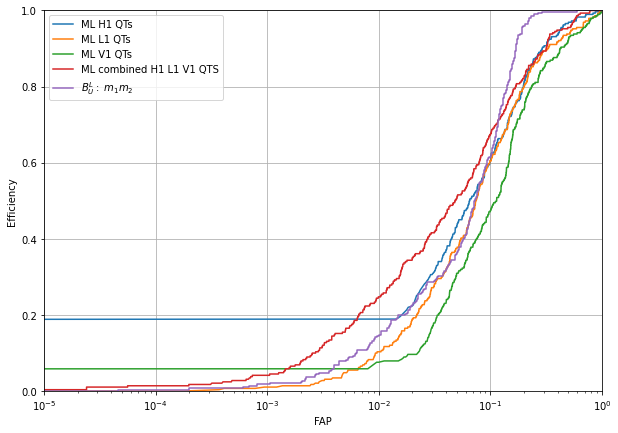

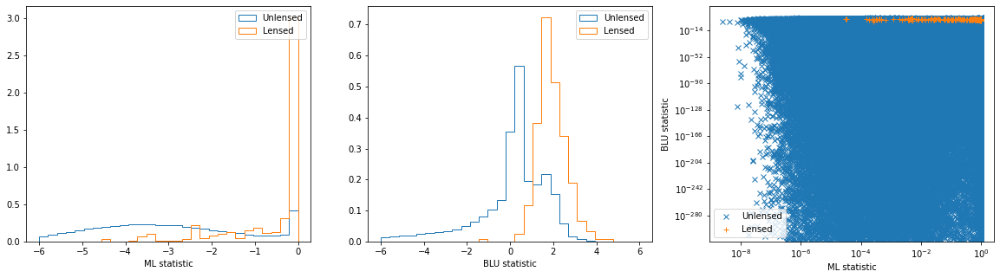

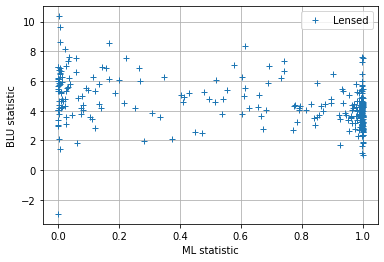

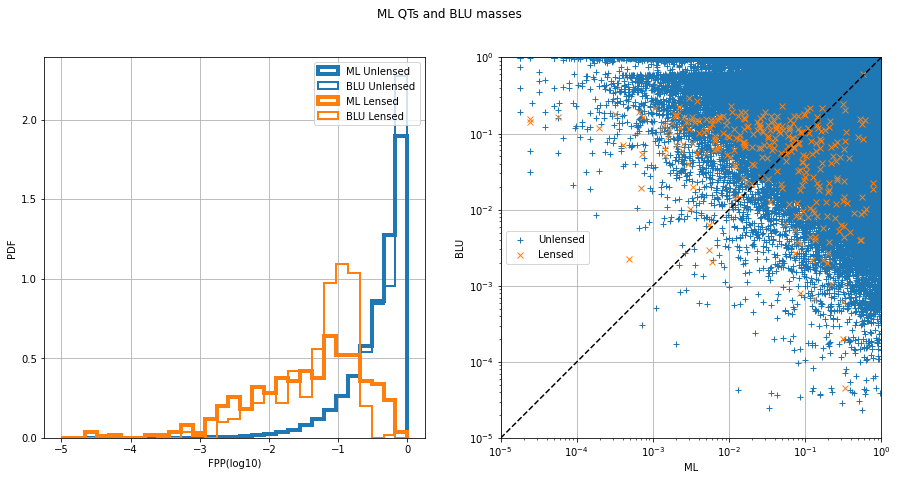

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8936669009701673, 'val_xgb_dense_QTS_0_roc': 0.9592905369515969, 'test_xgb_dense_QTS_0_acc': 0.9053702555073131, 'val_xgb_dense_QTS_0_acc': 0.980233459304416, 'test_xgb_dense_QTS_0_f1': 0.008053860190020764, 'val_xgb_dense_QTS_0_f1': 0.1883202099737533}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9591


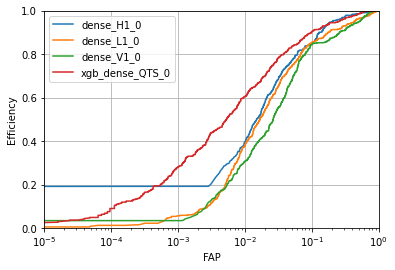

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8943
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

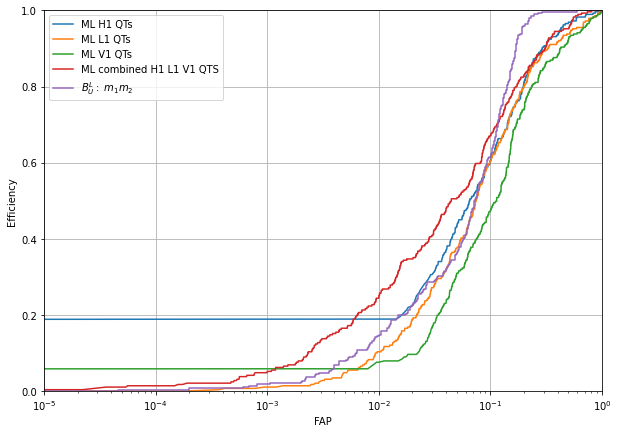

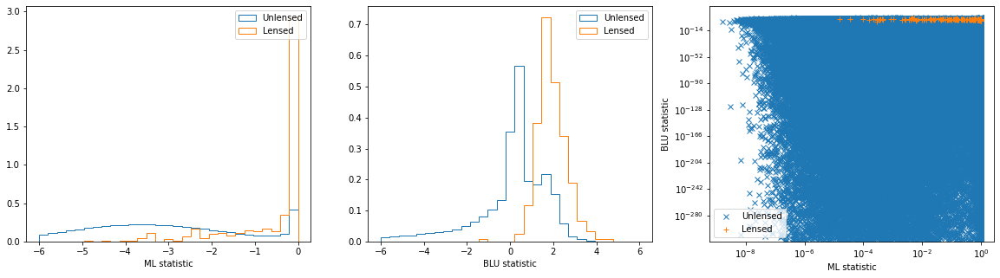

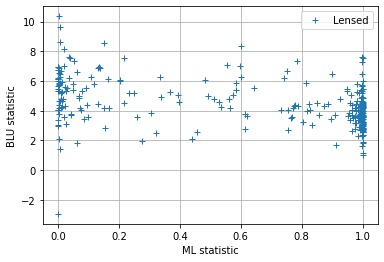

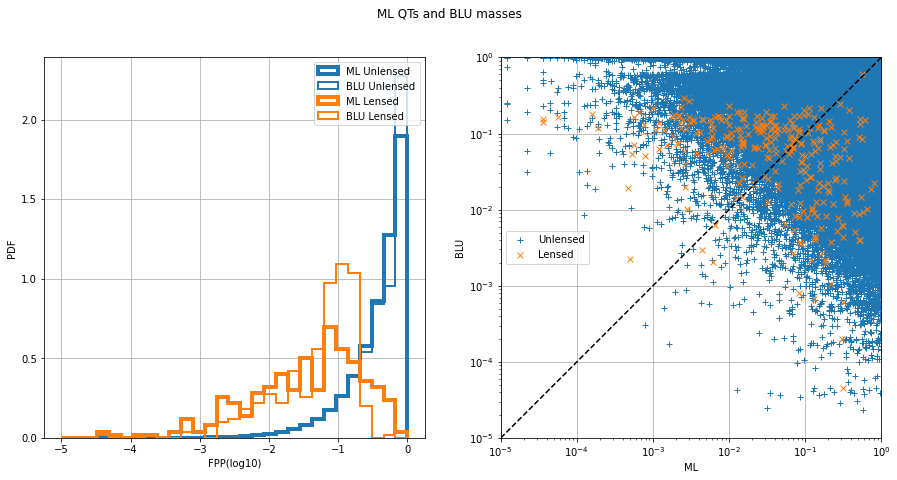

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8942642176945835, 'val_xgb_dense_QTS_0_roc': 0.9590639849477944, 'test_xgb_dense_QTS_0_acc': 0.9075931891394385, 'val_xgb_dense_QTS_0_acc': 0.9807448006967027, 'test_xgb_dense_QTS_0_f1': 0.008203410213460466, 'val_xgb_dense_QTS_0_f1': 0.19073203492276697}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9583


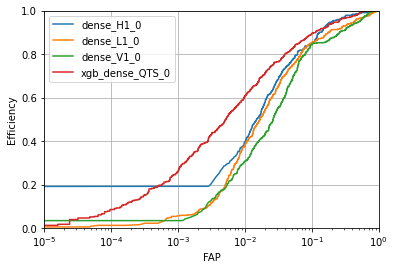

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8924
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

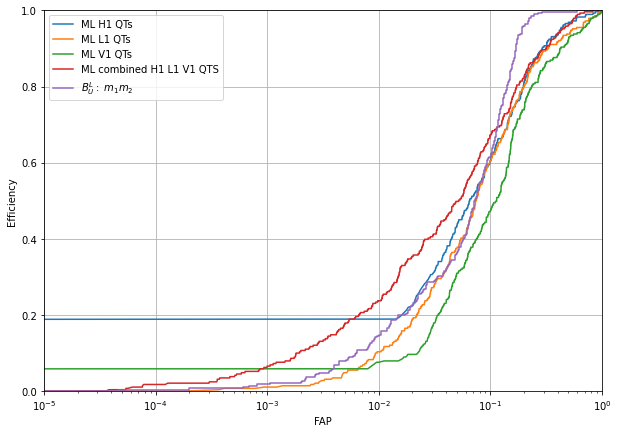

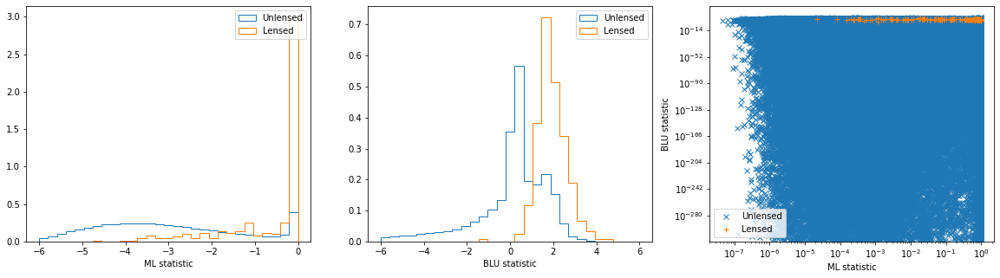

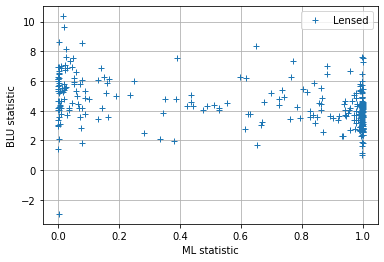

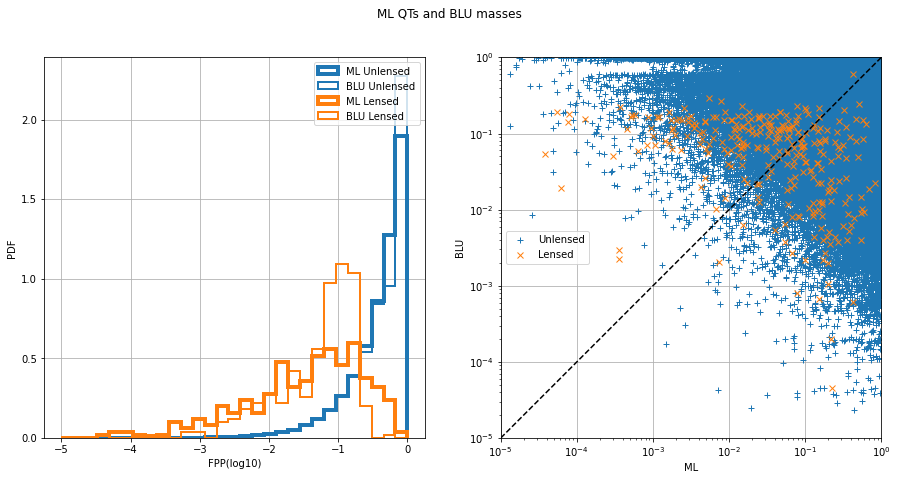

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8924302941925817, 'val_xgb_dense_QTS_0_roc': 0.9583342477909234, 'test_xgb_dense_QTS_0_acc': 0.9101982832789771, 'val_xgb_dense_QTS_0_acc': 0.9817115555164948, 'test_xgb_dense_QTS_0_f1': 0.008264097578221672, 'val_xgb_dense_QTS_0_f1': 0.199930094372597}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9581


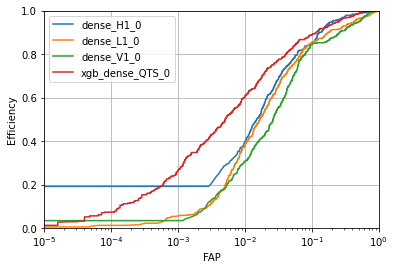

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8923
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

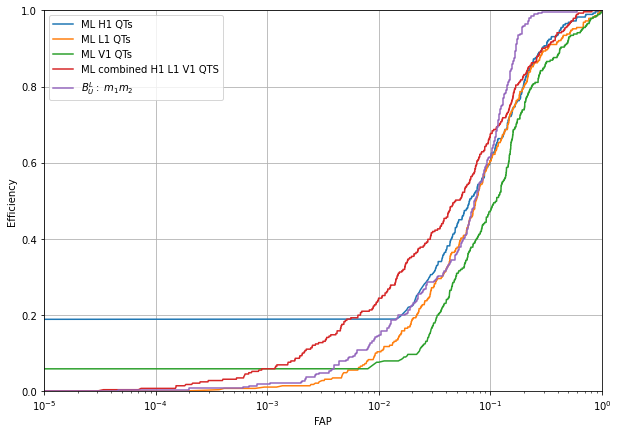

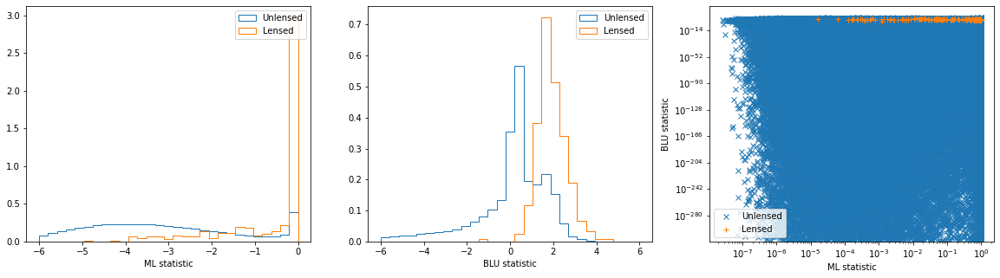

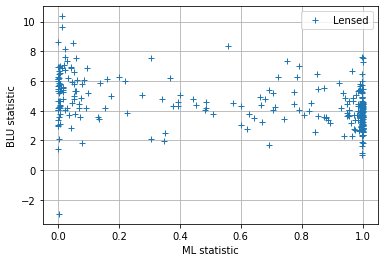

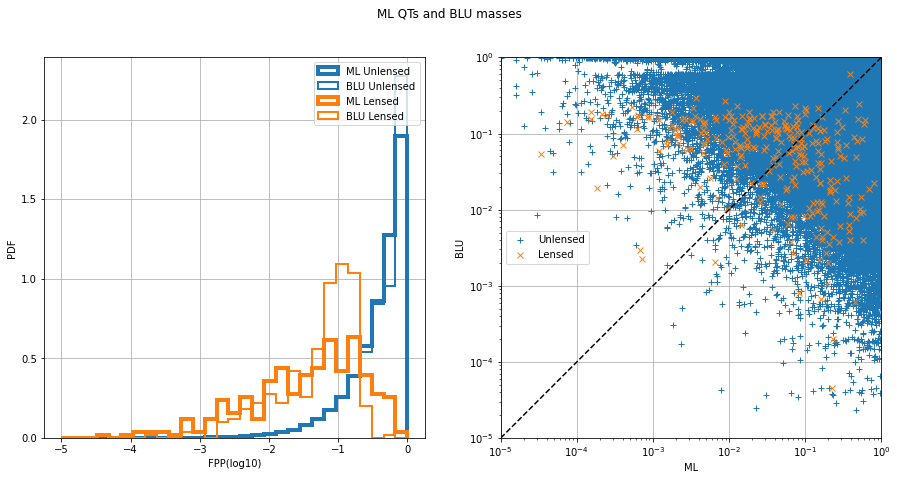

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8922774228023903, 'val_xgb_dense_QTS_0_roc': 0.9581402465860185, 'test_xgb_dense_QTS_0_acc': 0.9121611076652194, 'val_xgb_dense_QTS_0_acc': 0.9822948042920718, 'test_xgb_dense_QTS_0_f1': 0.00831281483656735, 'val_xgb_dense_QTS_0_f1': 0.20230381569474445}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9578


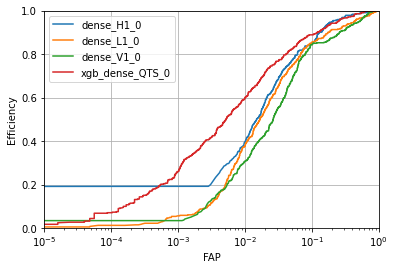

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8916
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

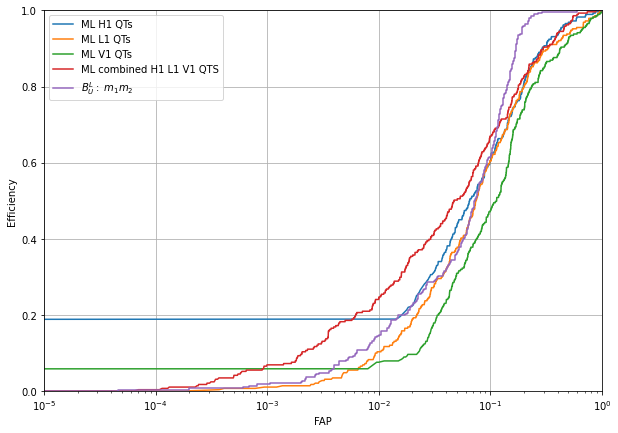

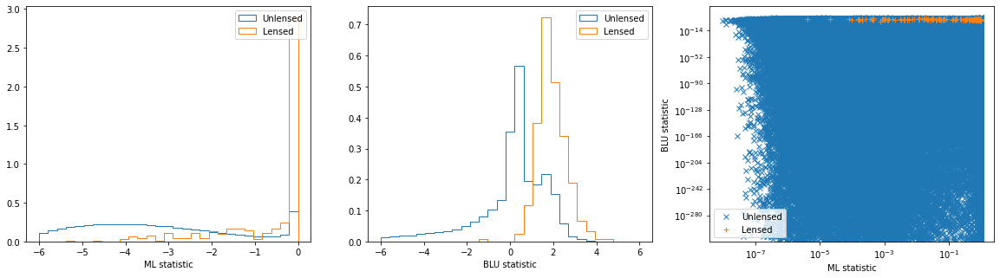

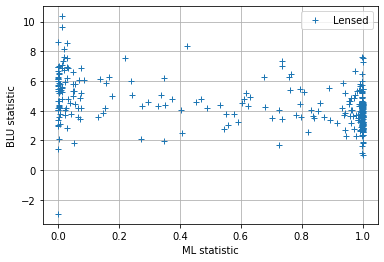

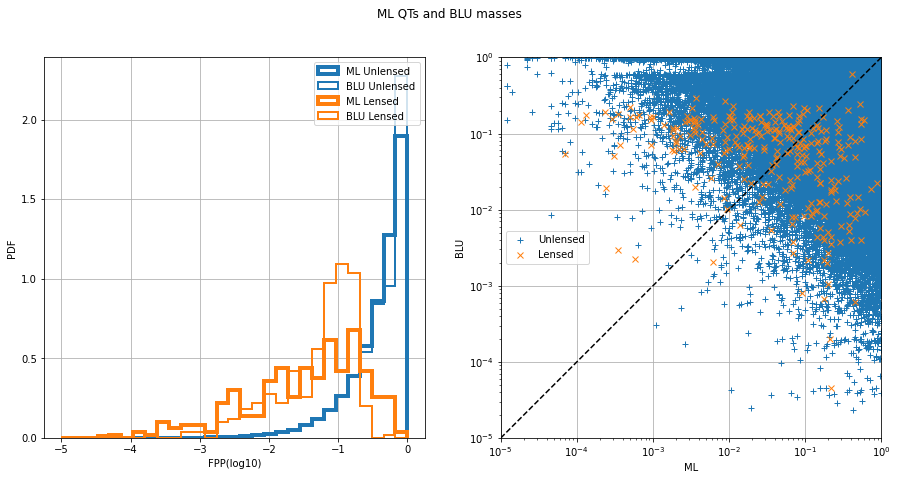

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8915519880129512, 'val_xgb_dense_QTS_0_roc': 0.9577924608536272, 'test_xgb_dense_QTS_0_acc': 0.9135556933912243, 'val_xgb_dense_QTS_0_acc': 0.982614392662251, 'test_xgb_dense_QTS_0_f1': 0.008400275418866194, 'val_xgb_dense_QTS_0_f1': 0.20351390922401172}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9577


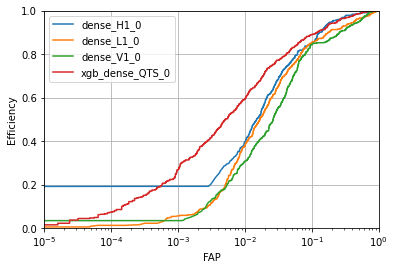

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8911
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

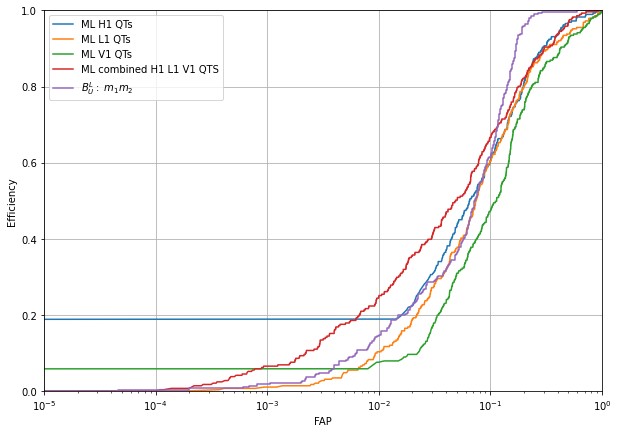

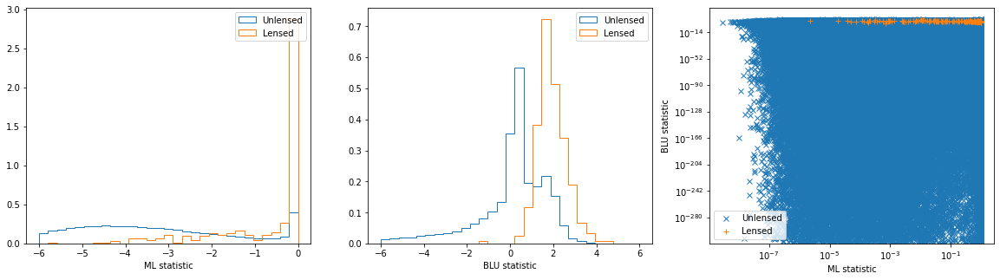

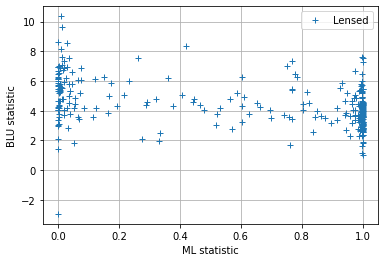

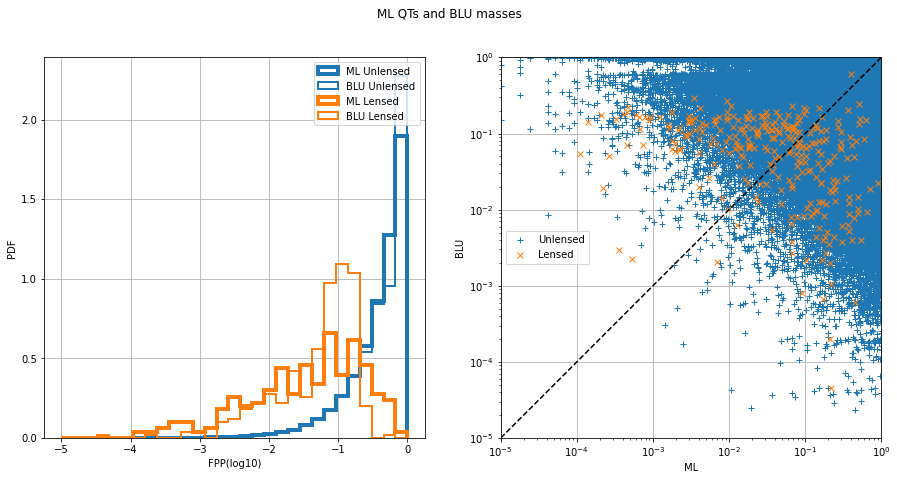

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8910866488909173, 'val_xgb_dense_QTS_0_roc': 0.9576774824040848, 'test_xgb_dense_QTS_0_acc': 0.9143560295324036, 'val_xgb_dense_QTS_0_acc': 0.9828141353936131, 'test_xgb_dense_QTS_0_f1': 0.00847810979847116, 'val_xgb_dense_QTS_0_f1': 0.20539342445511635}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9571


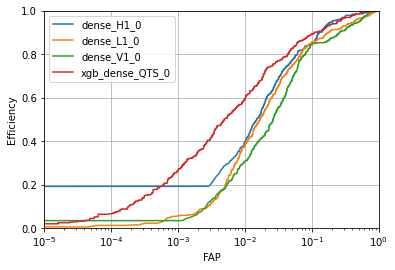

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8897
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

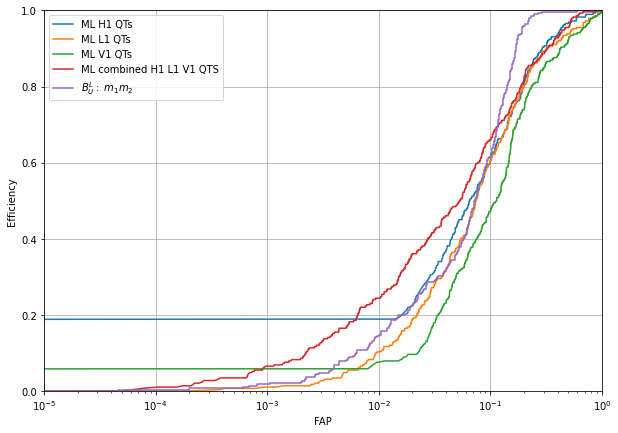

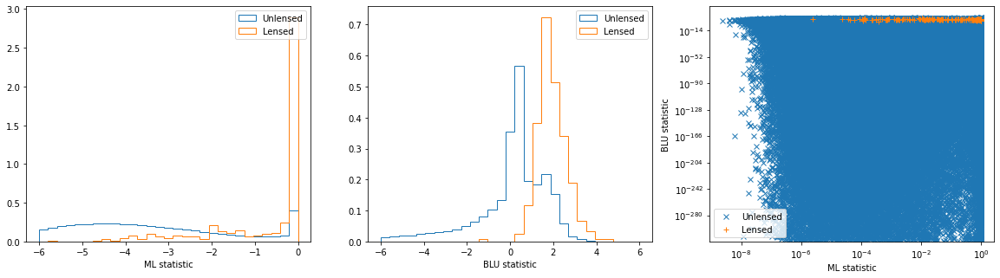

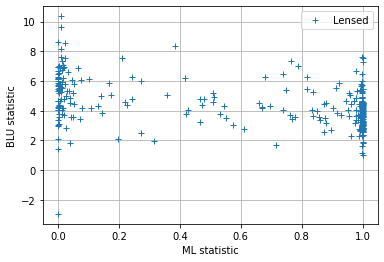

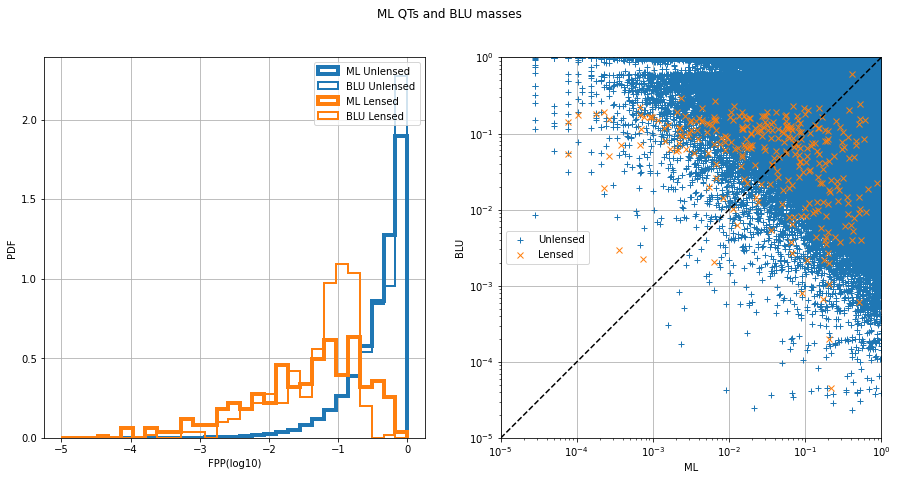

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8897043669371831, 'val_xgb_dense_QTS_0_roc': 0.9571210349605309, 'test_xgb_dense_QTS_0_acc': 0.9155125152564076, 'val_xgb_dense_QTS_0_acc': 0.9830538266712474, 'test_xgb_dense_QTS_0_f1': 0.00854660718478516, 'val_xgb_dense_QTS_0_f1': 0.20591538749532012}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9609


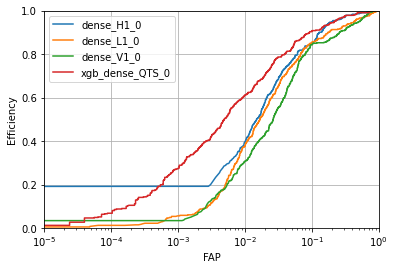

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8941
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

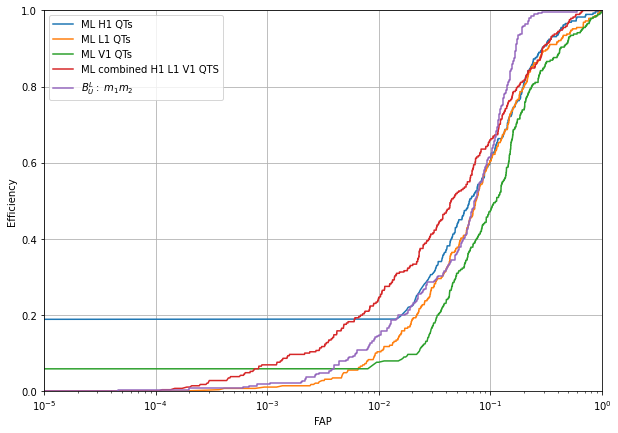

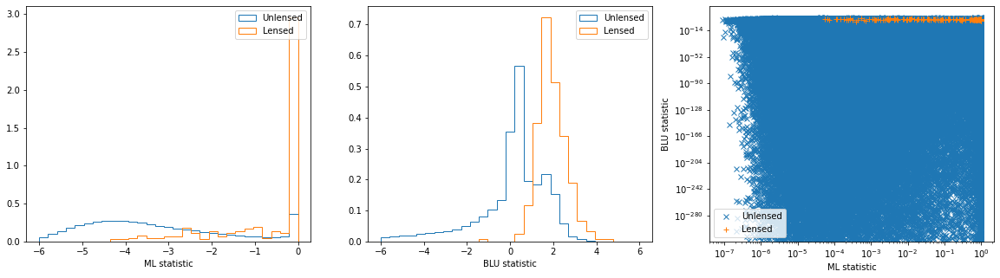

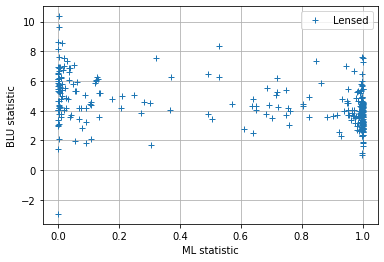

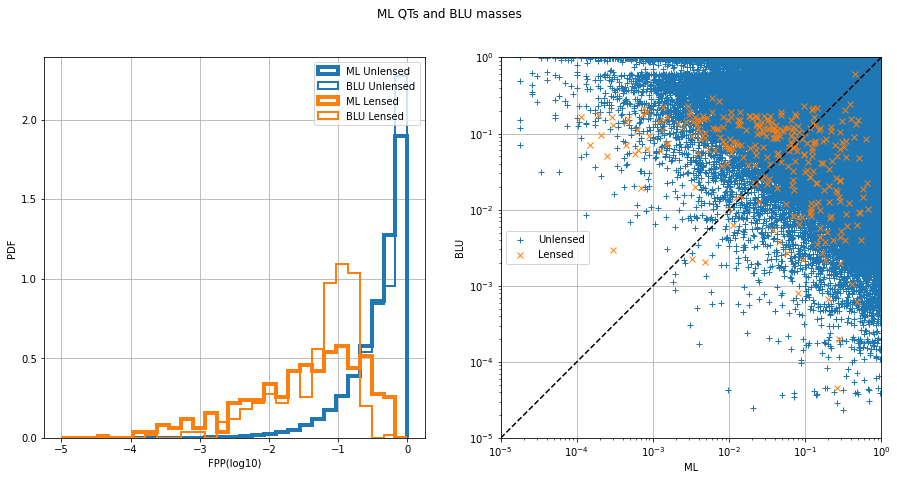

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8940723209466882, 'val_xgb_dense_QTS_0_roc': 0.960870106786077, 'test_xgb_dense_QTS_0_acc': 0.917937533764181, 'val_xgb_dense_QTS_0_acc': 0.9836051166098065, 'test_xgb_dense_QTS_0_f1': 0.008844852585790238, 'val_xgb_dense_QTS_0_f1': 0.21198156682027652}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9586


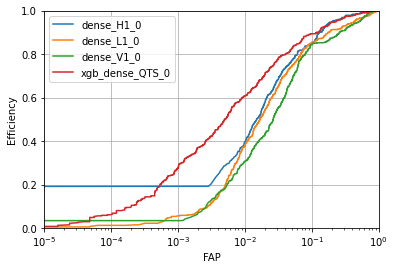

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8926
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

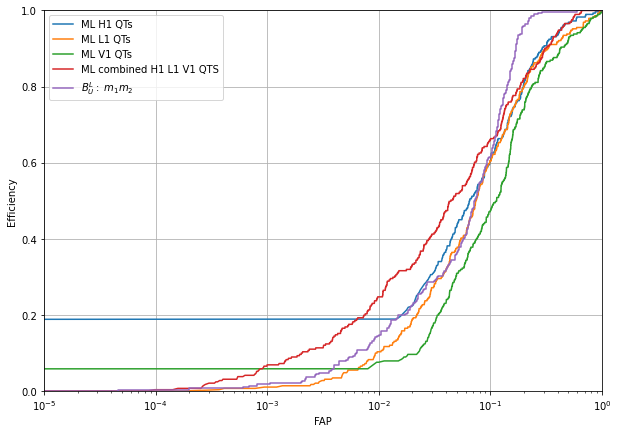

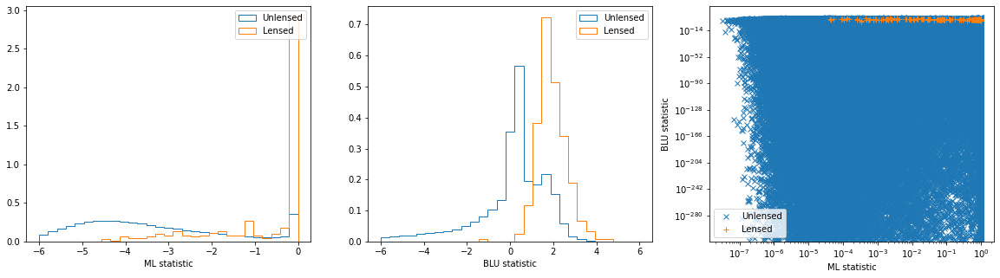

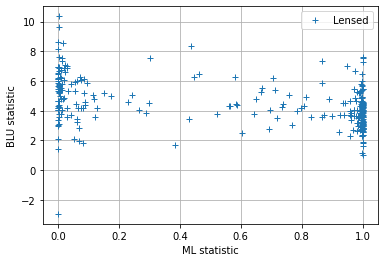

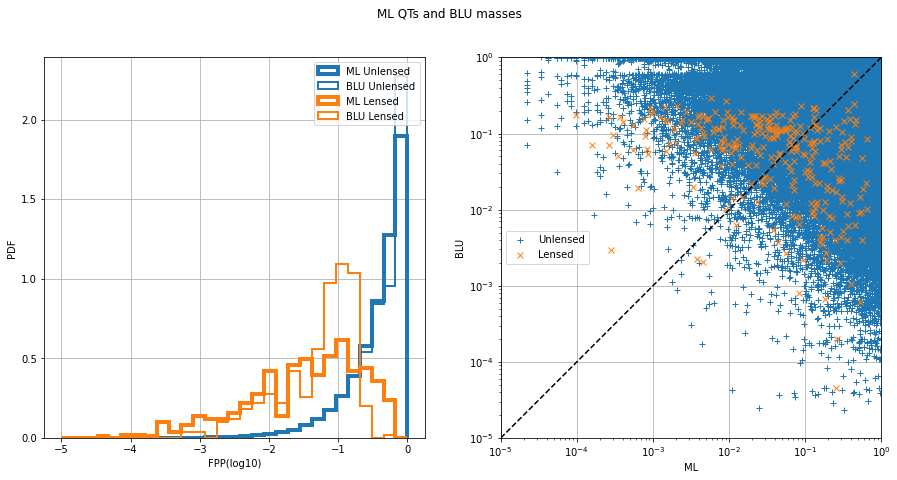

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8926391529535962, 'val_xgb_dense_QTS_0_roc': 0.9585508964135908, 'test_xgb_dense_QTS_0_acc': 0.9195442085675984, 'val_xgb_dense_QTS_0_acc': 0.9840205814910395, 'test_xgb_dense_QTS_0_f1': 0.008971041281577326, 'val_xgb_dense_QTS_0_f1': 0.2125984251968504}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9580


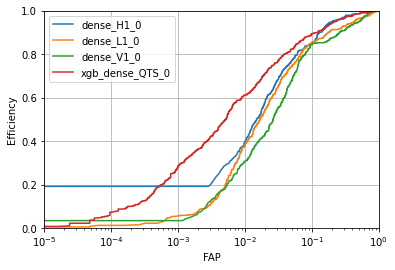

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8912
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

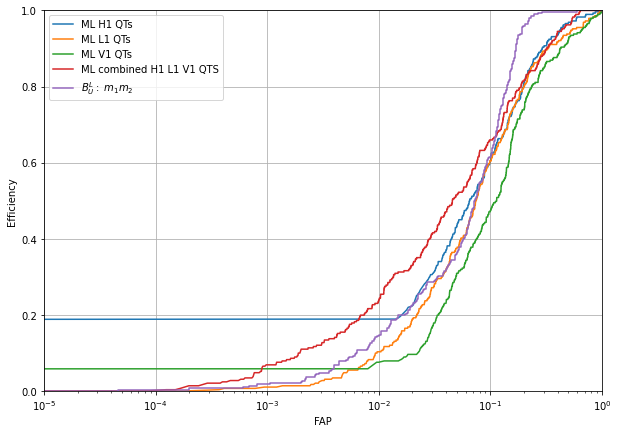

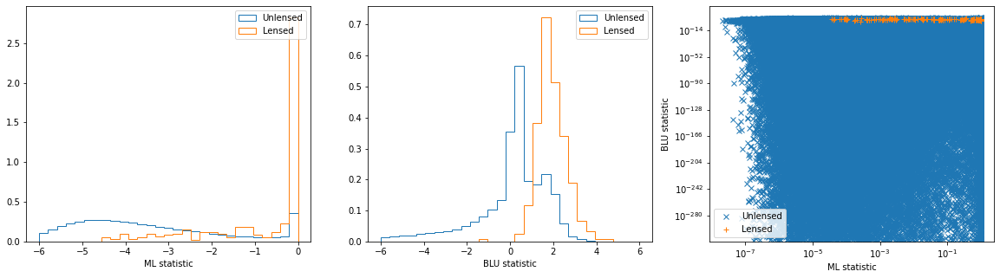

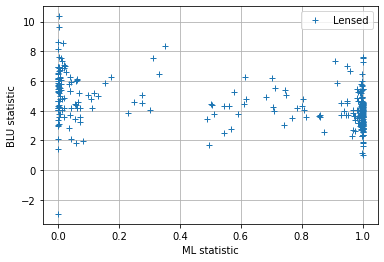

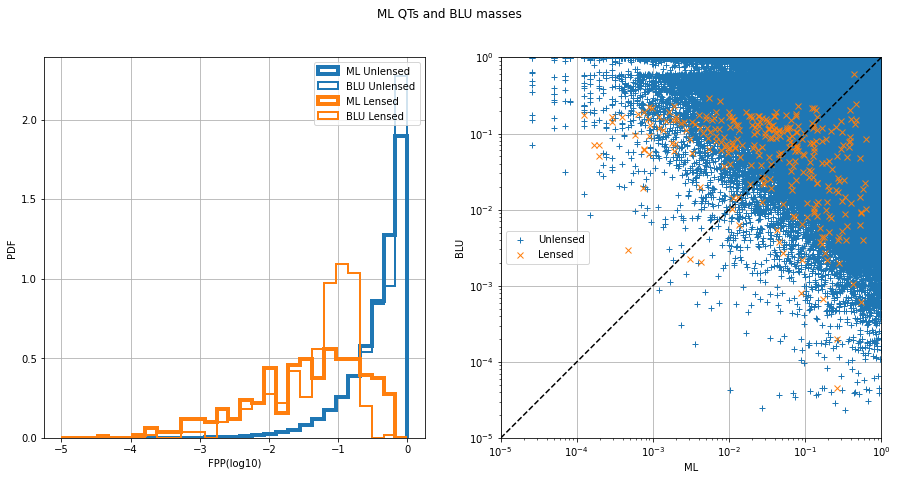

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8912203636290986, 'val_xgb_dense_QTS_0_roc': 0.9579851098286915, 'test_xgb_dense_QTS_0_acc': 0.9202244942876008, 'val_xgb_dense_QTS_0_acc': 0.9842842418964374, 'test_xgb_dense_QTS_0_f1': 0.009046849757673666, 'val_xgb_dense_QTS_0_f1': 0.21602231964926266}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9586


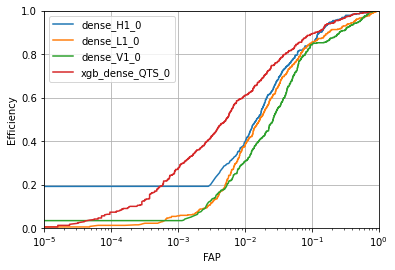

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8921
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

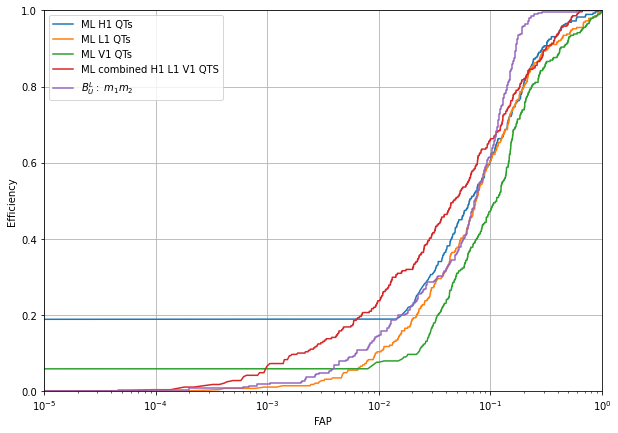

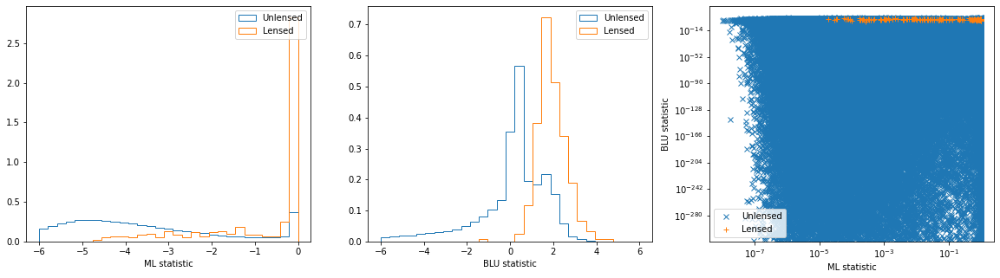

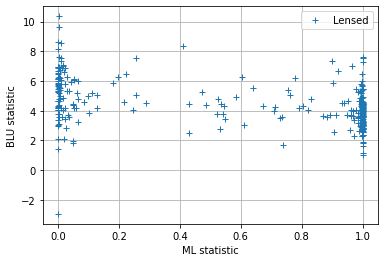

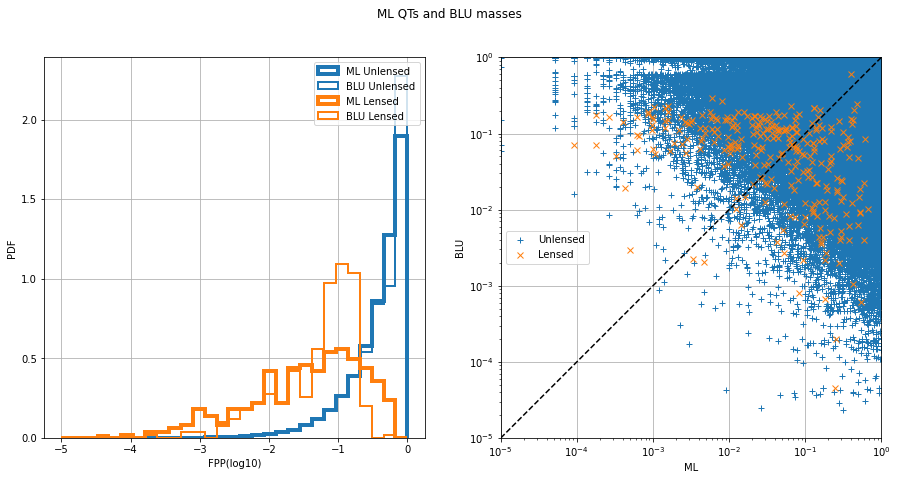

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8921048340609111, 'val_xgb_dense_QTS_0_roc': 0.958638937277315, 'test_xgb_dense_QTS_0_acc': 0.9212089077412513, 'val_xgb_dense_QTS_0_acc': 0.9846677479406525, 'test_xgb_dense_QTS_0_f1': 0.009059110697299881, 'val_xgb_dense_QTS_0_f1': 0.21960146400976008}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9587


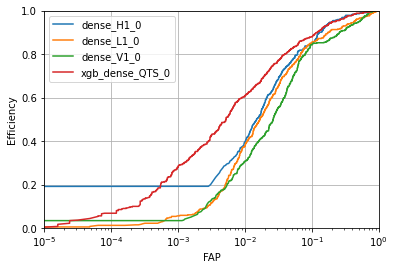

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8926
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

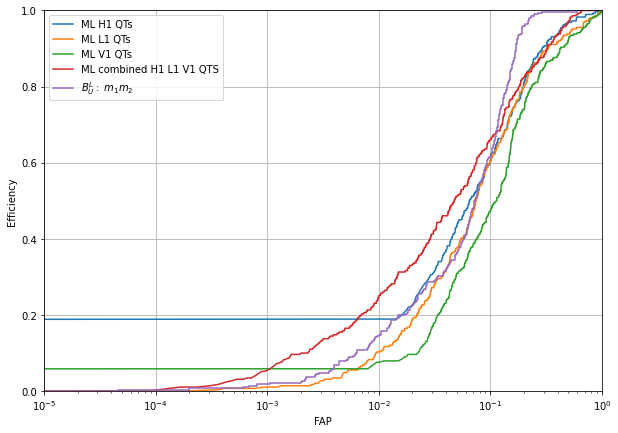

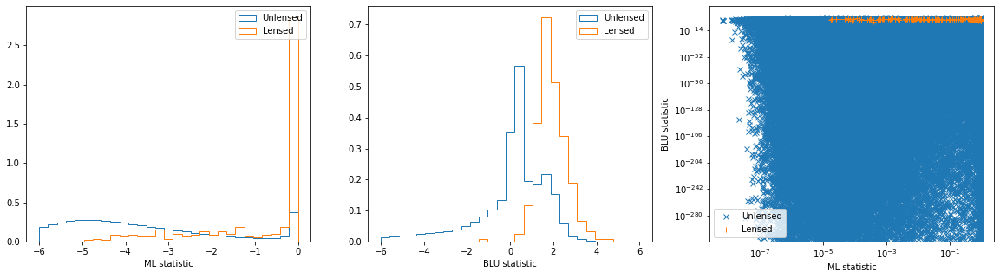

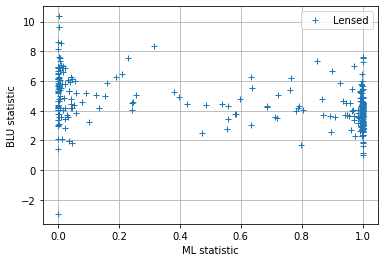

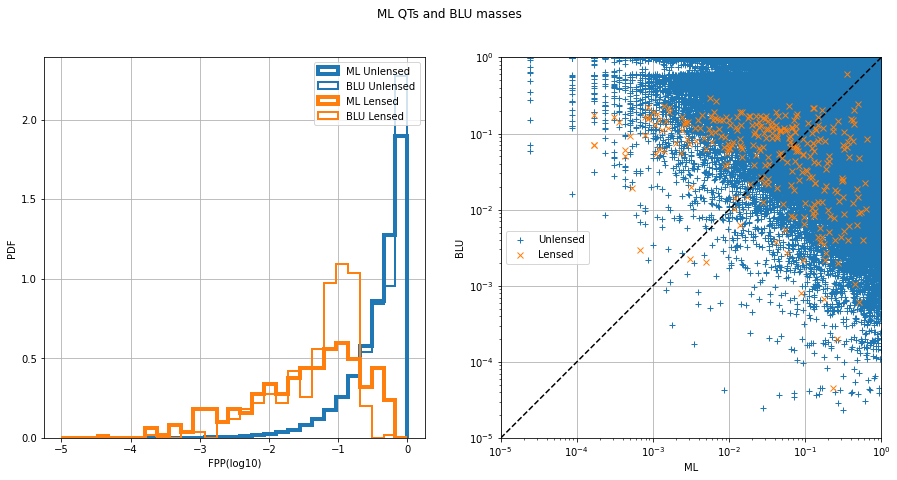

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8925608545673418, 'val_xgb_dense_QTS_0_roc': 0.9586768094411249, 'test_xgb_dense_QTS_0_acc': 0.9217691430400768, 'val_xgb_dense_QTS_0_acc': 0.9847236759054337, 'test_xgb_dense_QTS_0_f1': 0.00907316825911752, 'val_xgb_dense_QTS_0_f1': 0.21895424836601304}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9582


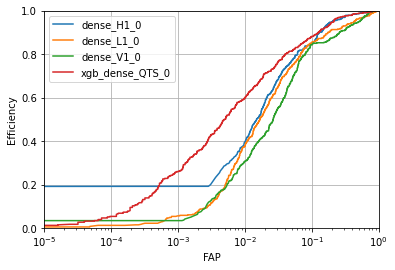

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8922
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

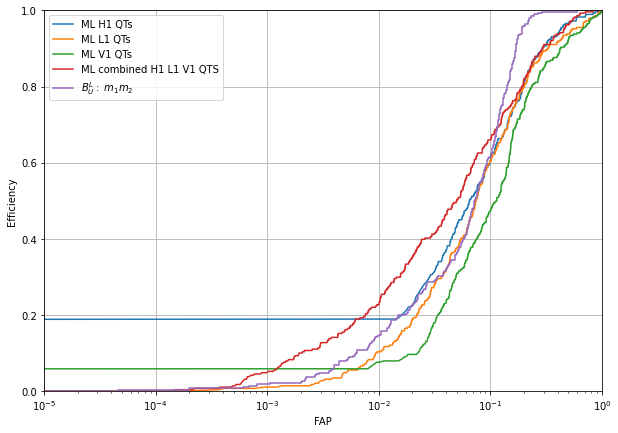

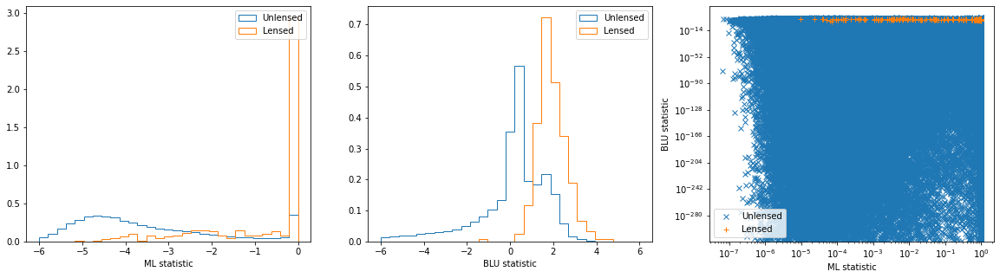

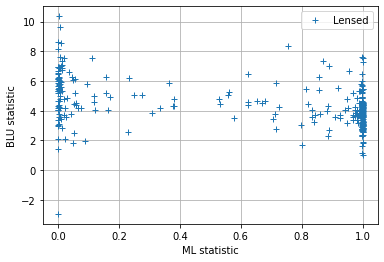

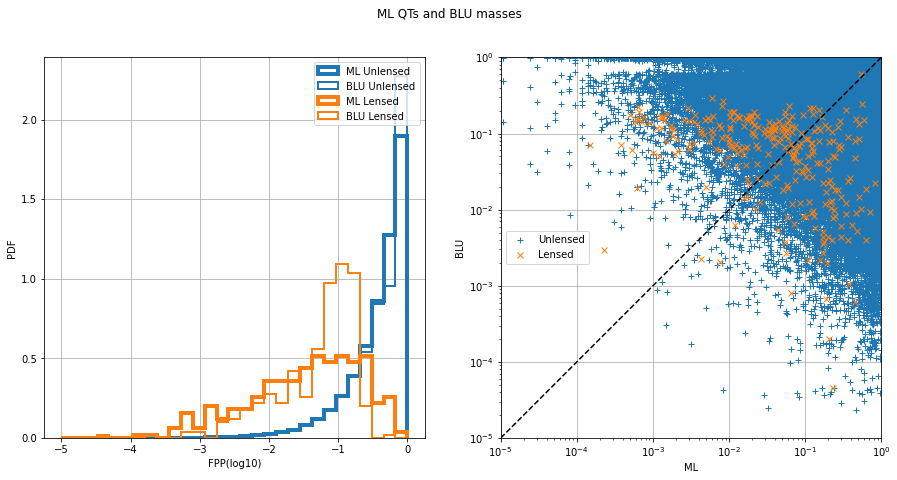

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8921739135878755, 'val_xgb_dense_QTS_0_roc': 0.9582392025711901, 'test_xgb_dense_QTS_0_acc': 0.9221132875807839, 'val_xgb_dense_QTS_0_acc': 0.9842842418964374, 'test_xgb_dense_QTS_0_f1': 0.009264208088366293, 'val_xgb_dense_QTS_0_f1': 0.2153968887116075}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9584


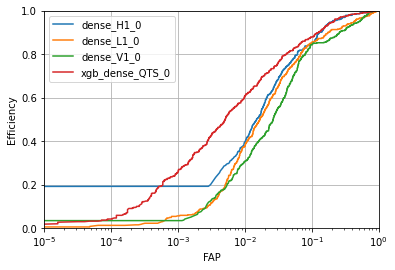

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8914
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

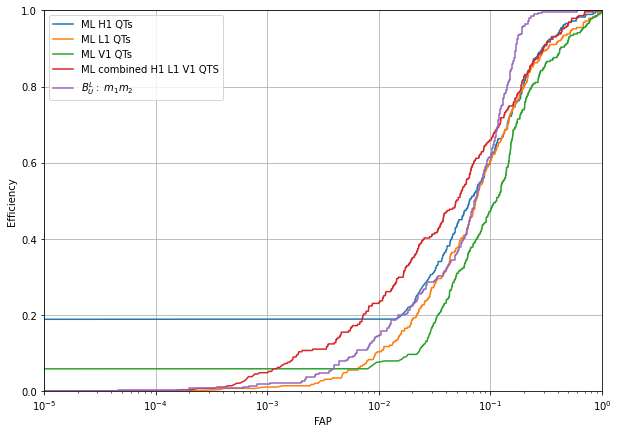

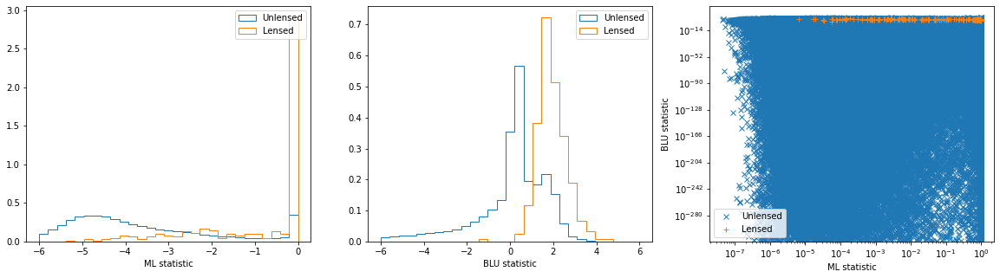

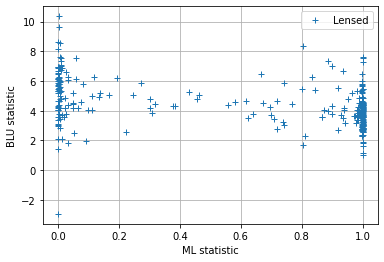

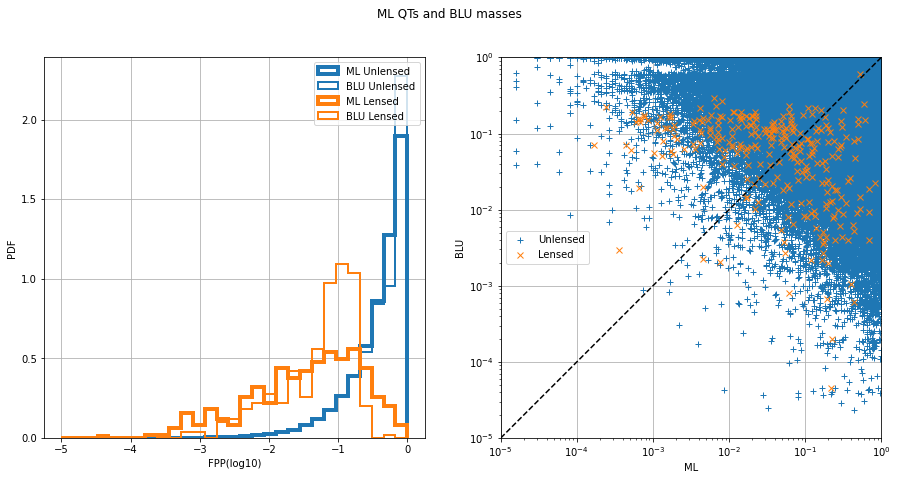

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8914020336349531, 'val_xgb_dense_QTS_0_roc': 0.9584011685756261, 'test_xgb_dense_QTS_0_acc': 0.9229796514536105, 'val_xgb_dense_QTS_0_acc': 0.9844680052092905, 'test_xgb_dense_QTS_0_f1': 0.009163449163449165, 'val_xgb_dense_QTS_0_f1': 0.21676067687348916}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9583


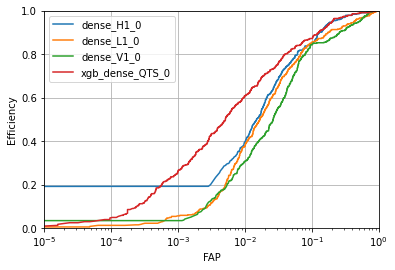

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8902
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

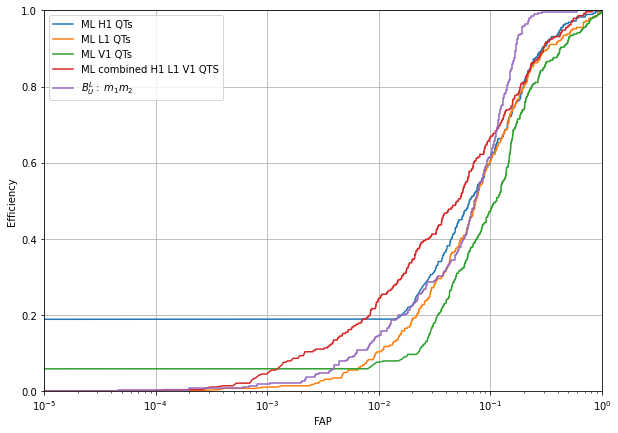

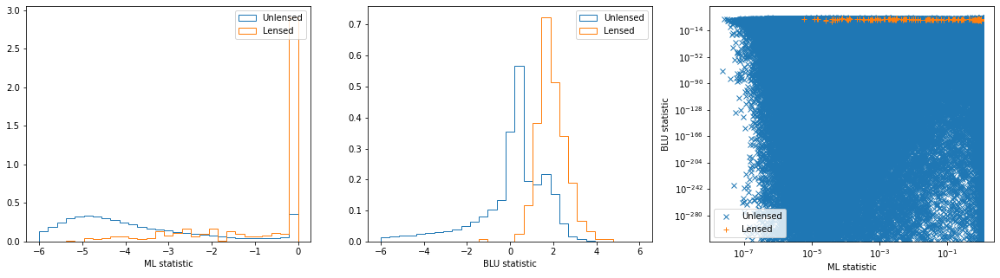

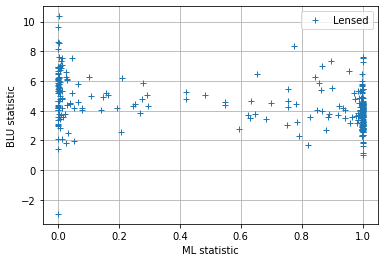

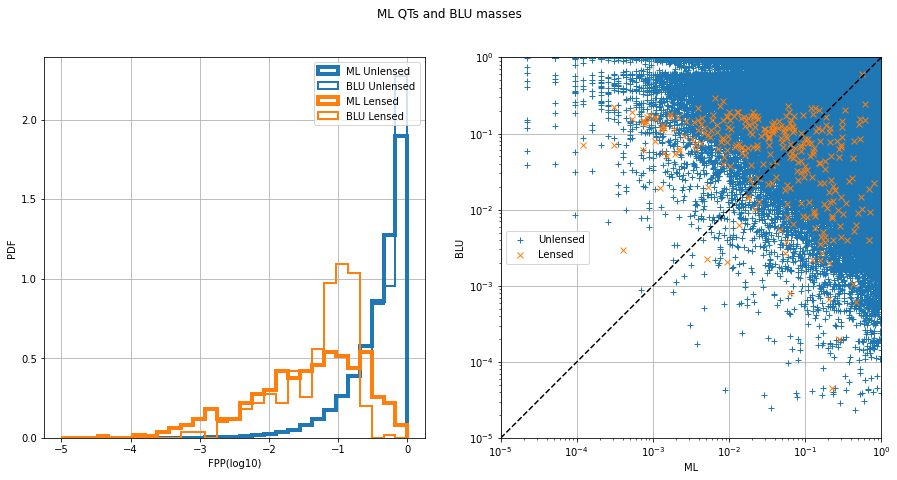

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8902356243430143, 'val_xgb_dense_QTS_0_roc': 0.9582522579125291, 'test_xgb_dense_QTS_0_acc': 0.9234338422137298, 'val_xgb_dense_QTS_0_acc': 0.9847076964869248, 'test_xgb_dense_QTS_0_f1': 0.009217305750459572, 'val_xgb_dense_QTS_0_f1': 0.21941272430668843}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9582


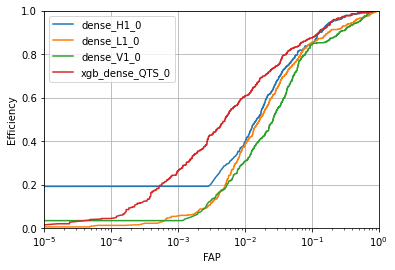

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

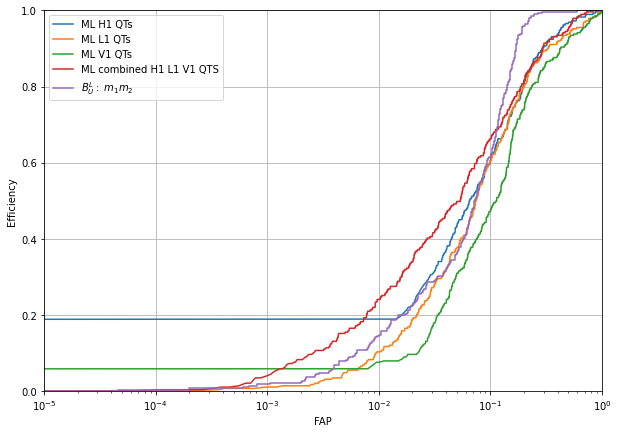

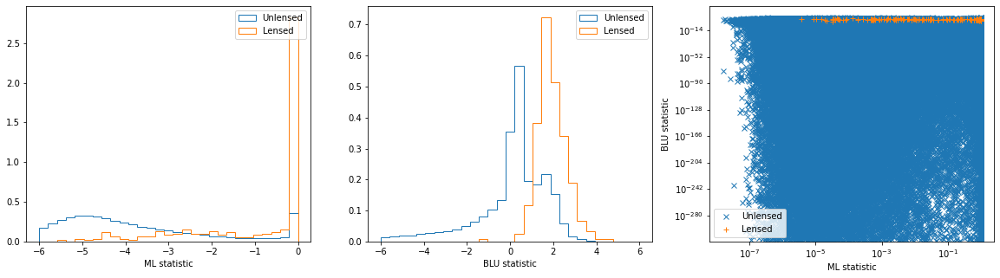

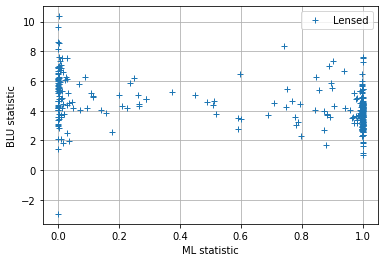

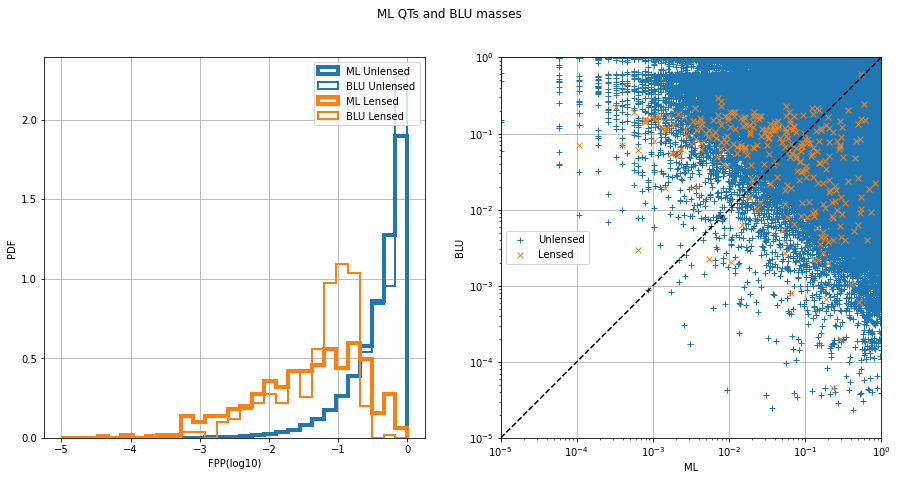

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8894942251035882, 'val_xgb_dense_QTS_0_roc': 0.9582424031727553, 'test_xgb_dense_QTS_0_acc': 0.9237399707877308, 'val_xgb_dense_QTS_0_acc': 0.9848994495090324, 'test_xgb_dense_QTS_0_f1': 0.009202453987730062, 'val_xgb_dense_QTS_0_f1': 0.22093981863149217}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9579


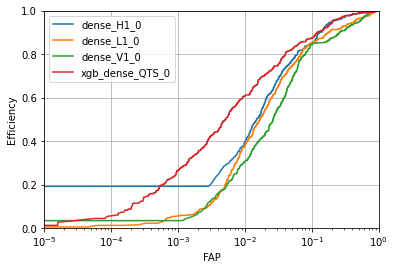

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8895
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

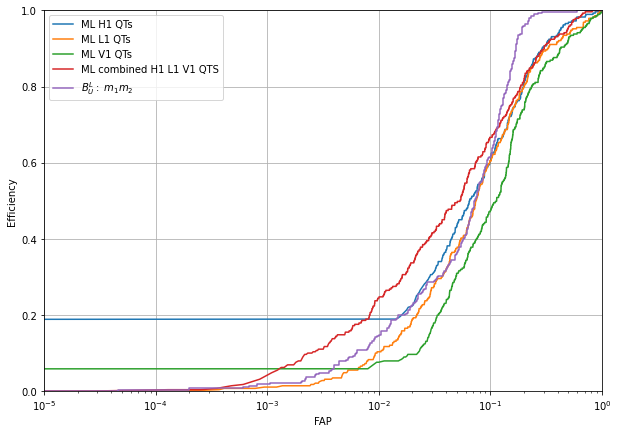

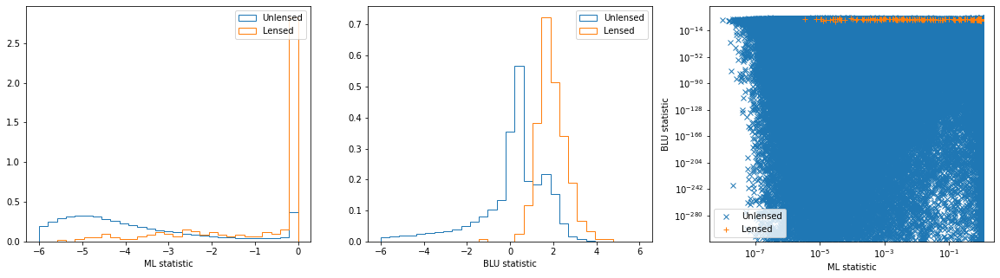

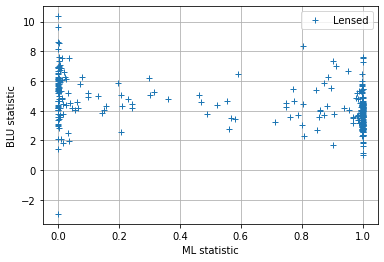

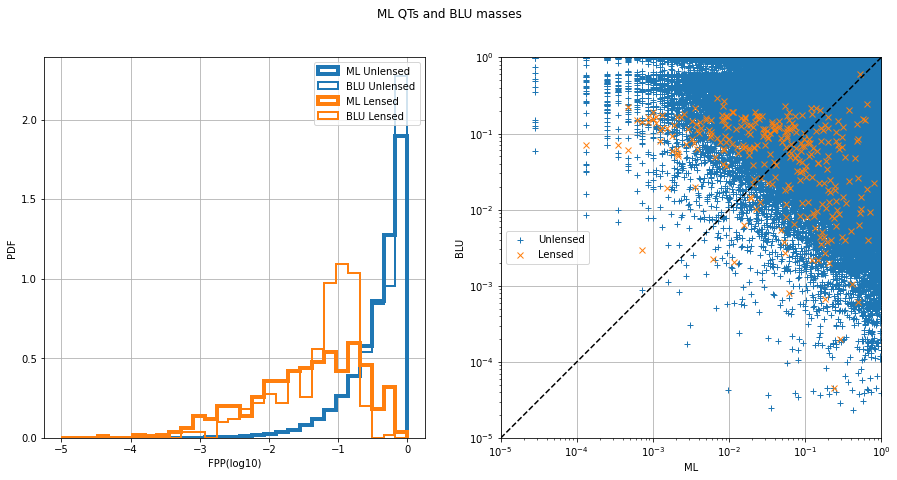

{'scale_pos_weight_xgbqts': 10, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8894794130110124, 'val_xgb_dense_QTS_0_roc': 0.9579018941879955, 'test_xgb_dense_QTS_0_acc': 0.9239680665879669, 'val_xgb_dense_QTS_0_acc': 0.9848994495090324, 'test_xgb_dense_QTS_0_f1': 0.00917813934084272, 'val_xgb_dense_QTS_0_f1': 0.2215815485996705}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9603


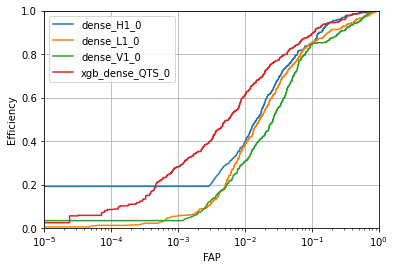

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8965
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

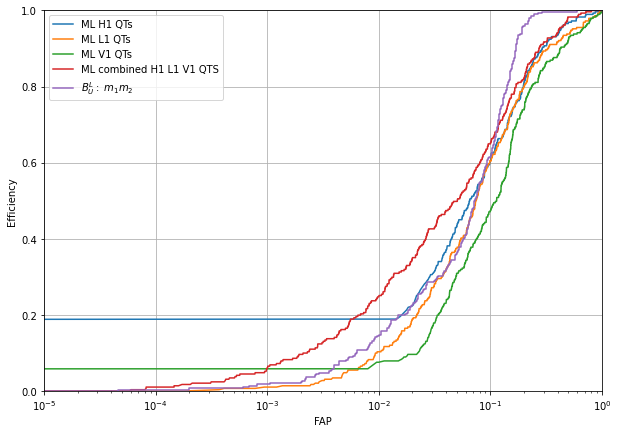

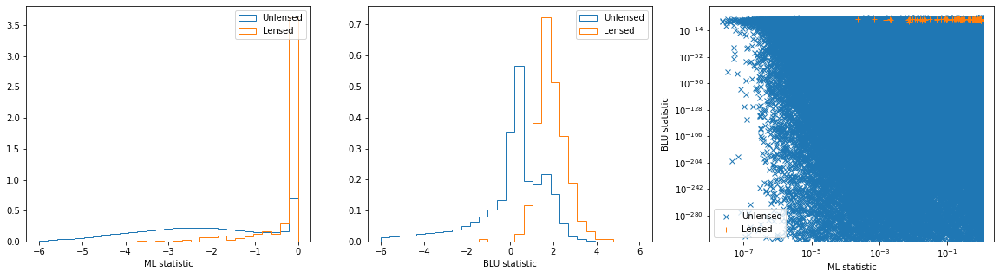

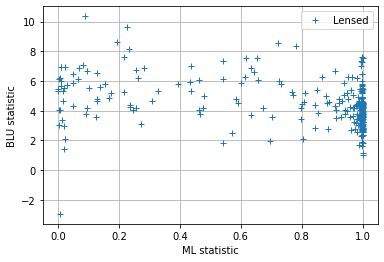

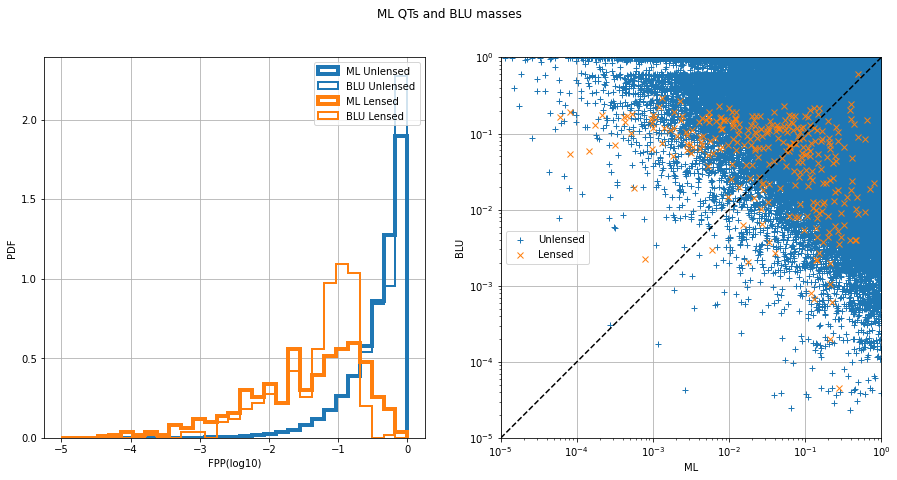

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8964536417380249, 'val_xgb_dense_QTS_0_roc': 0.9603316371896127, 'test_xgb_dense_QTS_0_acc': 0.8402288961363773, 'val_xgb_dense_QTS_0_acc': 0.9473797748499933, 'test_xgb_dense_QTS_0_f1': 0.0056533758374218614, 'val_xgb_dense_QTS_0_f1': 0.09383599339570721}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9592


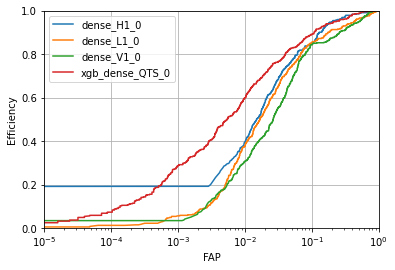

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8947
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

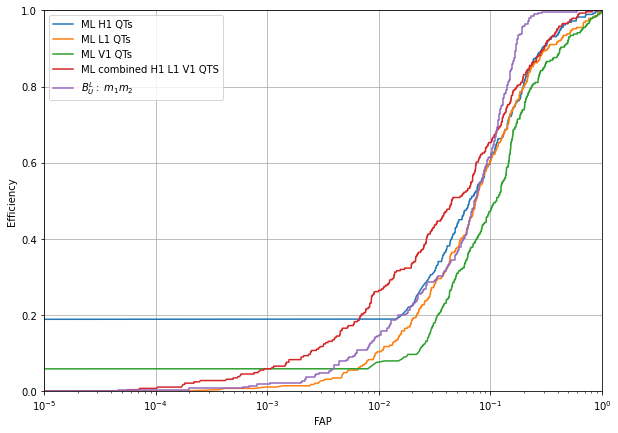

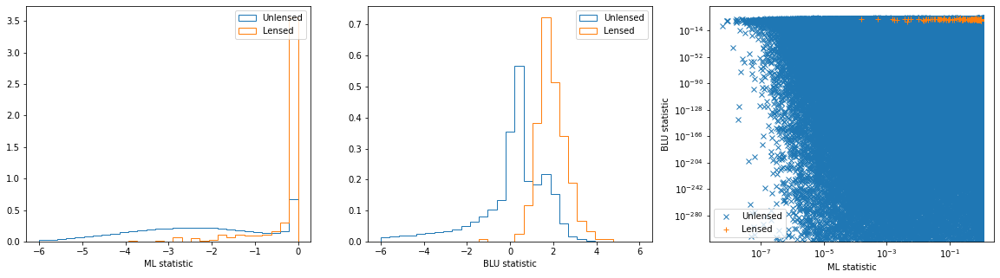

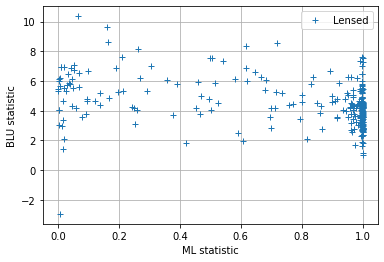

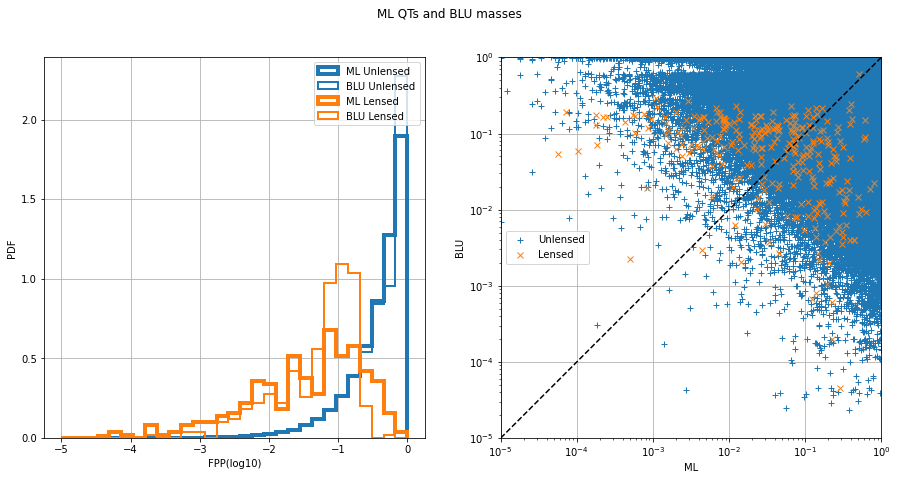

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8946727301168141, 'val_xgb_dense_QTS_0_roc': 0.9592035953826351, 'test_xgb_dense_QTS_0_acc': 0.8464995298025171, 'val_xgb_dense_QTS_0_acc': 0.9515504030808319, 'test_xgb_dense_QTS_0_f1': 0.0058056657076950985, 'val_xgb_dense_QTS_0_f1': 0.10083036773428232}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9575


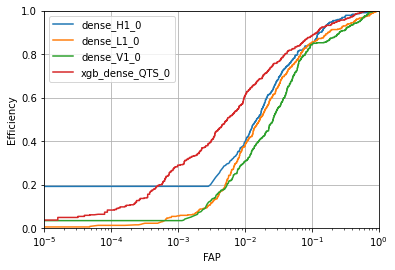

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8939
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

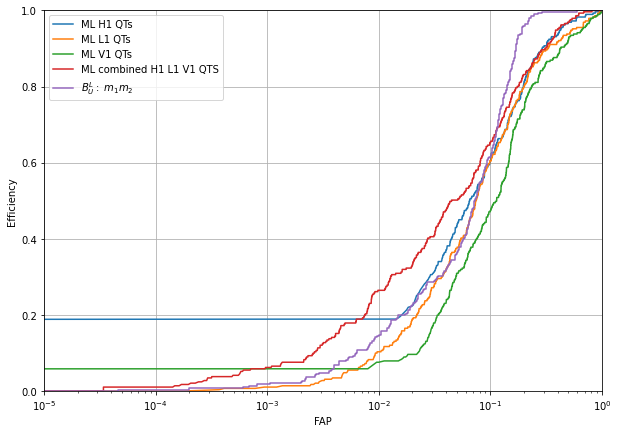

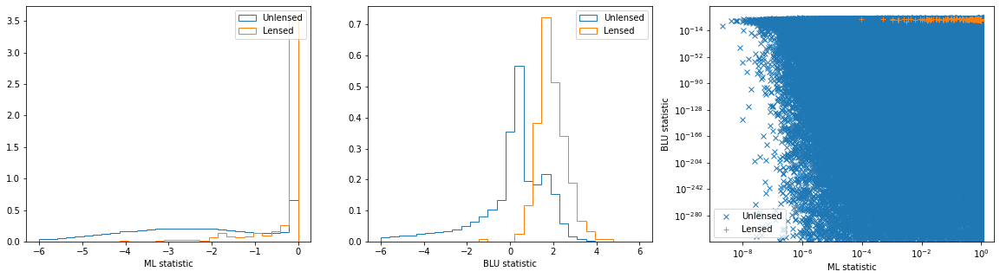

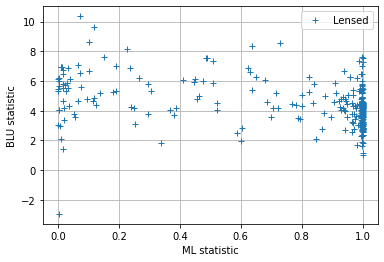

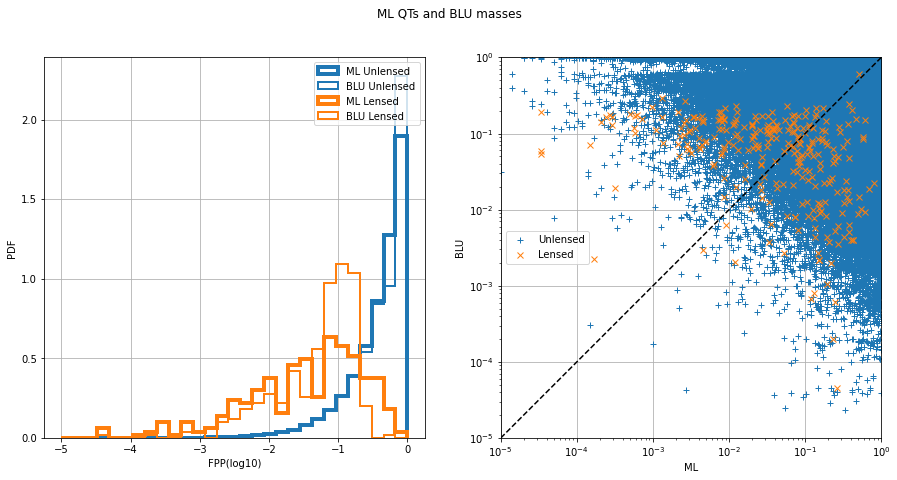

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8939372852973251, 'val_xgb_dense_QTS_0_roc': 0.9574830045138405, 'test_xgb_dense_QTS_0_acc': 0.8501070449588828, 'val_xgb_dense_QTS_0_acc': 0.9536676760332692, 'test_xgb_dense_QTS_0_f1': 0.005865413962870072, 'val_xgb_dense_QTS_0_f1': 0.1041248262011432}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9564


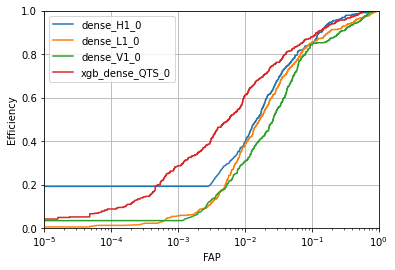

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8931
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

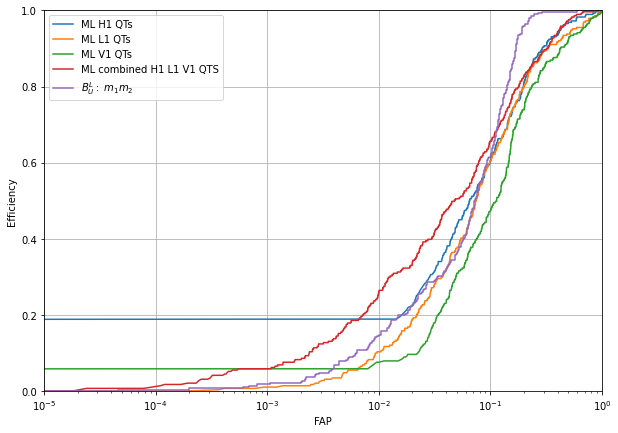

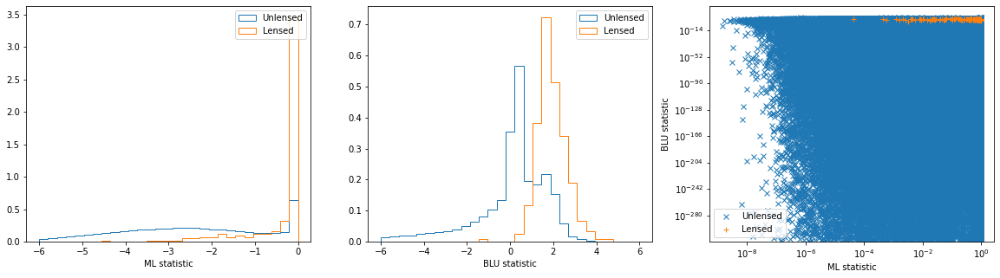

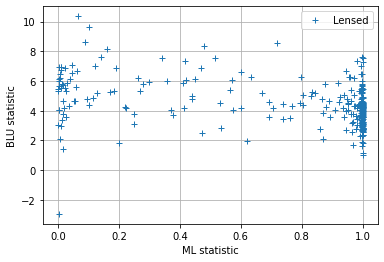

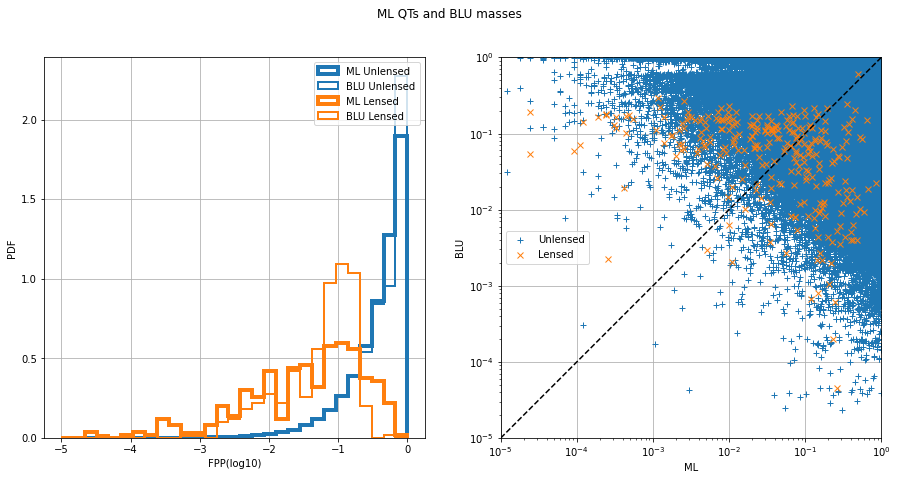

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8930970309913764, 'val_xgb_dense_QTS_0_roc': 0.9563951015581035, 'test_xgb_dense_QTS_0_acc': 0.8548790492006643, 'val_xgb_dense_QTS_0_acc': 0.9570153642108964, 'test_xgb_dense_QTS_0_f1': 0.005948138808179376, 'val_xgb_dense_QTS_0_f1': 0.11044973544973546}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9555


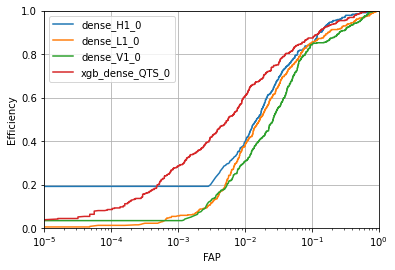

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8922
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

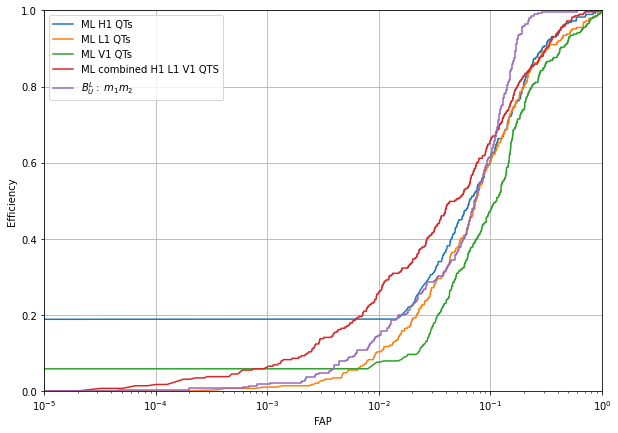

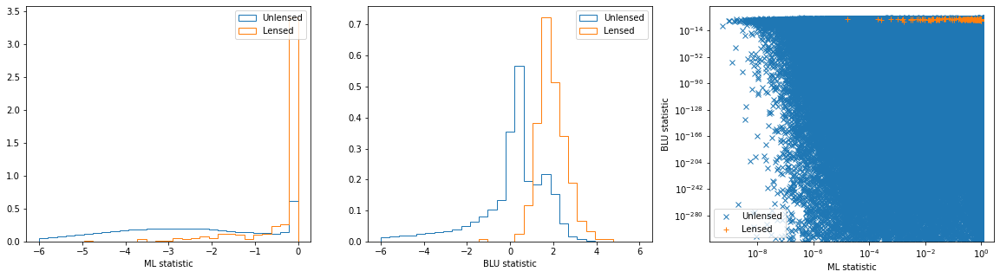

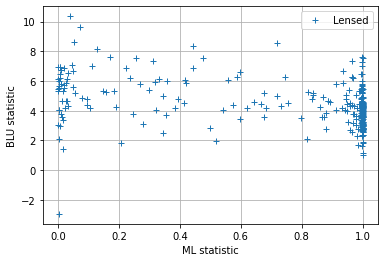

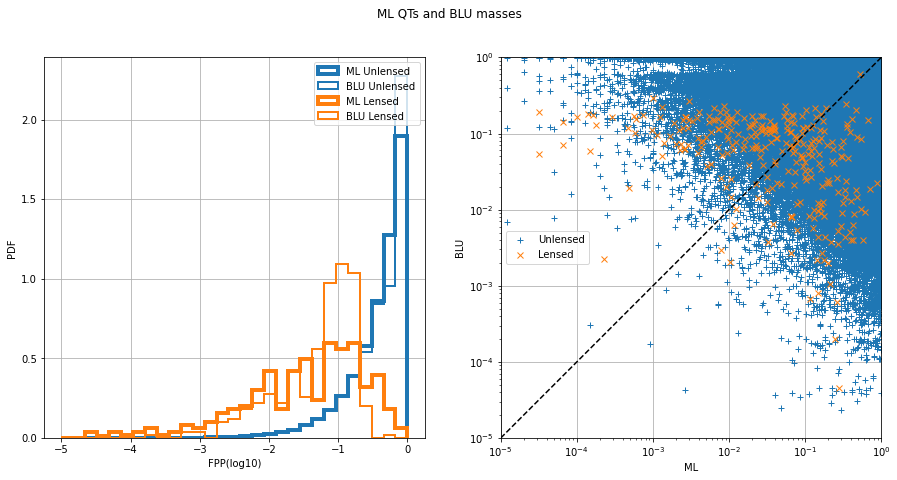

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 4, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8921924166640404, 'val_xgb_dense_QTS_0_roc': 0.9554827063617531, 'test_xgb_dense_QTS_0_acc': 0.8608415534524501, 'val_xgb_dense_QTS_0_acc': 0.9600434640183444, 'test_xgb_dense_QTS_0_f1': 0.006087801531953812, 'val_xgb_dense_QTS_0_f1': 0.11596252430616937}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9608


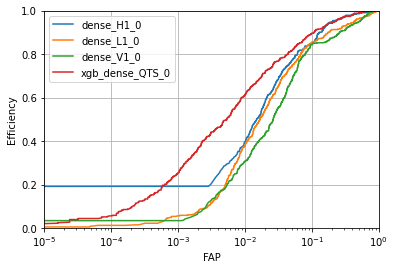

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8957
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

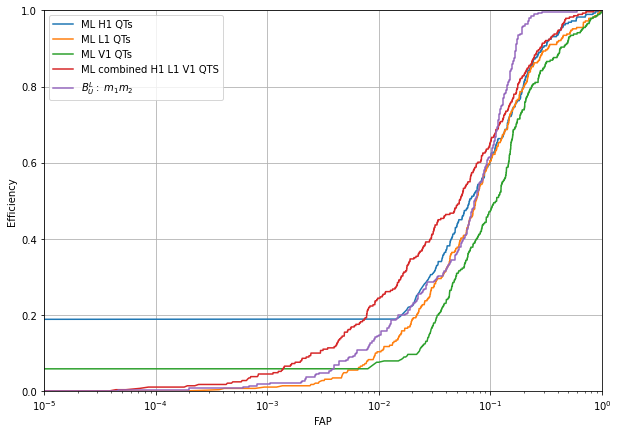

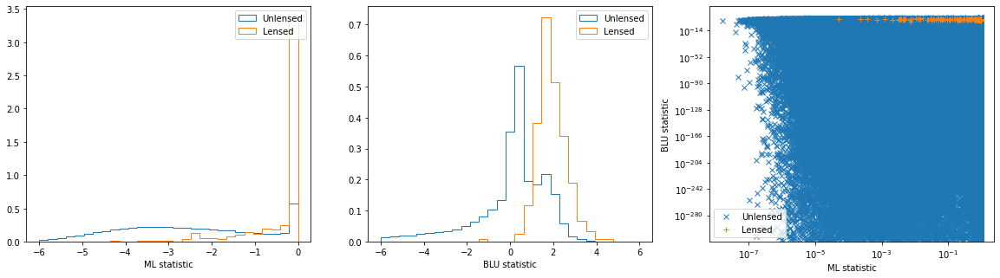

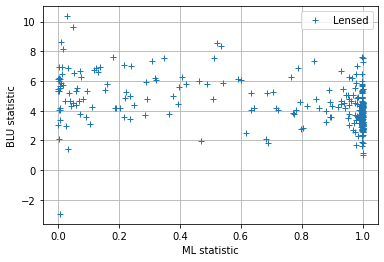

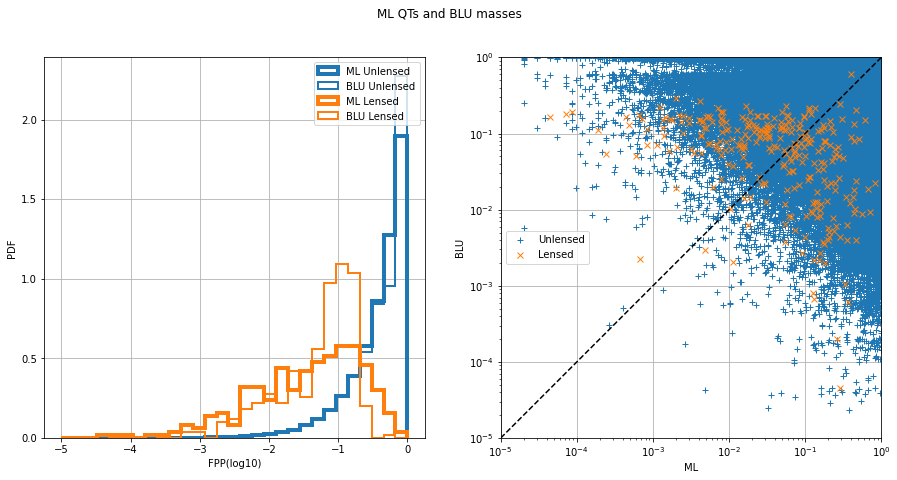

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8956549789349411, 'val_xgb_dense_QTS_0_roc': 0.9607562276312973, 'test_xgb_dense_QTS_0_acc': 0.867144200564237, 'val_xgb_dense_QTS_0_acc': 0.9630555844072834, 'test_xgb_dense_QTS_0_f1': 0.006315285385052827, 'val_xgb_dense_QTS_0_f1': 0.12258064516129032}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9596


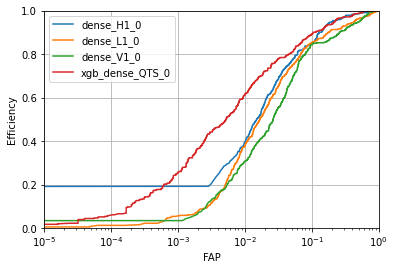

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8958
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

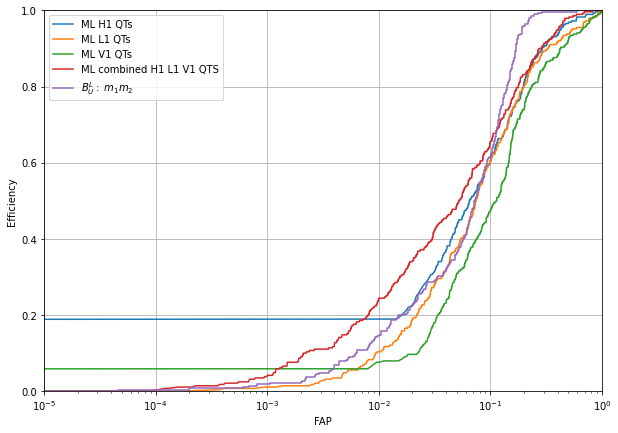

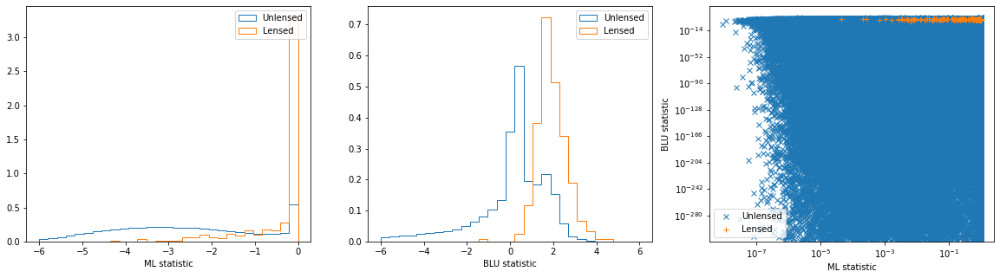

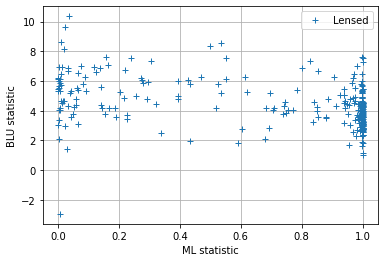

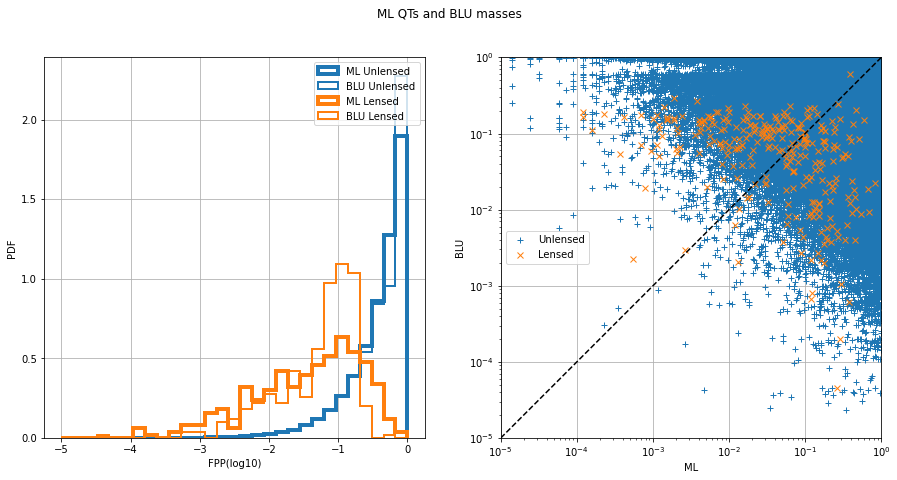

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8957985626683849, 'val_xgb_dense_QTS_0_roc': 0.9596480801410396, 'test_xgb_dense_QTS_0_acc': 0.875335640969207, 'val_xgb_dense_QTS_0_acc': 0.9667148712458353, 'test_xgb_dense_QTS_0_f1': 0.006600765306122449, 'val_xgb_dense_QTS_0_f1': 0.1338877338877339}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9593


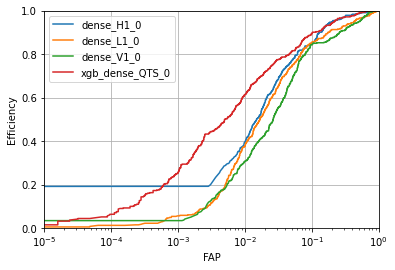

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8948
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

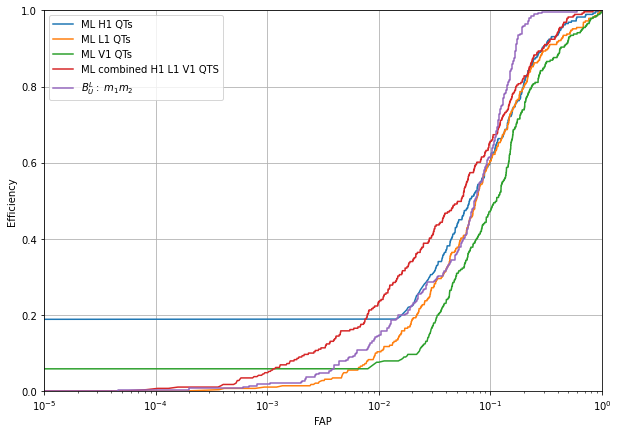

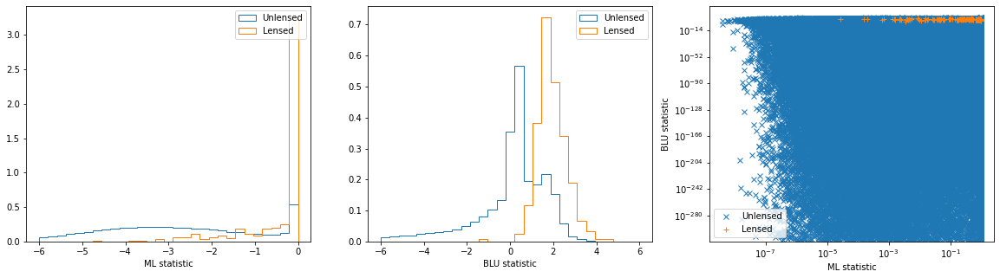

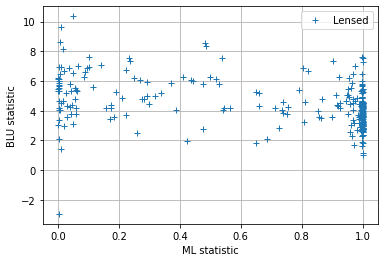

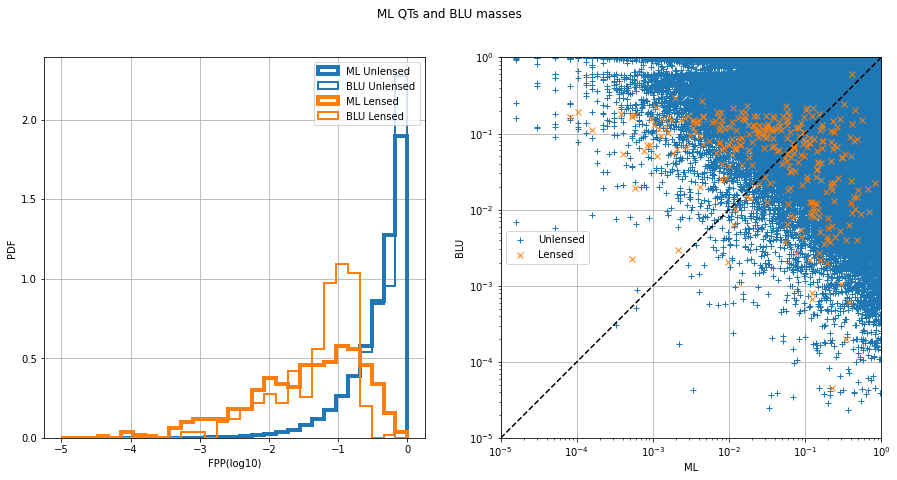

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8948452535007088, 'val_xgb_dense_QTS_0_roc': 0.959282919714437, 'test_xgb_dense_QTS_0_acc': 0.8797254847035755, 'val_xgb_dense_QTS_0_acc': 0.9687202882687099, 'test_xgb_dense_QTS_0_f1': 0.006675920417740763, 'val_xgb_dense_QTS_0_f1': 0.14012738853503187}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9580


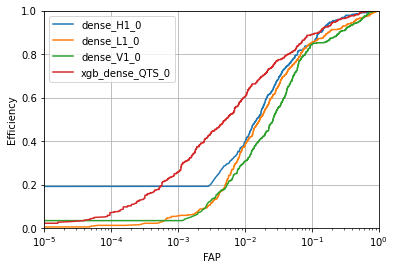

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8948
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

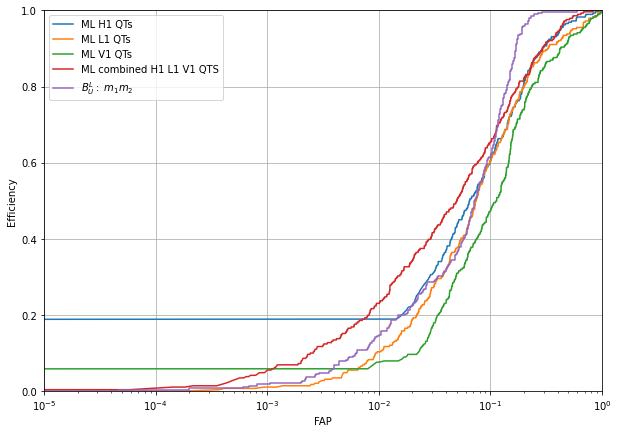

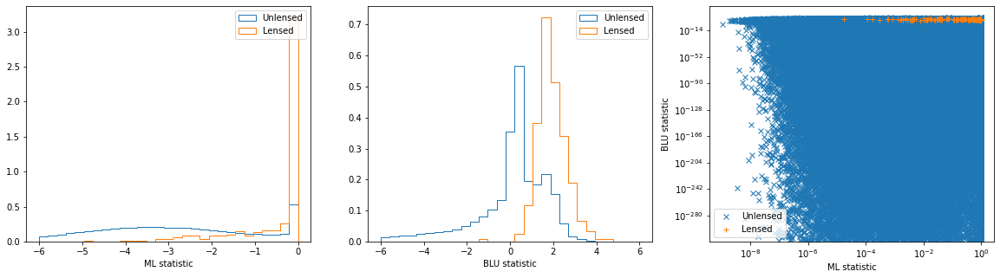

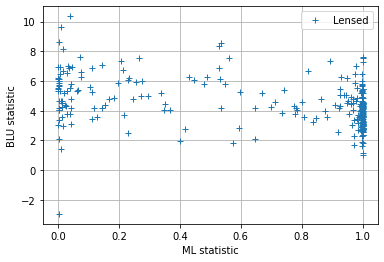

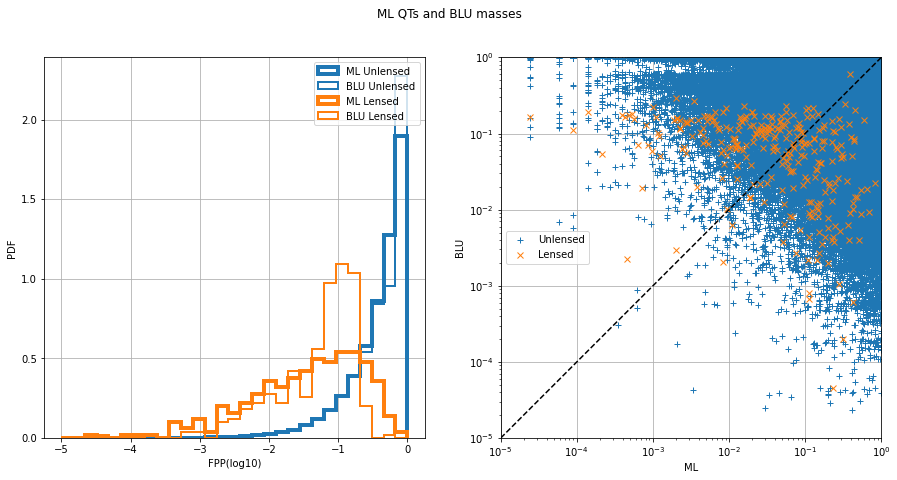

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8947750904137906, 'val_xgb_dense_QTS_0_roc': 0.9579544171297907, 'test_xgb_dense_QTS_0_acc': 0.8837331679305308, 'val_xgb_dense_QTS_0_acc': 0.9705818905250038, 'test_xgb_dense_QTS_0_f1': 0.006938391865333675, 'val_xgb_dense_QTS_0_f1': 0.1461038961038961}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9569


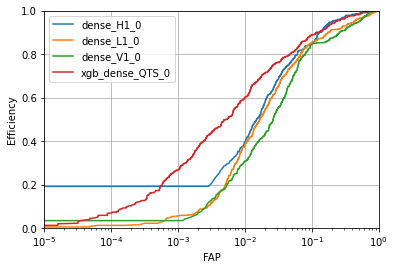

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8938
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

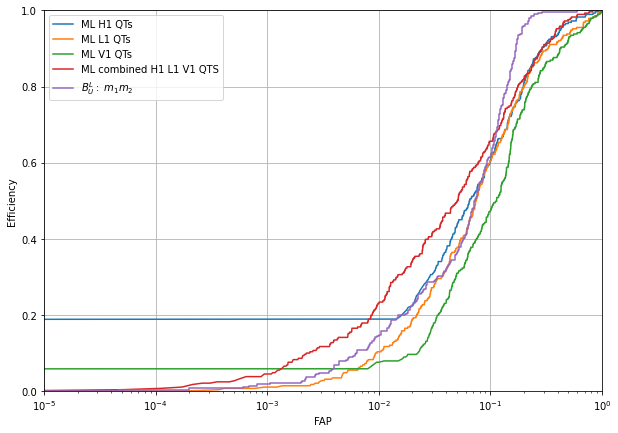

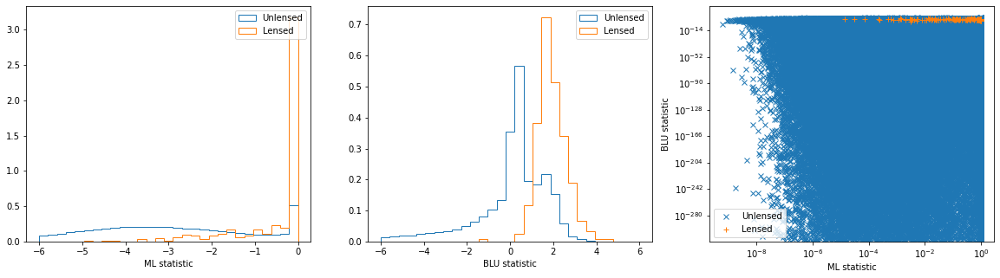

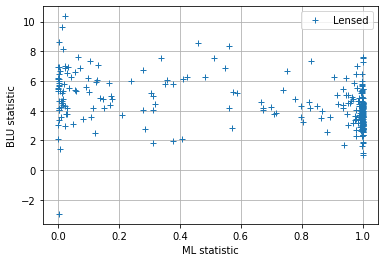

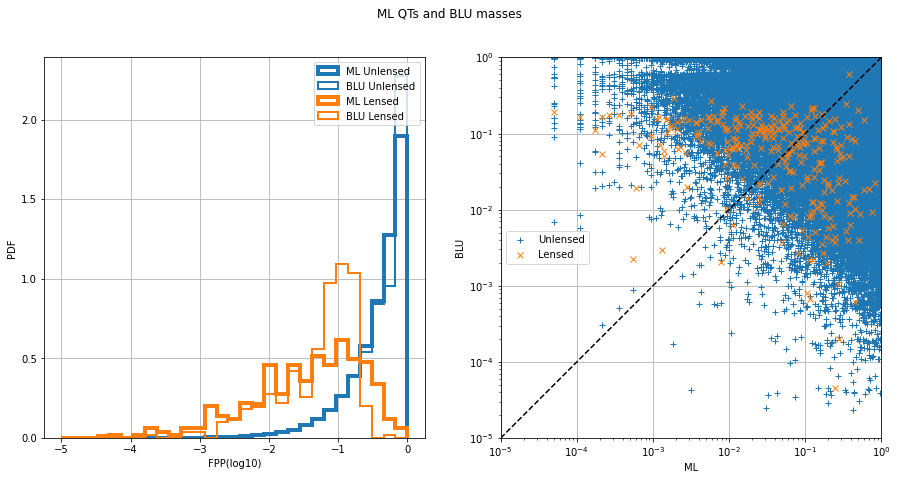

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 5, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8938285199570657, 'val_xgb_dense_QTS_0_roc': 0.9568510364929282, 'test_xgb_dense_QTS_0_acc': 0.8877528561996039, 'val_xgb_dense_QTS_0_acc': 0.9726512252219142, 'test_xgb_dense_QTS_0_f1': 0.007009345794392523, 'val_xgb_dense_QTS_0_f1': 0.15335147167944596}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9578


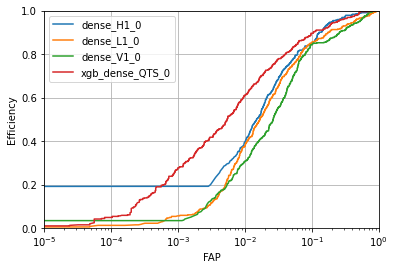

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8943
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

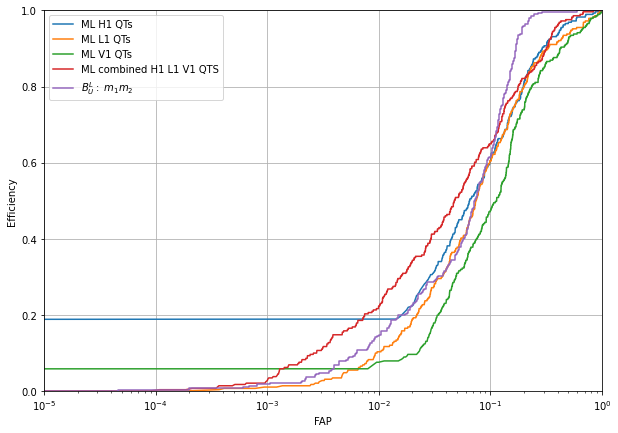

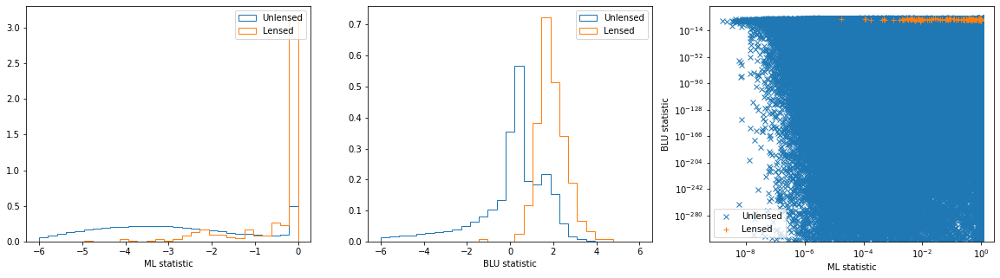

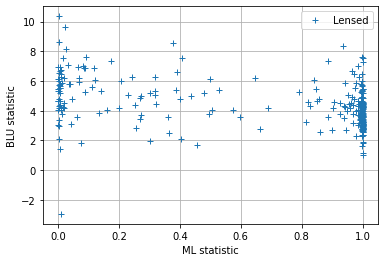

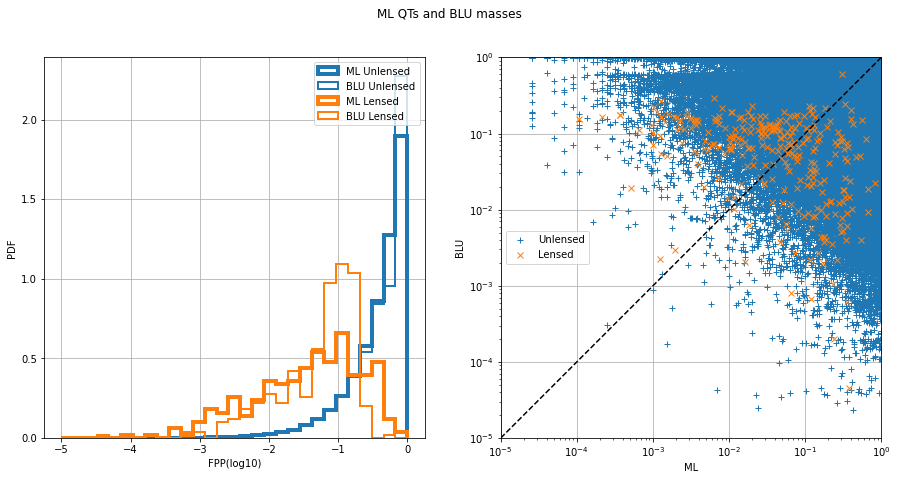

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8942741967657779, 'val_xgb_dense_QTS_0_roc': 0.9577588107599673, 'test_xgb_dense_QTS_0_acc': 0.8908821705116149, 'val_xgb_dense_QTS_0_acc': 0.9736818977157421, 'test_xgb_dense_QTS_0_f1': 0.007028149011325151, 'val_xgb_dense_QTS_0_f1': 0.1571136131013306}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9578


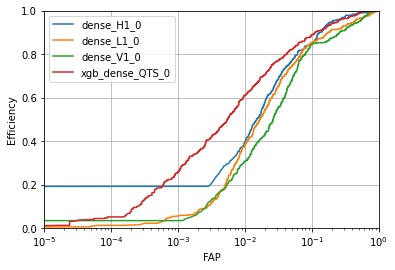

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8937
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

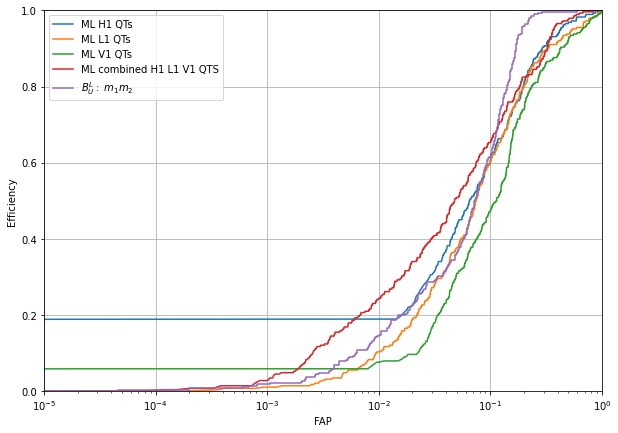

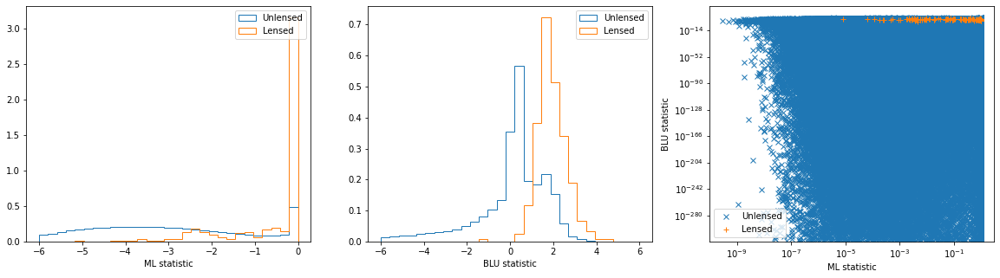

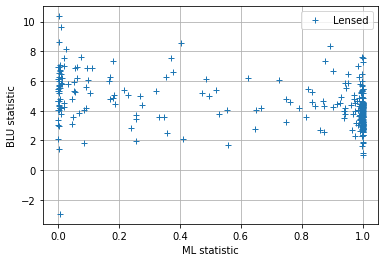

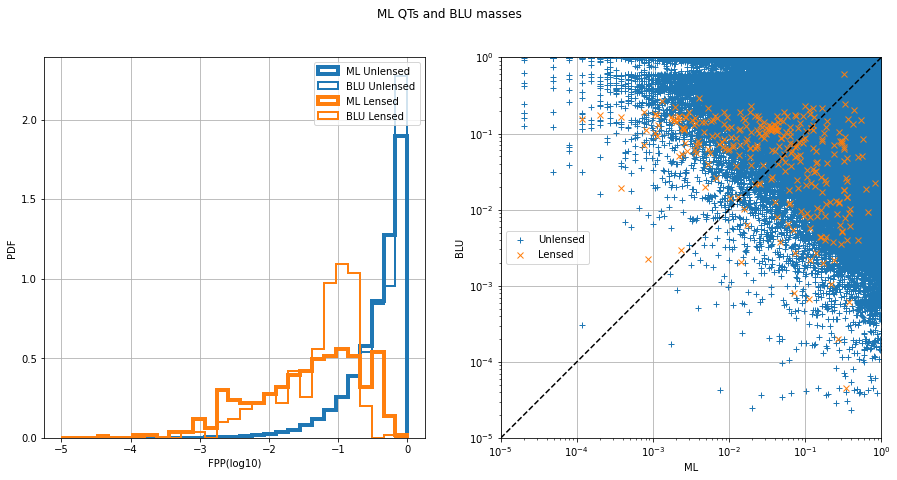

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8937449826444311, 'val_xgb_dense_QTS_0_roc': 0.9577613498390205, 'test_xgb_dense_QTS_0_acc': 0.8950759318913943, 'val_xgb_dense_QTS_0_acc': 0.9752478807296202, 'test_xgb_dense_QTS_0_f1': 0.007344589990156736, 'val_xgb_dense_QTS_0_f1': 0.16360691144708422}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9580


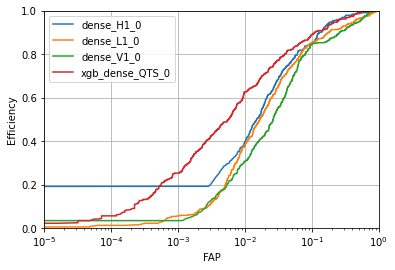

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8928
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

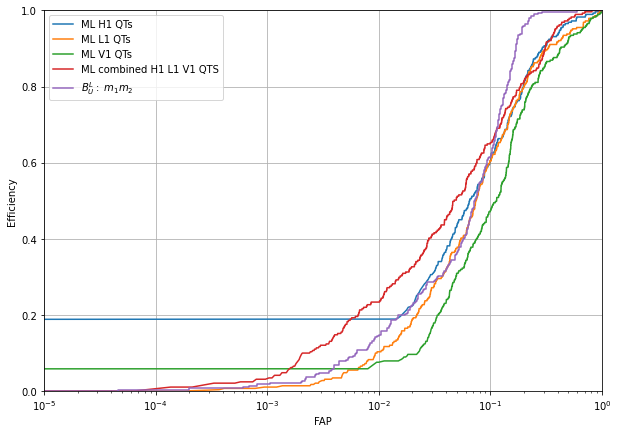

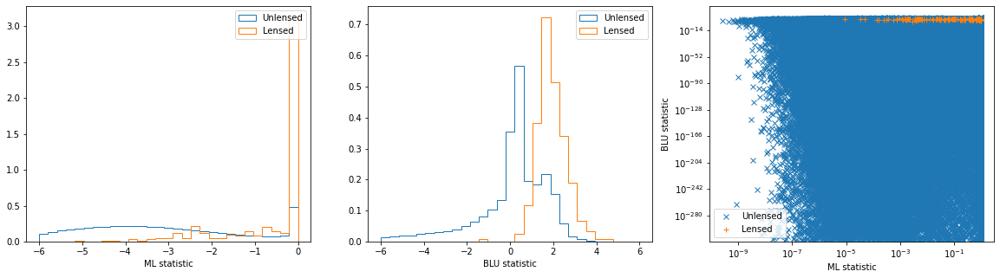

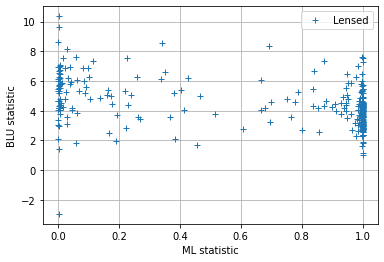

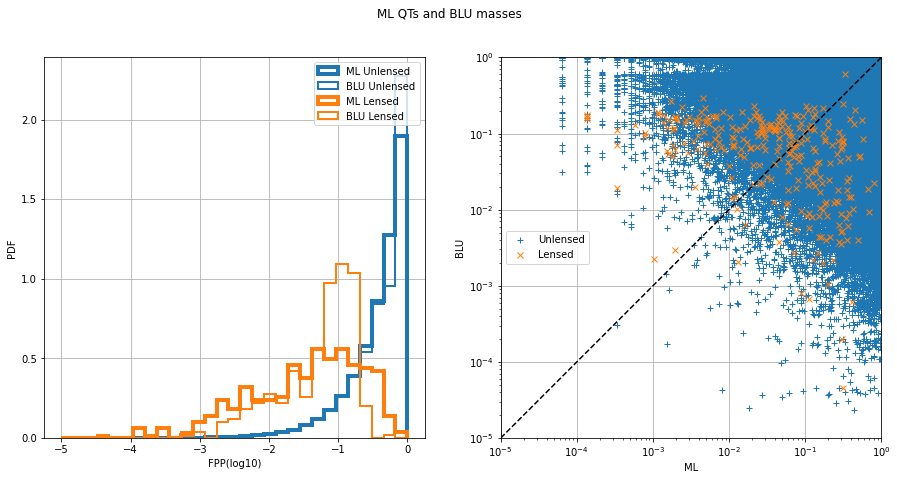

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8928442450538188, 'val_xgb_dense_QTS_0_roc': 0.9579768699821085, 'test_xgb_dense_QTS_0_acc': 0.8990676083955261, 'val_xgb_dense_QTS_0_acc': 0.9768937608360432, 'test_xgb_dense_QTS_0_f1': 0.007476635514018692, 'val_xgb_dense_QTS_0_f1': 0.17087155963302753}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9574


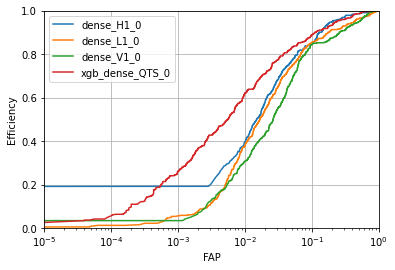

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8921
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

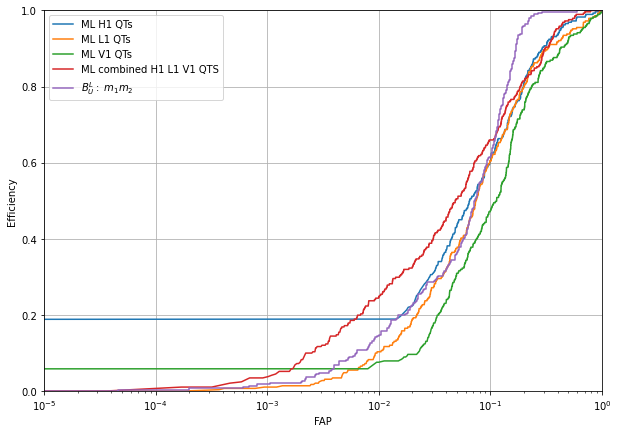

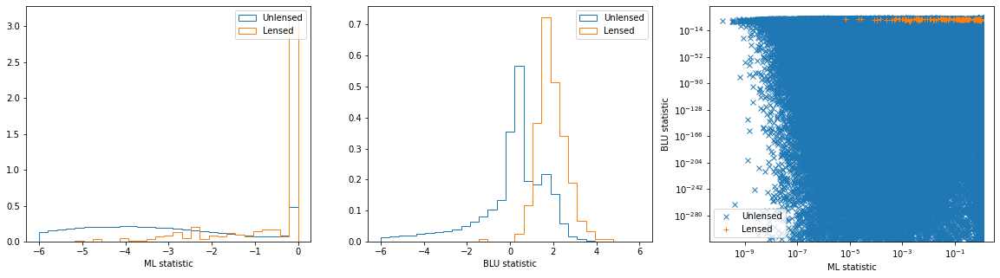

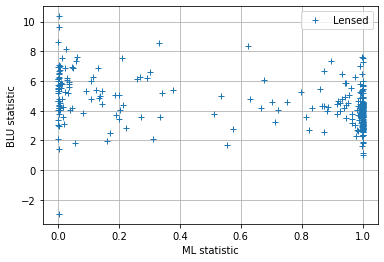

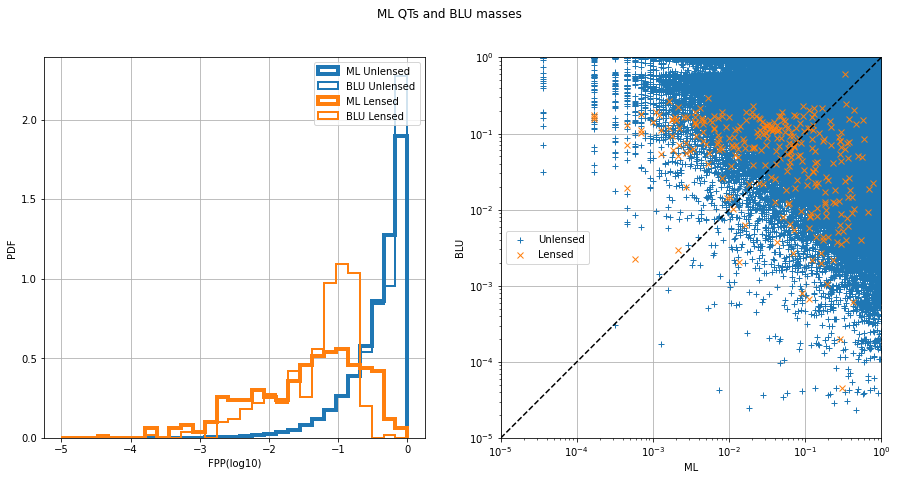

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8920710785884431, 'val_xgb_dense_QTS_0_roc': 0.95742553960975, 'test_xgb_dense_QTS_0_acc': 0.9014225974909462, 'val_xgb_dense_QTS_0_acc': 0.9779484024576346, 'test_xgb_dense_QTS_0_f1': 0.007733827438975267, 'val_xgb_dense_QTS_0_f1': 0.1771019677996422}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9568


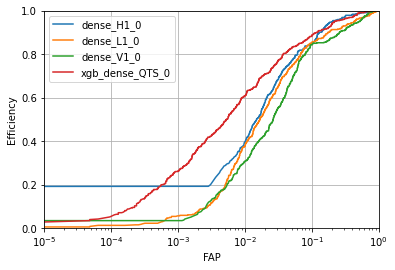

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8913
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

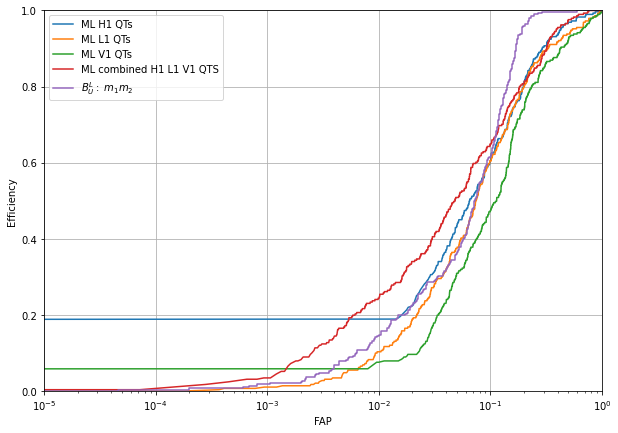

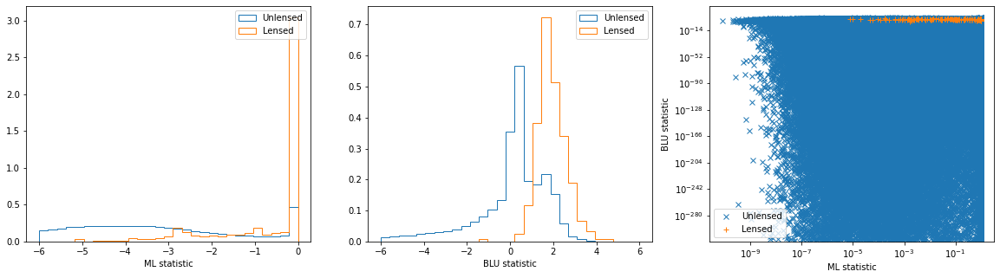

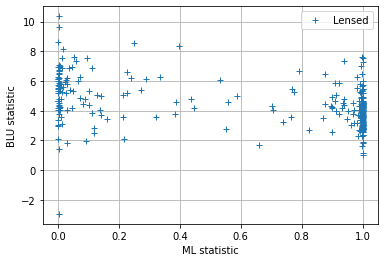

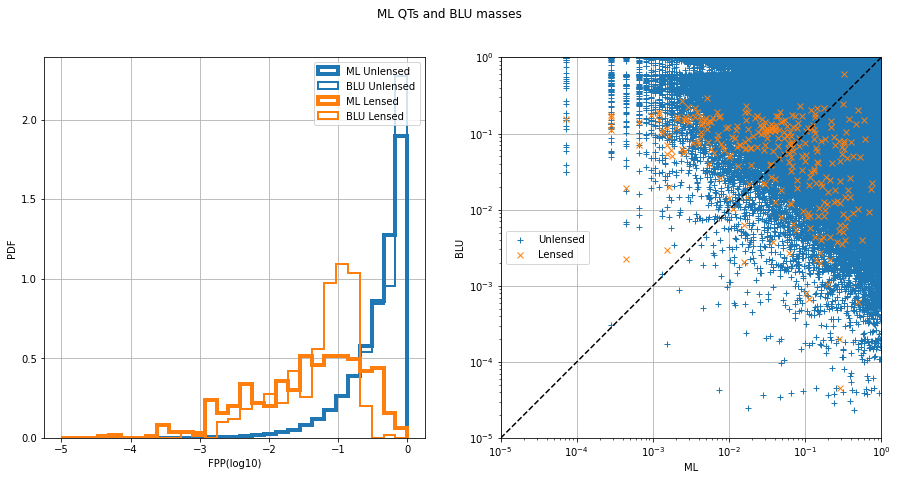

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 6, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8912627463027232, 'val_xgb_dense_QTS_0_roc': 0.9568017433375151, 'test_xgb_dense_QTS_0_acc': 0.9043858420536626, 'val_xgb_dense_QTS_0_acc': 0.9789071675681722, 'test_xgb_dense_QTS_0_f1': 0.0077656194846452515, 'val_xgb_dense_QTS_0_f1': 0.18114143920595532}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9511


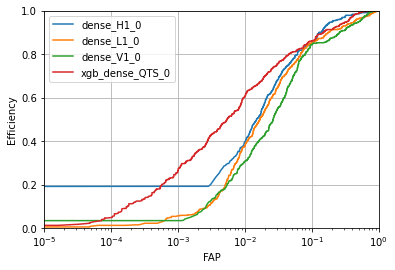

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8871
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

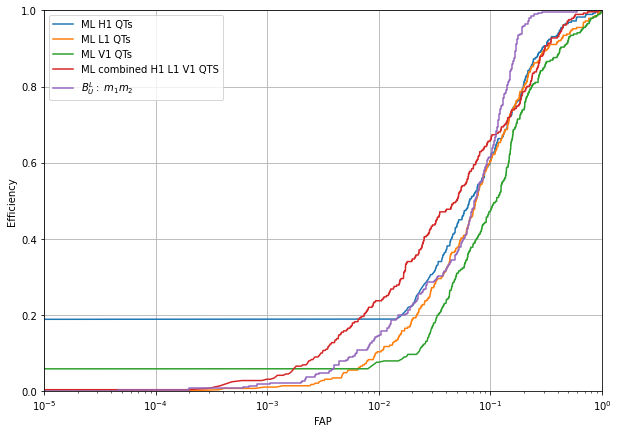

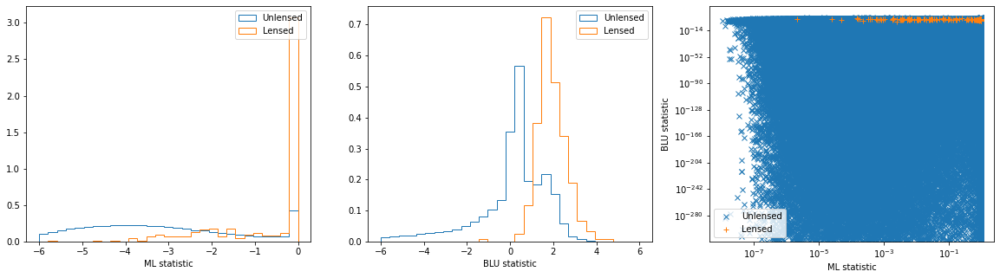

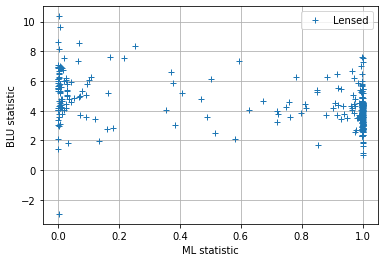

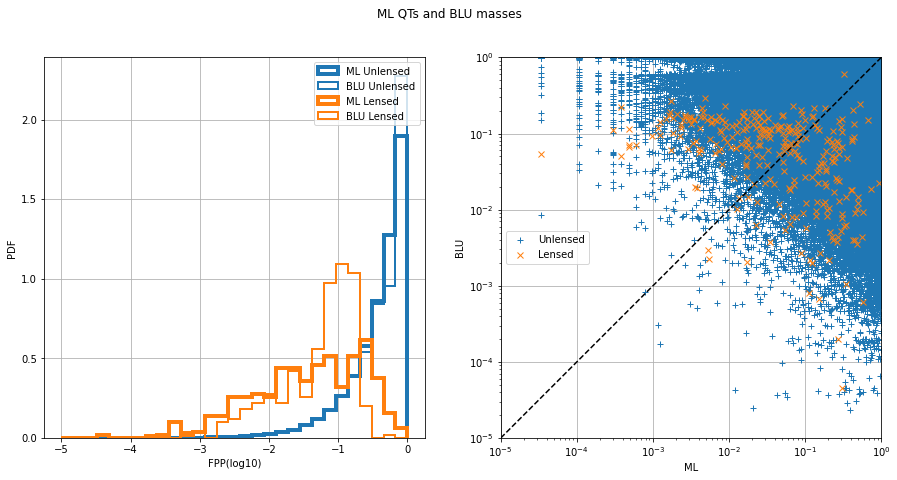

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8871292609077457, 'val_xgb_dense_QTS_0_roc': 0.9511220472456265, 'test_xgb_dense_QTS_0_acc': 0.9067848496368475, 'val_xgb_dense_QTS_0_acc': 0.9793785604141866, 'test_xgb_dense_QTS_0_f1': 0.00804837542051697, 'val_xgb_dense_QTS_0_f1': 0.1824516946468166}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9502


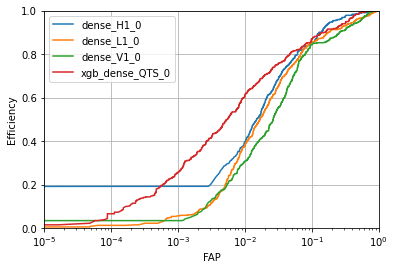

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8869
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

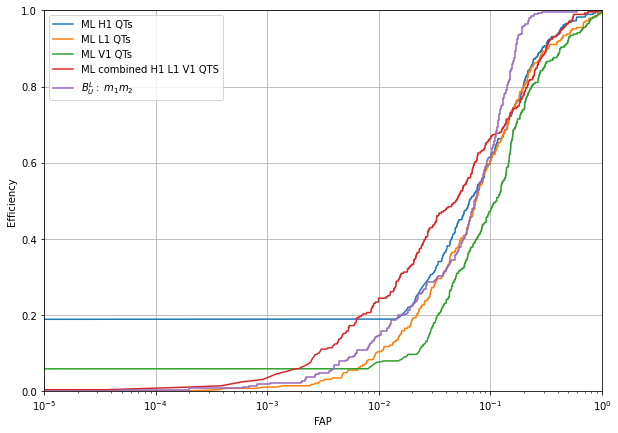

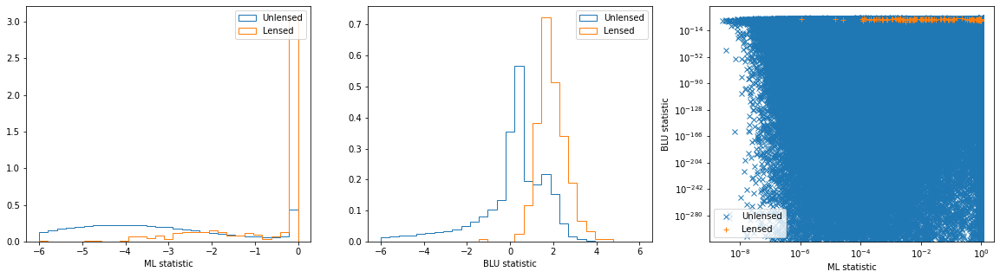

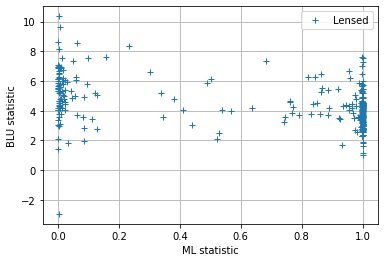

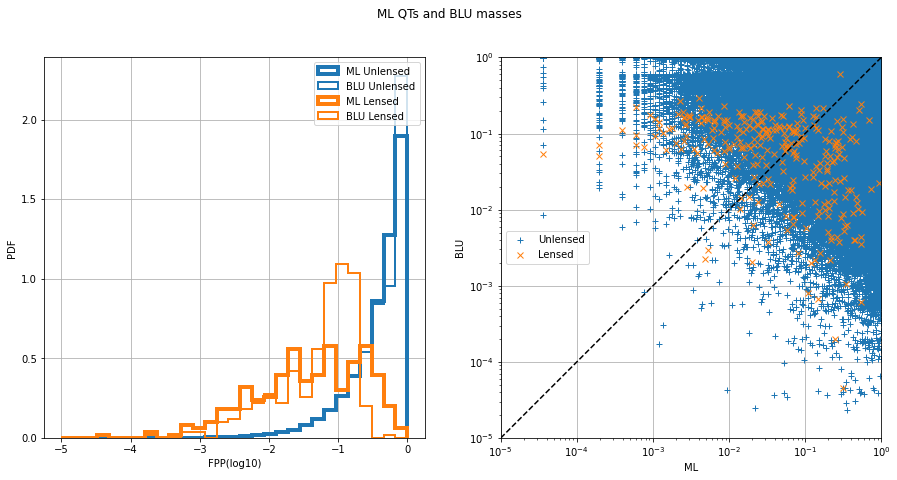

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8868795949348808, 'val_xgb_dense_QTS_0_roc': 0.9502422904026236, 'test_xgb_dense_QTS_0_acc': 0.9090177874707377, 'val_xgb_dense_QTS_0_acc': 0.9804811402913048, 'test_xgb_dense_QTS_0_f1': 0.008244274809160304, 'val_xgb_dense_QTS_0_f1': 0.18971807628524048}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9500


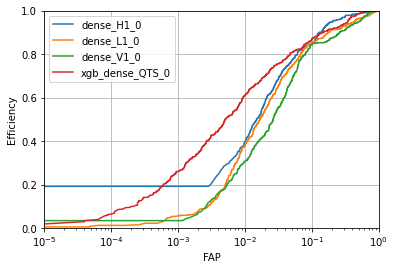

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8878
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

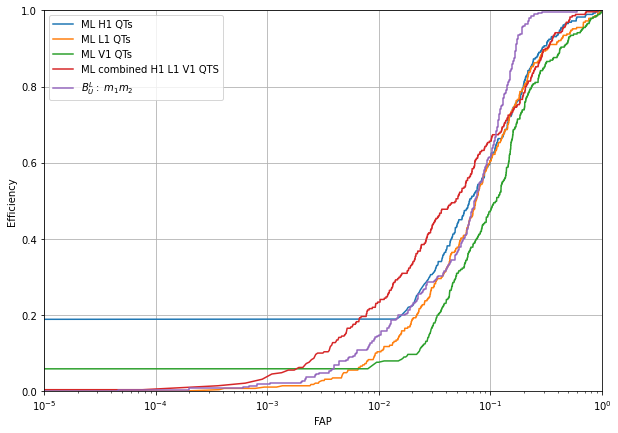

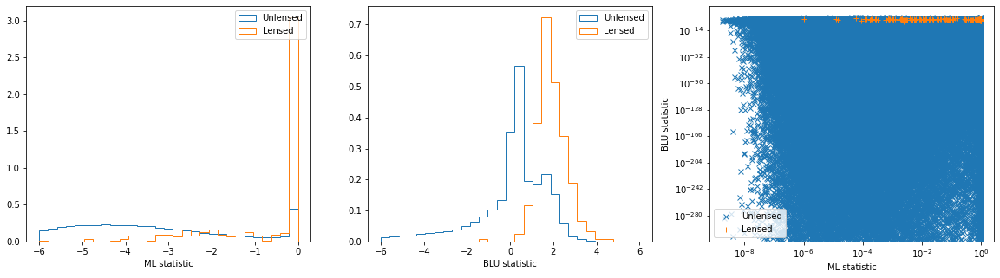

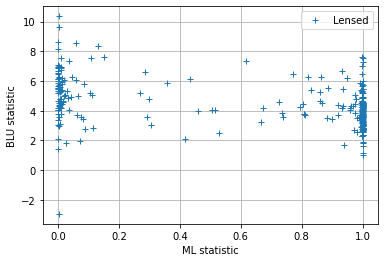

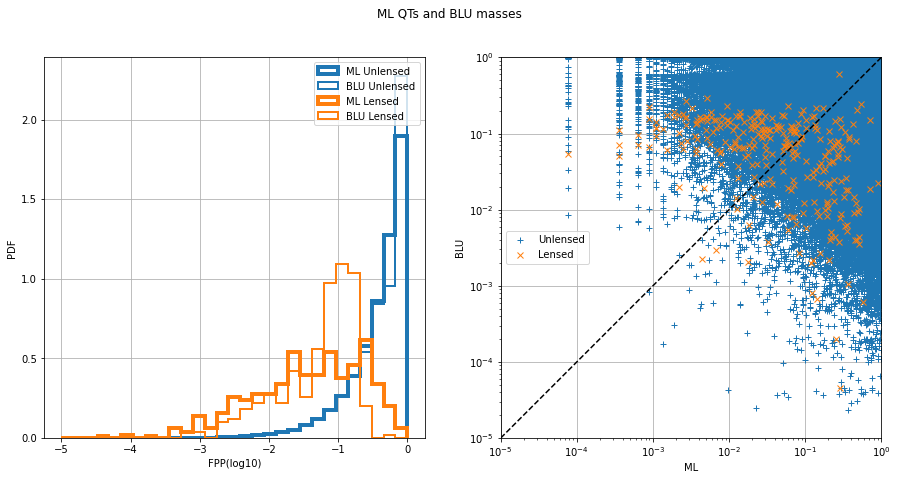

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8878180541713794, 'val_xgb_dense_QTS_0_roc': 0.9500255736820507, 'test_xgb_dense_QTS_0_acc': 0.9106384681566257, 'val_xgb_dense_QTS_0_acc': 0.9809285640095556, 'test_xgb_dense_QTS_0_f1': 0.008304467537081446, 'val_xgb_dense_QTS_0_f1': 0.1922165820642978}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9504


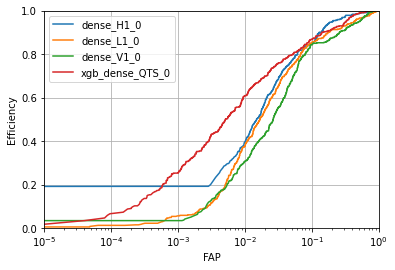

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8865
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

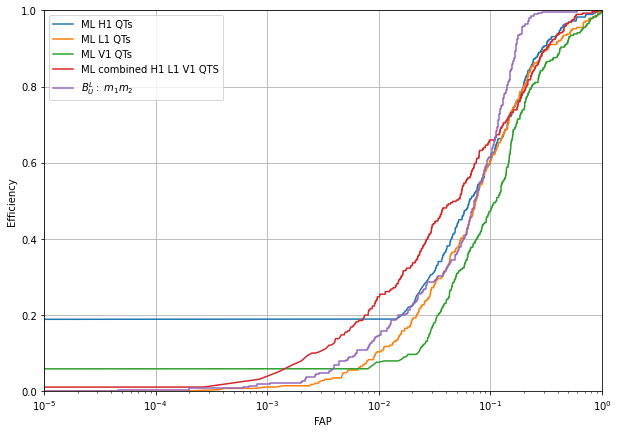

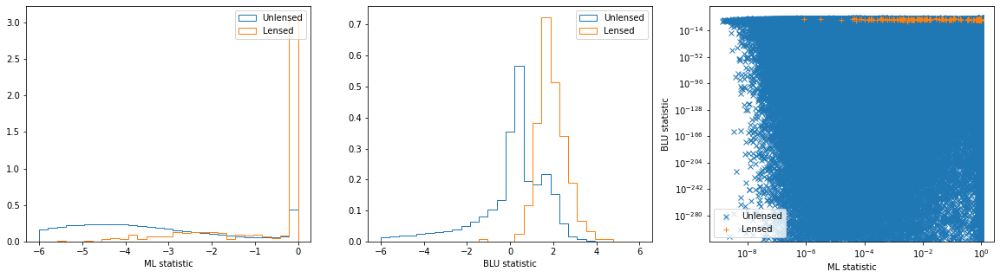

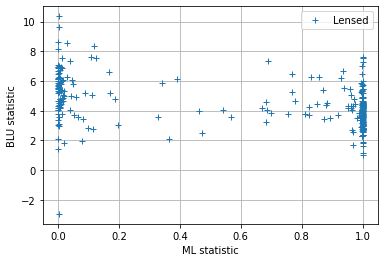

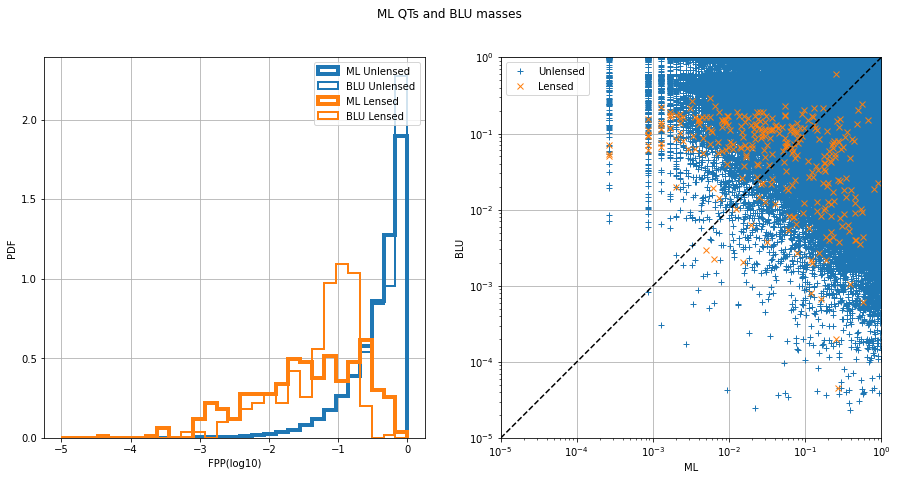

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8864767961414863, 'val_xgb_dense_QTS_0_roc': 0.9504438796598715, 'test_xgb_dense_QTS_0_acc': 0.9114908261469817, 'val_xgb_dense_QTS_0_acc': 0.9814798539481149, 'test_xgb_dense_QTS_0_f1': 0.008339311334289811, 'val_xgb_dense_QTS_0_f1': 0.19569743233865372}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9502


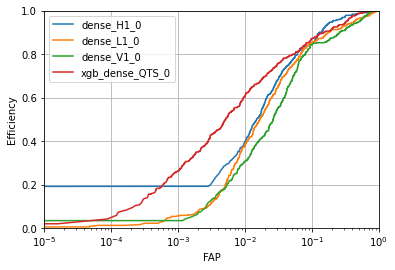

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8858
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

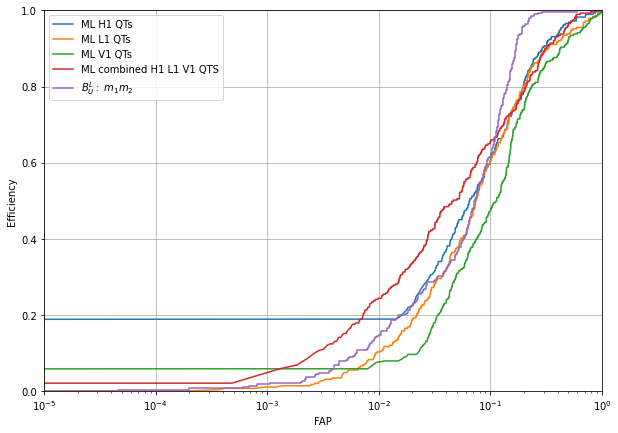

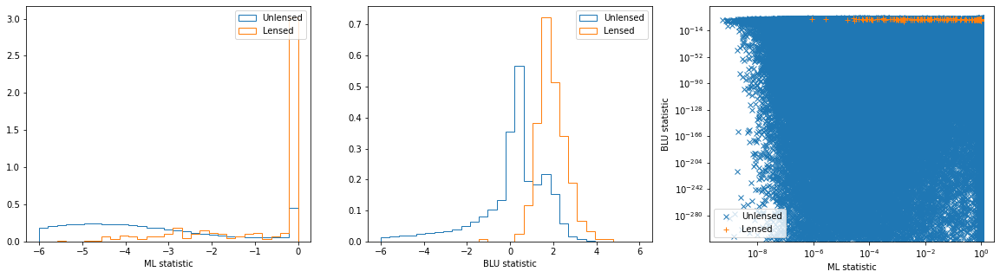

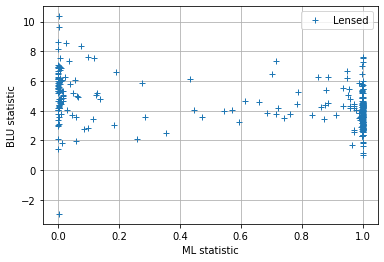

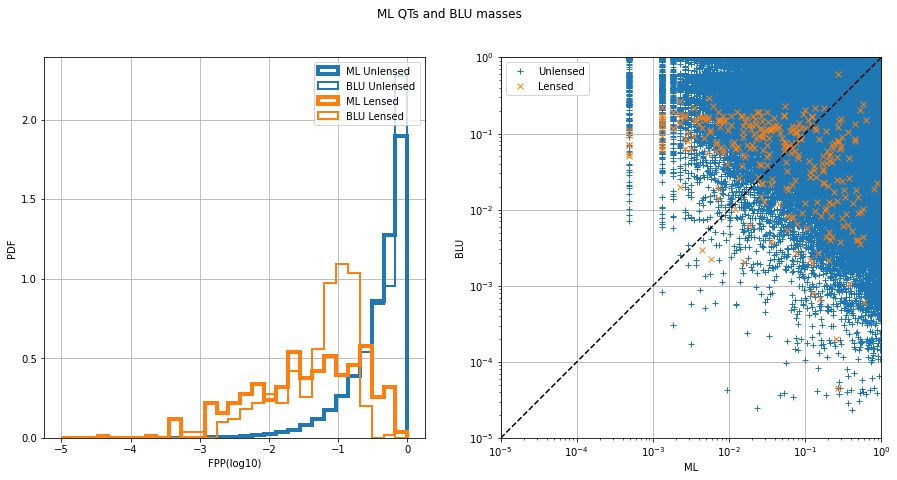

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 7, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8857728502378628, 'val_xgb_dense_QTS_0_roc': 0.9501896312650171, 'test_xgb_dense_QTS_0_acc': 0.9129374337221633, 'val_xgb_dense_QTS_0_acc': 0.981815421736803, 'test_xgb_dense_QTS_0_f1': 0.008431511063509787, 'val_xgb_dense_QTS_0_f1': 0.19689484827099507}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9543


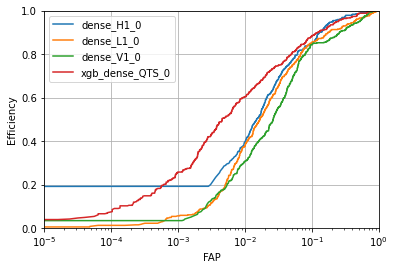

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8819
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

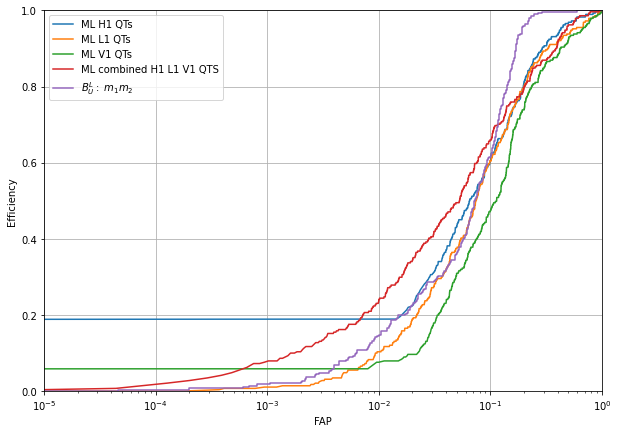

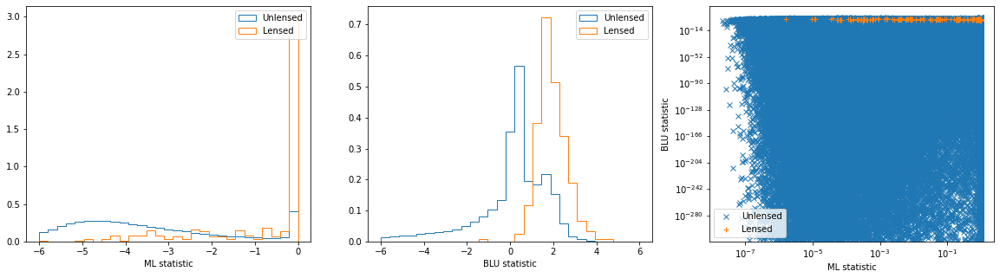

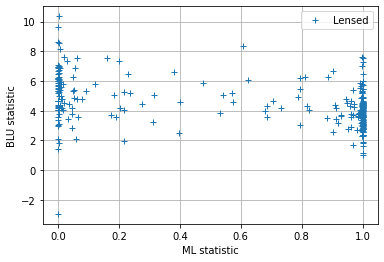

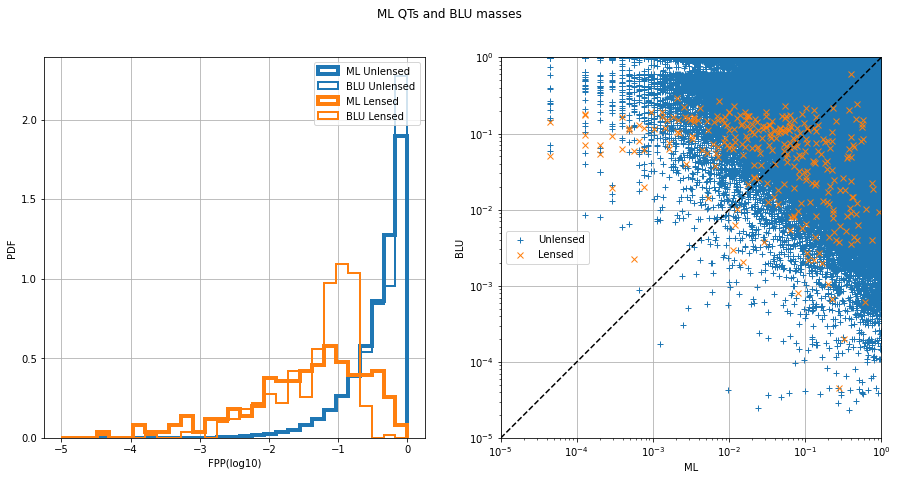

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 105, 'test_xgb_dense_QTS_0_roc': 0.8819013765194788, 'val_xgb_dense_QTS_0_roc': 0.9542631993392245, 'test_xgb_dense_QTS_0_acc': 0.9136597370895776, 'val_xgb_dense_QTS_0_acc': 0.9821270203977277, 'test_xgb_dense_QTS_0_f1': 0.008501447543770966, 'val_xgb_dense_QTS_0_f1': 0.19849516302400572}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9539


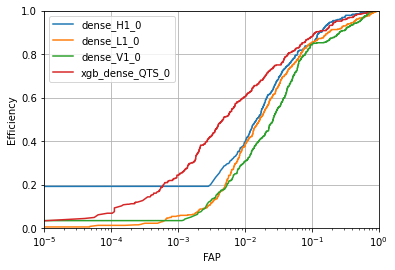

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8819
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

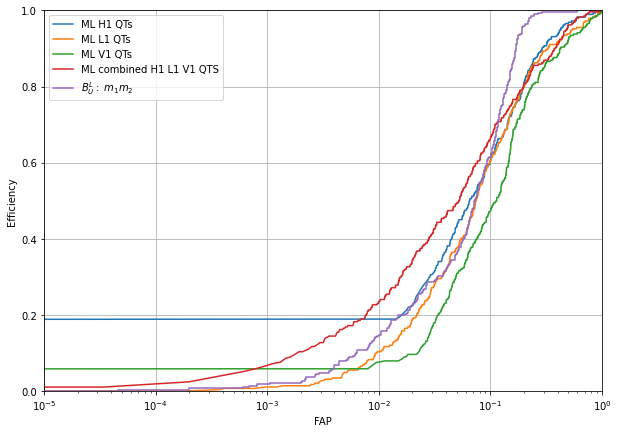

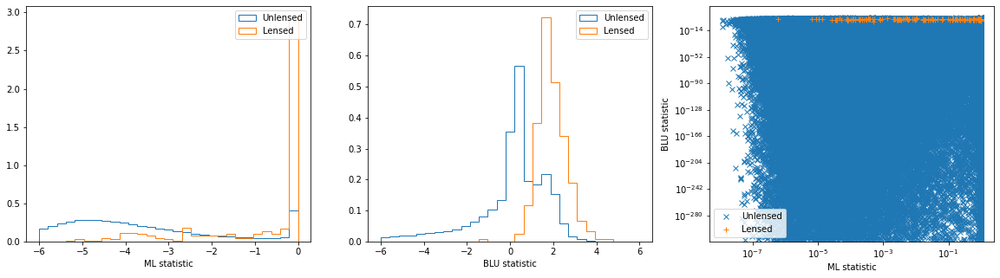

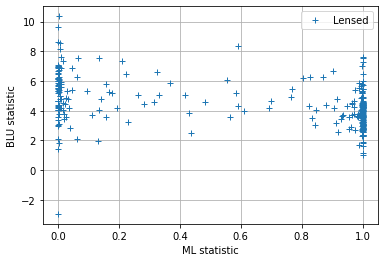

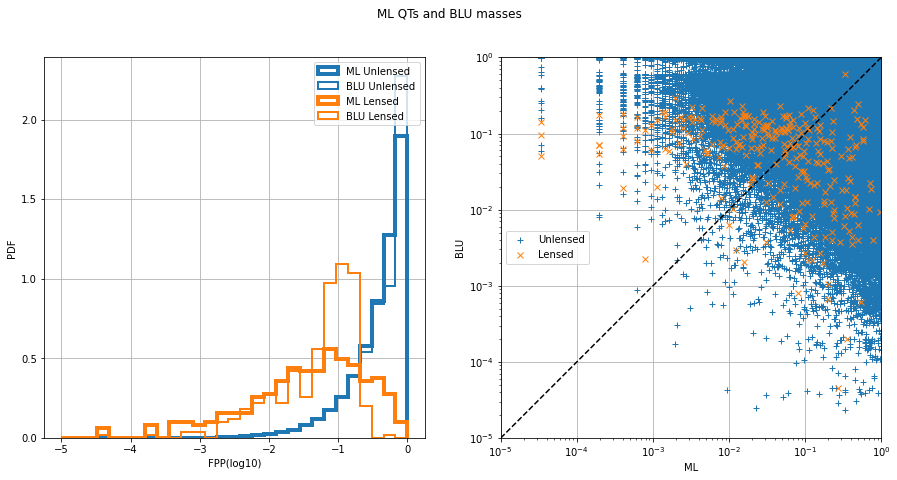

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 120, 'test_xgb_dense_QTS_0_roc': 0.8819138116599017, 'val_xgb_dense_QTS_0_roc': 0.9539381972204071, 'test_xgb_dense_QTS_0_acc': 0.9153064287000541, 'val_xgb_dense_QTS_0_acc': 0.9826543412085235, 'test_xgb_dense_QTS_0_f1': 0.008525987866863422, 'val_xgb_dense_QTS_0_f1': 0.20271759089239808}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9538


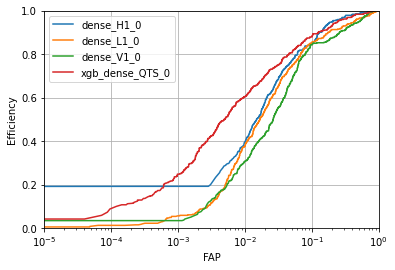

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8814
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

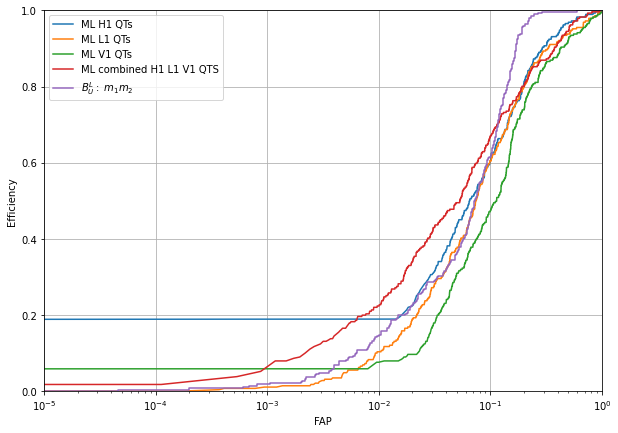

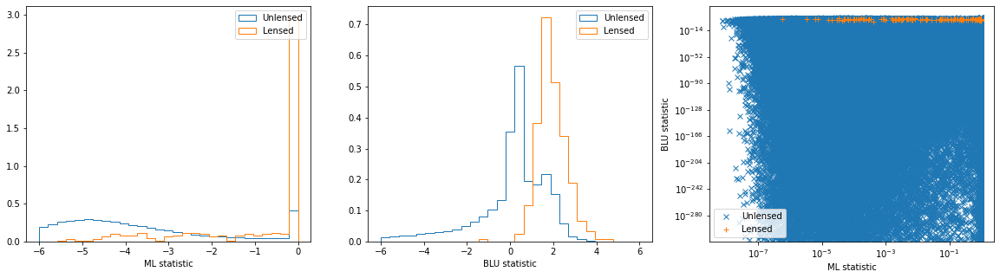

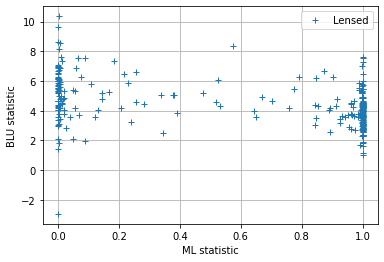

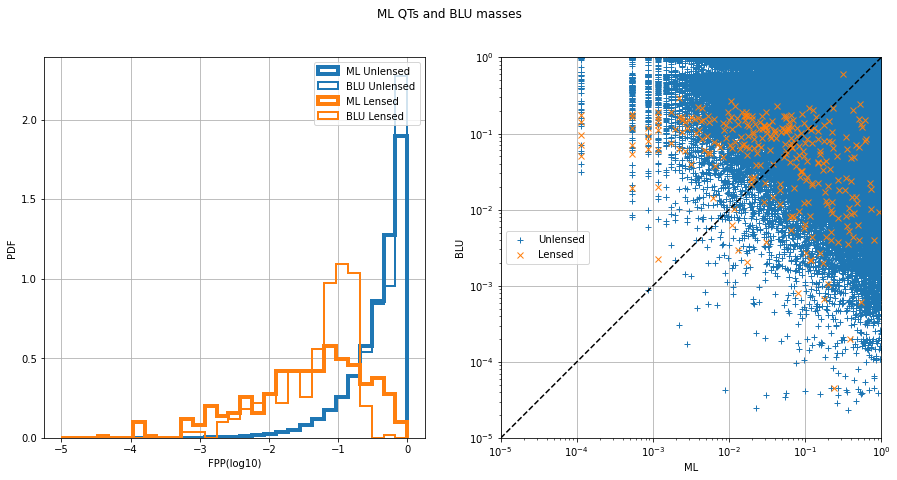

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 135, 'test_xgb_dense_QTS_0_roc': 0.8813661013421359, 'val_xgb_dense_QTS_0_roc': 0.9538485998331251, 'test_xgb_dense_QTS_0_acc': 0.9160907581184098, 'val_xgb_dense_QTS_0_acc': 0.9829899089972116, 'test_xgb_dense_QTS_0_f1': 0.00860499751778918, 'val_xgb_dense_QTS_0_f1': 0.20470676129996265}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9532


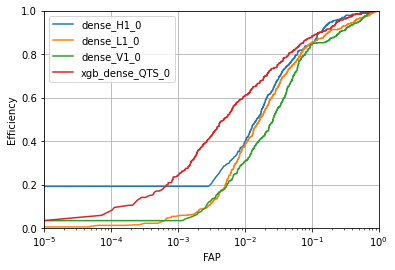

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8816
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

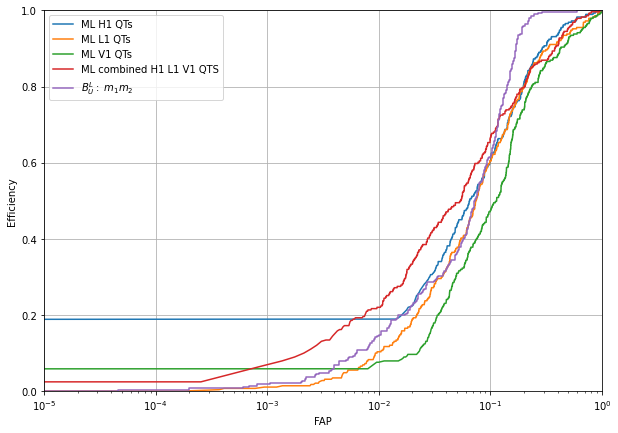

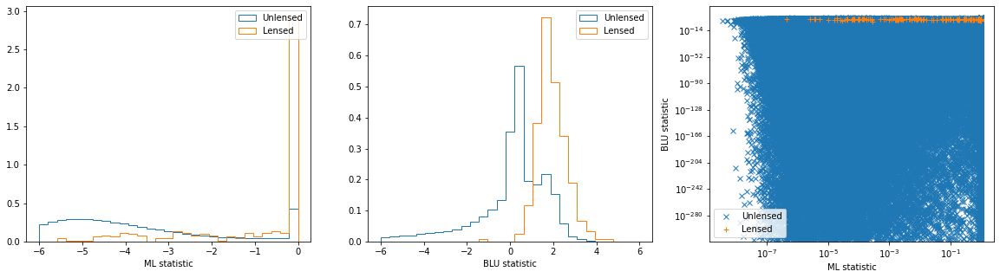

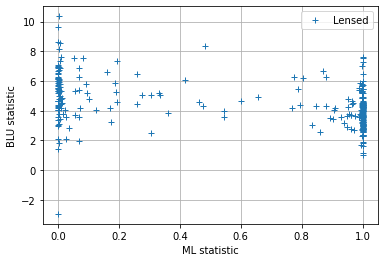

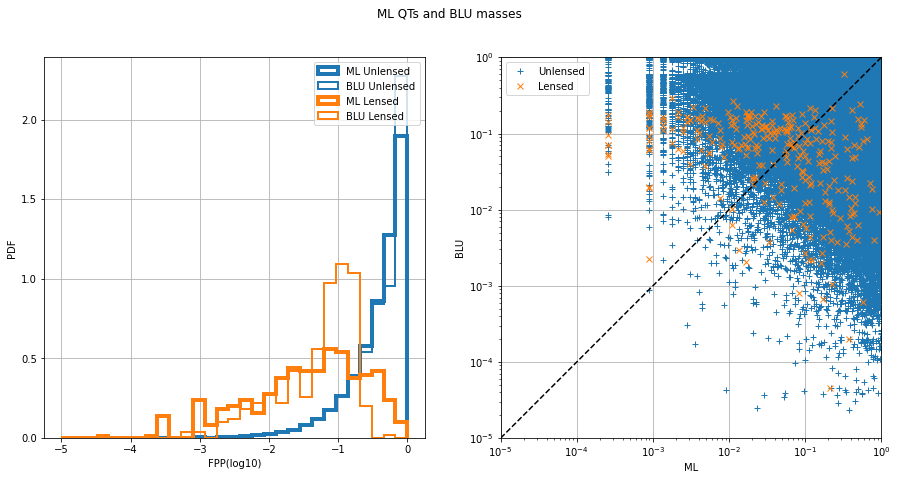

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 150, 'test_xgb_dense_QTS_0_roc': 0.8815755414416655, 'val_xgb_dense_QTS_0_roc': 0.9532285586739727, 'test_xgb_dense_QTS_0_acc': 0.9164409051801756, 'val_xgb_dense_QTS_0_acc': 0.9830937752175198, 'test_xgb_dense_QTS_0_f1': 0.008452443135951376, 'val_xgb_dense_QTS_0_f1': 0.2057057057057057}
dense_H1_0 auc = 0.9498
dense_L1_0 auc = 0.9276
dense_V1_0 auc = 0.9160
xgb_dense_QTS_0 auc = 0.9536


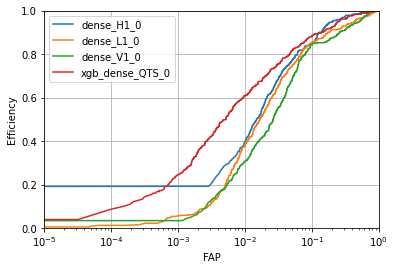

ML H1 QTs auc = 0.8789
ML L1 QTs auc = 0.8621
ML V1 QTs auc = 0.8296
ML combined H1 L1 V1 QTS auc = 0.8817
$B^L_U:$ $m_1 m_2$ auc = 0.9164


<Figure size 432x288 with 0 Axes>

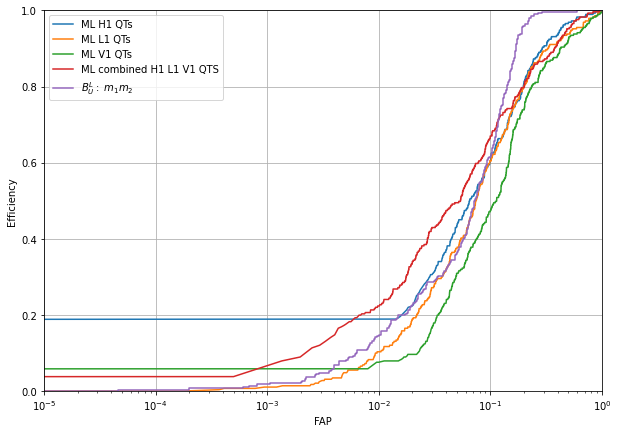

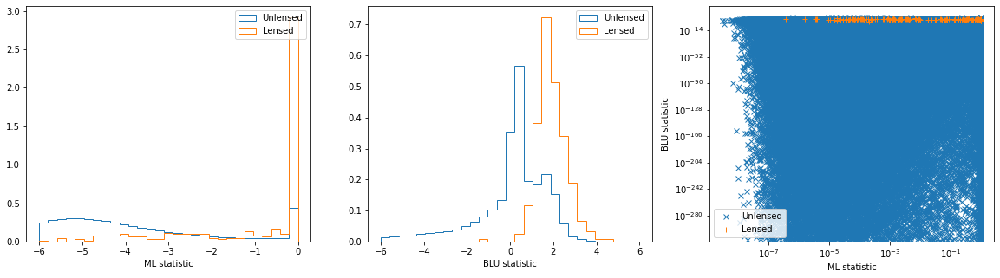

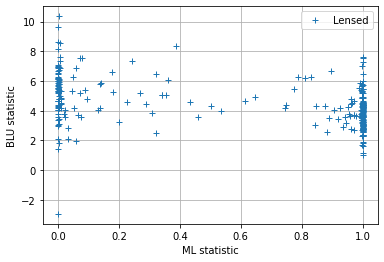

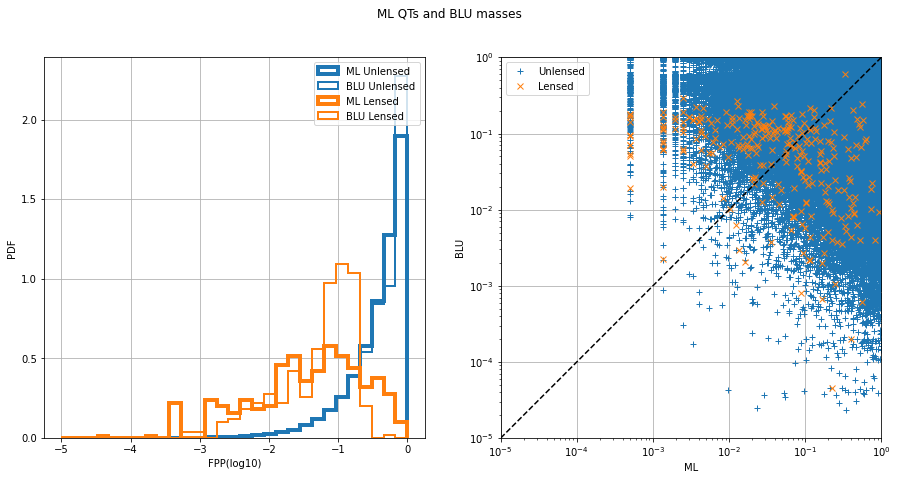

{'scale_pos_weight_xgbqts': 100, 'max_depth_xgbqts': 8, 'n_estimators_xgbqts': 165, 'test_xgb_dense_QTS_0_roc': 0.8817256609335613, 'val_xgb_dense_QTS_0_roc': 0.9536065506916529, 'test_xgb_dense_QTS_0_acc': 0.9169191060245303, 'val_xgb_dense_QTS_0_acc': 0.9832775385303729, 'test_xgb_dense_QTS_0_f1': 0.008500680532008883, 'val_xgb_dense_QTS_0_f1': 0.2080968596292092}


In [9]:
scale_pos_weight_xgbqts_arr =[ 0.01,0.1,1,10,100]
max_depth_xgbqts_arr =[ 4,5,6,7,8]
n_estimators_xgbqts_arr = [105,120,135,150,165]
include_phenom = 1
cols = ['xgb_dense_QTS_0_roc', 'xgb_dense_QTS_0_acc', 'xgb_dense_QTS_0_f1']
res=pd.DataFrame(columns=['scale_pos_weight_xgbqts', 'max_depth_xgbqts', 'n_estimators_xgbqts', 'val_xgb_dense_QTS_0_roc', 'test_xgb_dense_QTS_0_acc', 'val_xgb_dense_QTS_0_acc', 'test_xgb_dense_QTS_0_f1', 'val_xgb_dense_QTS_0_f1'])
for scale_pos_weight_xgbqts in scale_pos_weight_xgbqts_arr:
    for max_depth_xgbqts in max_depth_xgbqts_arr:
        for n_estimators_xgbqts in n_estimators_xgbqts_arr:
            df_test_scores,df_val_scores=train_test_xgbqts(base_out_dir,df_dir_train_features_in, df_dir_test_features_in, tag_qts,train_size_lensed_xgbqts, cv_size_lensed_xgbqts, scale_pos_weight_xgbqts, max_depth_xgbqts, n_estimators_xgbqts, cv_splits, compare_to_blu, path_to_blu,include_phenom)
            res_dict={'scale_pos_weight_xgbqts':scale_pos_weight_xgbqts,'max_depth_xgbqts':max_depth_xgbqts, 'n_estimators_xgbqts':n_estimators_xgbqts}
            for col in cols:
                res_dict['test_'+col]= df_test_scores[col]
                res_dict['val_'+col]= df_val_scores[col]
            print(res_dict)
            res=res.append(res_dict,ignore_index=True)

In [10]:
res

,scale_pos_weight_xgbqts,max_depth_xgbqts,n_estimators_xgbqts,val_xgb_dense_QTS_0_roc,test_xgb_dense_QTS_0_acc,val_xgb_dense_QTS_0_acc,test_xgb_dense_QTS_0_f1,val_xgb_dense_QTS_0_f1,test_xgb_dense_QTS_0_roc
0,0.01,4.0,105.0,0.960511,0.982351,0.995901,0.021303,0.346497,0.897902
1,0.01,4.0,120.0,0.961470,0.981318,0.995821,0.020355,0.353523,0.898024
2,0.01,4.0,135.0,0.961106,0.980384,0.995702,0.019992,0.351807,0.898380
3,0.01,4.0,150.0,0.960705,0.979733,0.995630,0.019363,0.351127,0.898871
4,0.01,4.0,165.0,0.960392,0.979113,0.995574,0.019352,0.349765,0.898198
...,...,...,...,...,...,...,...,...,...
120,100.00,8.0,105.0,0.954263,0.913660,0.982127,0.008501,0.198495,0.881901
121,100.00,8.0,120.0,0.953938,0.915306,0.982654,0.008526,0.202718,0.881914
122,100.00,8.0,135.0,0.953849,0.916091,0.982990,0.008605,0.204707,0.881366
123,100.00,8.0,150.0,0.953229,0.916441,0.983094,0.008452,0.205706,0.881576


In [11]:
res['test_xgb_dense_QTS_0_roc'].max()

0.8996029898246702

In [12]:
res['test_xgb_dense_QTS_0_roc'].idxmax()

14

In [13]:
res['val_xgb_dense_QTS_0_roc'].max()

0.9638150882700619

In [14]:
res['val_xgb_dense_QTS_0_roc'].idxmax()

30

In [15]:
res.iloc[14]

scale_pos_weight_xgbqts       0.010000
max_depth_xgbqts              6.000000
n_estimators_xgbqts         165.000000
val_xgb_dense_QTS_0_roc       0.961476
test_xgb_dense_QTS_0_acc      0.975936
val_xgb_dense_QTS_0_acc       0.995254
test_xgb_dense_QTS_0_f1       0.017643
val_xgb_dense_QTS_0_f1        0.351528
test_xgb_dense_QTS_0_roc      0.899603
Name: 14, dtype: float64

In [16]:
res.iloc[30]

scale_pos_weight_xgbqts       0.100000
max_depth_xgbqts              5.000000
n_estimators_xgbqts         105.000000
val_xgb_dense_QTS_0_roc       0.963815
test_xgb_dense_QTS_0_acc      0.956786
val_xgb_dense_QTS_0_acc       0.992570
test_xgb_dense_QTS_0_f1       0.012708
val_xgb_dense_QTS_0_f1        0.318182
test_xgb_dense_QTS_0_roc      0.899544
Name: 30, dtype: float64

In [17]:
res.to_csv('optimise_xgbqts_include_phenom.csv')